# Define Input Folder and Files

In [1]:
import os

# Define the folder path
input_folder = "Input_Folder_without_Nan"

# Get the list of CSV file names in the folder
input_files = [file for file in os.listdir(input_folder) if file.endswith('.csv')]

# Print the results
print("Input Folder:", input_folder)
print(f"Input Files: {len(input_files)}")
print(input_files)


Input Folder: Input_Folder_without_Nan
Input Files: 41
['UP002.csv', 'UP003.csv', 'UP004.csv', 'UP008.csv', 'UP009.csv', 'UP012.csv', 'UP014.csv', 'UP016.csv', 'UP017.csv', 'UP018.csv', 'UP019.csv', 'UP020.csv', 'UP021.csv', 'UP022.csv', 'UP023.csv', 'UP024.csv', 'UP025.csv', 'UP026.csv', 'UP028.csv', 'UP029.csv', 'UP030.csv', 'UP031.csv', 'UP032.csv', 'UP033.csv', 'UP034.csv', 'UP035.csv', 'UP036.csv', 'UP037.csv', 'UP038.csv', 'UP039.csv', 'UP040.csv', 'UP041.csv', 'UP042.csv', 'UP043.csv', 'UP044.csv', 'UP046.csv', 'UP048.csv', 'UP049.csv', 'UP050.csv', 'UP051.csv', 'UP052.csv']


In [2]:
import pandas as pd

dataframes_dictionary = {}  # Dictionary to store DataFrames
print(input_folder)
for file in input_files:
    file_path = os.path.join(input_folder, file)
    if os.path.exists(file_path):
        # Load the CSV file
        df = pd.read_csv(file_path)
        dataframes_dictionary[file] = df


Input_Folder_without_Nan


# Add Additional columns to the dataframes

In [3]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn.functional as F
from torch_geometric.nn import GATConv
from torch_geometric.data import Data

from sklearn.preprocessing import LabelEncoder

# Initialize a label encoder
label_encoder = LabelEncoder()

# Load and process the data
dataframes = []
for file_name in input_files:
    df = dataframes_dictionary[file_name]
    
    # Convert 'From Date' to pandas datetime
    df['From Date'] = pd.to_datetime(df['From Date'])
    
    # Split 'From Date' into Year, Month, Day, Hour
    df['Year'] = df['From Date'].dt.year
    df['Month'] = df['From Date'].dt.month
    df['Day'] = df['From Date'].dt.day
    df['Hour'] = df['From Date'].dt.hour
    
    # Drop the original 'From Date' column
    df.drop('From Date', axis=1, inplace=True)
    
    dataframes.append(df)


# Split the data into training and test sets

In [4]:
train_dataframes = []
test_dataframes = []

split_ratio = 0.85  # 85% train, 15% test
train_size = int(len(dataframes[0]) * split_ratio)

for node_idx, df in enumerate(dataframes):
    # Split the dataframe into train and test sets

    train_df = df.iloc[:train_size]
    test_df = df.iloc[train_size:]
    
    # Append the train and test dataframes to the respective lists
    train_dataframes.append(train_df)
    test_dataframes.append(test_df)

print(f"Train dataframes shape: {train_dataframes[0].shape}")
print(f"Test dataframes shape: {test_dataframes[0].shape}")    

Train dataframes shape: (8343, 15)
Test dataframes shape: (1473, 15)


# Scale the Data

In [7]:
from sklearn.preprocessing import StandardScaler

scalers = {}

feature_scalers = {}

print(train_dataframes[0].dtypes)

# Apply StandardScaler to all numeric columns except 'Year', 'Month', 'Day', 'Hour'
for node_idx, df in enumerate(train_dataframes):

    print(f"Training Processing {input_files[node_idx]}, node index: {node_idx}")
    # Encode the 'Year' column
    df['Year'] = label_encoder.fit_transform(df['Year'])

    numeric_columns = df.select_dtypes(include=[np.number]).columns.tolist()
    columns_to_scale = [col for col in numeric_columns if col not in ['Year', 'Month', 'Day', 'Hour', 'AT (degree C)']]
    
    scaler = StandardScaler()
    df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
    feature_scalers[input_files[node_idx]] = scaler

    scaler1 = StandardScaler()
    df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
    
    # Save the scaler for the target column
    scalers[input_files[node_idx]] = scaler1


print(test_dataframes[0].dtypes)    

# Apply the same scaling to the test dataframes
for node_idx, df in enumerate(test_dataframes):

    print(f"Testing Processing {input_files[node_idx]}, node index: {node_idx}, shape: {df.shape}")
    # Encode the 'Year' column
    df['Year'] = label_encoder.fit_transform(df['Year'])

    numeric_columns = df.select_dtypes(include=[np.number]).columns.tolist()
    columns_to_scale = [col for col in numeric_columns if col not in ['Year', 'Month', 'Day', 'Hour', 'AT (degree C)']]
    
    scaler = feature_scalers[input_files[node_idx]]
    df[columns_to_scale] = scaler.transform(df[columns_to_scale])
    
    scaler1 = scalers[input_files[node_idx]]
    df['AT (degree C)'] = scaler1.transform(df[['AT (degree C)']])
 

PM2.5 (ug/m3)    float64
PM10 (ug/m3)     float64
NO (ug/m3)       float64
NO2 (ug/m3)      float64
SO2 (ug/m3)      float64
CO (mg/m3)       float64
Ozone (ug/m3)    float64
RH (%)           float64
WS (m/s)         float64
WD (degree)      float64
AT (degree C)    float64
Year               int32
Month              int32
Day                int32
Hour               int32
dtype: object
Training Processing UP002.csv, node index: 0
Training Processing UP003.csv, node index: 1
Training Processing UP004.csv, node index: 2
Training Processing UP008.csv, node index: 3


C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

Training Processing UP009.csv, node index: 4
Training Processing UP012.csv, node index: 5
Training Processing UP014.csv, node index: 6
Training Processing UP016.csv, node index: 7


C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

Training Processing UP017.csv, node index: 8
Training Processing UP018.csv, node index: 9
Training Processing UP019.csv, node index: 10
Training Processing UP020.csv, node index: 11
Training Processing UP021.csv, node index: 12
Training Processing UP022.csv, node index: 13
Training Processing UP023.csv, node index: 14
Training Processing UP024.csv, node index: 15
Training Processing UP025.csv, node index: 16
Training Processing UP026.csv, node index: 17


C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

Training Processing UP028.csv, node index: 18
Training Processing UP029.csv, node index: 19
Training Processing UP030.csv, node index: 20
Training Processing UP031.csv, node index: 21
Training Processing UP032.csv, node index: 22


C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

Training Processing UP033.csv, node index: 23
Training Processing UP034.csv, node index: 24
Training Processing UP035.csv, node index: 25
Training Processing UP036.csv, node index: 26
Training Processing UP037.csv, node index: 27
Training Processing UP038.csv, node index: 28


C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

Training Processing UP039.csv, node index: 29
Training Processing UP040.csv, node index: 30
Training Processing UP041.csv, node index: 31
Training Processing UP042.csv, node index: 32
Training Processing UP043.csv, node index: 33


C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

Training Processing UP044.csv, node index: 34
Training Processing UP046.csv, node index: 35
Training Processing UP048.csv, node index: 36
Training Processing UP049.csv, node index: 37
Training Processing UP050.csv, node index: 38
Training Processing UP051.csv, node index: 39
Training Processing UP052.csv, node index: 40
PM2.5 (ug/m3)    float64
PM10 (ug/m3)     float64
NO (ug/m3)       float64
NO2 (ug/m3)      float64
SO2 (ug/m3)      float64
CO (mg/m3)       float64
Ozone (ug/m3)    float64
RH (%)           float64
WS (m/s)         float64
WD (degree)      float64
AT (degree C)    float64
Year               int32
Month              int32
Day                int32
Hour               int32
dtype: object
Testing Processing UP002.csv, node index: 0, shape: (1473, 15)
Testing Processing UP003.csv, node index: 1, shape: (1473, 15)
Testing Processing UP004.csv, node index: 2, shape: (1473, 15)
Testing Processing UP008.csv, node index: 3, shape: (1473, 15)
Testing Processing UP009.csv, node in

C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .l

Testing Processing UP021.csv, node index: 12, shape: (1473, 15)
Testing Processing UP022.csv, node index: 13, shape: (1473, 15)
Testing Processing UP023.csv, node index: 14, shape: (1473, 15)
Testing Processing UP024.csv, node index: 15, shape: (1473, 15)
Testing Processing UP025.csv, node index: 16, shape: (1473, 15)
Testing Processing UP026.csv, node index: 17, shape: (1473, 15)
Testing Processing UP028.csv, node index: 18, shape: (1473, 15)
Testing Processing UP029.csv, node index: 19, shape: (1473, 15)
Testing Processing UP030.csv, node index: 20, shape: (1473, 15)
Testing Processing UP031.csv, node index: 21, shape: (1473, 15)
Testing Processing UP032.csv, node index: 22, shape: (1473, 15)
Testing Processing UP033.csv, node index: 23, shape: (1473, 15)
Testing Processing UP034.csv, node index: 24, shape: (1473, 15)
Testing Processing UP035.csv, node index: 25, shape: (1473, 15)
Testing Processing UP036.csv, node index: 26, shape: (1473, 15)
Testing Processing UP037.csv, node index

C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\2524091884.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .l

# Modifying the csv to add latitude and longitude

In [8]:
import pandas as pd

# Load the CSV file
file_path = 'final.csv'  # Replace with your file path
df = pd.read_csv(file_path, header=None)

# Define the new column names
new_columns = ['file_name', 'state', 'city', 'agency', 'station_location', 
               'start_month', 'start_month_num', 'start_year', 'latitude', 'longitude']

# Assign the new column names to the dataframe
df.columns = new_columns

# Save the modified dataframe back to CSV
modified_file_path = 'final_modified.csv'  # Specify the output file path
df.to_csv(modified_file_path, index=False)

print(f"Modified file saved as {modified_file_path}")

Modified file saved as final_modified.csv


# Checking if all files have latitudes and longitudes

In [9]:
import pandas as pd

# Load the CSV file
df = pd.read_csv('final_modified.csv')

# Remove ".csv" extension from the files_with_at_column
files_without_extension = [file.replace('.csv', '') for file in input_files]

# Filter rows from the dataframe where the file_name is in the files_without_extension array
filtered_df = df[df['file_name'].isin(files_without_extension)]

# Extract latitude and longitude of the filtered rows
filtered_lat_long_positions = filtered_df[['latitude', 'longitude']].values.tolist()

# Find file names that do not have latitude and longitude information
missing_files = [file for file in files_without_extension if file not in filtered_df['file_name'].values]

# Print the results
print("Filtered latitude and longitude positions:", filtered_lat_long_positions)
print("Files without latitude and longitude information:", missing_files)


Filtered latitude and longitude positions: [[26.828687, 80.968257], [25.347671, 82.98085], [27.198724, 78.006069], [28.543866, 77.331016], [28.662102, 77.373283], [28.478246, 77.481831], [29.467858, 77.711593], [28.722131, 77.753682], [28.694105, 77.4549], [28.645805, 77.369211], [28.73341, 77.298604], [28.553622, 77.47128], [28.58997, 77.311681], [28.569039, 77.397499], [28.957922, 77.759078], [26.849806, 81.007399], [29.002044, 77.760152], [29.06265, 77.71476], [27.204282, 77.925518], [25.301191, 82.996499], [27.194169, 77.965192], [25.262166, 82.995247], [26.731409, 83.433118], [25.493404, 81.862706], [27.233706, 78.026988], [26.763279, 80.927821], [25.428788, 81.91389], [27.166823, 78.376626], [25.449042, 81.827394], [26.90648, 80.983889], [26.506816, 80.251968], [25.325445, 82.995173], [27.104555, 78.003352], [27.57421, 77.654082], [26.426674, 80.325968], [28.885193, 78.738921], [28.854246, 78.772174], [28.841239, 78.696695], [28.964466, 77.27869], [27.16446, 78.391286], [25.45357

# Calculating distances between the points

In [10]:
import math

# Function to calculate the Haversine distance between two points on the Earth
def haversine(lat1, lon1, lat2, lon2):
    # Radius of the Earth in kilometers
    R = 6371.0
    
    # Convert latitude and longitude from degrees to radians
    lat1_rad = math.radians(lat1)
    lon1_rad = math.radians(lon1)
    lat2_rad = math.radians(lat2)
    lon2_rad = math.radians(lon2)
    
    # Differences in coordinates
    dlat = lat2_rad - lat1_rad
    dlon = lon2_rad - lon1_rad
    
    # Haversine formula
    a = math.sin(dlat / 2)**2 + math.cos(lat1_rad) * math.cos(lat2_rad) * math.sin(dlon / 2)**2
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    
    # Distance in kilometers
    distance = R * c
    return distance

# Initialize a 2D array to store the distances
num_stations = len(filtered_lat_long_positions)
distance_matrix = [[0] * num_stations for _ in range(num_stations)]

# Iterate over the array to calculate distances between each pair of stations
for i in range(num_stations):
    for j in range(num_stations):
        lat1, lon1 = filtered_lat_long_positions[i]
        lat2, lon2 = filtered_lat_long_positions[j]
        
        # Check if any latitude or longitude is None
        if None in (lat1, lon1, lat2, lon2):
            distance_matrix[i][j] = -1
        else:
            # Calculate the distance using the Haversine formula
            distance_matrix[i][j] = haversine(lat1, lon1, lat2, lon2)

# Output the 2D distance array
for row in distance_matrix:
    print(row)

# Get the number of rows (length of the outer list)
rows = len(distance_matrix)

# Get the number of columns (length of the first inner list, assuming all rows have the same number of columns)
columns = len(distance_matrix[0]) if rows > 0 else 0

# Print the shape
print(f"Shape: ({rows}, {columns})")


[0.0, 259.831294268261, 296.3073062470489, 405.71967084165664, 408.2831201387903, 389.2780421976758, 433.6248093898384, 379.9022461663081, 403.1202784144766, 407.75269006951396, 418.5168023768209, 394.0985785077845, 409.75765217382735, 401.26086412872326, 394.3312597566813, 4.538336824596205, 397.16042095417515, 404.7358890189317, 304.28787362360157, 264.3631791522258, 300.25474049648807, 267.10222540161783, 244.91806957183363, 173.24469530741052, 294.77943248602156, 8.30691912317224, 182.0490886691721, 259.5051000084394, 175.75234561274783, 8.788059469298602, 79.66689357184394, 262.5205143903347, 295.4259311719268, 338.07059597527996, 77.93792481191839, 316.7232944225239, 311.9990131479505, 316.1633594061282, 433.3949665835895, 258.0326294852914, 281.95404023105255]
[259.831294268261, 0.0, 536.971001381933, 663.1333206367073, 666.5260268959933, 646.748508222628, 692.9632693541472, 639.2595346251944, 661.7347052324445, 665.8970511529196, 676.9228193417765, 652.0154437921375, 667.406227

# Plotting the points on the map

In [11]:
import folium

avg_lat = sum([pos[0] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
avg_long = sum([pos[1] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
my_map = folium.Map(location=[avg_lat, avg_long], zoom_start=5)
    
# Add markers for each position
for lat, long in filtered_lat_long_positions:
    folium.Marker(location=[lat, long]).add_to(my_map)
    
# Save the map to an HTML file
my_map.save("map.html")

# Display the map in the notebook
my_map


# Plotting the points in a plot

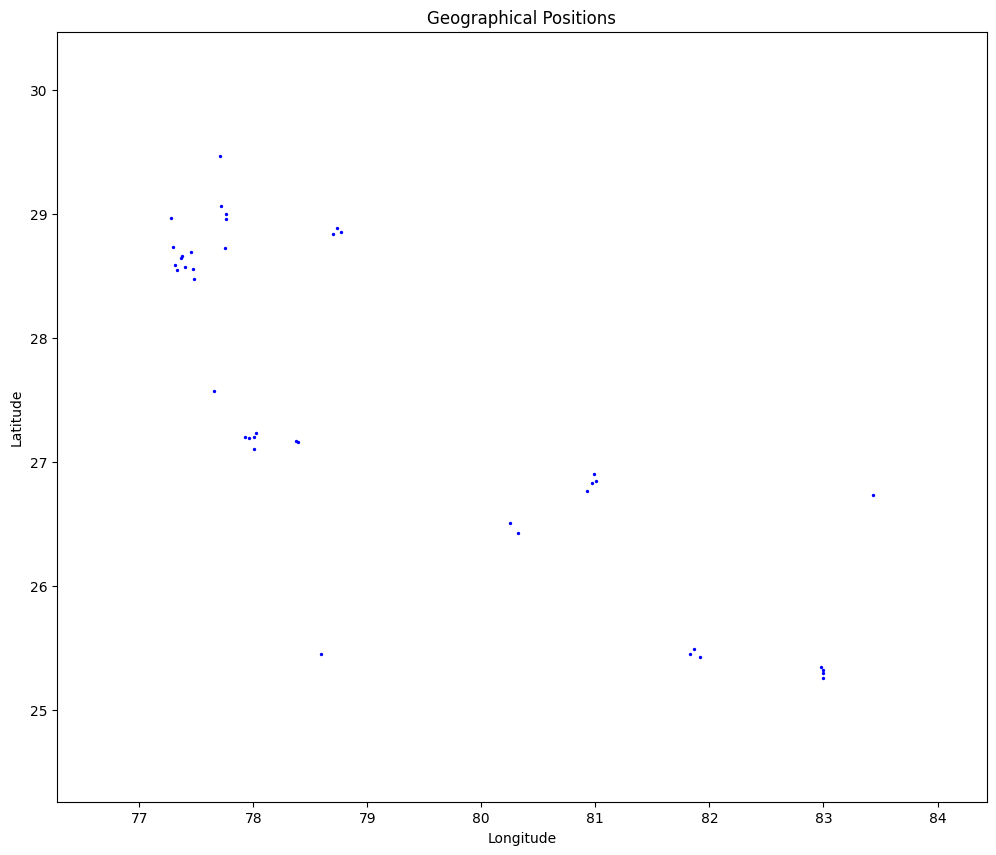

In [12]:
import matplotlib.pyplot as plt

# Split the latitude and longitude into separate lists
latitudes = [pos[0] for pos in filtered_lat_long_positions]
longitudes = [pos[1] for pos in filtered_lat_long_positions]

# Create a scatter plot with a larger figure size
plt.figure(figsize=(12, 10))  # Increase the figure size

# Plot the points with a larger marker size
plt.scatter(longitudes, latitudes, color='blue', marker='o', s=2)

# Label the axes
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Title of the plot
plt.title('Geographical Positions')

# Set the axis limits to zoom in and create more space between points
plt.xlim(min(longitudes) - 1, max(longitudes) + 1)
plt.ylim(min(latitudes) - 1, max(latitudes) + 1)

# Save the plot as an image file
output_image = 'positions_plot_large.png'
plt.savefig(output_image, dpi=300)  # Increase dpi for better resolution

# Show the plot
plt.show()


# Determine the k nearest neighbours

In [13]:
import numpy as np

k = 8  # Number of nearest neighbors

# Initialize adjacency matrix (with all zeros)
adjacency_matrix = np.zeros((len(input_files), len(input_files)), dtype=int)

# Loop through each entry to find k nearest neighbors
for i in range(len(input_files)):
    # Get distances for the i-th entry
    distances = distance_matrix[i]
    
    # Find the indices of the k smallest distances, excluding the distance to itself (i.e., index i)
    nearest_neighbors = np.argsort(distances)[1:k+1]  # 1:k+1 because argsort includes self-distance at position 0
    
    # Print the k nearest neighbors for the current file
    print(f"\nFile: {input_files[i]}")
    print(f"K-nearest neighbors: {[input_files[j] for j in nearest_neighbors]}")
    
    # Update the adjacency matrix to represent edges
    for neighbor in nearest_neighbors:
        adjacency_matrix[i][neighbor] = 1
        adjacency_matrix[neighbor][i] = 1  # Ensure undirected edge

# Print the adjacency matrix
print("\nAdjacency Matrix:")
print(adjacency_matrix)

# Print neighbors for each file based on the adjacency matrix
for i in range(len(input_files)):
    neighbors = [input_files[j] for j in range(len(input_files)) if adjacency_matrix[i][j] == 1]
    print(f"\nNeighbors of {input_files[i]} based on adjacency matrix: {neighbors}")


File: UP002.csv
K-nearest neighbors: ['UP024.csv', 'UP035.csv', 'UP039.csv', 'UP044.csv', 'UP040.csv', 'UP033.csv', 'UP038.csv', 'UP036.csv']

File: UP003.csv
K-nearest neighbors: ['UP041.csv', 'UP029.csv', 'UP031.csv', 'UP036.csv', 'UP033.csv', 'UP038.csv', 'UP032.csv', 'UP024.csv']

File: UP004.csv
K-nearest neighbors: ['UP030.csv', 'UP034.csv', 'UP028.csv', 'UP042.csv', 'UP037.csv', 'UP051.csv', 'UP043.csv', 'UP012.csv']

File: UP008.csv
K-nearest neighbors: ['UP021.csv', 'UP022.csv', 'UP018.csv', 'UP020.csv', 'UP009.csv', 'UP012.csv', 'UP017.csv', 'UP019.csv']

File: UP009.csv
K-nearest neighbors: ['UP018.csv', 'UP017.csv', 'UP021.csv', 'UP022.csv', 'UP019.csv', 'UP008.csv', 'UP020.csv', 'UP012.csv']

File: UP012.csv
K-nearest neighbors: ['UP020.csv', 'UP022.csv', 'UP008.csv', 'UP021.csv', 'UP018.csv', 'UP009.csv', 'UP017.csv', 'UP019.csv']

File: UP014.csv
K-nearest neighbors: ['UP026.csv', 'UP025.csv', 'UP023.csv', 'UP050.csv', 'UP016.csv', 'UP017.csv', 'UP019.csv', 'UP009.csv']

# Plotting the edges on the map

In [14]:
import folium

# Create a Folium map centered at the average of the coordinates
center_lat = sum([pos[0] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
center_long = sum([pos[1] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)

# Initialize the map
m = folium.Map(location=[center_lat, center_long], zoom_start=5)

# Add markers for each position
for idx, (lat, long) in enumerate(filtered_lat_long_positions):
    folium.Marker([lat, long], tooltip=f'Point {idx + 1}').add_to(m)

# Add edges based on adjacency matrix
for i in range(len(adjacency_matrix)):
    for j in range(i + 1, len(adjacency_matrix)):  # Only check upper triangle to avoid duplicate edges
        if adjacency_matrix[i][j] == 1:
            # Draw a line between point i and point j
            folium.PolyLine([filtered_lat_long_positions[i], filtered_lat_long_positions[j]], color="blue").add_to(m)

# Save the map to an HTML file or display in Jupyter notebook
m.save("map_with_edges.html")

# To display directly in Jupyter notebook
m


# Change the diagonal elements to 1

In [15]:
# Change the diagonal elements to 1
np.fill_diagonal(adjacency_matrix, 1)
adjacency_matrix

array([[1, 0, 0, ..., 0, 0, 0],
       [0, 1, 0, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 1, 1],
       ...,
       [0, 0, 0, ..., 1, 0, 0],
       [0, 0, 1, ..., 0, 1, 1],
       [0, 0, 1, ..., 0, 1, 1]])

# Prepare Graph Data for GNN

In [16]:
# Prepare graph data for each timestamp
def prepare_graph_data_for_timestamp(dataframes, adjacency_matrix, timestamp_index):
    # Extract the row corresponding to the timestamp index from all CSV files
    features = np.stack([df.iloc[timestamp_index].values for df in dataframes], axis=0)  # shape (num_nodes, num_features)
    
    # Create node features (tensor)
    node_features = torch.tensor(features, dtype=torch.float)
    
    # Create edge index (adjacency matrix)
    edge_index = torch.tensor(np.array(np.nonzero(adjacency_matrix)), dtype=torch.long)
    
    # Create target tensor (for 'AT (degree C)')
    target_values = torch.tensor([df.iloc[timestamp_index]['AT (degree C)'] for df in dataframes], dtype=torch.float)
    
    graph_data = Data(x=node_features, edge_index=edge_index, y=target_values)
    print(f"Graph data for timestamp {timestamp_index} created.")
    print(graph_data)
    return graph_data

# Get the number of timestamps
train_num_timestamps = len(train_dataframes[0])
test_num_timestamps = len(test_dataframes[0])

# Prepare graph data for each timestamp
train_graph_data_list = [prepare_graph_data_for_timestamp(train_dataframes, adjacency_matrix, i) for i in range(train_num_timestamps)]
test_graph_data_list = [prepare_graph_data_for_timestamp(test_dataframes, adjacency_matrix, i) for i in range(test_num_timestamps)]

print(f"Number of graph data objects created for training: {len(train_graph_data_list)}")
print(f"Number of graph data objects created for testing: {len(test_graph_data_list)}")
print("Sample training graph data object:")
print(train_graph_data_list[0])
print("Sample testing graph data object:")
print(test_graph_data_list[0])

Graph data for timestamp 0 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 1 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 2 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 3 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 4 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 5 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 6 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 7 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 8 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 9 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 10 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 11 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for

# GAT Implementation

Epoch 0, Loss: 0.22892342820668926
Epoch 1, Loss: 0.12179666893882894
Epoch 2, Loss: 0.1145165656842528
Epoch 3, Loss: 0.11322293789845429
Epoch 4, Loss: 0.11180158625614159
Epoch 5, Loss: 0.10951801813122171
Epoch 6, Loss: 0.10934299031300661
Epoch 7, Loss: 0.10886208026071699
Epoch 8, Loss: 0.10915962407789856
Epoch 9, Loss: 0.10884905018038082
Epoch 10, Loss: 0.1087534271879317
Epoch 11, Loss: 0.10869054842684929
Epoch 12, Loss: 0.10828594073850135
Epoch 13, Loss: 0.10810420262286499
Epoch 14, Loss: 0.10844993530225085
Epoch 15, Loss: 0.10793368692639209
Epoch 16, Loss: 0.10795918136759637
Epoch 17, Loss: 0.1074376925636303
Epoch 18, Loss: 0.10756519251576391
Epoch 19, Loss: 0.10762168627221597
Epoch 20, Loss: 0.10770911545047643
Epoch 21, Loss: 0.10760731220745014
Epoch 22, Loss: 0.10754866118815337
Epoch 23, Loss: 0.10758389355577944
Epoch 24, Loss: 0.10717802593684561
Epoch 25, Loss: 0.1075303814346338
Epoch 26, Loss: 0.10778891657258416
Epoch 27, Loss: 0.10719463803612181
Epoch 

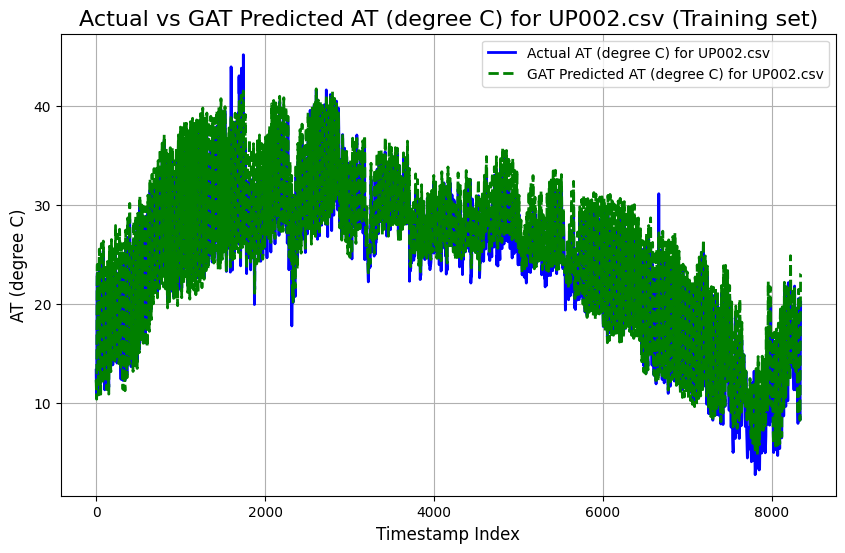

UP003.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2053
Mean Squared Error (MSE): 2.4290
Root Mean Squared Error (RMSE): 1.5585
Pearson Correlation Coefficient: 0.9868
R-squared (R²): 0.9681

----------------------------------------



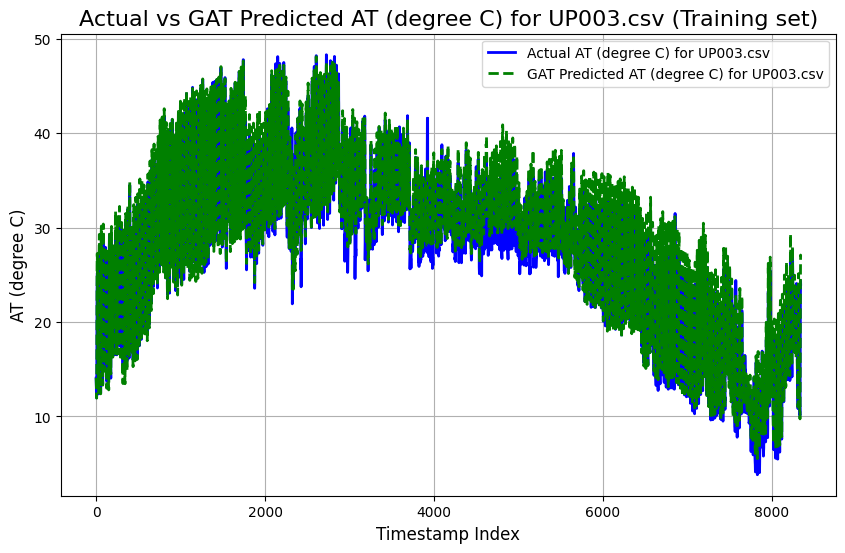

UP004.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2392
Mean Squared Error (MSE): 2.2817
Root Mean Squared Error (RMSE): 1.5105
Pearson Correlation Coefficient: 0.9889
R-squared (R²): 0.9728

----------------------------------------



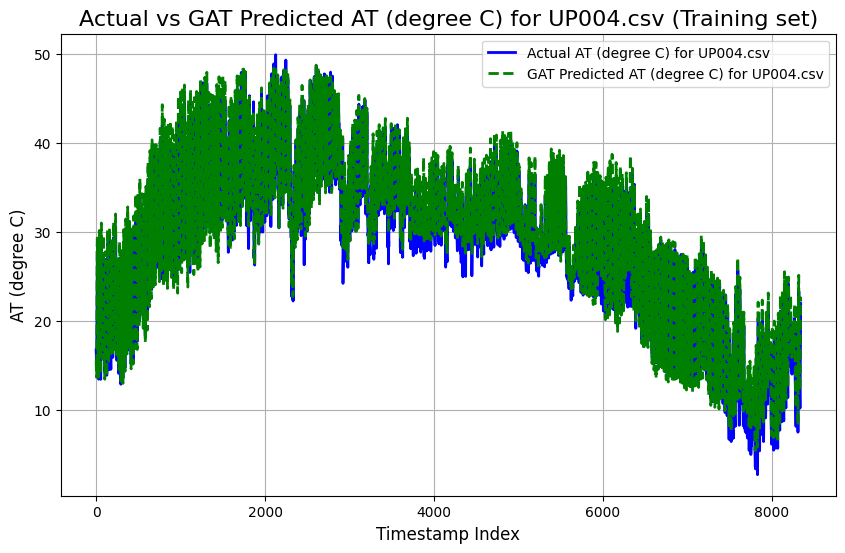

UP008.csv (Training set) Metrics:
Mean Absolute Error (MAE): 5.1288
Mean Squared Error (MSE): 55.5466
Root Mean Squared Error (RMSE): 7.4530
Pearson Correlation Coefficient: 0.8116
R-squared (R²): 0.6301

----------------------------------------



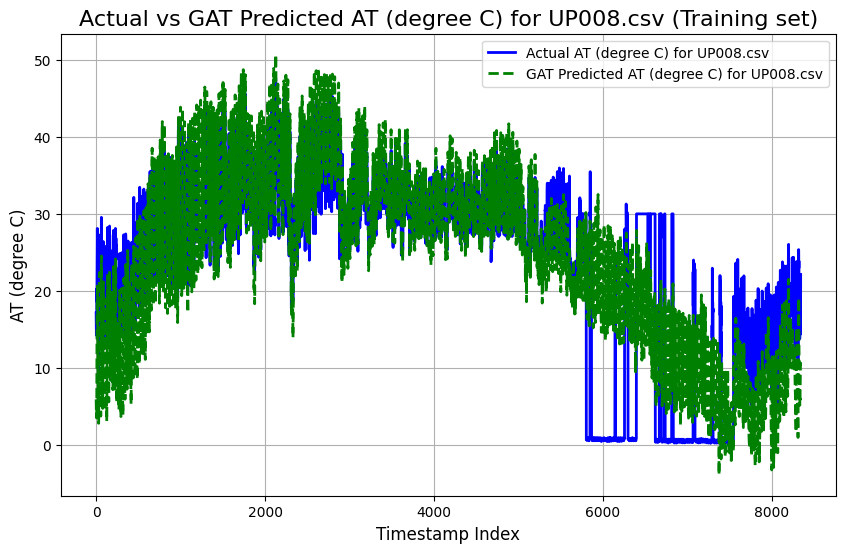

UP009.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1129
Mean Squared Error (MSE): 1.9510
Root Mean Squared Error (RMSE): 1.3968
Pearson Correlation Coefficient: 0.9858
R-squared (R²): 0.9680

----------------------------------------



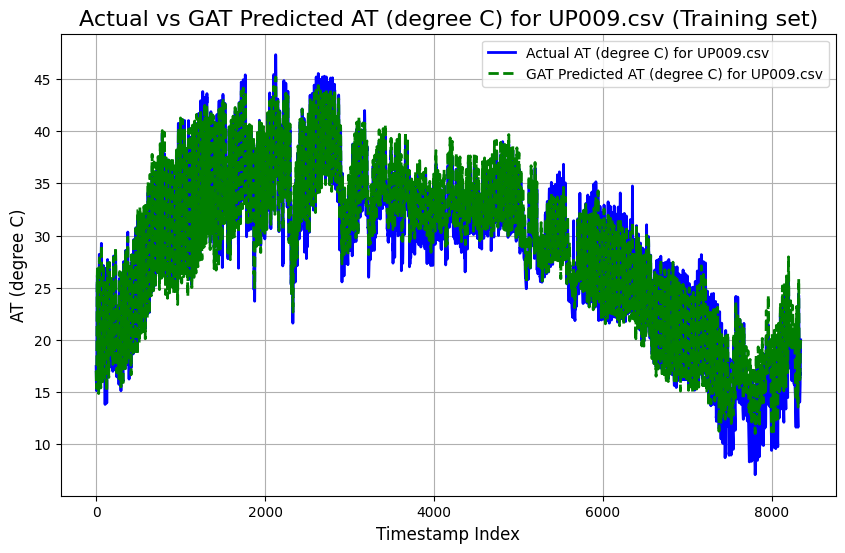

UP012.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4176
Mean Squared Error (MSE): 3.9996
Root Mean Squared Error (RMSE): 1.9999
Pearson Correlation Coefficient: 0.9834
R-squared (R²): 0.9631

----------------------------------------



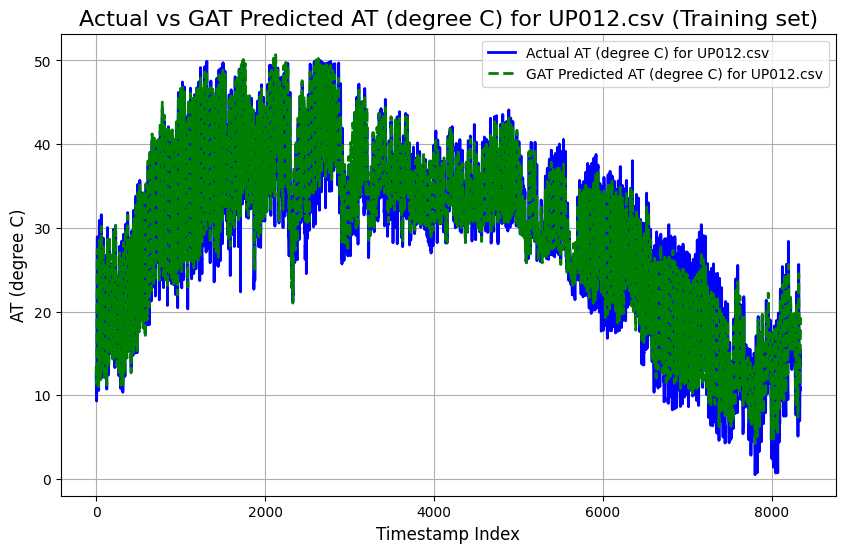

UP014.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.9598
Mean Squared Error (MSE): 13.0527
Root Mean Squared Error (RMSE): 3.6129
Pearson Correlation Coefficient: 0.9532
R-squared (R²): 0.9018

----------------------------------------



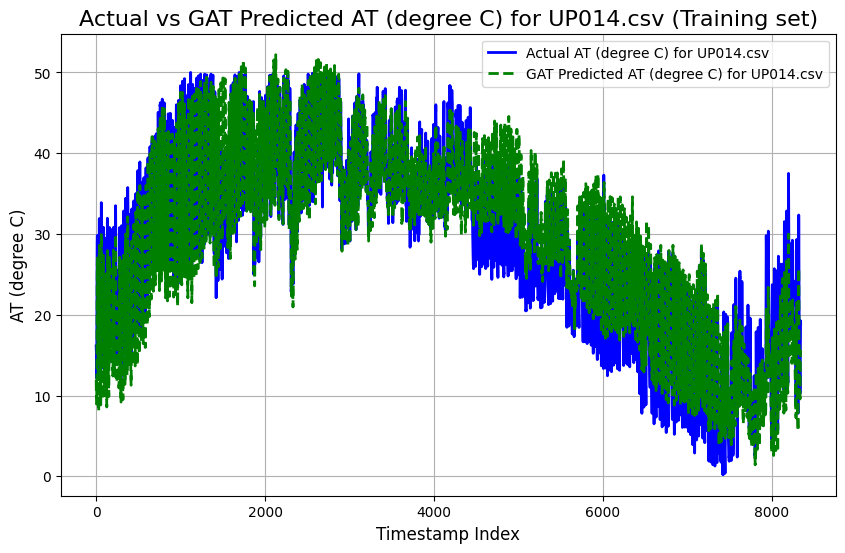

UP016.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.8001
Mean Squared Error (MSE): 12.0800
Root Mean Squared Error (RMSE): 3.4756
Pearson Correlation Coefficient: 0.9578
R-squared (R²): 0.9114

----------------------------------------



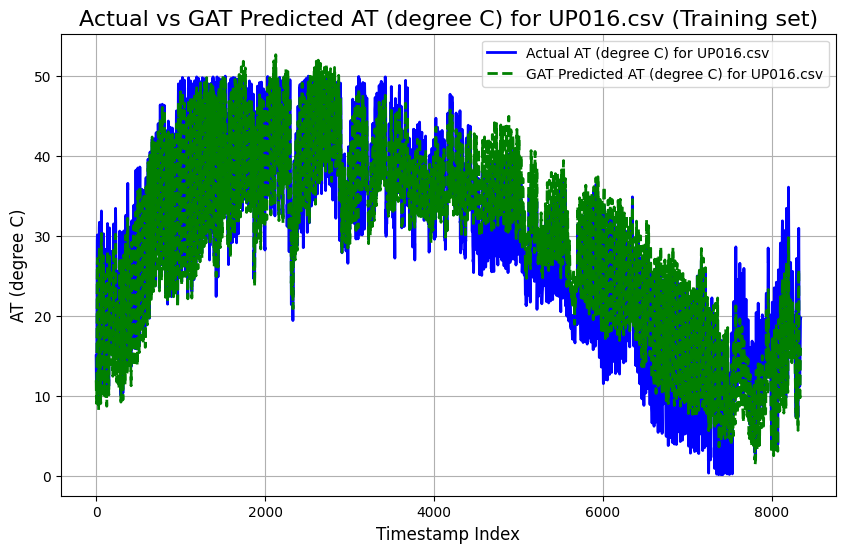

UP017.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.8758
Mean Squared Error (MSE): 1.1193
Root Mean Squared Error (RMSE): 1.0580
Pearson Correlation Coefficient: 0.9847
R-squared (R²): 0.9657

----------------------------------------



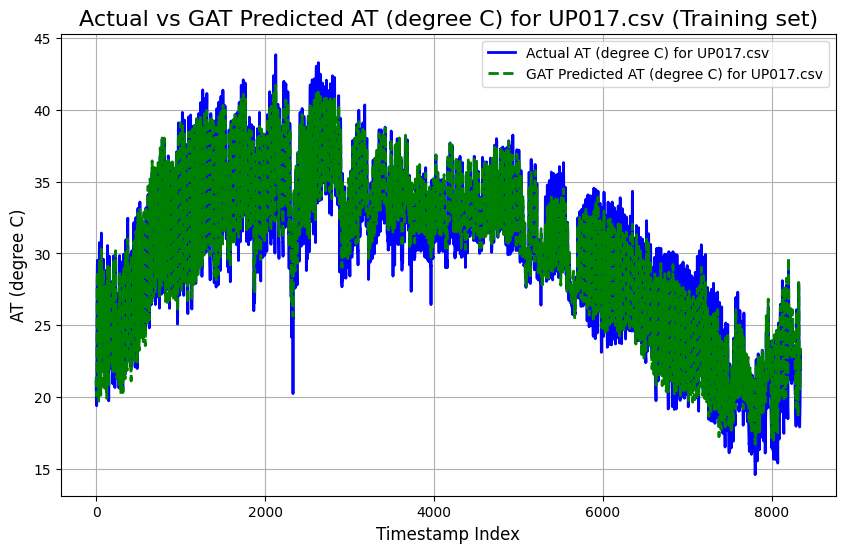

UP018.csv (Training set) Metrics:
Mean Absolute Error (MAE): 4.6422
Mean Squared Error (MSE): 42.7715
Root Mean Squared Error (RMSE): 6.5400
Pearson Correlation Coefficient: 0.5477
R-squared (R²): 0.1150

----------------------------------------



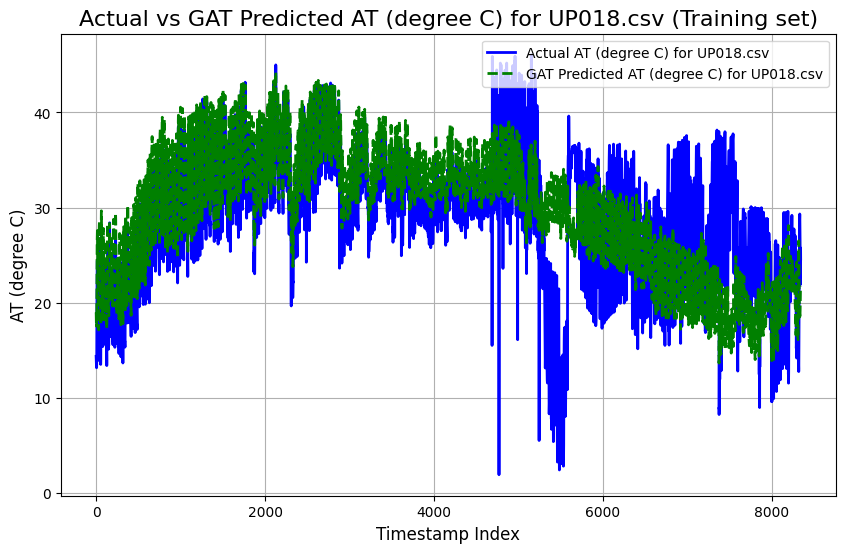

UP019.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5075
Mean Squared Error (MSE): 5.0321
Root Mean Squared Error (RMSE): 2.2432
Pearson Correlation Coefficient: 0.9353
R-squared (R²): 0.8688

----------------------------------------



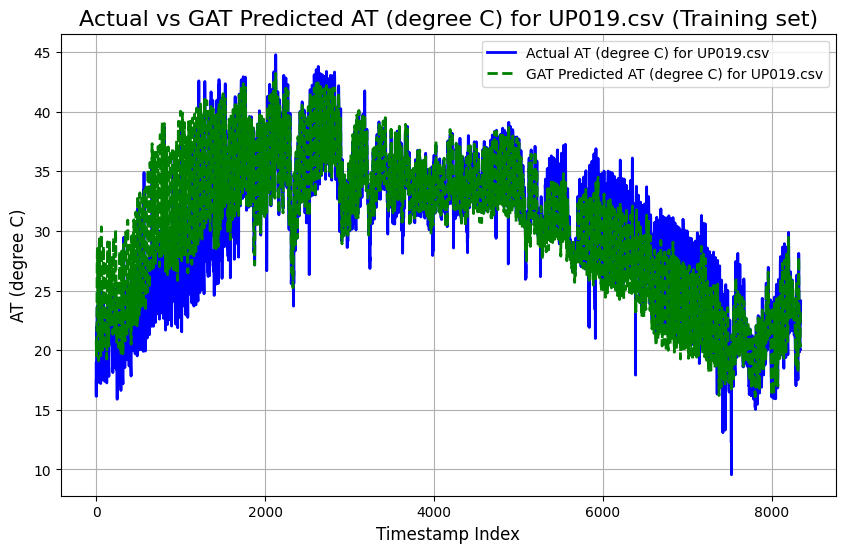

UP020.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2064
Mean Squared Error (MSE): 2.1964
Root Mean Squared Error (RMSE): 1.4820
Pearson Correlation Coefficient: 0.9824
R-squared (R²): 0.9613

----------------------------------------



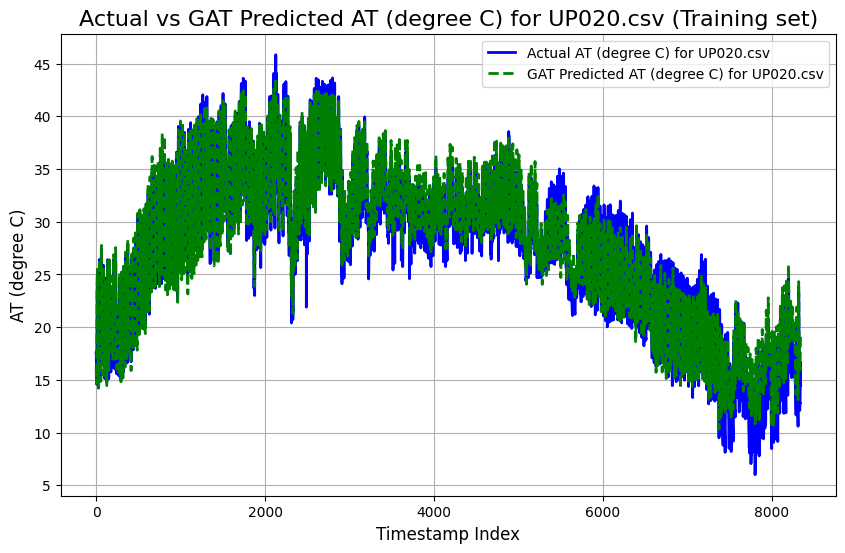

UP021.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.5639
Mean Squared Error (MSE): 21.4599
Root Mean Squared Error (RMSE): 4.6325
Pearson Correlation Coefficient: 0.8629
R-squared (R²): 0.7296

----------------------------------------



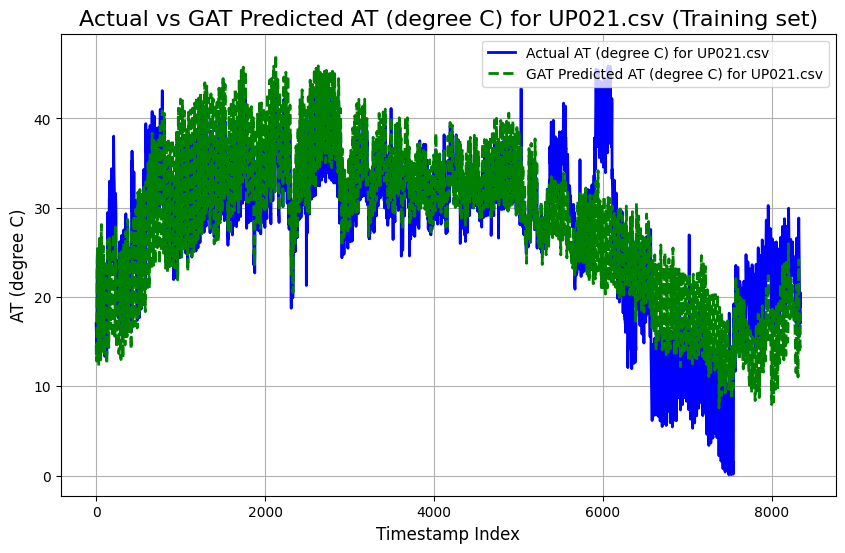

UP022.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2641
Mean Squared Error (MSE): 3.0143
Root Mean Squared Error (RMSE): 1.7362
Pearson Correlation Coefficient: 0.9752
R-squared (R²): 0.9474

----------------------------------------



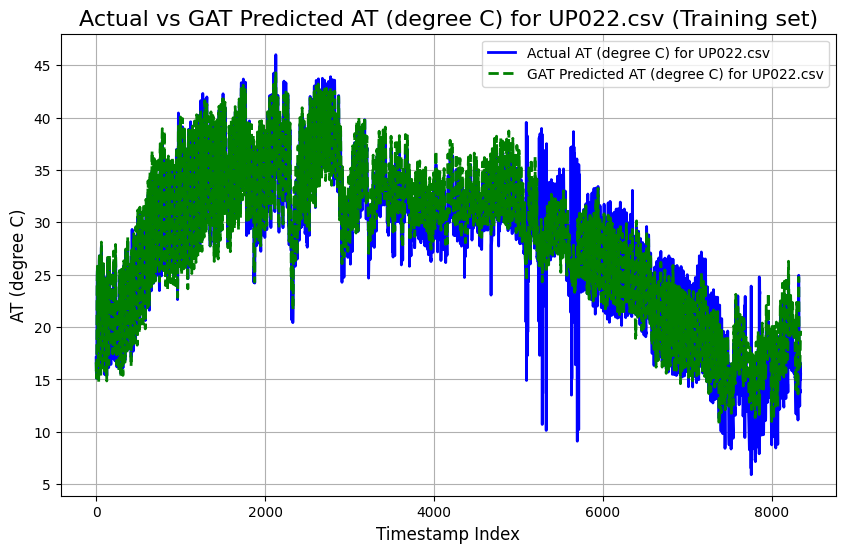

UP023.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2918
Mean Squared Error (MSE): 3.5573
Root Mean Squared Error (RMSE): 1.8861
Pearson Correlation Coefficient: 0.9724
R-squared (R²): 0.9406

----------------------------------------



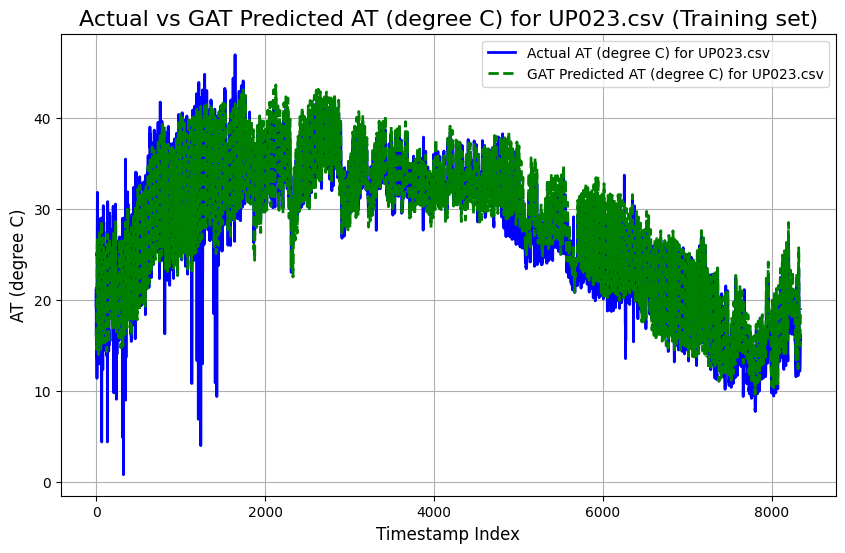

UP024.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.6526
Mean Squared Error (MSE): 13.3963
Root Mean Squared Error (RMSE): 3.6601
Pearson Correlation Coefficient: 0.8370
R-squared (R²): 0.6623

----------------------------------------



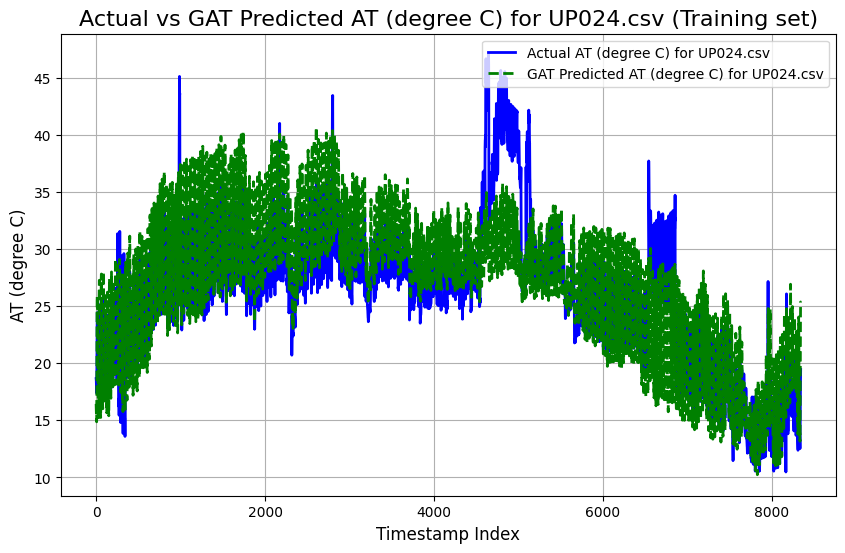

UP025.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0202
Mean Squared Error (MSE): 1.7677
Root Mean Squared Error (RMSE): 1.3295
Pearson Correlation Coefficient: 0.9872
R-squared (R²): 0.9703

----------------------------------------



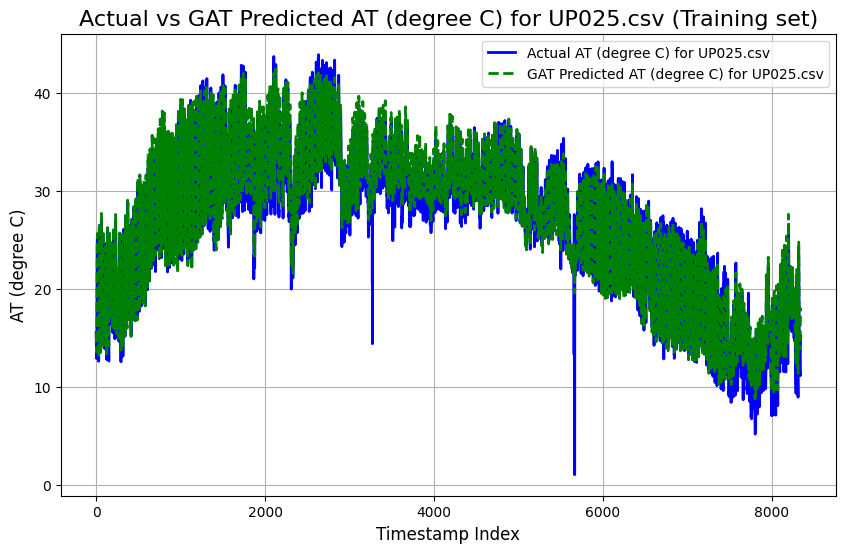

UP026.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0190
Mean Squared Error (MSE): 1.7003
Root Mean Squared Error (RMSE): 1.3040
Pearson Correlation Coefficient: 0.9897
R-squared (R²): 0.9752

----------------------------------------



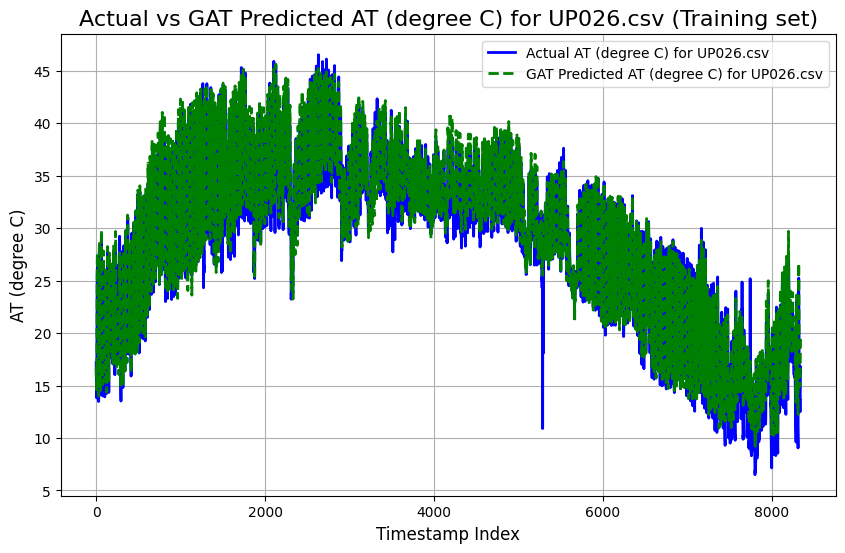

UP028.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.7763
Mean Squared Error (MSE): 4.8905
Root Mean Squared Error (RMSE): 2.2114
Pearson Correlation Coefficient: 0.9765
R-squared (R²): 0.9474

----------------------------------------



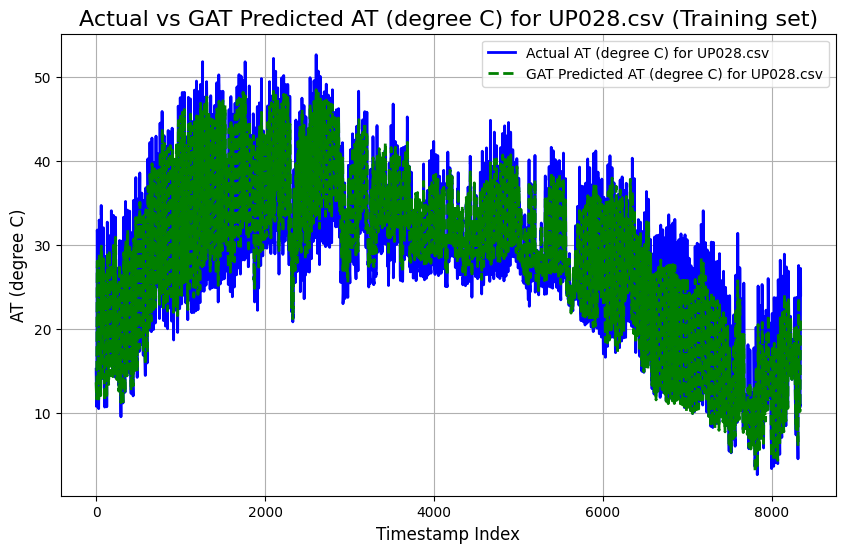

UP029.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.9427
Mean Squared Error (MSE): 1.6496
Root Mean Squared Error (RMSE): 1.2844
Pearson Correlation Coefficient: 0.9891
R-squared (R²): 0.9728

----------------------------------------



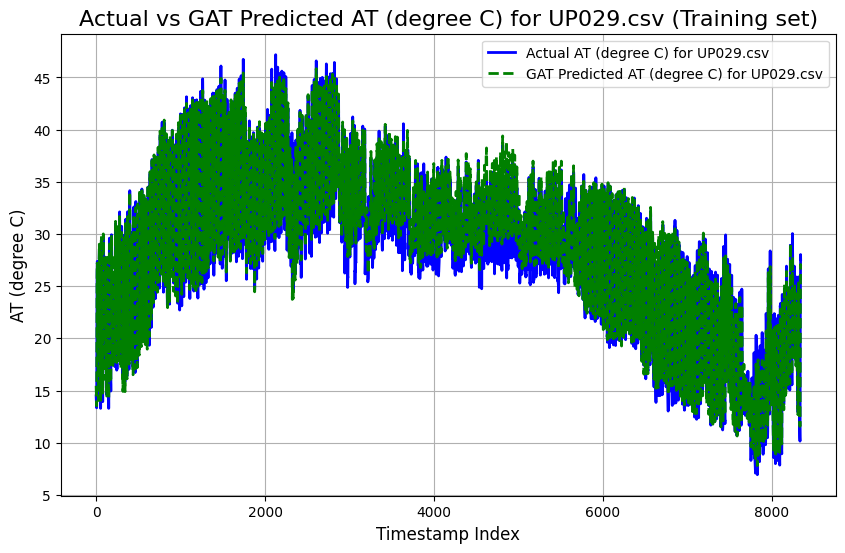

UP030.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2357
Mean Squared Error (MSE): 2.4808
Root Mean Squared Error (RMSE): 1.5751
Pearson Correlation Coefficient: 0.9873
R-squared (R²): 0.9696

----------------------------------------



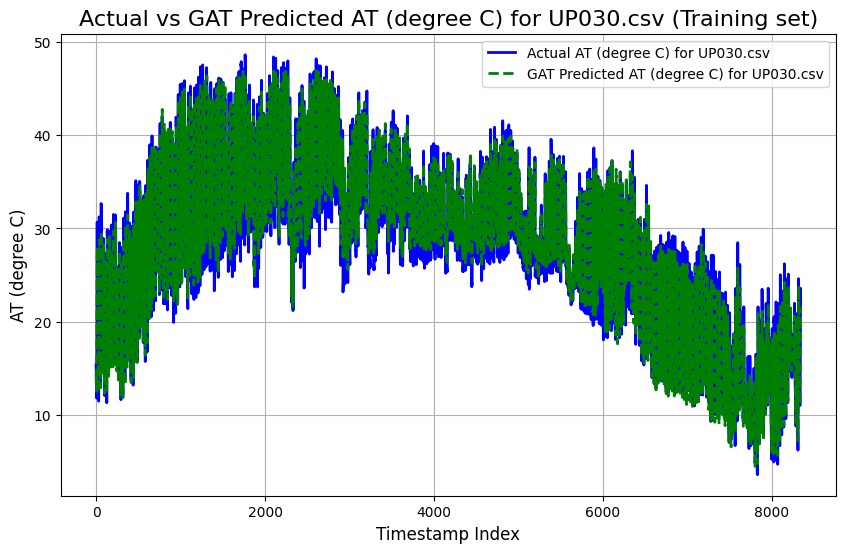

UP031.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5018
Mean Squared Error (MSE): 3.6608
Root Mean Squared Error (RMSE): 1.9133
Pearson Correlation Coefficient: 0.9763
R-squared (R²): 0.9466

----------------------------------------



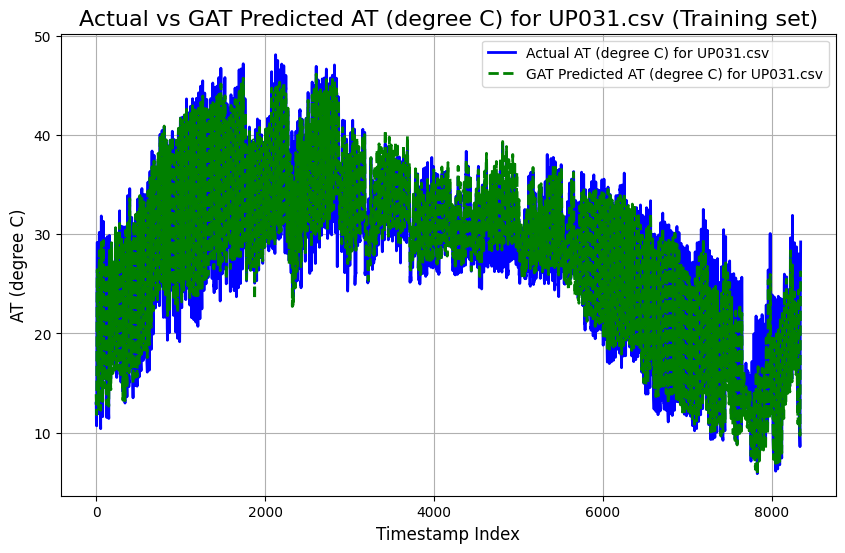

UP032.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4470
Mean Squared Error (MSE): 3.6526
Root Mean Squared Error (RMSE): 1.9112
Pearson Correlation Coefficient: 0.9691
R-squared (R²): 0.9318

----------------------------------------



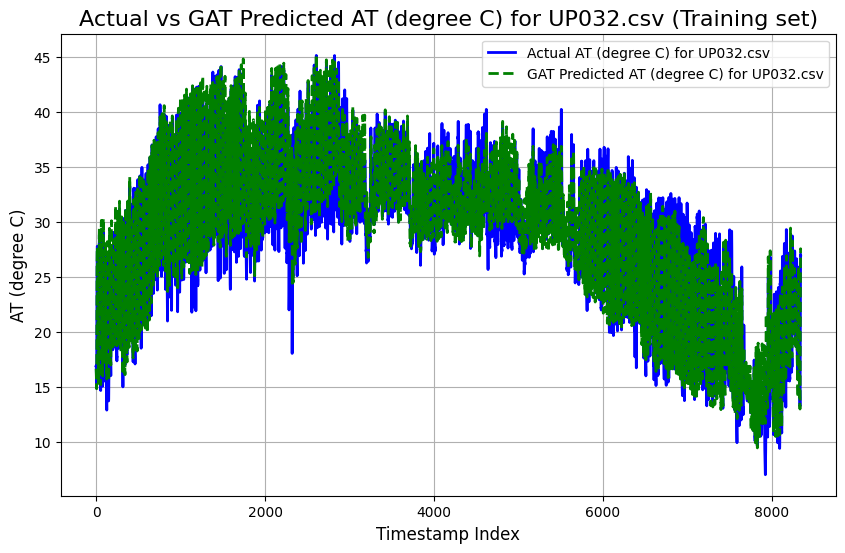

UP033.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.9121
Mean Squared Error (MSE): 1.5183
Root Mean Squared Error (RMSE): 1.2322
Pearson Correlation Coefficient: 0.9906
R-squared (R²): 0.9760

----------------------------------------



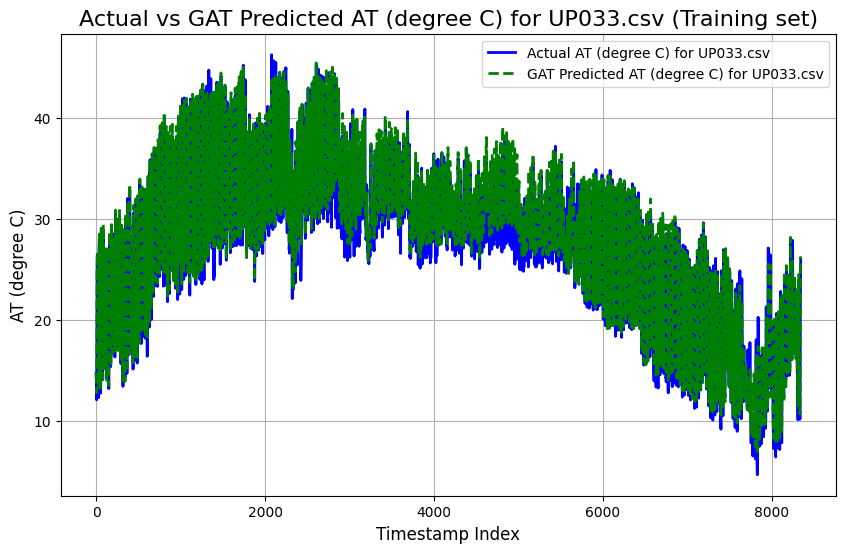

UP034.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4132
Mean Squared Error (MSE): 4.3624
Root Mean Squared Error (RMSE): 2.0886
Pearson Correlation Coefficient: 0.9790
R-squared (R²): 0.9525

----------------------------------------



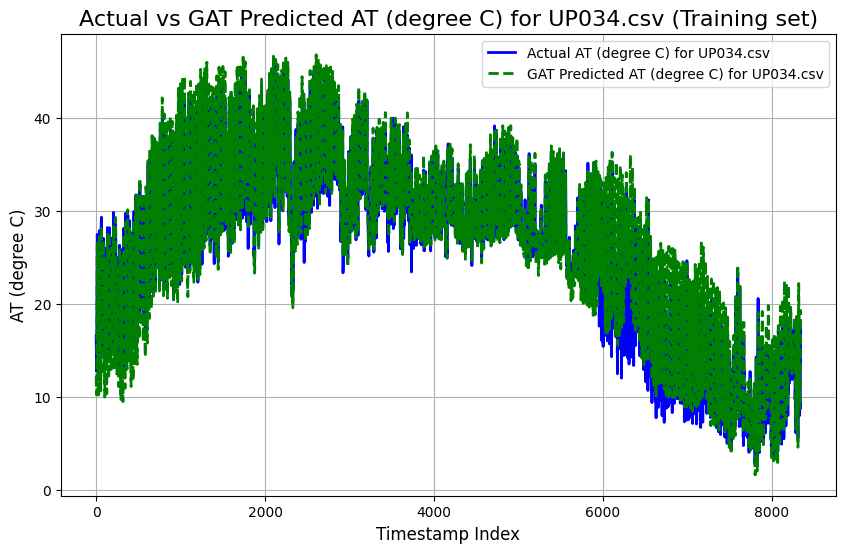

UP035.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0328
Mean Squared Error (MSE): 1.7878
Root Mean Squared Error (RMSE): 1.3371
Pearson Correlation Coefficient: 0.9898
R-squared (R²): 0.9745

----------------------------------------



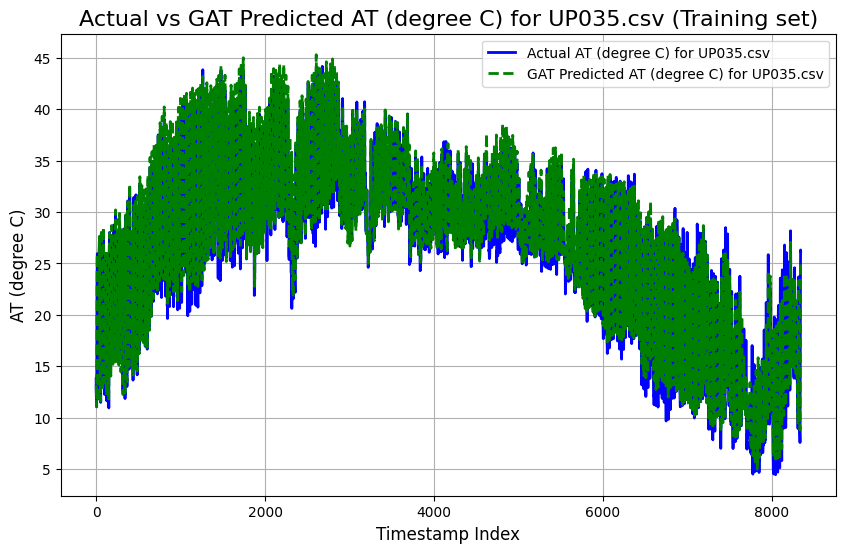

UP036.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0472
Mean Squared Error (MSE): 2.0740
Root Mean Squared Error (RMSE): 1.4401
Pearson Correlation Coefficient: 0.9859
R-squared (R²): 0.9664

----------------------------------------



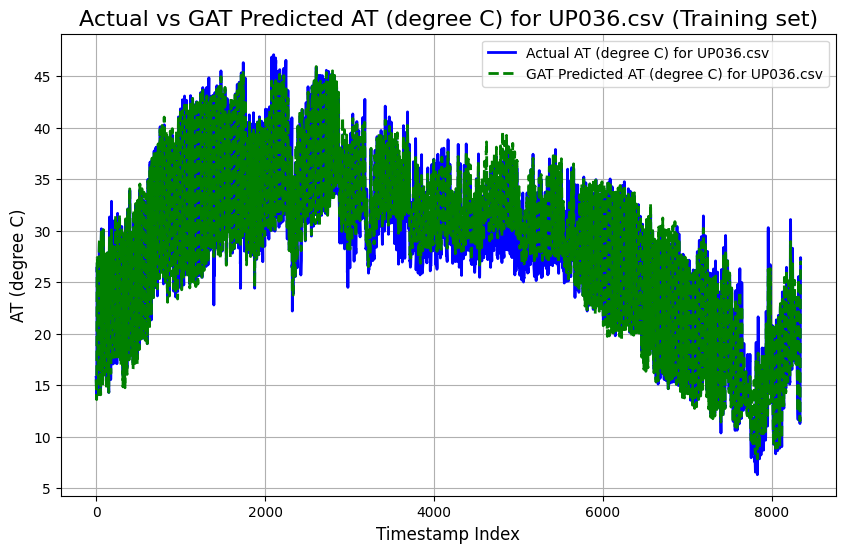

UP037.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1110
Mean Squared Error (MSE): 2.0858
Root Mean Squared Error (RMSE): 1.4442
Pearson Correlation Coefficient: 0.9890
R-squared (R²): 0.9731

----------------------------------------



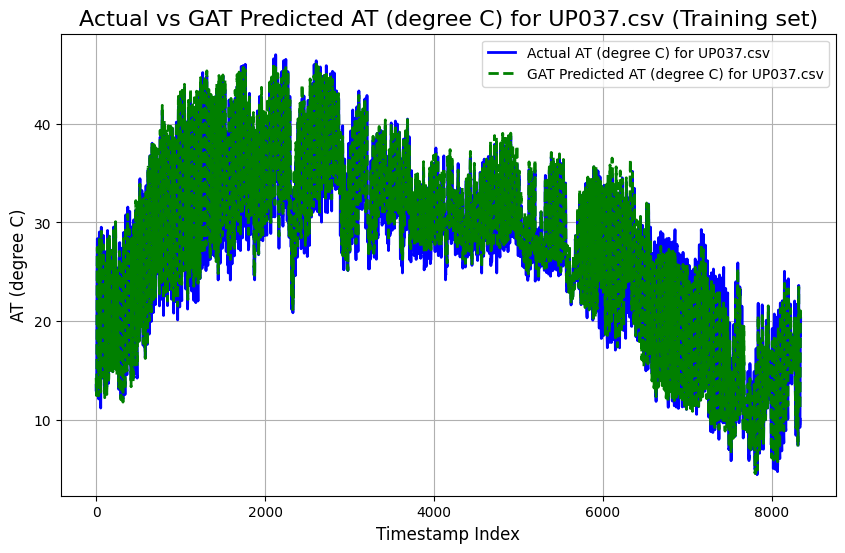

UP038.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.9948
Mean Squared Error (MSE): 1.9032
Root Mean Squared Error (RMSE): 1.3796
Pearson Correlation Coefficient: 0.9868
R-squared (R²): 0.9684

----------------------------------------



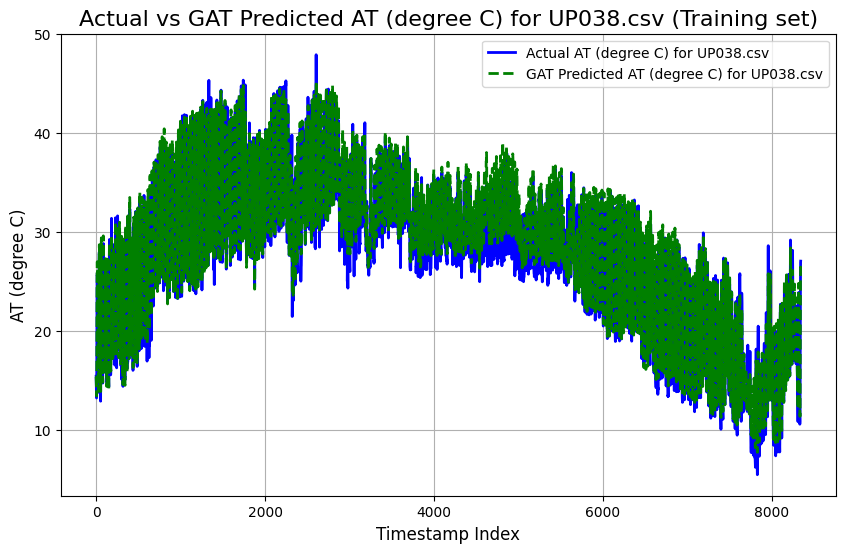

UP039.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5756
Mean Squared Error (MSE): 4.2046
Root Mean Squared Error (RMSE): 2.0505
Pearson Correlation Coefficient: 0.9764
R-squared (R²): 0.9471

----------------------------------------



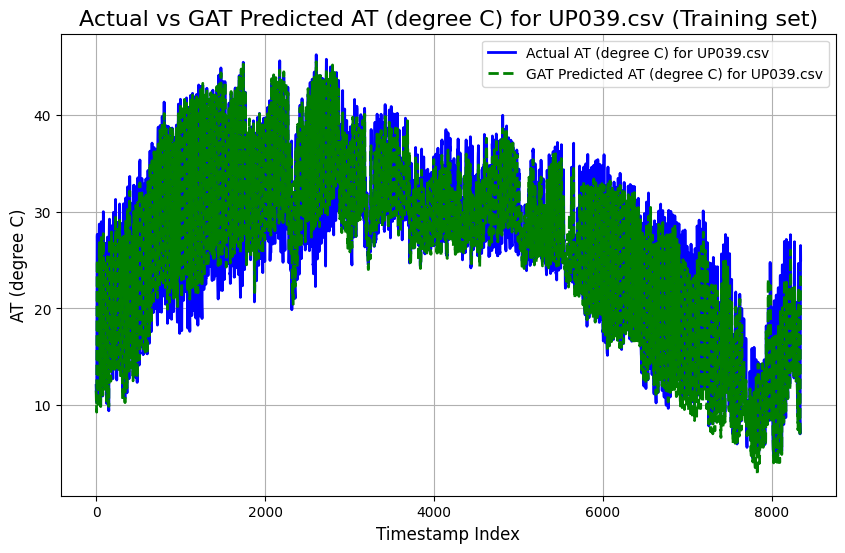

UP040.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3351
Mean Squared Error (MSE): 3.0094
Root Mean Squared Error (RMSE): 1.7348
Pearson Correlation Coefficient: 0.9839
R-squared (R²): 0.9626

----------------------------------------



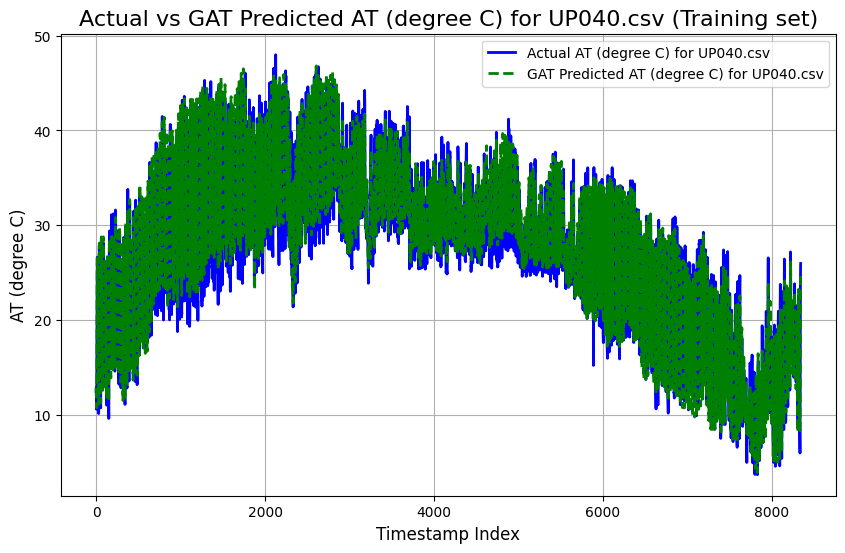

UP041.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.9998
Mean Squared Error (MSE): 1.7914
Root Mean Squared Error (RMSE): 1.3384
Pearson Correlation Coefficient: 0.9873
R-squared (R²): 0.9690

----------------------------------------



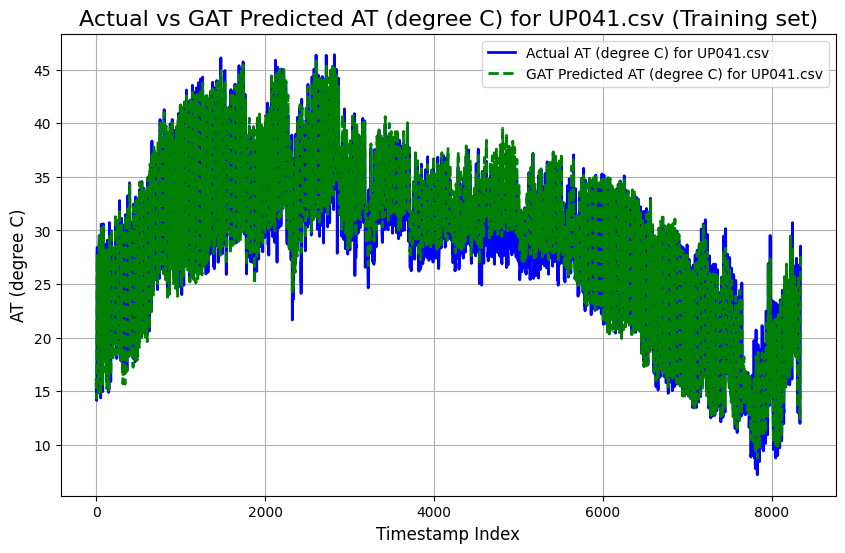

UP042.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0924
Mean Squared Error (MSE): 2.4459
Root Mean Squared Error (RMSE): 1.5639
Pearson Correlation Coefficient: 0.9847
R-squared (R²): 0.9643

----------------------------------------



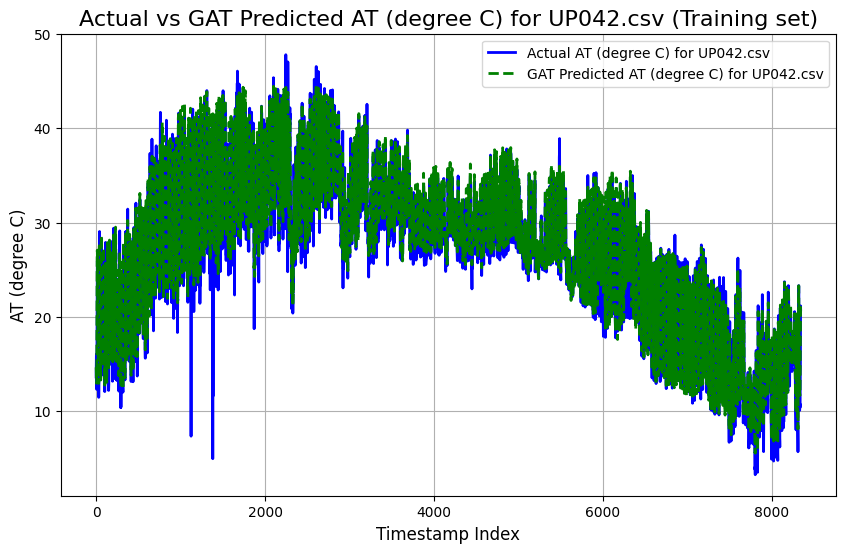

UP043.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0963
Mean Squared Error (MSE): 2.1610
Root Mean Squared Error (RMSE): 1.4700
Pearson Correlation Coefficient: 0.9881
R-squared (R²): 0.9712

----------------------------------------



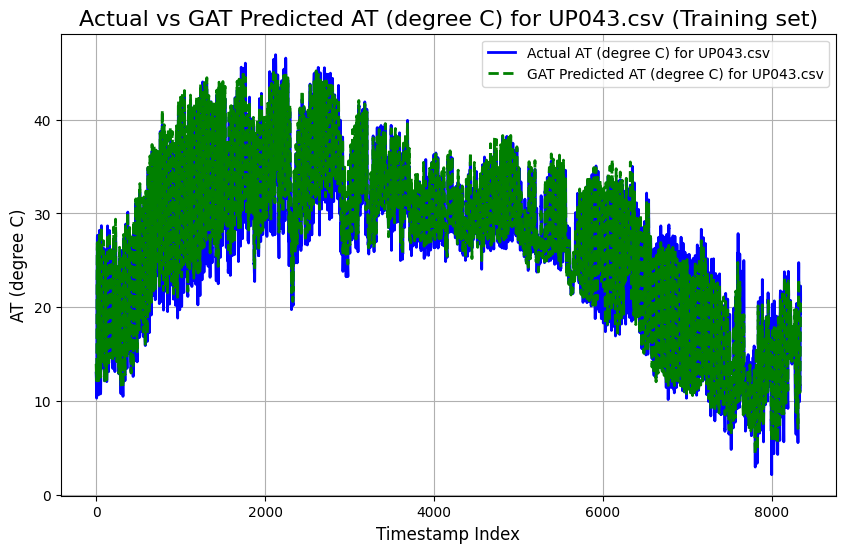

UP044.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1381
Mean Squared Error (MSE): 2.2307
Root Mean Squared Error (RMSE): 1.4935
Pearson Correlation Coefficient: 0.9882
R-squared (R²): 0.9713

----------------------------------------



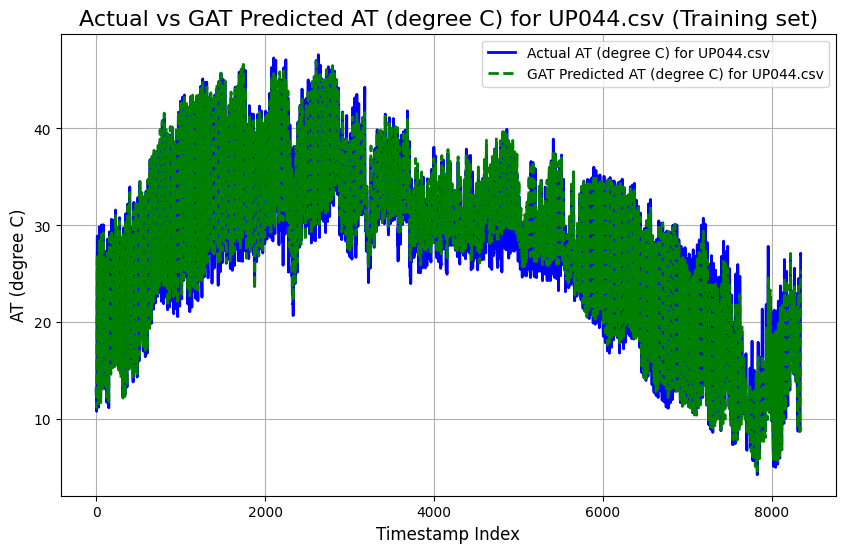

UP046.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4092
Mean Squared Error (MSE): 3.1805
Root Mean Squared Error (RMSE): 1.7834
Pearson Correlation Coefficient: 0.9798
R-squared (R²): 0.9544

----------------------------------------



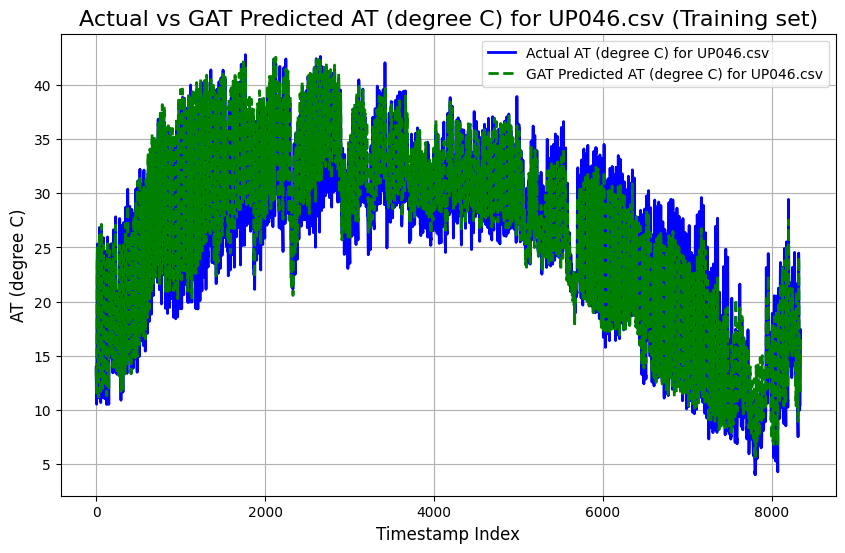

UP048.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5179
Mean Squared Error (MSE): 3.9070
Root Mean Squared Error (RMSE): 1.9766
Pearson Correlation Coefficient: 0.9736
R-squared (R²): 0.9418

----------------------------------------



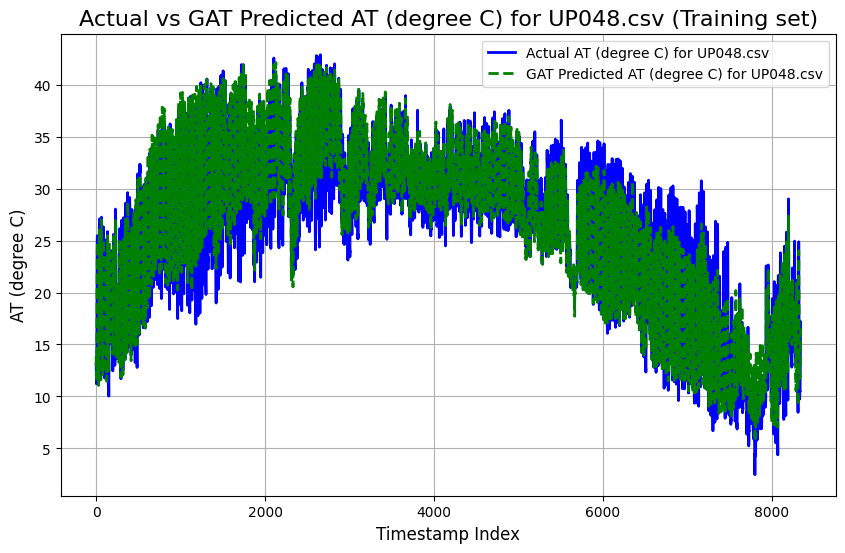

UP049.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3357
Mean Squared Error (MSE): 3.0893
Root Mean Squared Error (RMSE): 1.7576
Pearson Correlation Coefficient: 0.9809
R-squared (R²): 0.9567

----------------------------------------



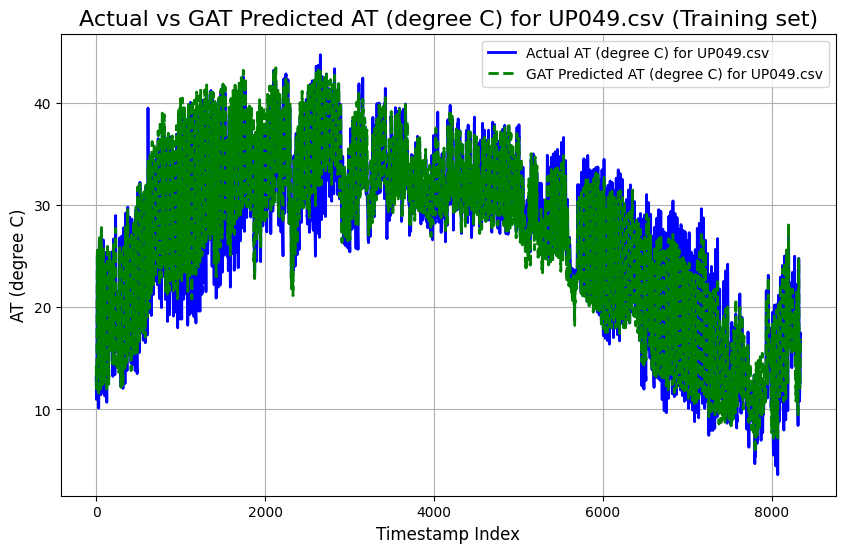

UP050.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4960
Mean Squared Error (MSE): 4.2082
Root Mean Squared Error (RMSE): 2.0514
Pearson Correlation Coefficient: 0.9668
R-squared (R²): 0.9305

----------------------------------------



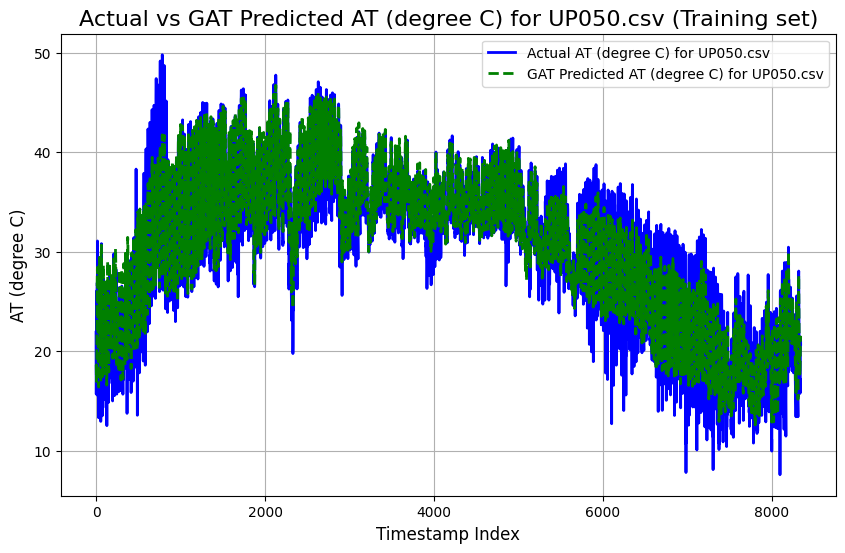

UP051.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.6098
Mean Squared Error (MSE): 21.3978
Root Mean Squared Error (RMSE): 4.6258
Pearson Correlation Coefficient: 0.8559
R-squared (R²): 0.7014

----------------------------------------



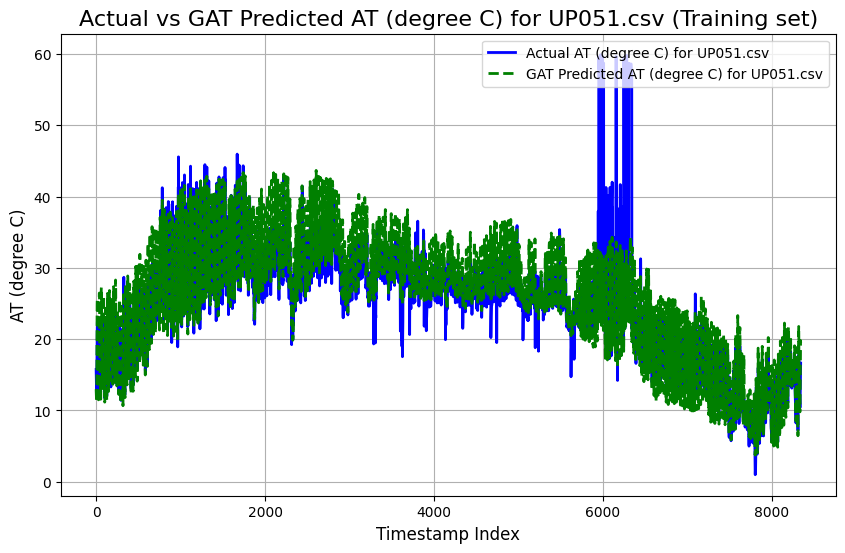

UP052.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5649
Mean Squared Error (MSE): 4.2318
Root Mean Squared Error (RMSE): 2.0571
Pearson Correlation Coefficient: 0.9722
R-squared (R²): 0.9386

----------------------------------------



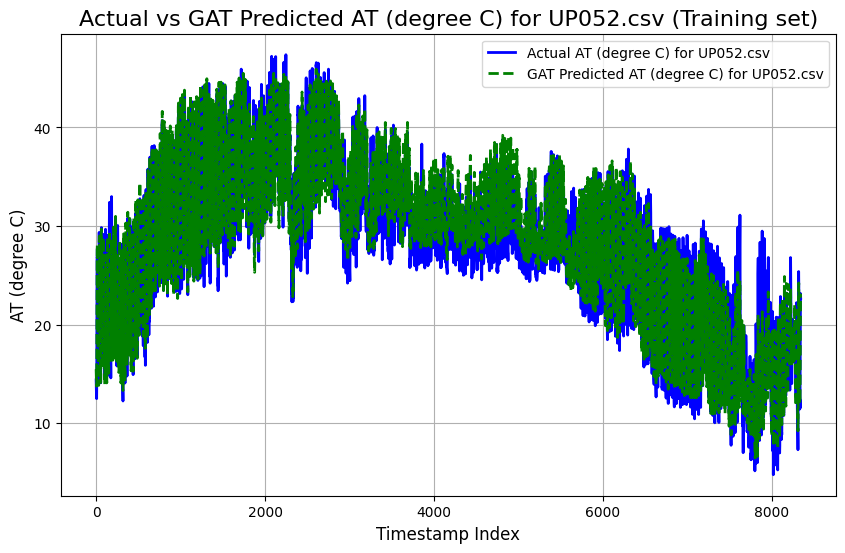

UP002.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1668
Mean Squared Error (MSE): 2.1318
Root Mean Squared Error (RMSE): 1.4601
Pearson Correlation Coefficient: 0.9717
R-squared (R²): 0.9248

----------------------------------------



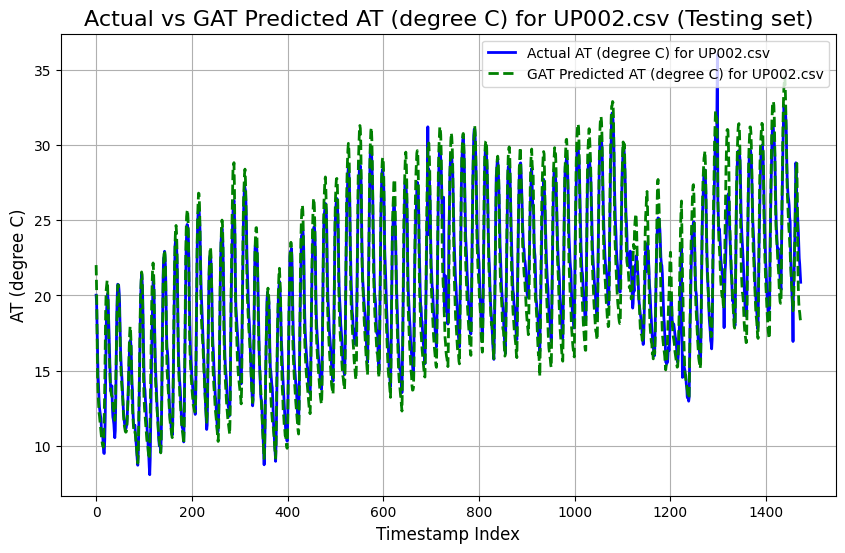

UP003.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3072
Mean Squared Error (MSE): 2.3221
Root Mean Squared Error (RMSE): 1.5239
Pearson Correlation Coefficient: 0.9789
R-squared (R²): 0.9384

----------------------------------------



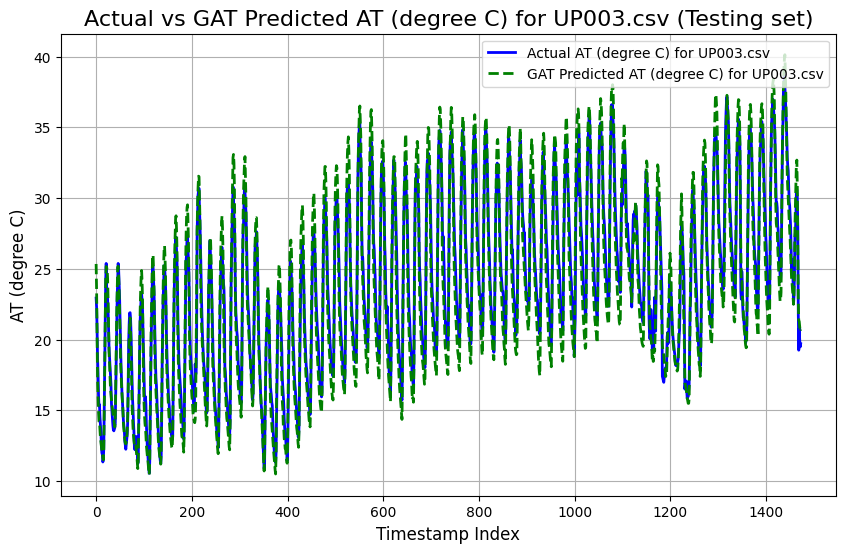

UP004.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3216
Mean Squared Error (MSE): 2.5917
Root Mean Squared Error (RMSE): 1.6099
Pearson Correlation Coefficient: 0.9704
R-squared (R²): 0.9245

----------------------------------------



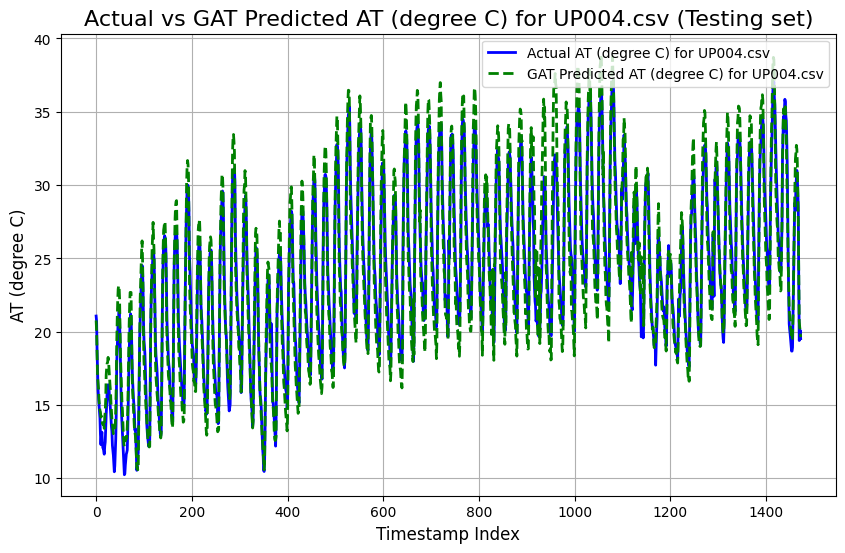

UP008.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 5.2115
Mean Squared Error (MSE): 35.5877
Root Mean Squared Error (RMSE): 5.9655
Pearson Correlation Coefficient: 0.8684
R-squared (R²): -0.6457

----------------------------------------



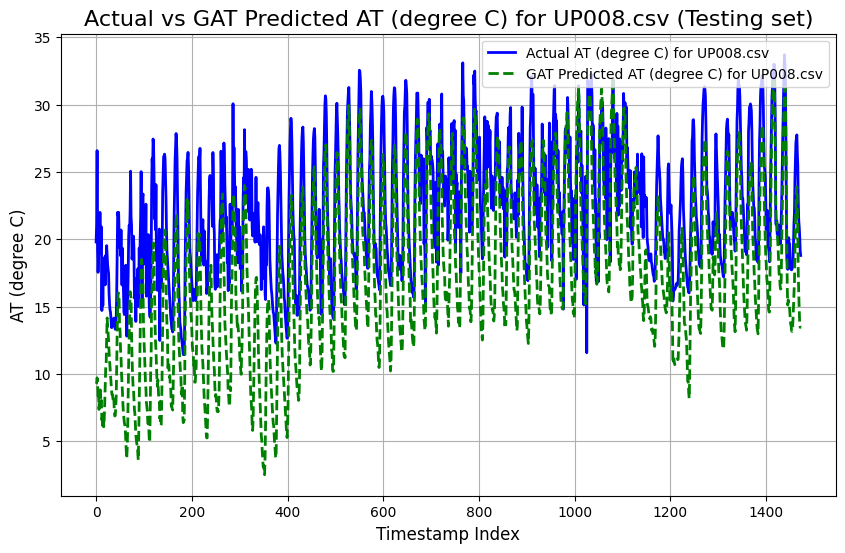

UP009.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7863
Mean Squared Error (MSE): 1.2826
Root Mean Squared Error (RMSE): 1.1325
Pearson Correlation Coefficient: 0.9763
R-squared (R²): 0.9391

----------------------------------------



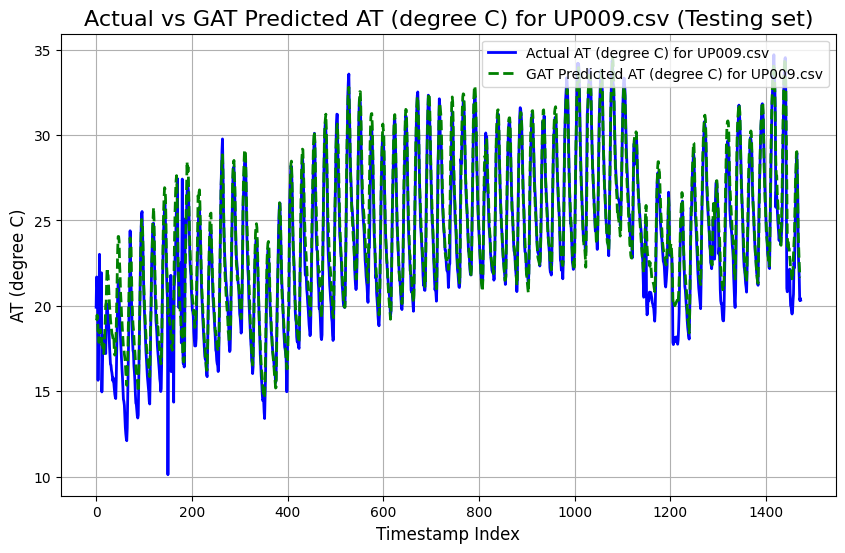

UP012.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3517
Mean Squared Error (MSE): 3.1498
Root Mean Squared Error (RMSE): 1.7748
Pearson Correlation Coefficient: 0.9644
R-squared (R²): 0.9286

----------------------------------------



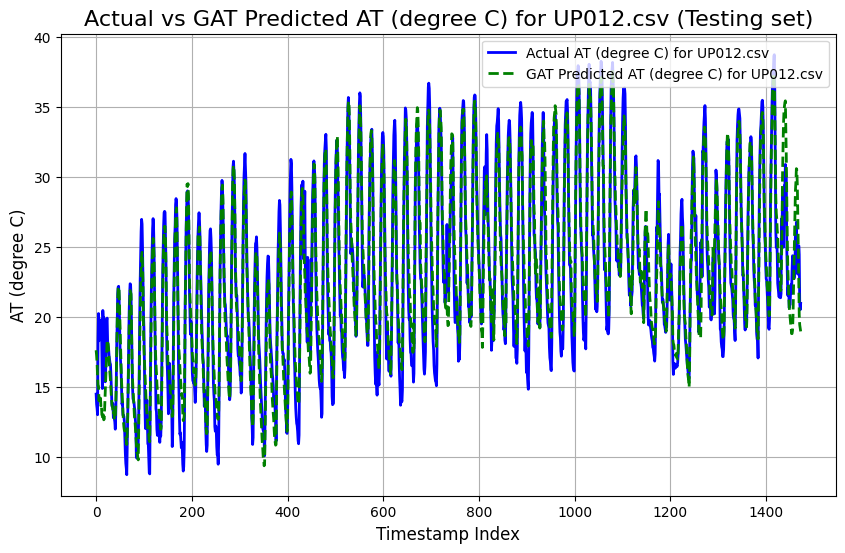

UP014.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 5.3544
Mean Squared Error (MSE): 31.7210
Root Mean Squared Error (RMSE): 5.6321
Pearson Correlation Coefficient: 0.9712
R-squared (R²): 0.5016

----------------------------------------



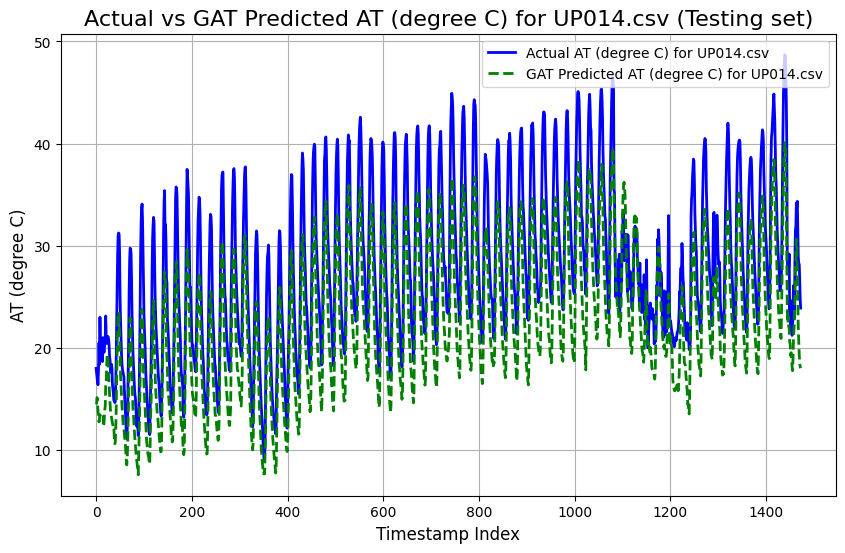

UP016.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 4.4822
Mean Squared Error (MSE): 22.2365
Root Mean Squared Error (RMSE): 4.7156
Pearson Correlation Coefficient: 0.9799
R-squared (R²): 0.6401

----------------------------------------



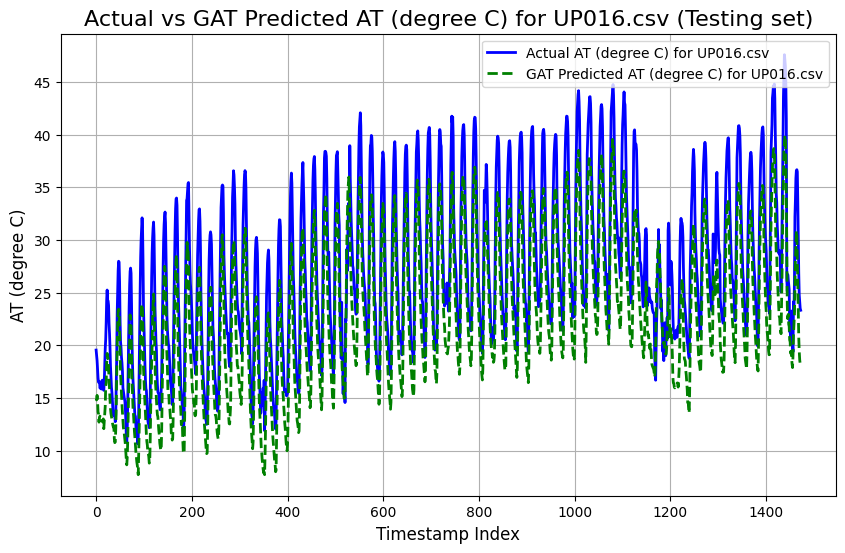

UP017.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7584
Mean Squared Error (MSE): 1.0640
Root Mean Squared Error (RMSE): 1.0315
Pearson Correlation Coefficient: 0.9687
R-squared (R²): 0.9214

----------------------------------------



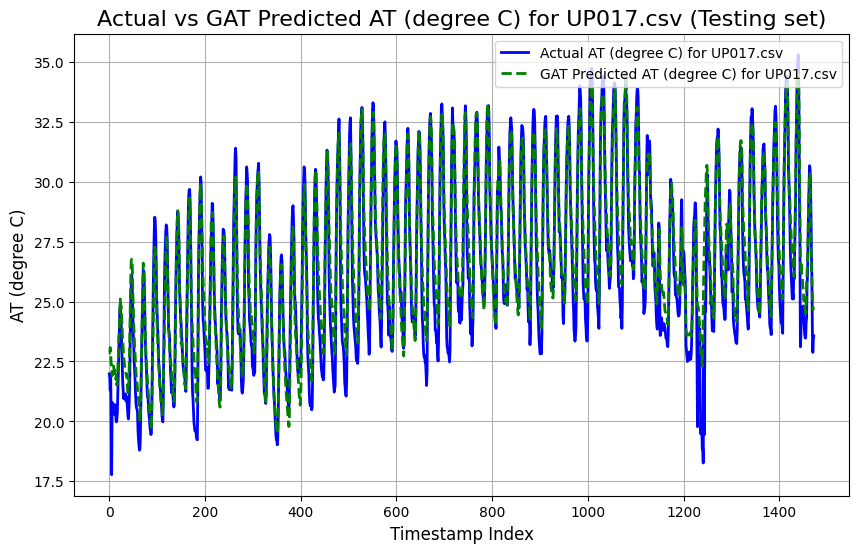

UP018.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 8.1712
Mean Squared Error (MSE): 104.6618
Root Mean Squared Error (RMSE): 10.2304
Pearson Correlation Coefficient: -0.6671
R-squared (R²): -2.8596

----------------------------------------



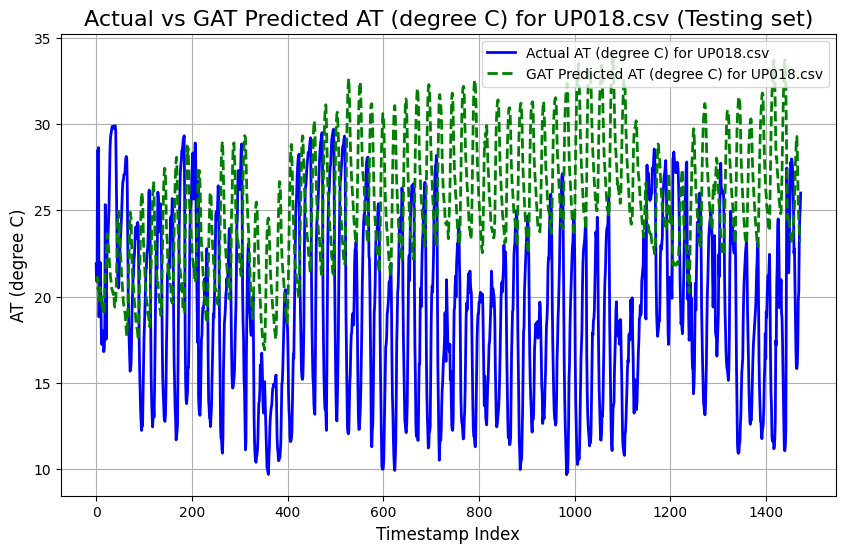

UP019.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.7547
Mean Squared Error (MSE): 3.7616
Root Mean Squared Error (RMSE): 1.9395
Pearson Correlation Coefficient: 0.9582
R-squared (R²): 0.7764

----------------------------------------



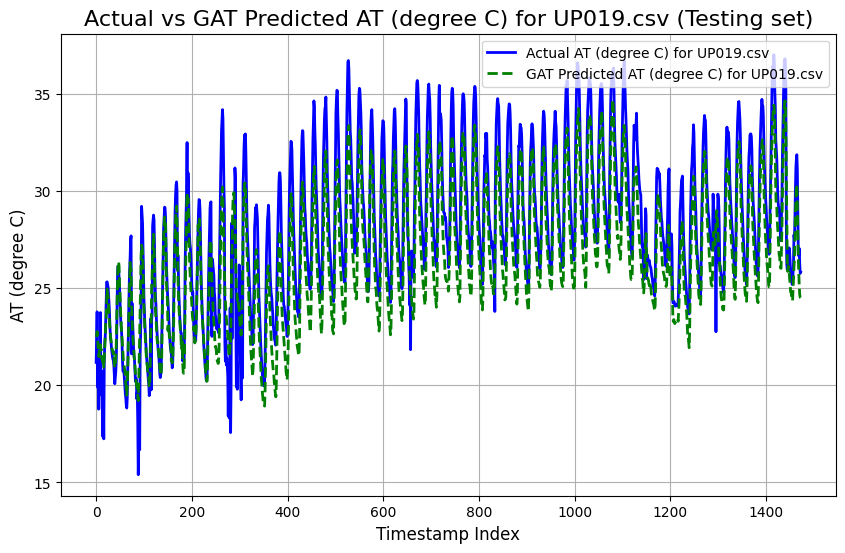

UP020.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8456
Mean Squared Error (MSE): 1.2447
Root Mean Squared Error (RMSE): 1.1157
Pearson Correlation Coefficient: 0.9787
R-squared (R²): 0.9381

----------------------------------------



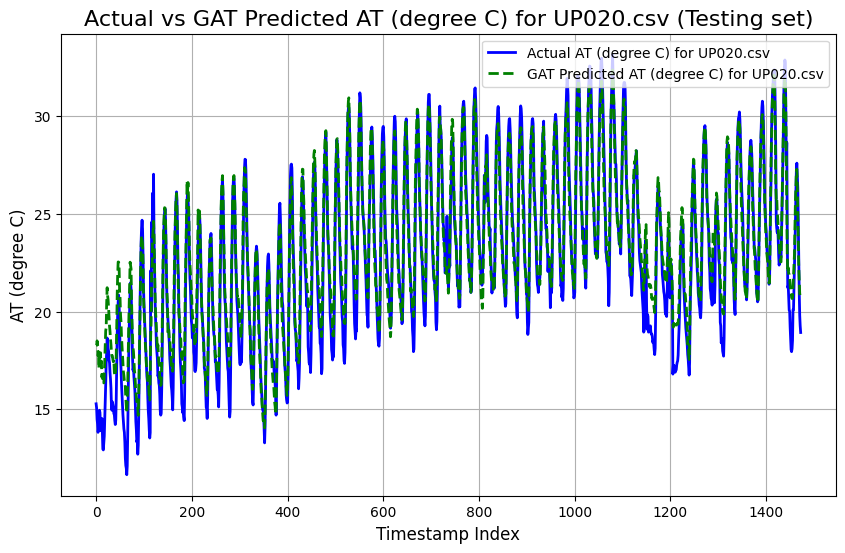

UP021.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 2.8323
Mean Squared Error (MSE): 12.2715
Root Mean Squared Error (RMSE): 3.5031
Pearson Correlation Coefficient: 0.8876
R-squared (R²): 0.3467

----------------------------------------



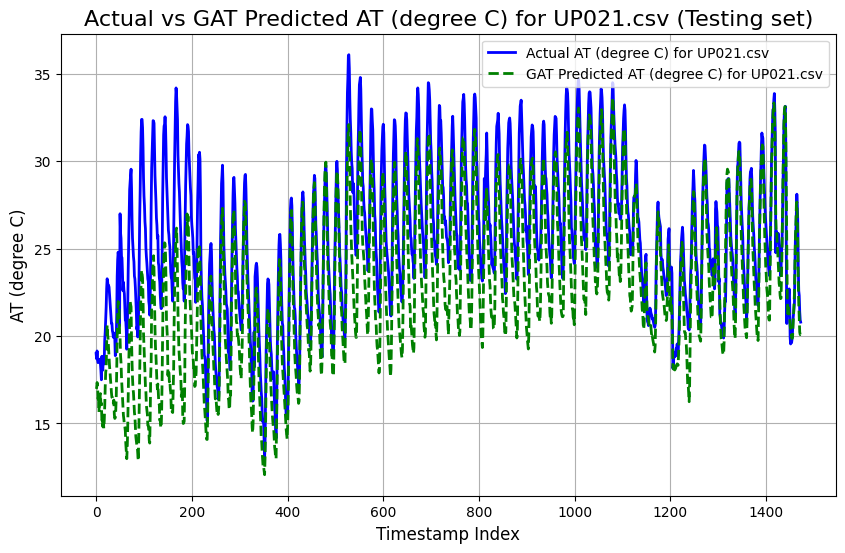

UP022.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8209
Mean Squared Error (MSE): 1.2217
Root Mean Squared Error (RMSE): 1.1053
Pearson Correlation Coefficient: 0.9801
R-squared (R²): 0.9374

----------------------------------------



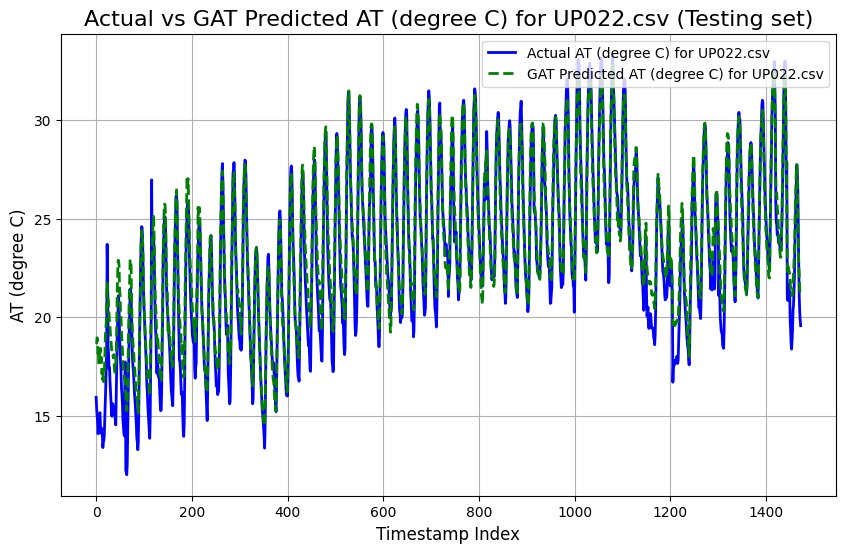

UP023.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.6856
Mean Squared Error (MSE): 3.6437
Root Mean Squared Error (RMSE): 1.9089
Pearson Correlation Coefficient: 0.9790
R-squared (R²): 0.7933

----------------------------------------



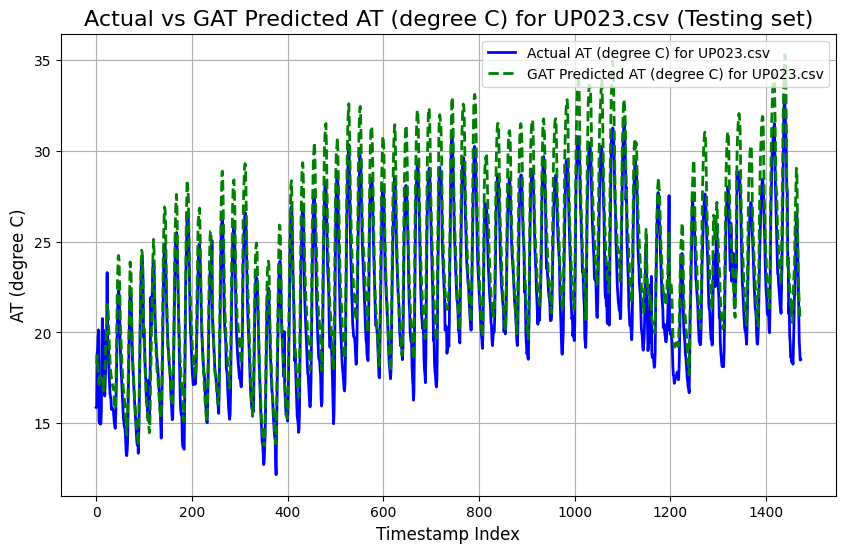

UP024.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.3483
Mean Squared Error (MSE): 15.6993
Root Mean Squared Error (RMSE): 3.9622
Pearson Correlation Coefficient: 0.9609
R-squared (R²): -0.7513

----------------------------------------



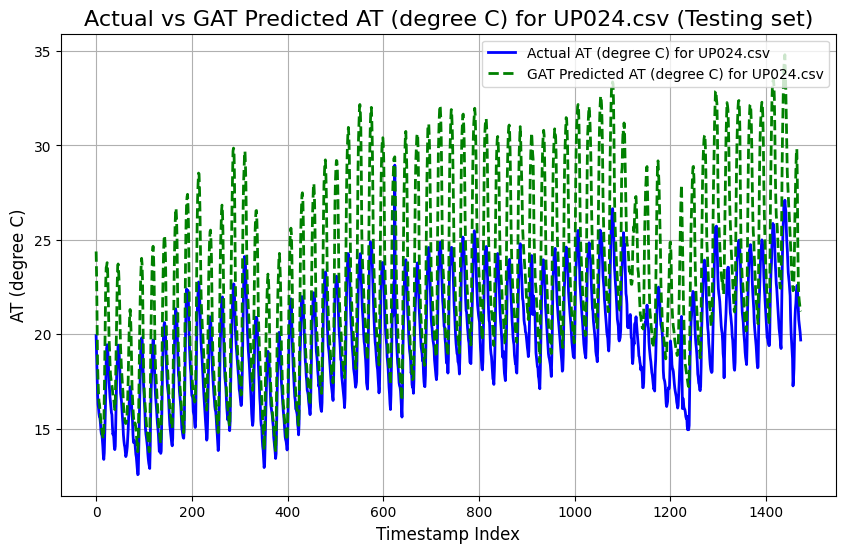

UP025.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7959
Mean Squared Error (MSE): 1.1452
Root Mean Squared Error (RMSE): 1.0701
Pearson Correlation Coefficient: 0.9814
R-squared (R²): 0.9534

----------------------------------------



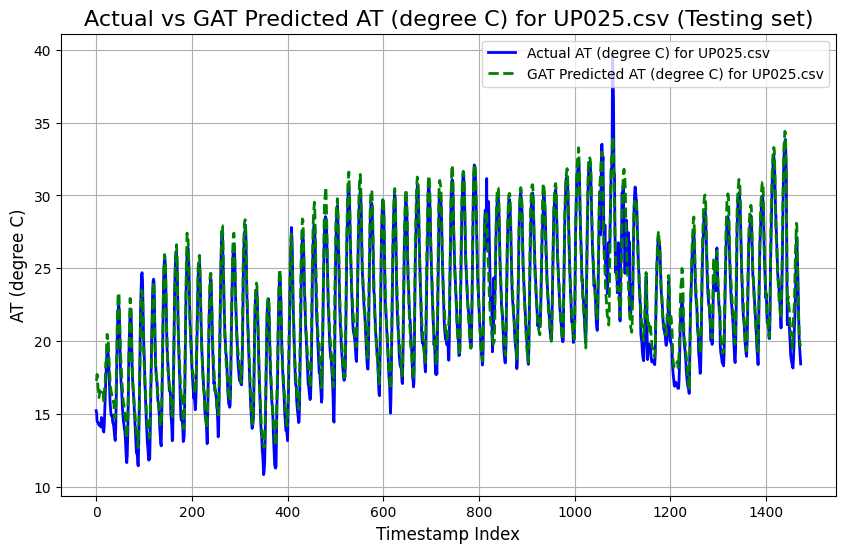

UP026.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3930
Mean Squared Error (MSE): 2.7240
Root Mean Squared Error (RMSE): 1.6505
Pearson Correlation Coefficient: 0.9696
R-squared (R²): 0.9016

----------------------------------------



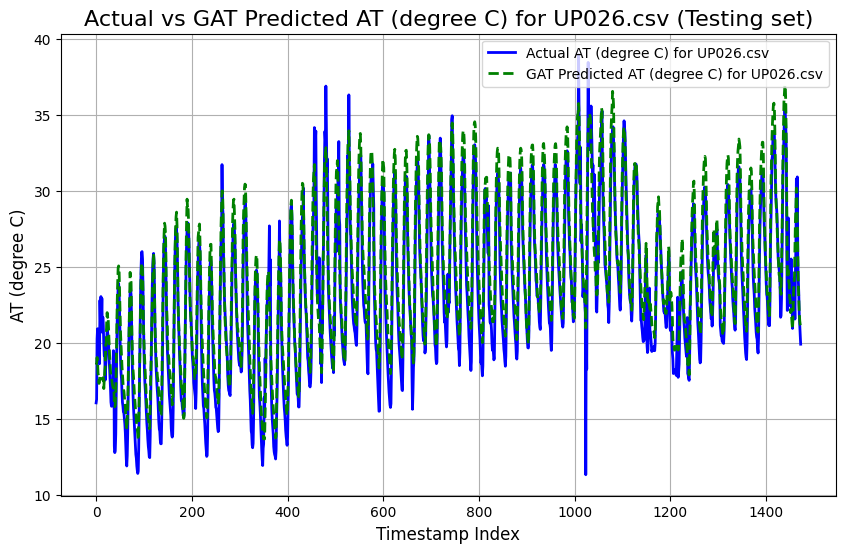

UP028.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3012
Mean Squared Error (MSE): 3.5005
Root Mean Squared Error (RMSE): 1.8710
Pearson Correlation Coefficient: 0.9746
R-squared (R²): 0.9399

----------------------------------------



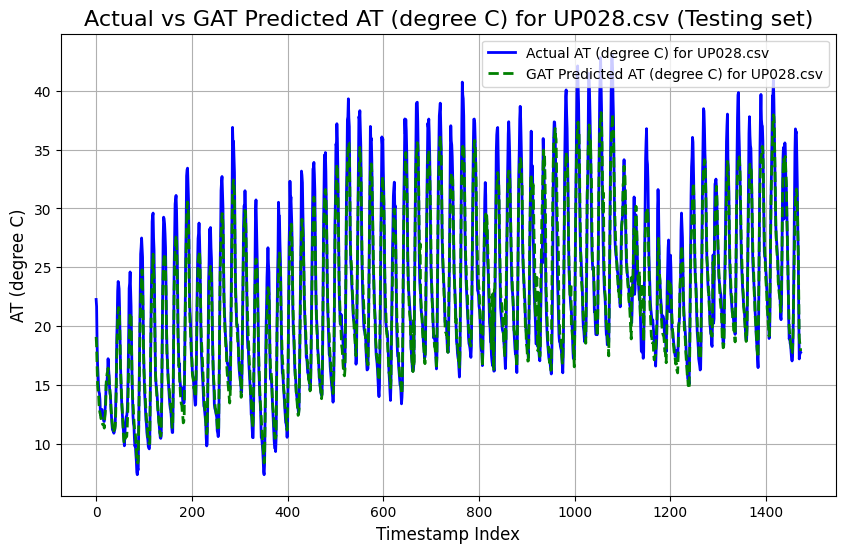

UP029.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.6696
Mean Squared Error (MSE): 0.7338
Root Mean Squared Error (RMSE): 0.8566
Pearson Correlation Coefficient: 0.9919
R-squared (R²): 0.9802

----------------------------------------



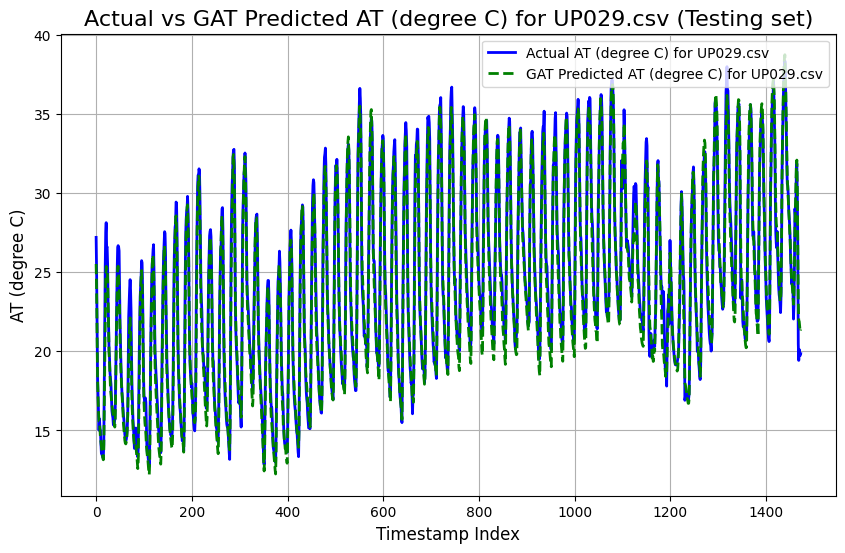

UP030.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0550
Mean Squared Error (MSE): 2.1063
Root Mean Squared Error (RMSE): 1.4513
Pearson Correlation Coefficient: 0.9786
R-squared (R²): 0.9521

----------------------------------------



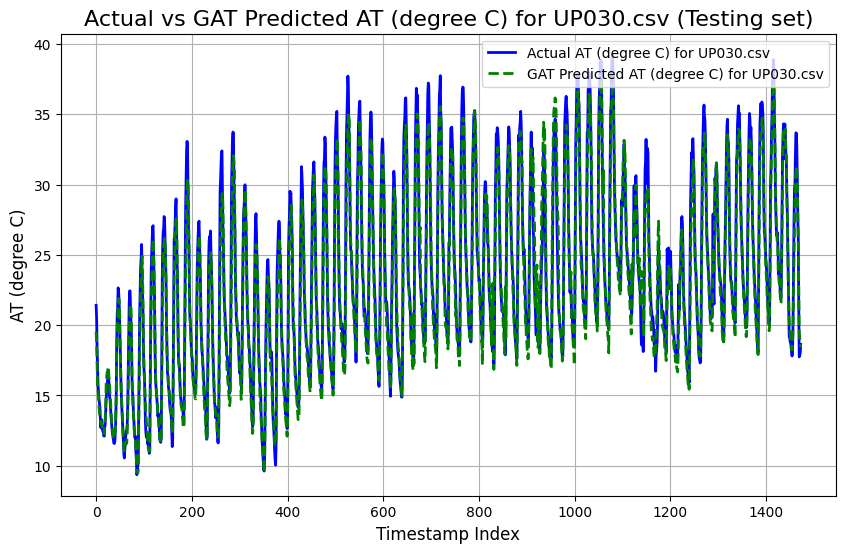

UP031.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4857
Mean Squared Error (MSE): 3.6273
Root Mean Squared Error (RMSE): 1.9045
Pearson Correlation Coefficient: 0.9641
R-squared (R²): 0.9256

----------------------------------------



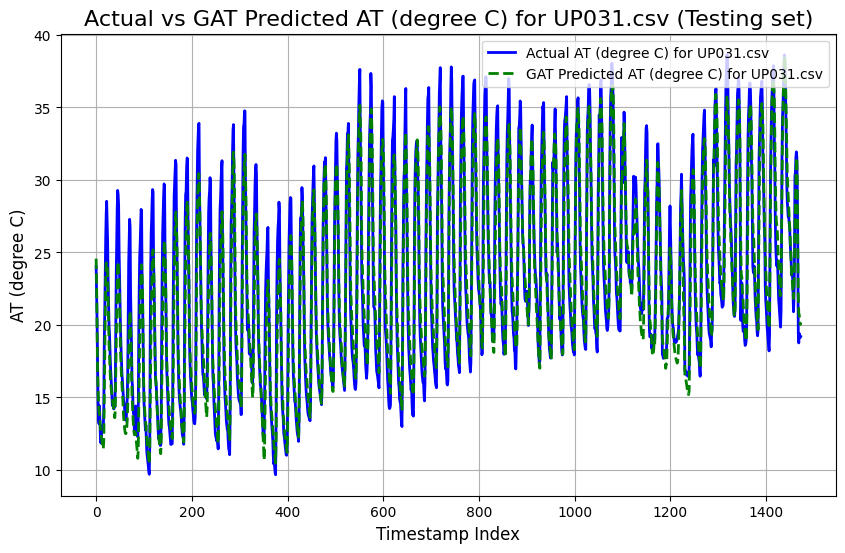

UP032.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1380
Mean Squared Error (MSE): 2.1069
Root Mean Squared Error (RMSE): 1.4515
Pearson Correlation Coefficient: 0.9689
R-squared (R²): 0.9386

----------------------------------------



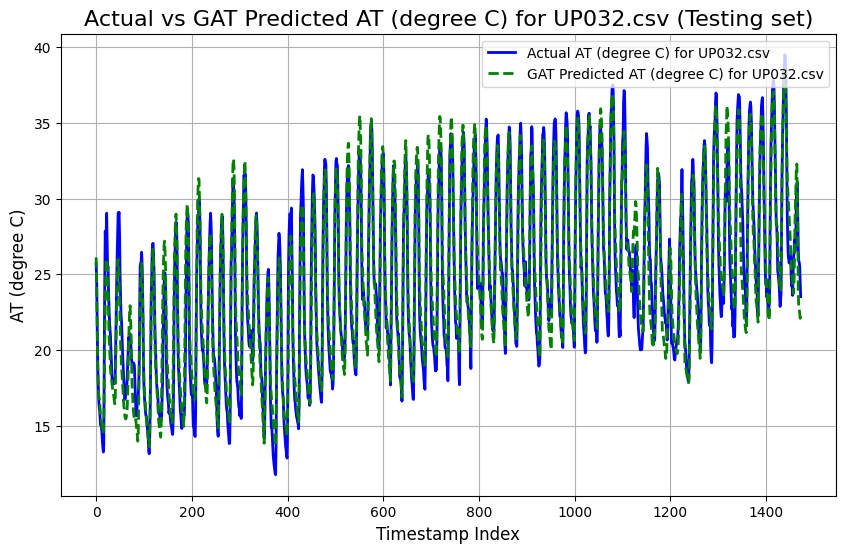

UP033.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.6596
Mean Squared Error (MSE): 0.7419
Root Mean Squared Error (RMSE): 0.8613
Pearson Correlation Coefficient: 0.9908
R-squared (R²): 0.9796

----------------------------------------



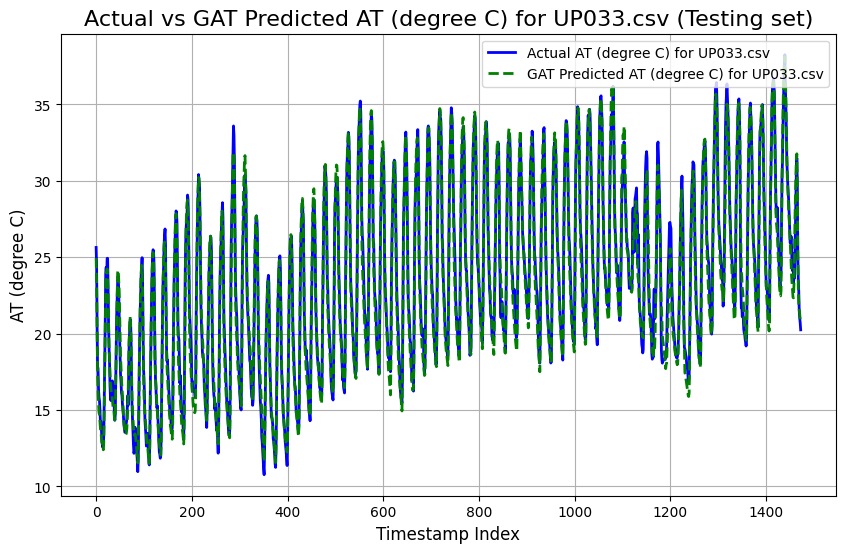

UP034.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.9617
Mean Squared Error (MSE): 24.6400
Root Mean Squared Error (RMSE): 4.9639
Pearson Correlation Coefficient: 0.8875
R-squared (R²): -0.0929

----------------------------------------



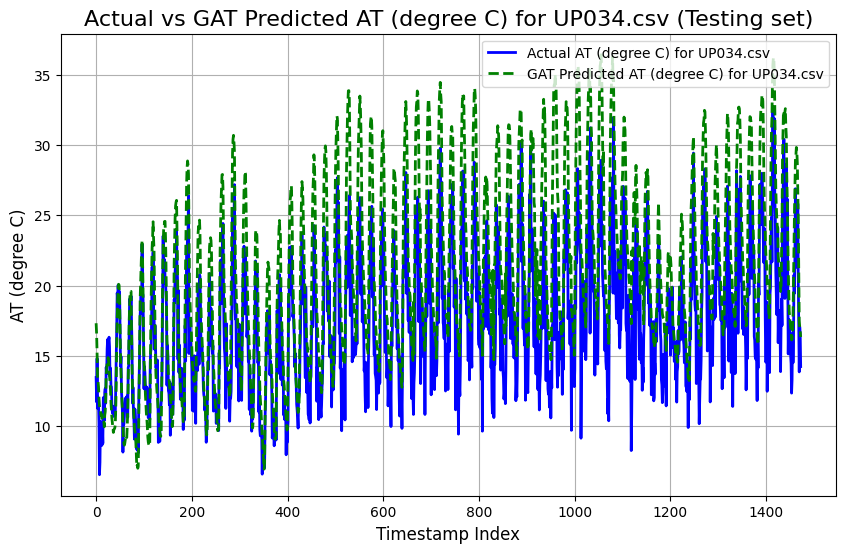

UP035.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0096
Mean Squared Error (MSE): 1.7482
Root Mean Squared Error (RMSE): 1.3222
Pearson Correlation Coefficient: 0.9786
R-squared (R²): 0.9550

----------------------------------------



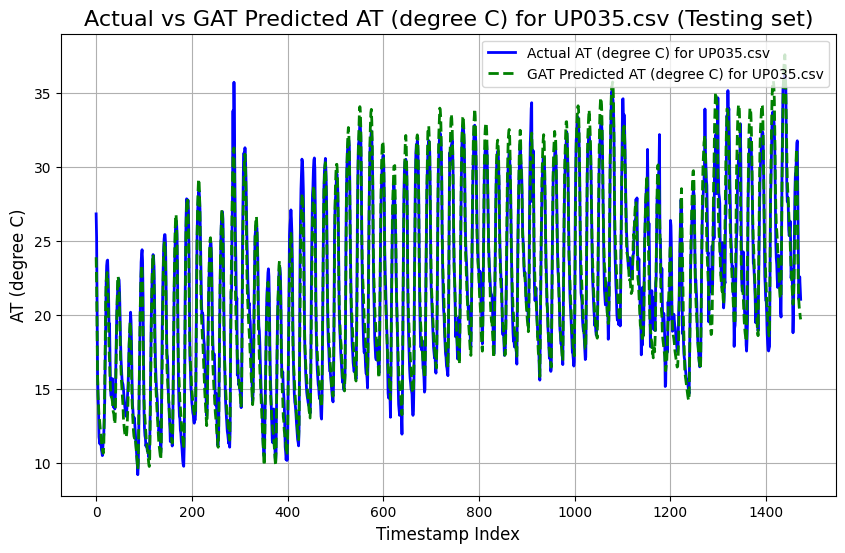

UP036.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.9820
Mean Squared Error (MSE): 1.4903
Root Mean Squared Error (RMSE): 1.2208
Pearson Correlation Coefficient: 0.9807
R-squared (R²): 0.9564

----------------------------------------



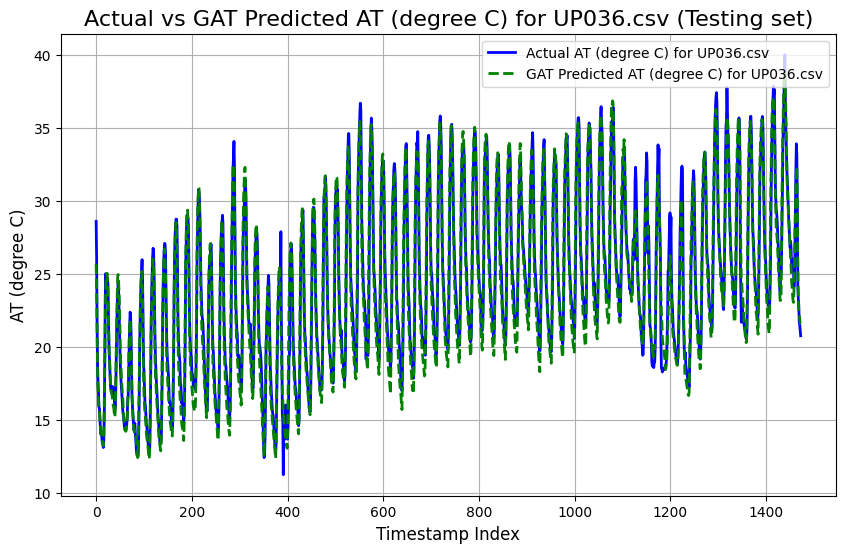

UP037.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0378
Mean Squared Error (MSE): 1.9898
Root Mean Squared Error (RMSE): 1.4106
Pearson Correlation Coefficient: 0.9747
R-squared (R²): 0.9497

----------------------------------------



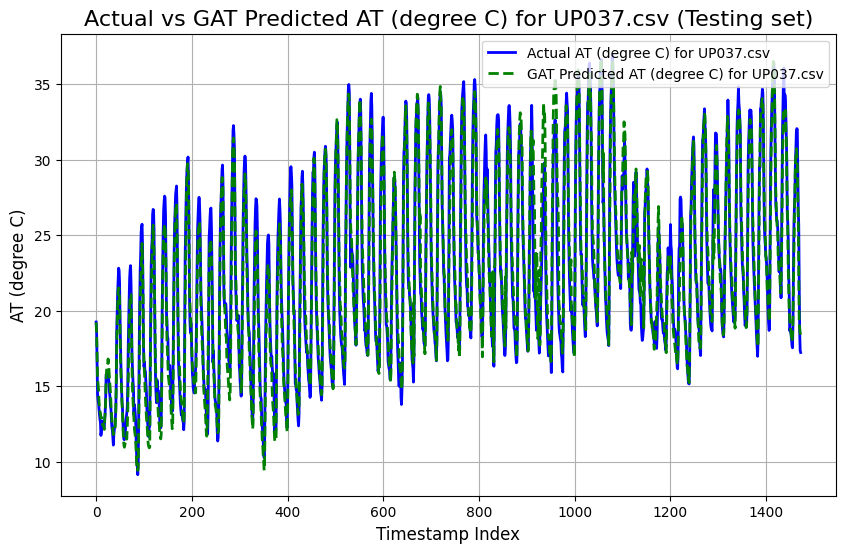

UP038.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8131
Mean Squared Error (MSE): 1.0071
Root Mean Squared Error (RMSE): 1.0035
Pearson Correlation Coefficient: 0.9894
R-squared (R²): 0.9693

----------------------------------------



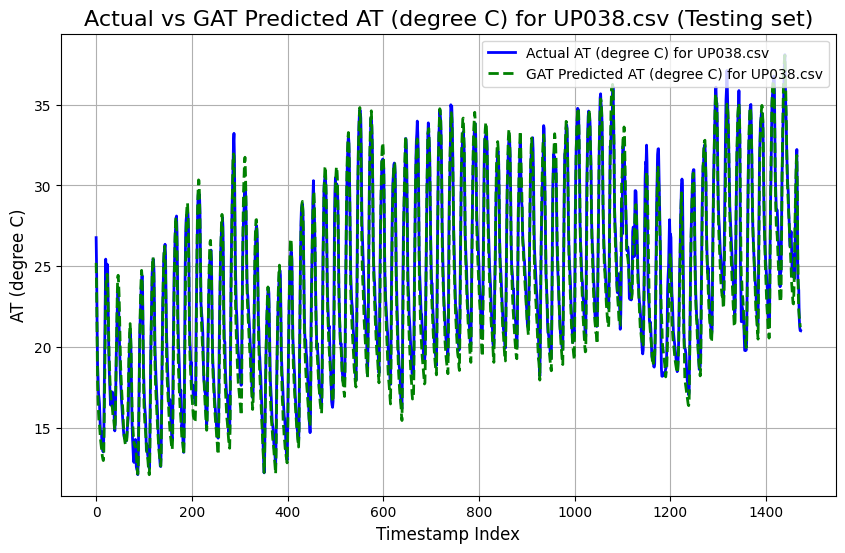

UP039.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4397
Mean Squared Error (MSE): 3.2510
Root Mean Squared Error (RMSE): 1.8030
Pearson Correlation Coefficient: 0.9704
R-squared (R²): 0.9372

----------------------------------------



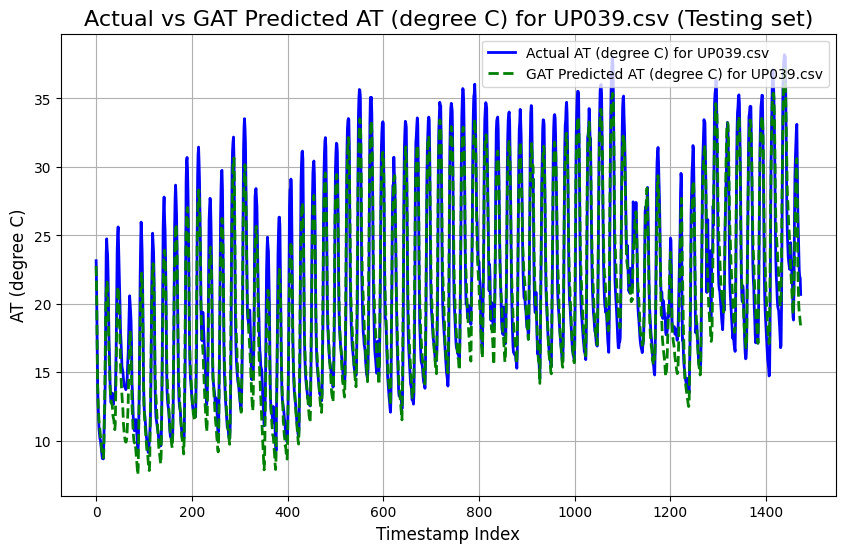

UP040.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1333
Mean Squared Error (MSE): 2.0090
Root Mean Squared Error (RMSE): 1.4174
Pearson Correlation Coefficient: 0.9779
R-squared (R²): 0.9526

----------------------------------------



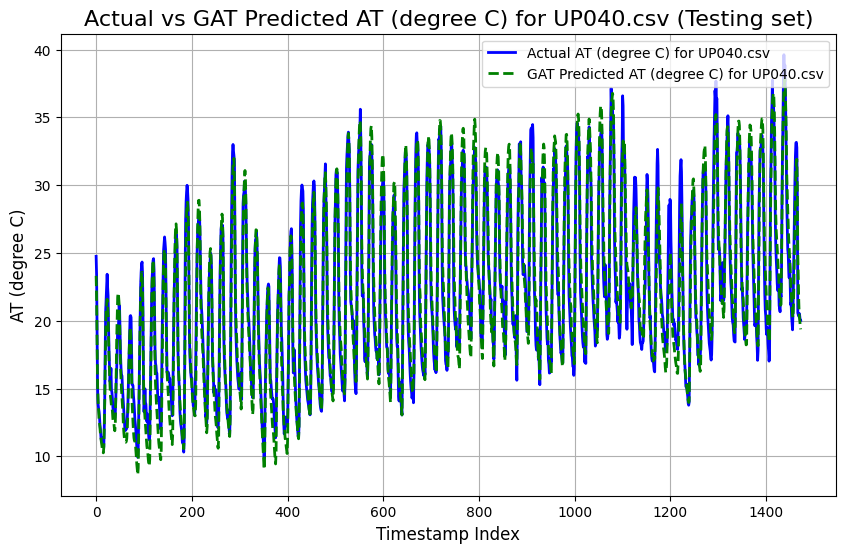

UP041.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0228
Mean Squared Error (MSE): 1.6889
Root Mean Squared Error (RMSE): 1.2996
Pearson Correlation Coefficient: 0.9780
R-squared (R²): 0.9502

----------------------------------------



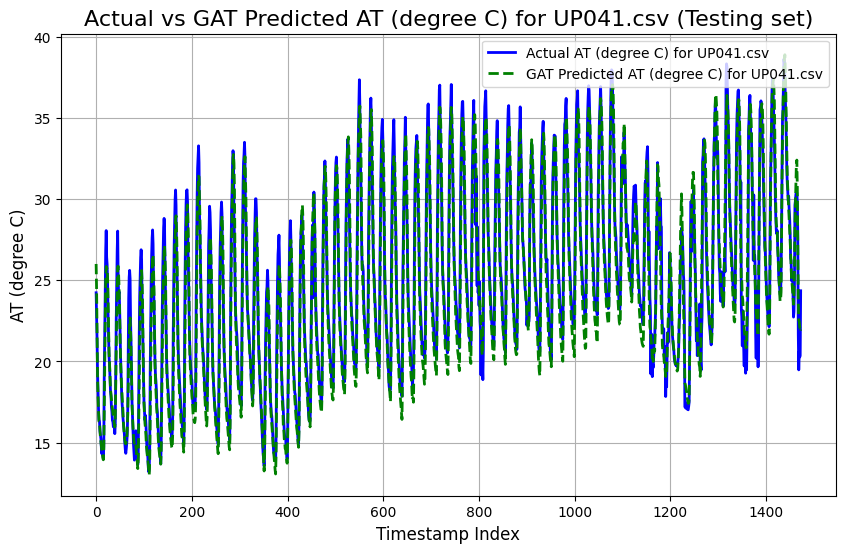

UP042.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.9562
Mean Squared Error (MSE): 1.6461
Root Mean Squared Error (RMSE): 1.2830
Pearson Correlation Coefficient: 0.9757
R-squared (R²): 0.9512

----------------------------------------



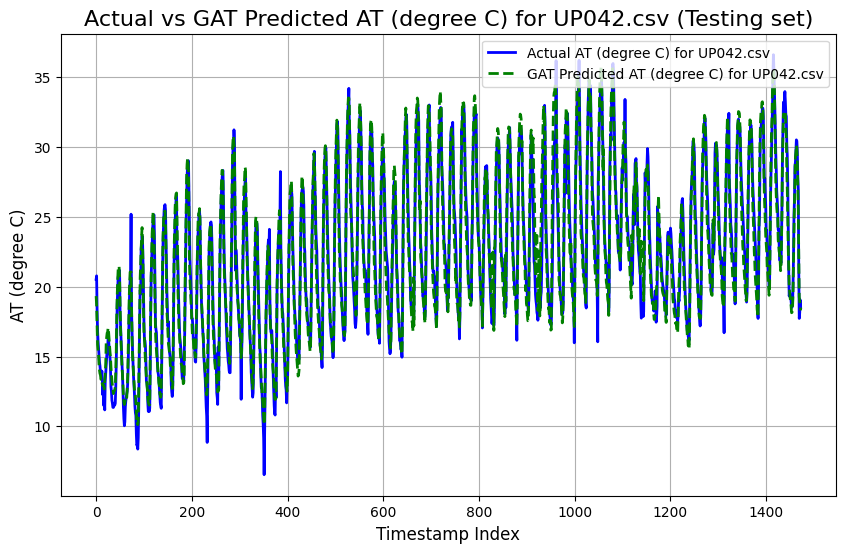

UP043.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.9205
Mean Squared Error (MSE): 1.6306
Root Mean Squared Error (RMSE): 1.2769
Pearson Correlation Coefficient: 0.9800
R-squared (R²): 0.9554

----------------------------------------



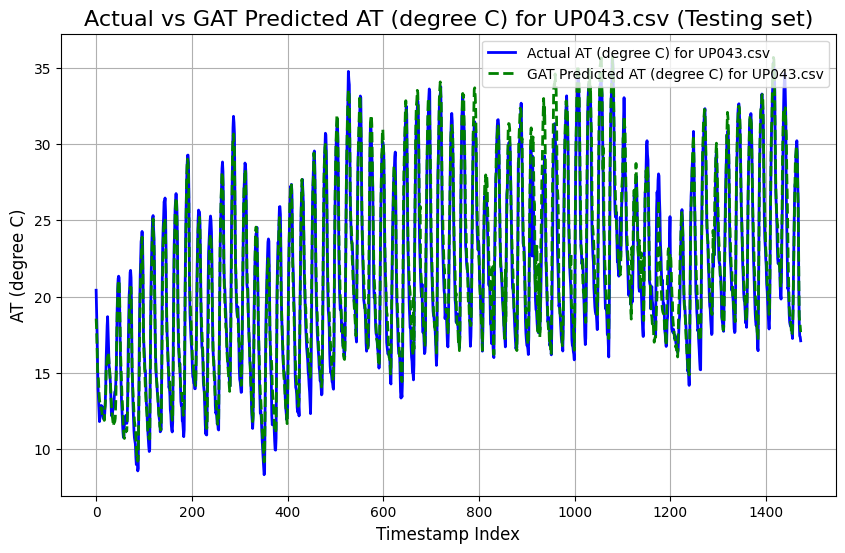

UP044.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.9131
Mean Squared Error (MSE): 1.4977
Root Mean Squared Error (RMSE): 1.2238
Pearson Correlation Coefficient: 0.9870
R-squared (R²): 0.9660

----------------------------------------



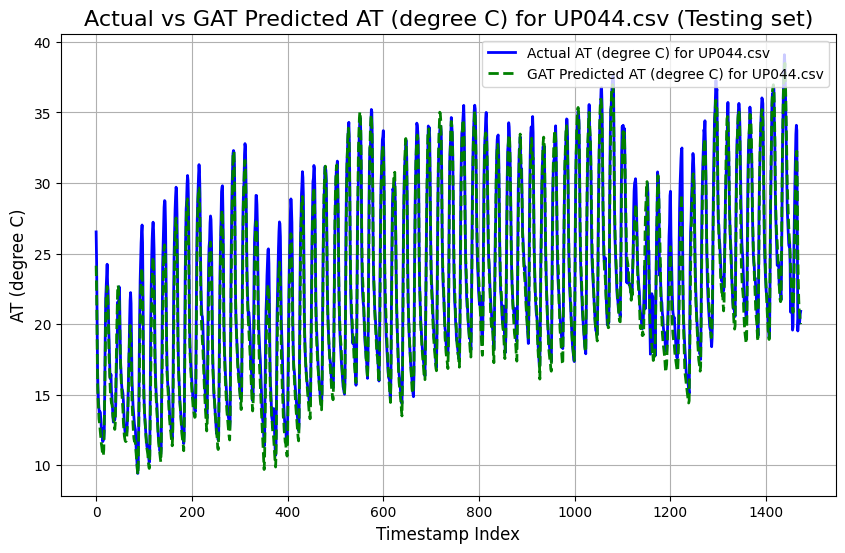

UP046.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2341
Mean Squared Error (MSE): 2.2743
Root Mean Squared Error (RMSE): 1.5081
Pearson Correlation Coefficient: 0.9749
R-squared (R²): 0.9358

----------------------------------------



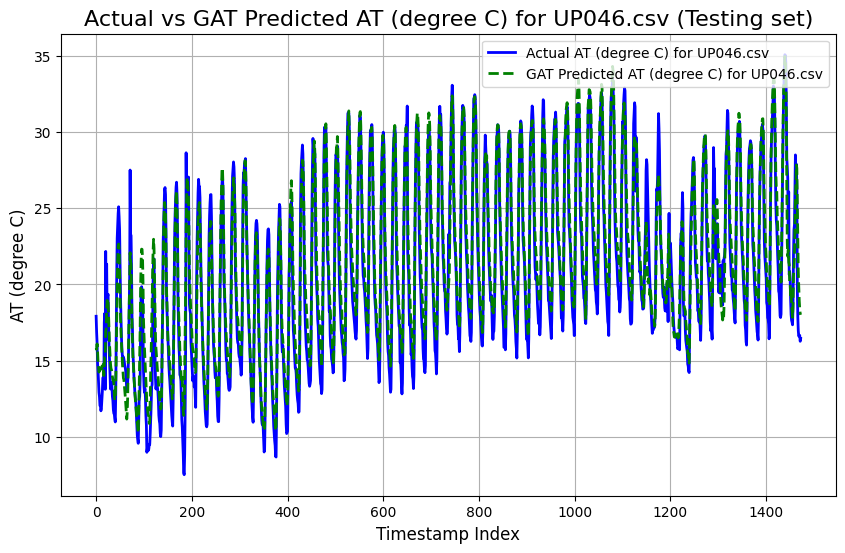

UP048.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4198
Mean Squared Error (MSE): 3.3664
Root Mean Squared Error (RMSE): 1.8348
Pearson Correlation Coefficient: 0.9616
R-squared (R²): 0.9088

----------------------------------------



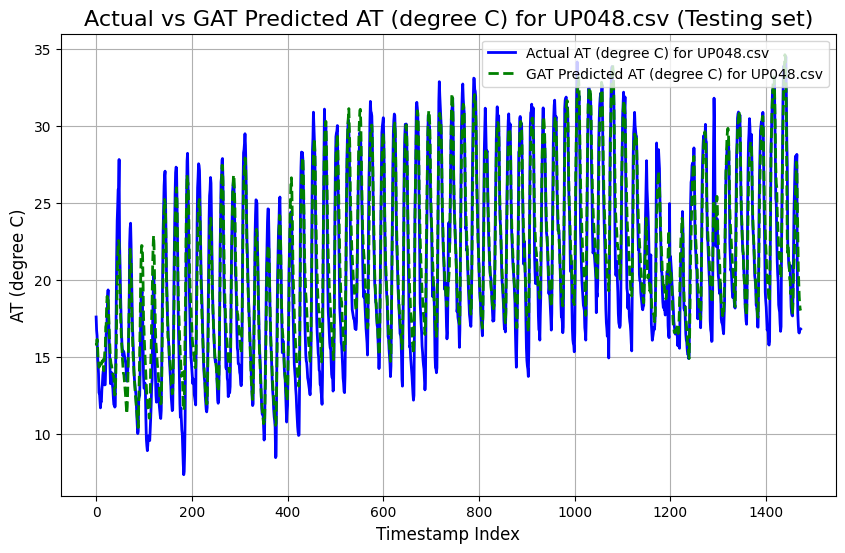

UP049.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3362
Mean Squared Error (MSE): 2.7742
Root Mean Squared Error (RMSE): 1.6656
Pearson Correlation Coefficient: 0.9654
R-squared (R²): 0.9156

----------------------------------------



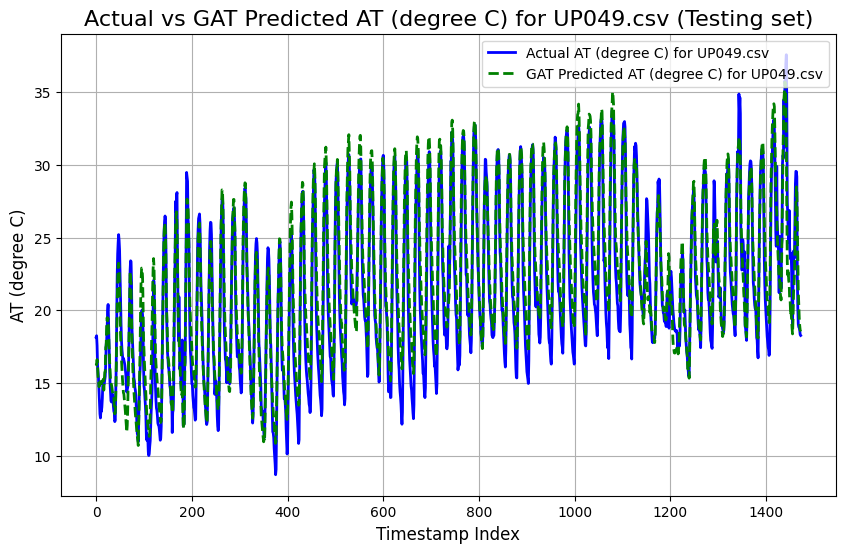

UP050.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2001
Mean Squared Error (MSE): 2.7397
Root Mean Squared Error (RMSE): 1.6552
Pearson Correlation Coefficient: 0.9513
R-squared (R²): 0.8916

----------------------------------------



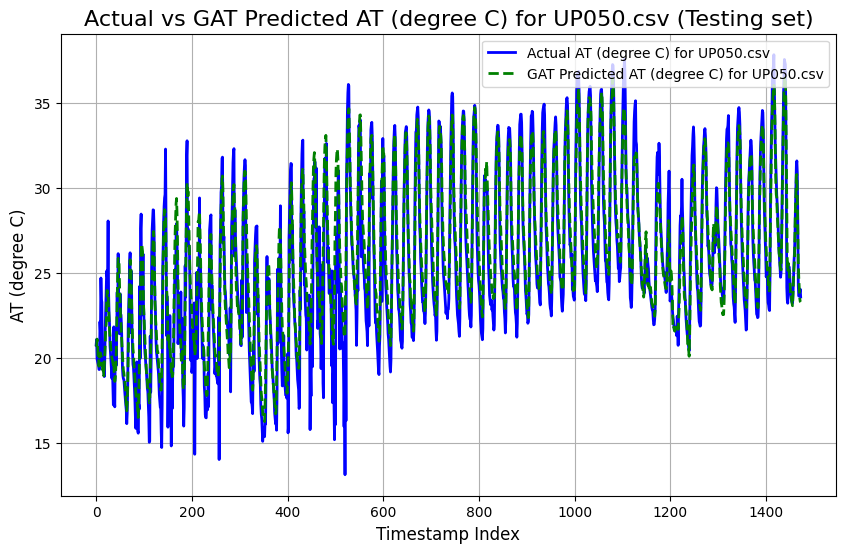

UP051.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.1675
Mean Squared Error (MSE): 41.6010
Root Mean Squared Error (RMSE): 6.4499
Pearson Correlation Coefficient: 0.6435
R-squared (R²): 0.3888

----------------------------------------



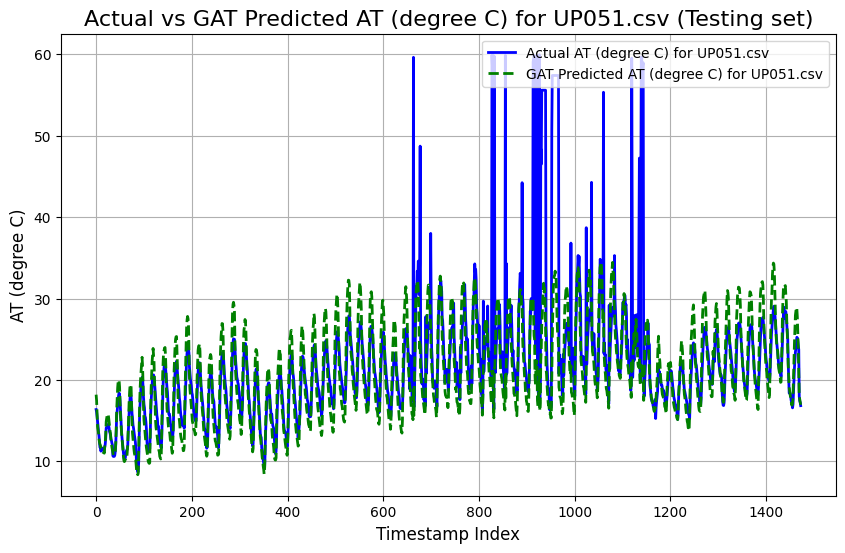

UP052.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4206
Mean Squared Error (MSE): 3.3282
Root Mean Squared Error (RMSE): 1.8243
Pearson Correlation Coefficient: 0.9618
R-squared (R²): 0.9084

----------------------------------------



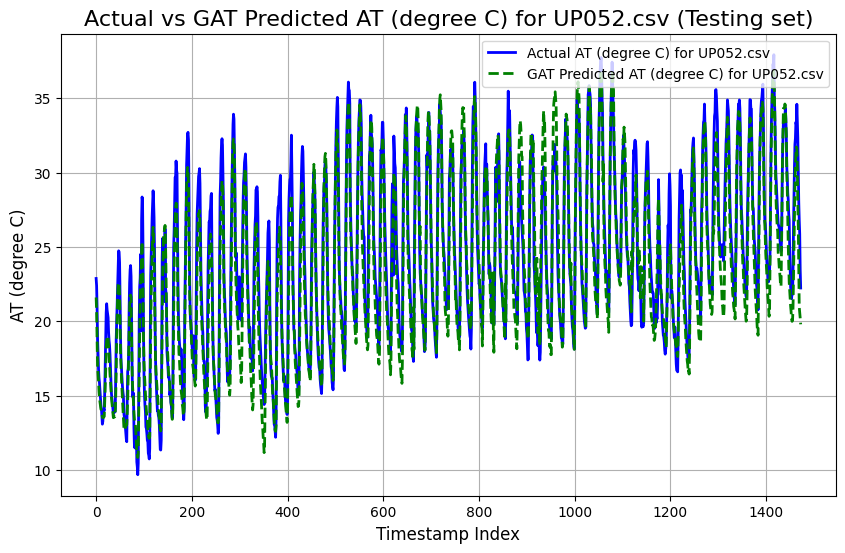

Train GNN Imputed.csv
CSV file 'Train GNN Imputed.csv' created successfully.
Test GNN Imputed.csv
CSV file 'Test GNN Imputed.csv' created successfully.
UP002.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1507
Mean Squared Error (MSE): 2.2781
Root Mean Squared Error (RMSE): 1.5093
Pearson Correlation Coefficient: 0.9824
R-squared (R²): 0.9596

----------------------------------------



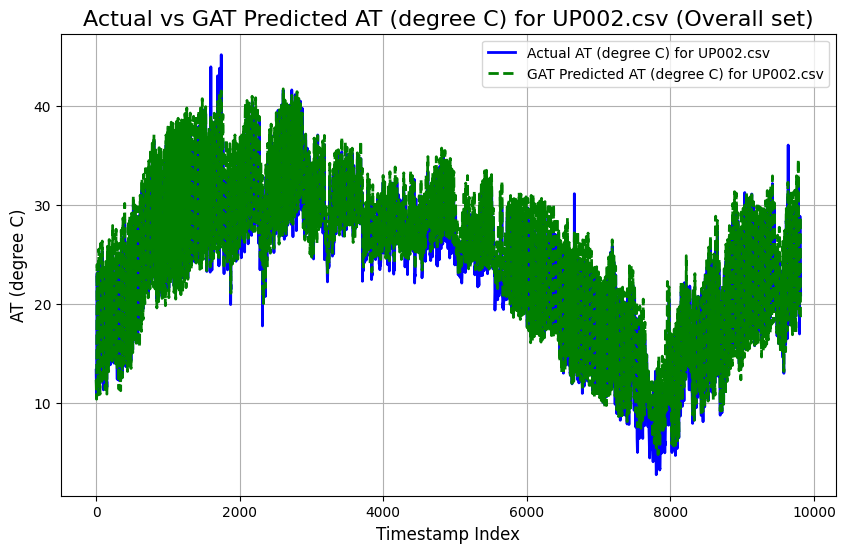

UP003.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2206
Mean Squared Error (MSE): 2.4130
Root Mean Squared Error (RMSE): 1.5534
Pearson Correlation Coefficient: 0.9859
R-squared (R²): 0.9667

----------------------------------------



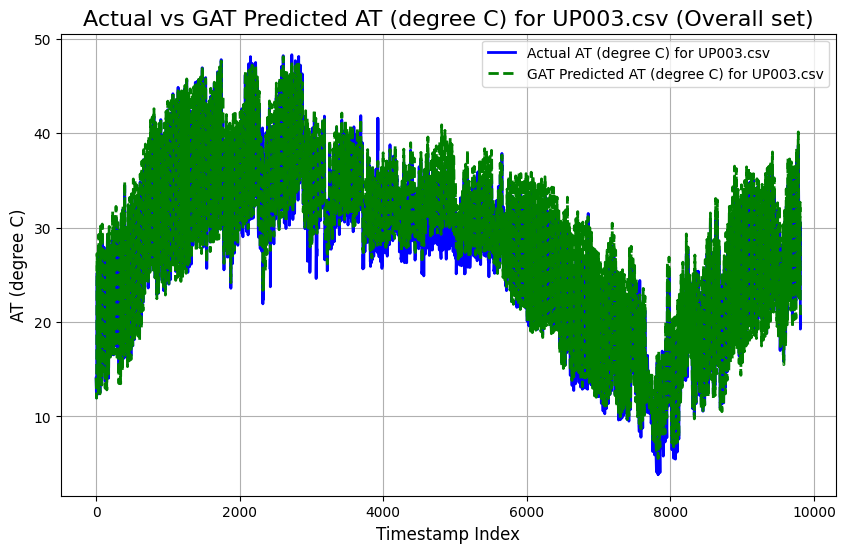

UP004.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2515
Mean Squared Error (MSE): 2.3283
Root Mean Squared Error (RMSE): 1.5259
Pearson Correlation Coefficient: 0.9877
R-squared (R²): 0.9706

----------------------------------------



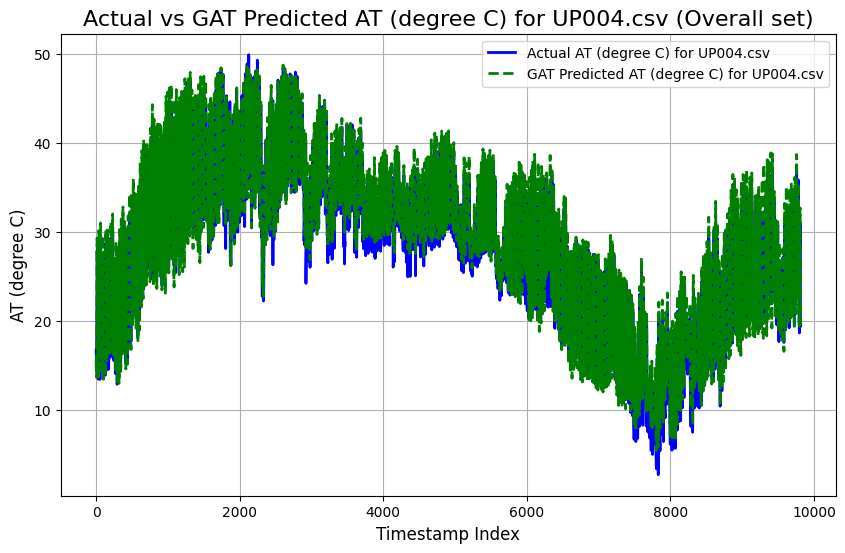

UP008.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 5.1412
Mean Squared Error (MSE): 52.5515
Root Mean Squared Error (RMSE): 7.2492
Pearson Correlation Coefficient: 0.8006
R-squared (R²): 0.5992

----------------------------------------



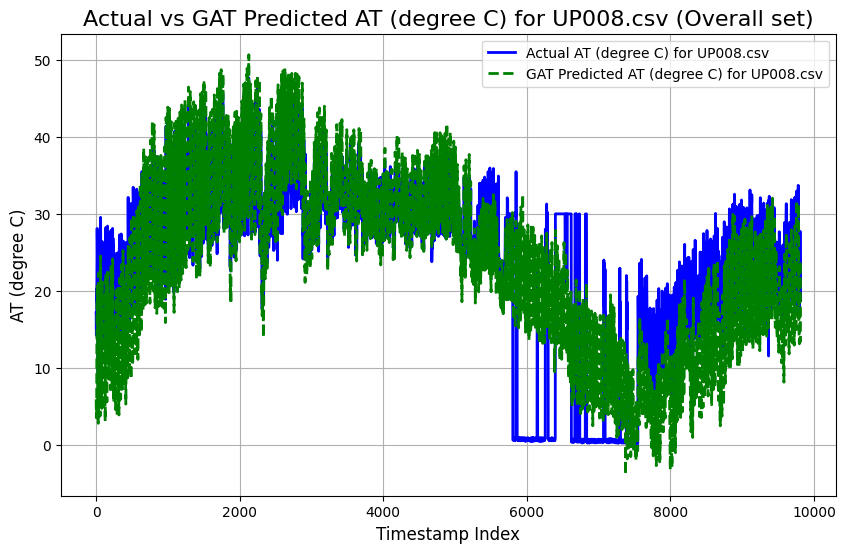

UP009.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0639
Mean Squared Error (MSE): 1.8507
Root Mean Squared Error (RMSE): 1.3604
Pearson Correlation Coefficient: 0.9859
R-squared (R²): 0.9679

----------------------------------------



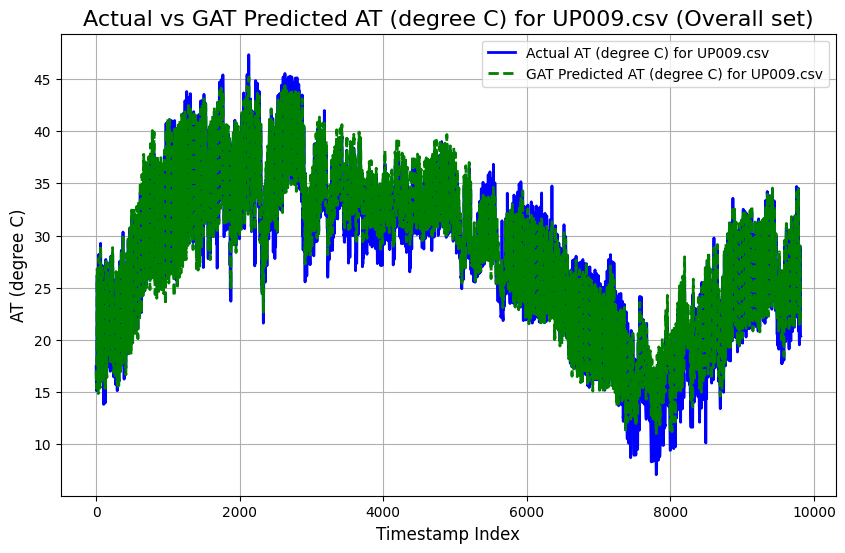

UP012.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4077
Mean Squared Error (MSE): 3.8720
Root Mean Squared Error (RMSE): 1.9677
Pearson Correlation Coefficient: 0.9827
R-squared (R²): 0.9623

----------------------------------------



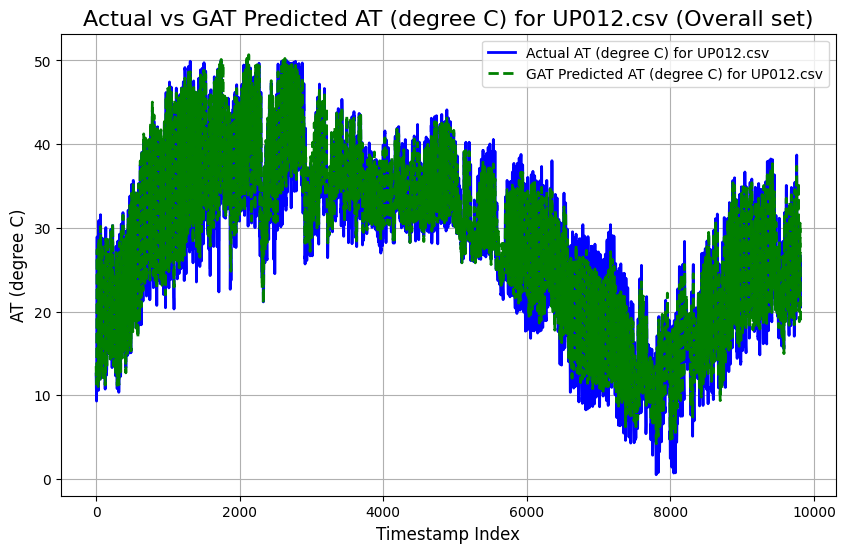

UP014.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.3192
Mean Squared Error (MSE): 15.8541
Root Mean Squared Error (RMSE): 3.9817
Pearson Correlation Coefficient: 0.9370
R-squared (R²): 0.8706

----------------------------------------



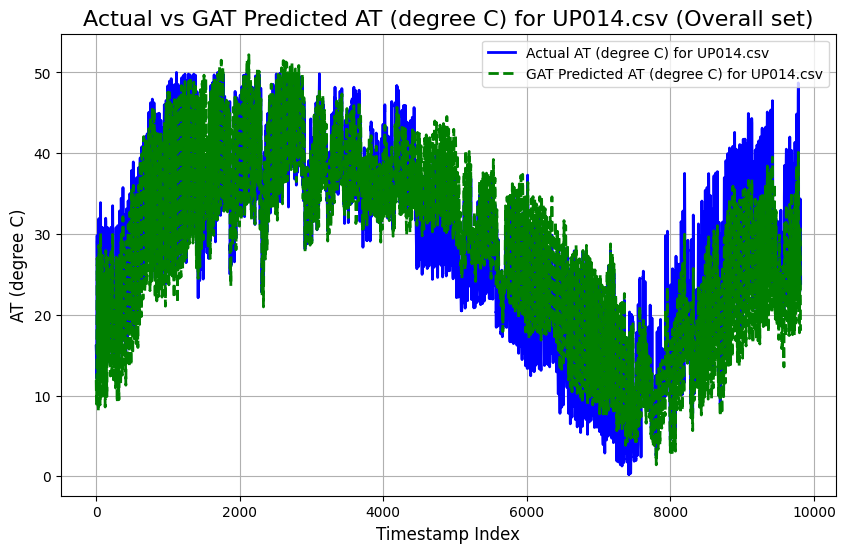

UP016.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.0525
Mean Squared Error (MSE): 13.6041
Root Mean Squared Error (RMSE): 3.6884
Pearson Correlation Coefficient: 0.9468
R-squared (R²): 0.8916

----------------------------------------



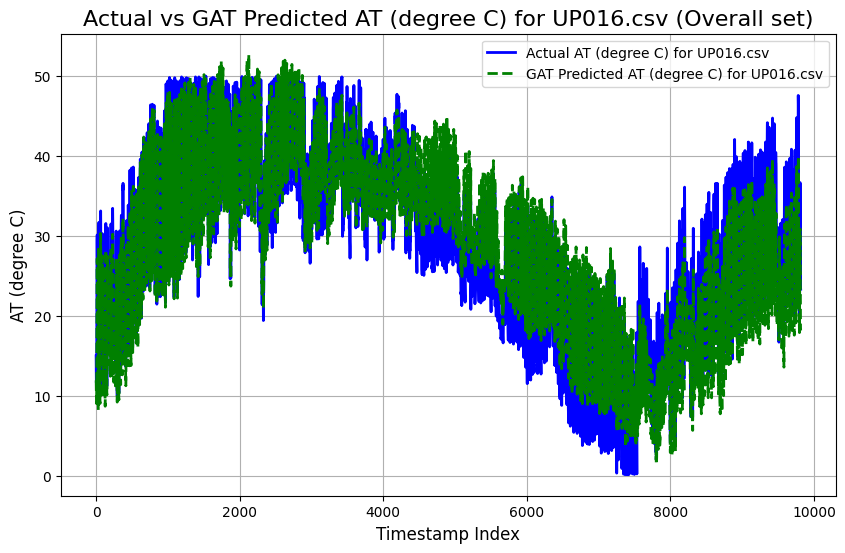

UP017.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.8581
Mean Squared Error (MSE): 1.1110
Root Mean Squared Error (RMSE): 1.0540
Pearson Correlation Coefficient: 0.9842
R-squared (R²): 0.9644

----------------------------------------



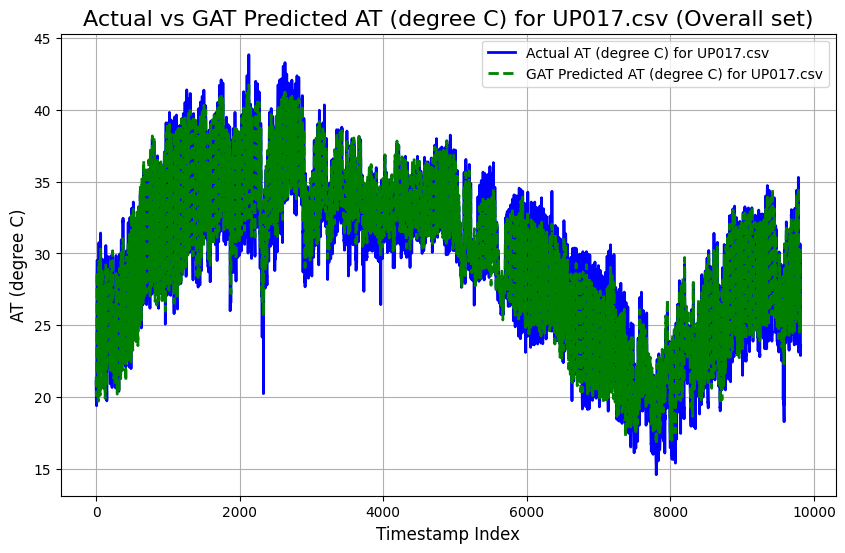

UP018.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 5.1718
Mean Squared Error (MSE): 52.0588
Root Mean Squared Error (RMSE): 7.2152
Pearson Correlation Coefficient: 0.5056
R-squared (R²): 0.0984

----------------------------------------



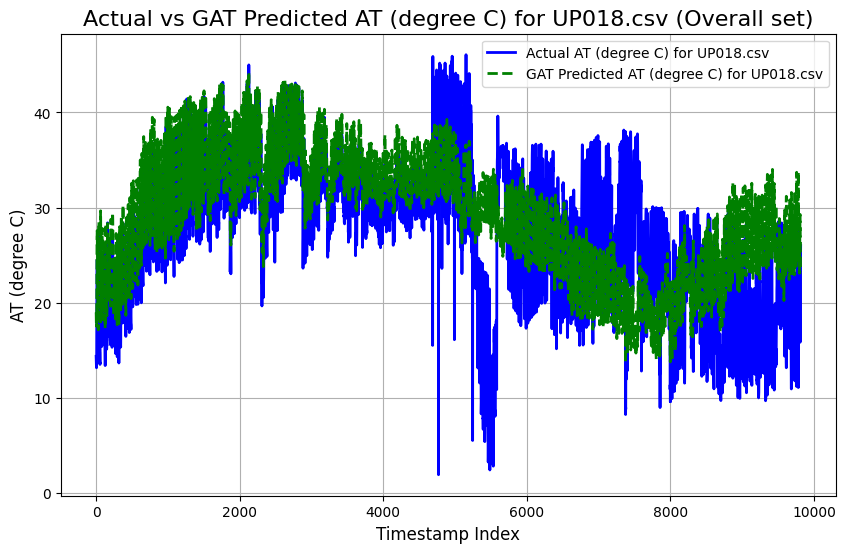

UP019.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5446
Mean Squared Error (MSE): 4.8414
Root Mean Squared Error (RMSE): 2.2003
Pearson Correlation Coefficient: 0.9314
R-squared (R²): 0.8636

----------------------------------------



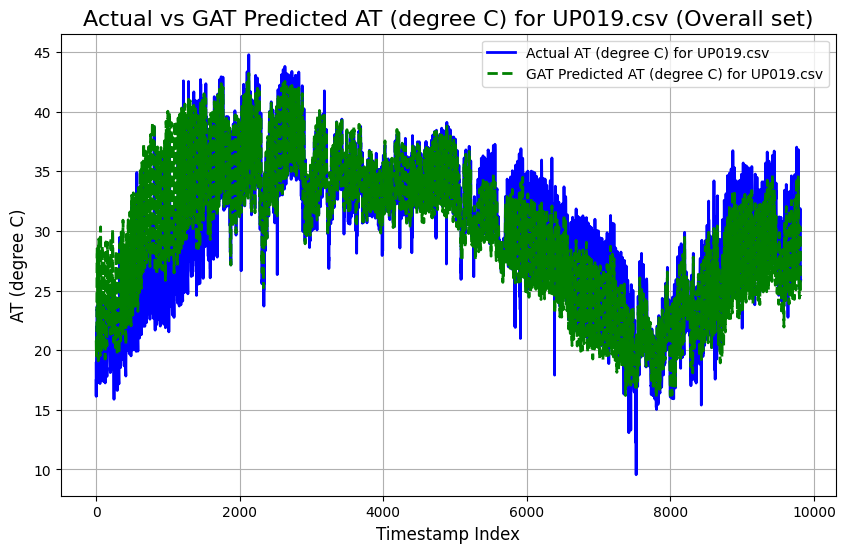

UP020.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1522
Mean Squared Error (MSE): 2.0536
Root Mean Squared Error (RMSE): 1.4330
Pearson Correlation Coefficient: 0.9827
R-squared (R²): 0.9618

----------------------------------------



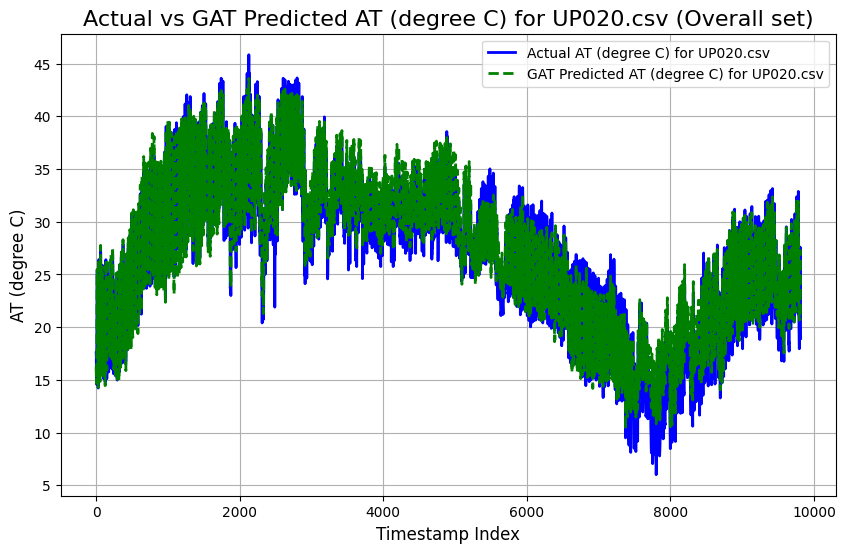

UP021.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.4541
Mean Squared Error (MSE): 20.0811
Root Mean Squared Error (RMSE): 4.4812
Pearson Correlation Coefficient: 0.8574
R-squared (R²): 0.7160

----------------------------------------



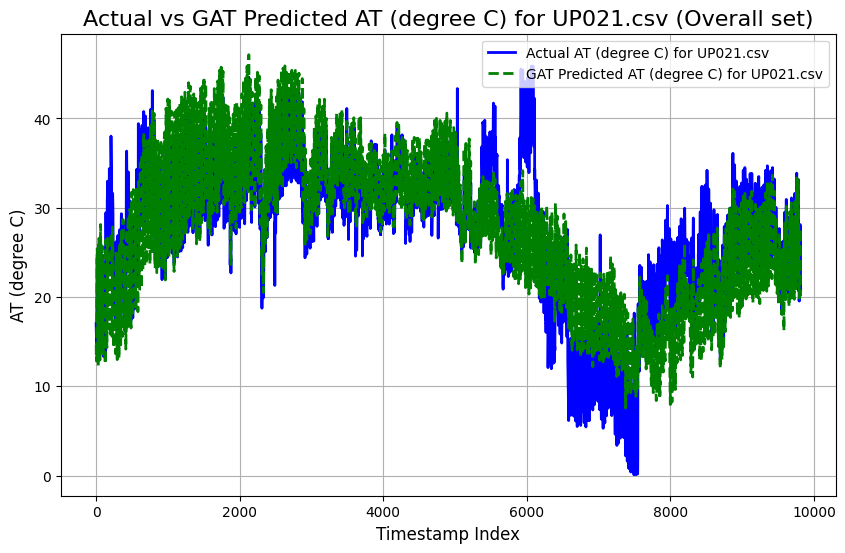

UP022.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1976
Mean Squared Error (MSE): 2.7453
Root Mean Squared Error (RMSE): 1.6569
Pearson Correlation Coefficient: 0.9764
R-squared (R²): 0.9493

----------------------------------------



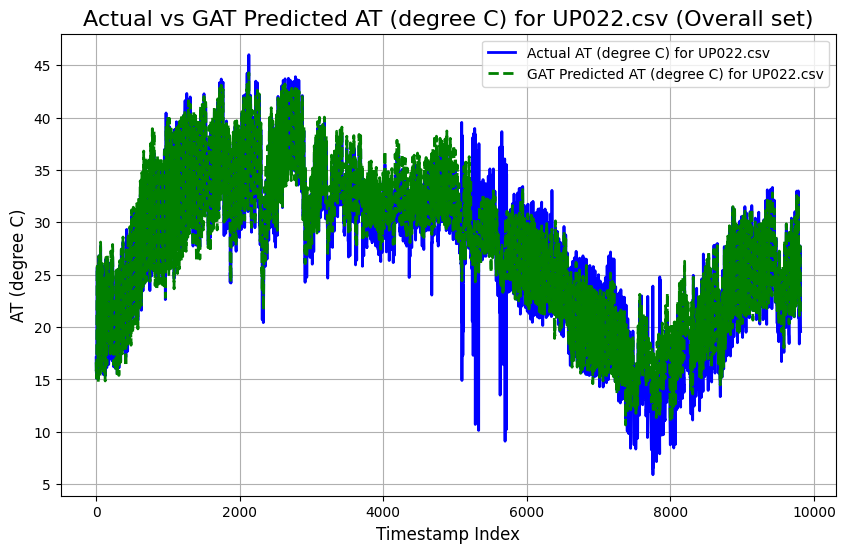

UP023.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3509
Mean Squared Error (MSE): 3.5703
Root Mean Squared Error (RMSE): 1.8895
Pearson Correlation Coefficient: 0.9725
R-squared (R²): 0.9377

----------------------------------------



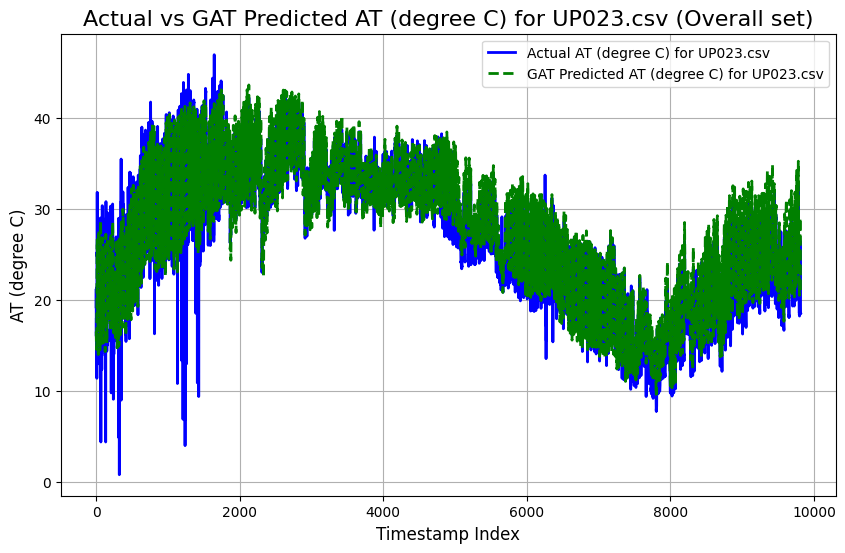

UP024.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.7570
Mean Squared Error (MSE): 13.7419
Root Mean Squared Error (RMSE): 3.7070
Pearson Correlation Coefficient: 0.8392
R-squared (R²): 0.6615

----------------------------------------



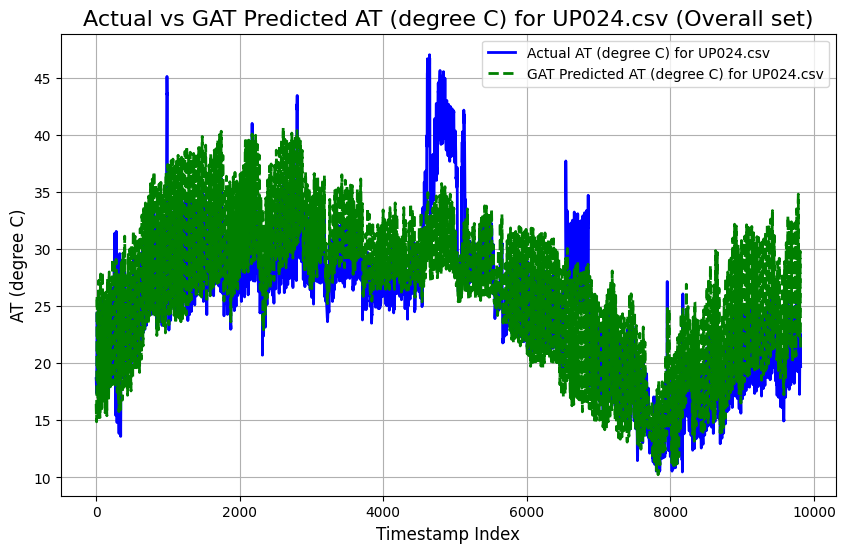

UP025.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9866
Mean Squared Error (MSE): 1.6742
Root Mean Squared Error (RMSE): 1.2939
Pearson Correlation Coefficient: 0.9874
R-squared (R²): 0.9704

----------------------------------------



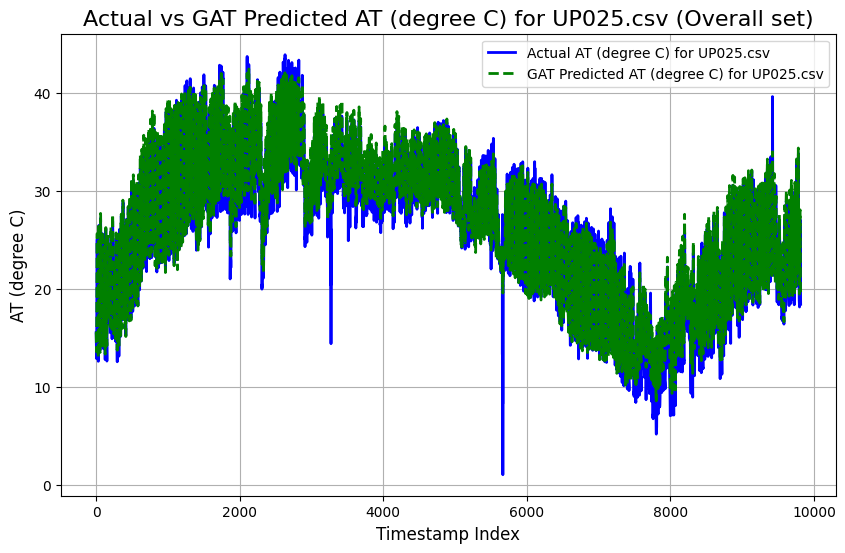

UP026.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0751
Mean Squared Error (MSE): 1.8539
Root Mean Squared Error (RMSE): 1.3616
Pearson Correlation Coefficient: 0.9886
R-squared (R²): 0.9718

----------------------------------------



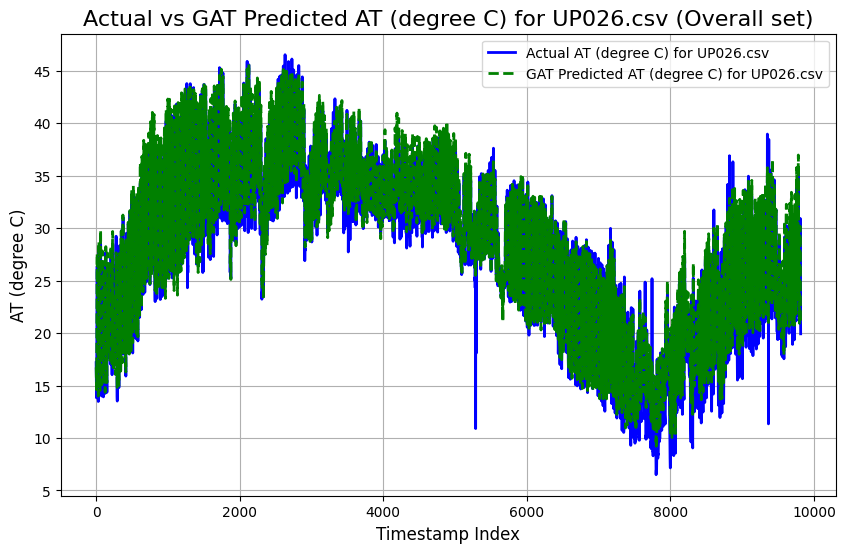

UP028.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.7050
Mean Squared Error (MSE): 4.6819
Root Mean Squared Error (RMSE): 2.1638
Pearson Correlation Coefficient: 0.9758
R-squared (R²): 0.9481

----------------------------------------



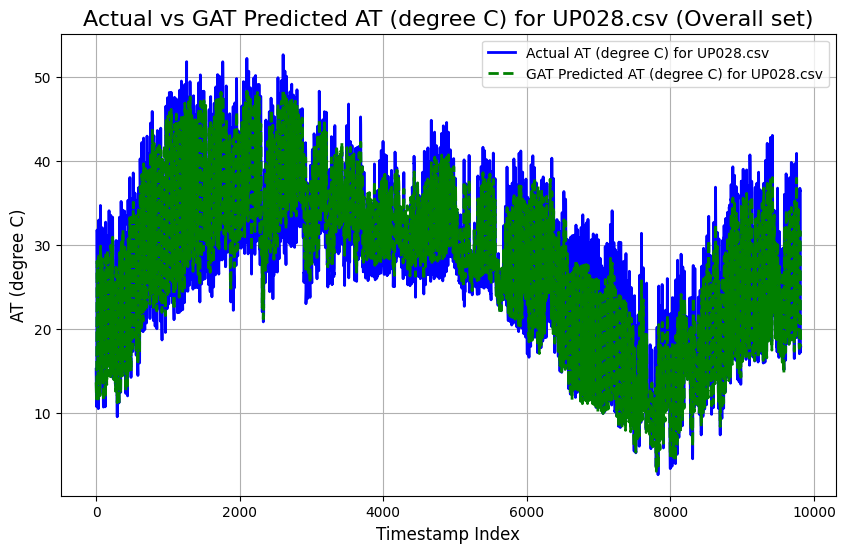

UP029.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9017
Mean Squared Error (MSE): 1.5122
Root Mean Squared Error (RMSE): 1.2297
Pearson Correlation Coefficient: 0.9891
R-squared (R²): 0.9743

----------------------------------------



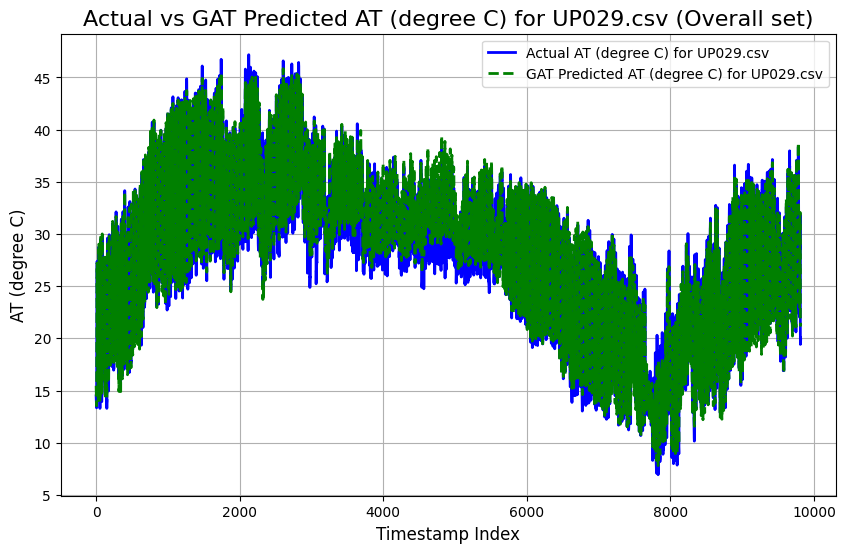

UP030.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2086
Mean Squared Error (MSE): 2.4246
Root Mean Squared Error (RMSE): 1.5571
Pearson Correlation Coefficient: 0.9862
R-squared (R²): 0.9690

----------------------------------------



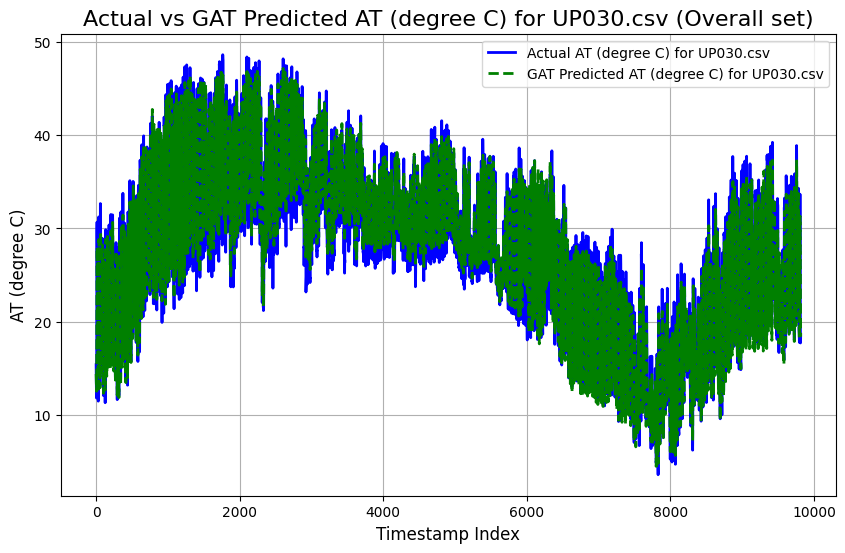

UP031.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4994
Mean Squared Error (MSE): 3.6558
Root Mean Squared Error (RMSE): 1.9120
Pearson Correlation Coefficient: 0.9748
R-squared (R²): 0.9458

----------------------------------------



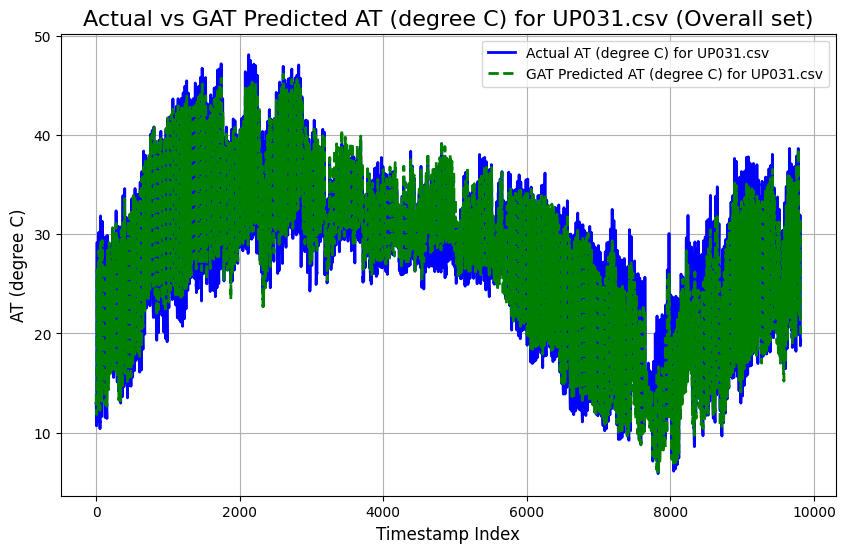

UP032.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4006
Mean Squared Error (MSE): 3.4207
Root Mean Squared Error (RMSE): 1.8495
Pearson Correlation Coefficient: 0.9699
R-squared (R²): 0.9347

----------------------------------------



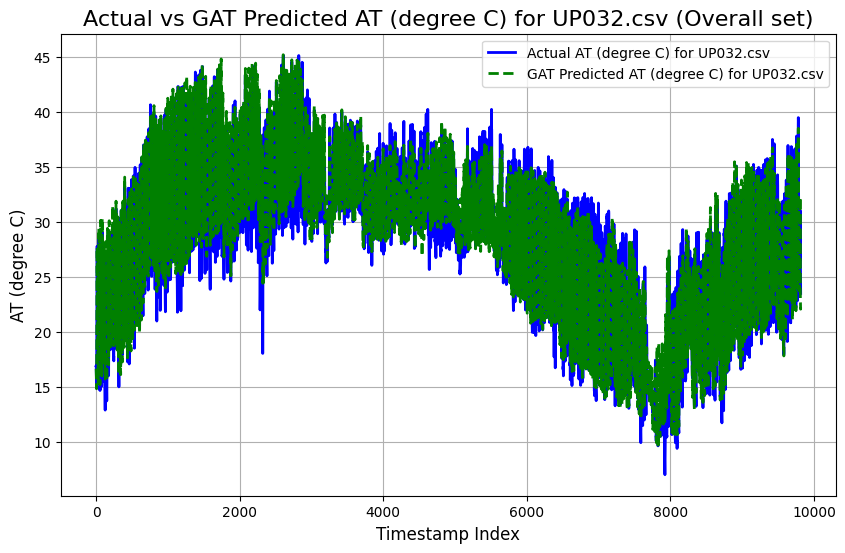

UP033.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.8742
Mean Squared Error (MSE): 1.4018
Root Mean Squared Error (RMSE): 1.1840
Pearson Correlation Coefficient: 0.9905
R-squared (R²): 0.9770

----------------------------------------



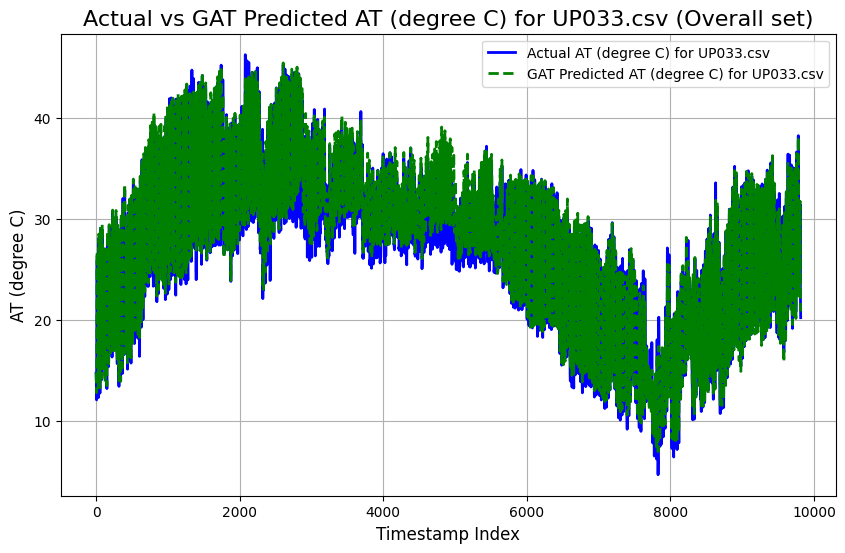

UP034.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.7956
Mean Squared Error (MSE): 7.4053
Root Mean Squared Error (RMSE): 2.7213
Pearson Correlation Coefficient: 0.9658
R-squared (R²): 0.9185

----------------------------------------



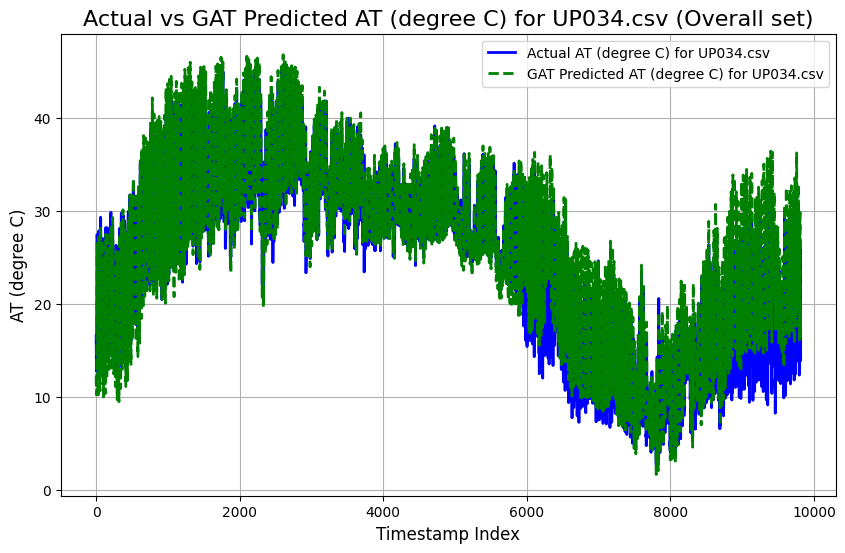

UP035.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0293
Mean Squared Error (MSE): 1.7819
Root Mean Squared Error (RMSE): 1.3349
Pearson Correlation Coefficient: 0.9891
R-squared (R²): 0.9737

----------------------------------------



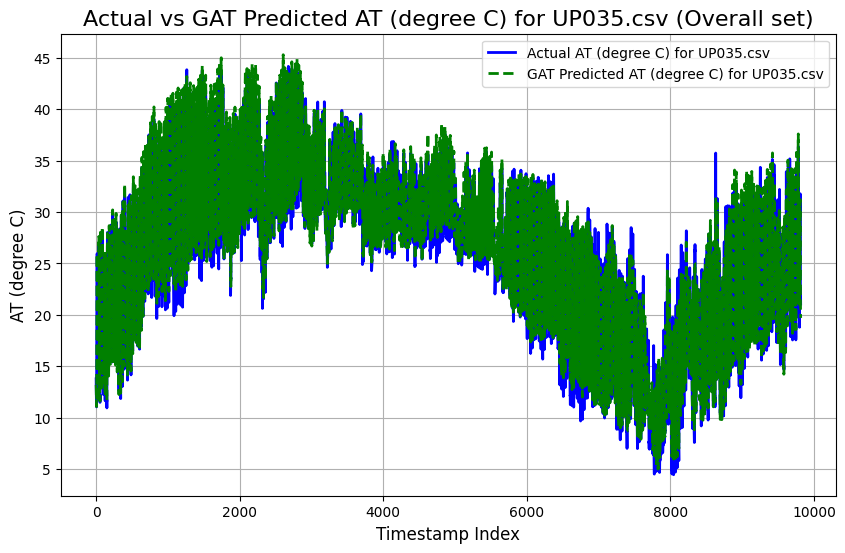

UP036.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0374
Mean Squared Error (MSE): 1.9864
Root Mean Squared Error (RMSE): 1.4094
Pearson Correlation Coefficient: 0.9855
R-squared (R²): 0.9665

----------------------------------------



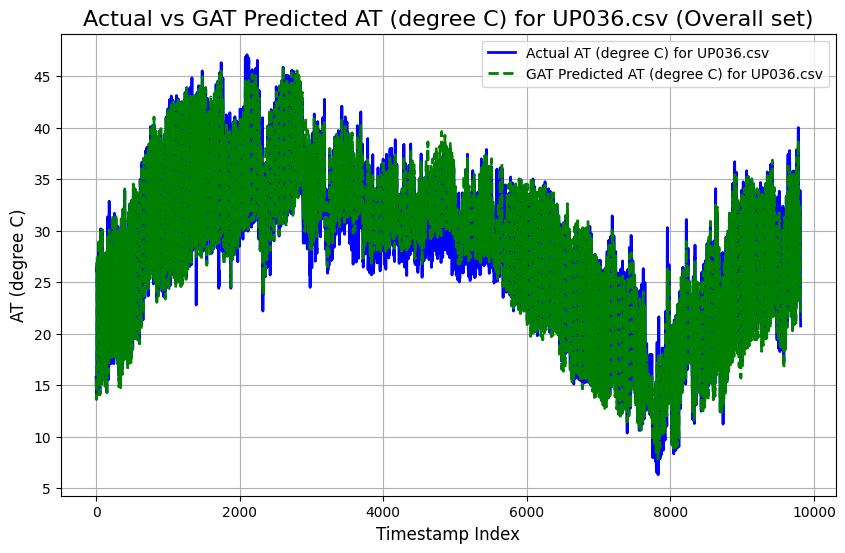

UP037.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1000
Mean Squared Error (MSE): 2.0714
Root Mean Squared Error (RMSE): 1.4392
Pearson Correlation Coefficient: 0.9881
R-squared (R²): 0.9721

----------------------------------------



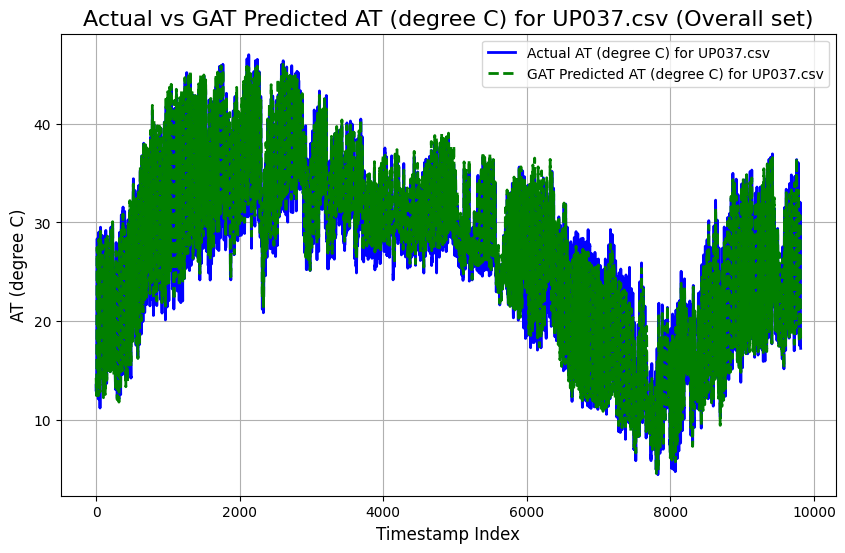

UP038.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9675
Mean Squared Error (MSE): 1.7688
Root Mean Squared Error (RMSE): 1.3299
Pearson Correlation Coefficient: 0.9867
R-squared (R²): 0.9693

----------------------------------------



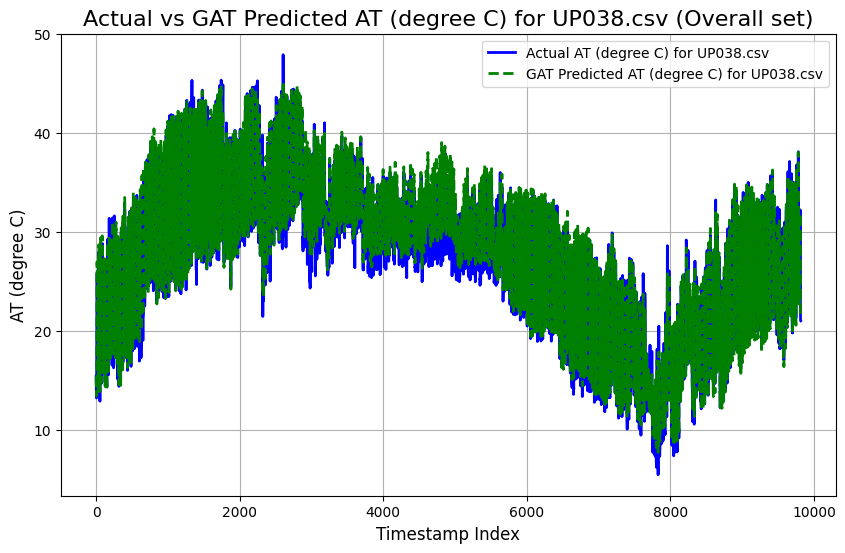

UP039.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5552
Mean Squared Error (MSE): 4.0615
Root Mean Squared Error (RMSE): 2.0153
Pearson Correlation Coefficient: 0.9757
R-squared (R²): 0.9476

----------------------------------------



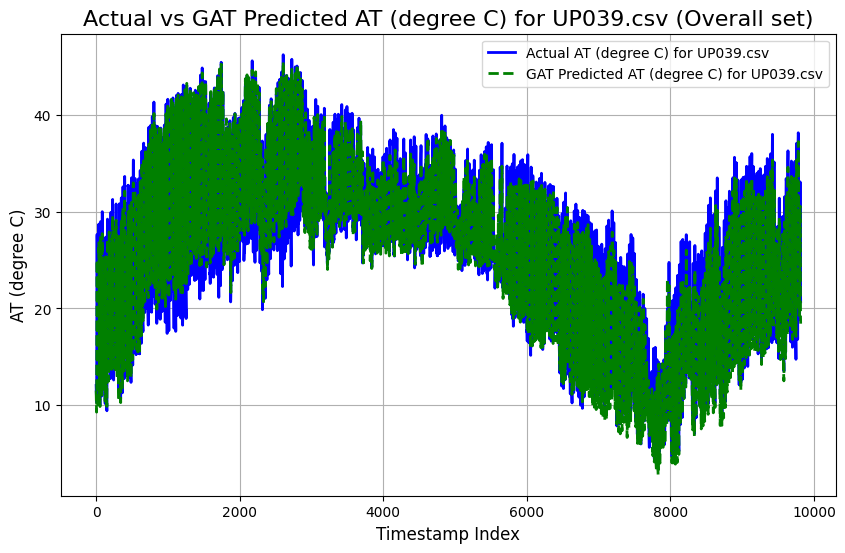

UP040.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3048
Mean Squared Error (MSE): 2.8593
Root Mean Squared Error (RMSE): 1.6909
Pearson Correlation Coefficient: 0.9838
R-squared (R²): 0.9630

----------------------------------------



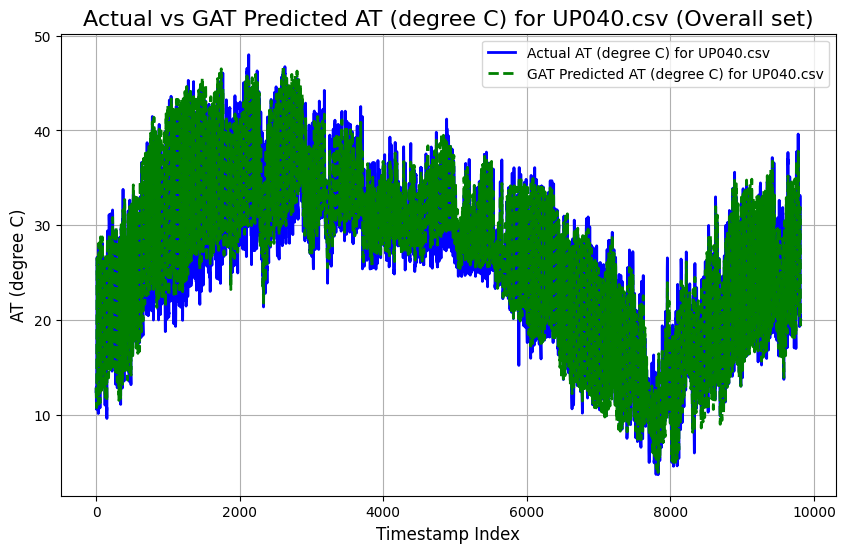

UP041.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0032
Mean Squared Error (MSE): 1.7760
Root Mean Squared Error (RMSE): 1.3327
Pearson Correlation Coefficient: 0.9861
R-squared (R²): 0.9681

----------------------------------------



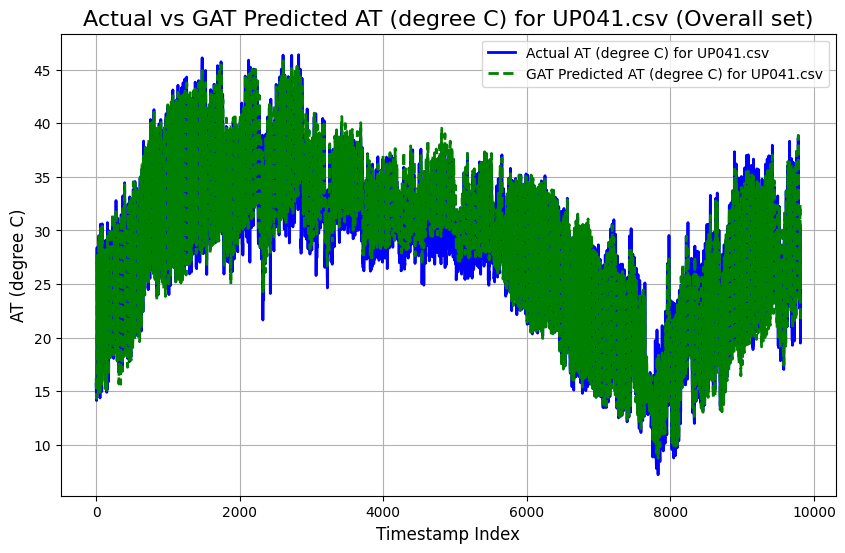

UP042.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0720
Mean Squared Error (MSE): 2.3259
Root Mean Squared Error (RMSE): 1.5251
Pearson Correlation Coefficient: 0.9845
R-squared (R²): 0.9645

----------------------------------------



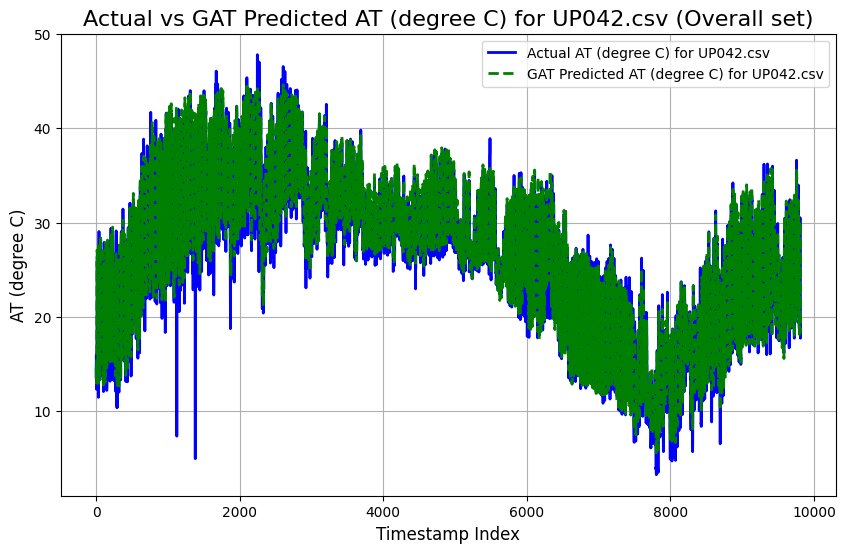

UP043.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0699
Mean Squared Error (MSE): 2.0814
Root Mean Squared Error (RMSE): 1.4427
Pearson Correlation Coefficient: 0.9880
R-squared (R²): 0.9712

----------------------------------------



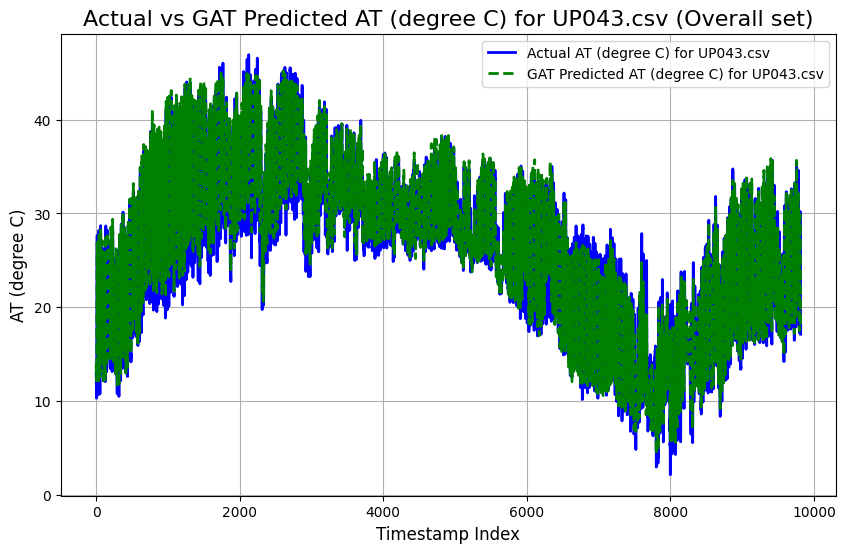

UP044.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1043
Mean Squared Error (MSE): 2.1207
Root Mean Squared Error (RMSE): 1.4563
Pearson Correlation Coefficient: 0.9876
R-squared (R²): 0.9715

----------------------------------------



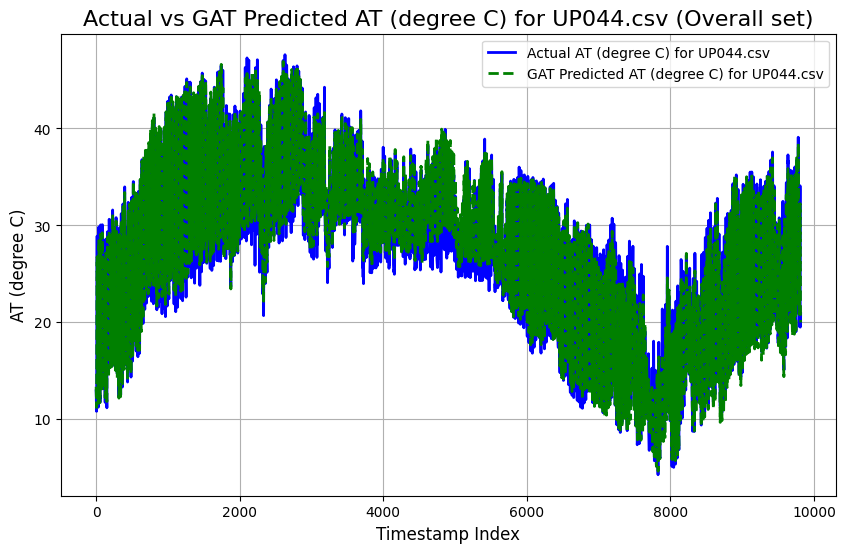

UP046.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3829
Mean Squared Error (MSE): 3.0445
Root Mean Squared Error (RMSE): 1.7448
Pearson Correlation Coefficient: 0.9799
R-squared (R²): 0.9549

----------------------------------------



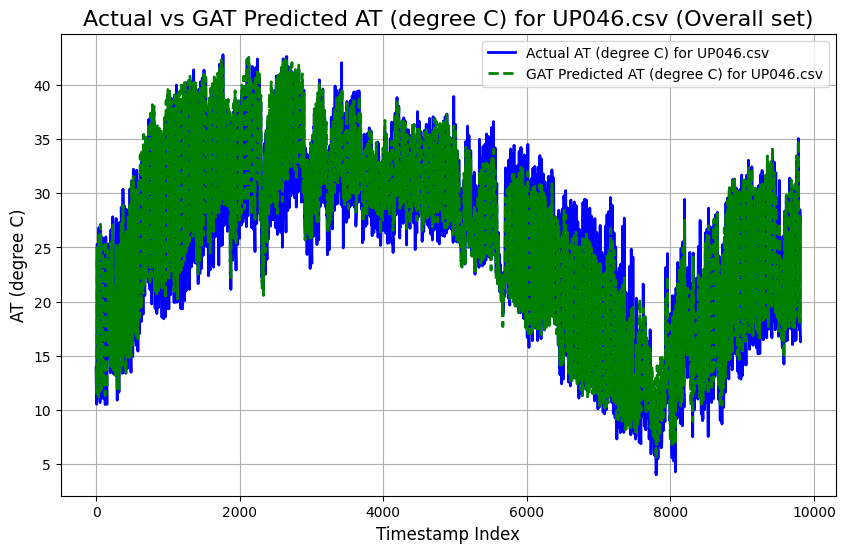

UP048.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5031
Mean Squared Error (MSE): 3.8259
Root Mean Squared Error (RMSE): 1.9560
Pearson Correlation Coefficient: 0.9730
R-squared (R²): 0.9414

----------------------------------------



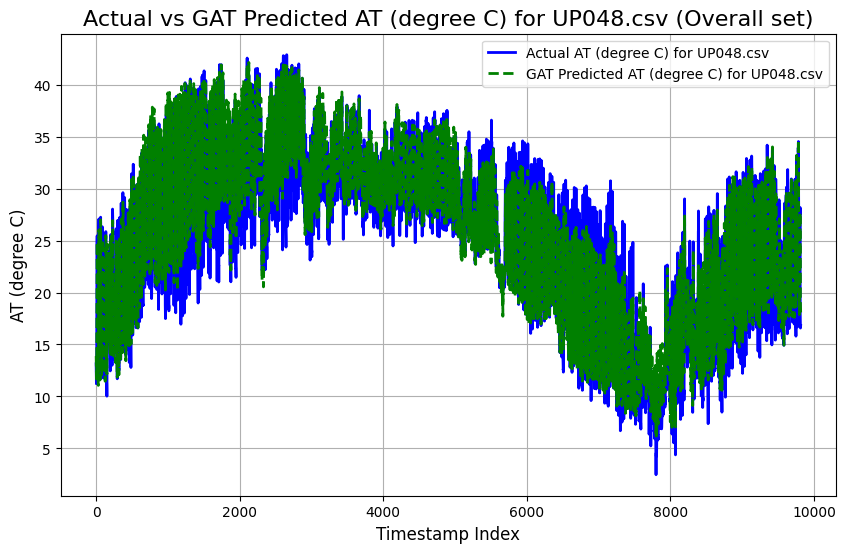

UP049.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3357
Mean Squared Error (MSE): 3.0420
Root Mean Squared Error (RMSE): 1.7441
Pearson Correlation Coefficient: 0.9805
R-squared (R²): 0.9557

----------------------------------------



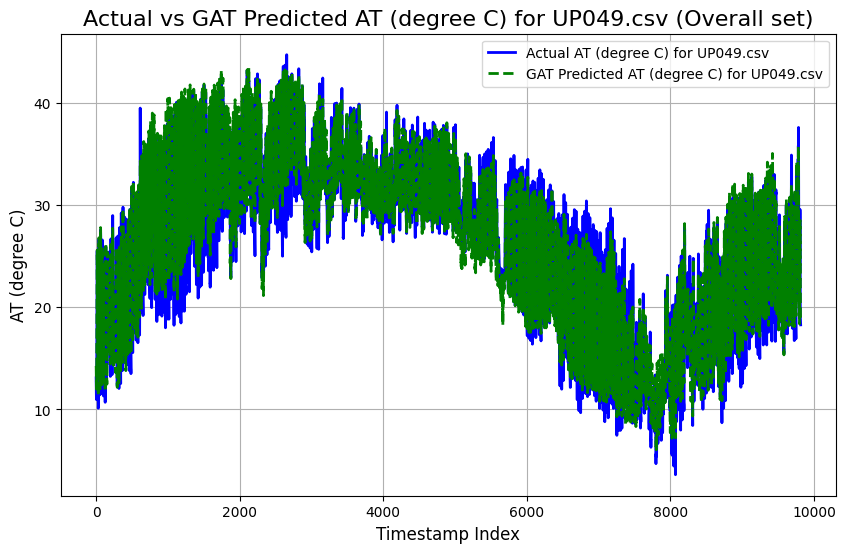

UP050.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4516
Mean Squared Error (MSE): 3.9878
Root Mean Squared Error (RMSE): 1.9970
Pearson Correlation Coefficient: 0.9670
R-squared (R²): 0.9310

----------------------------------------



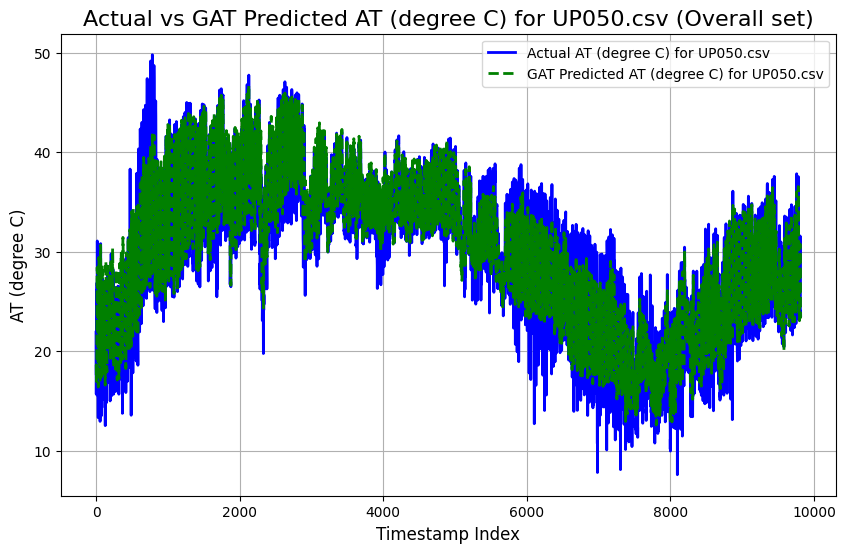

UP051.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.6935
Mean Squared Error (MSE): 24.4296
Root Mean Squared Error (RMSE): 4.9426
Pearson Correlation Coefficient: 0.8312
R-squared (R²): 0.6626

----------------------------------------



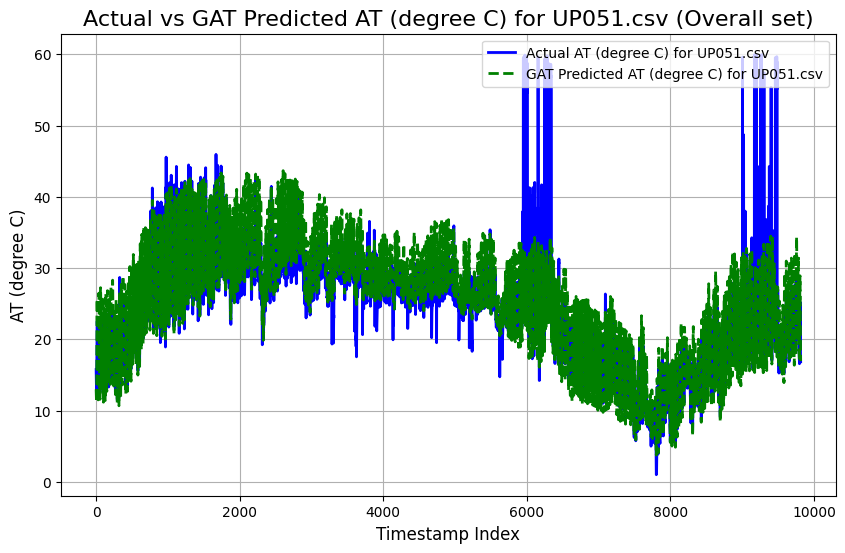

UP052.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5432
Mean Squared Error (MSE): 4.0962
Root Mean Squared Error (RMSE): 2.0239
Pearson Correlation Coefficient: 0.9709
R-squared (R²): 0.9375

----------------------------------------



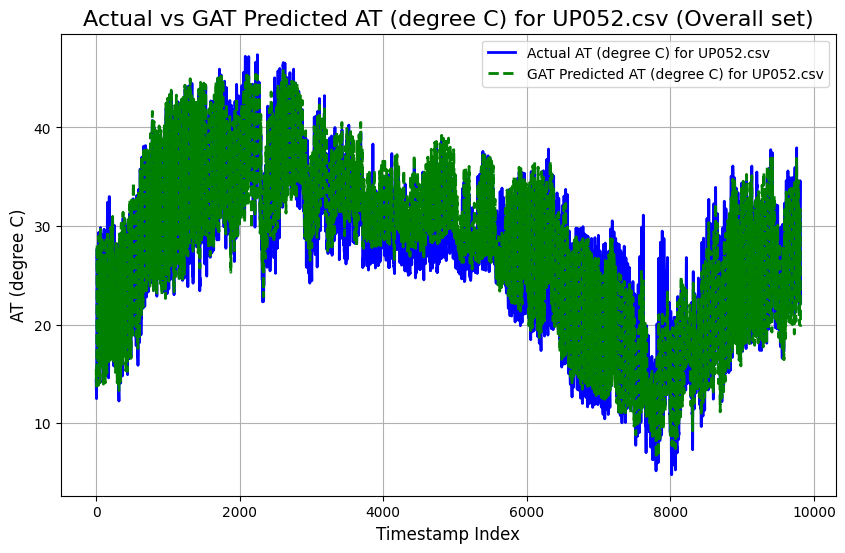

Overall GNN Imputed.csv
CSV file 'Overall GNN Imputed.csv' created successfully.
Shape of gat_outputs: (9816, 41)
Shape of actual_values: (9816, 41)


In [17]:

from torch.optim.lr_scheduler import StepLR
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from scipy.stats import pearsonr

# Define the GAT model
class GATModel(torch.nn.Module):
    def __init__(self, in_channels, out_channels):
        super(GATModel, self).__init__()
        self.conv1 = GATConv(in_channels, 8, heads=8, dropout=0.2)
        self.conv2 = GATConv(8 * 8, out_channels, heads=1, concat=False, dropout=0.2)
        
    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        # First GAT layer followed by ELU activation
        x = self.conv1(x, edge_index)
        x = F.elu(x)
        # Dropout
        x = F.dropout(x, p=0.2, training=self.training)
        
        # Second GAT layer followed by ELU activation
        x = self.conv2(x, edge_index)
        return x

# Initialize the model and optimizer
in_channels = train_graph_data_list[0].x.size(-1)  # Number of input features (depends on the number of columns)
out_channels = 1  # Predicting a single value ('AT (degree C)')
model = GATModel(in_channels, out_channels)

optimizer = torch.optim.Adam(model.parameters(), lr=0.0005, weight_decay=5e-4)
loss_fn = torch.nn.MSELoss()

# StepLR: Reduces the learning rate by gamma every step_size epochs
scheduler = StepLR(optimizer, step_size=5, gamma=0.5)

# Train the GAT model on the training set
def train_gat(graph_data_list, epochs=30):
    model.train()
    for epoch in range(epochs):
        epoch_loss = 0
        for graph_data in graph_data_list:
            optimizer.zero_grad()
            out = model(graph_data)
            loss = loss_fn(out.squeeze(), graph_data.y)
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
        scheduler.step()
        print(f"Epoch {epoch}, Loss: {epoch_loss/len(graph_data_list)}")

# Train the model using the training dataset
train_gat(train_graph_data_list)

# Evaluate the model on the training and testing sets
def evaluate_gat(graph_data_list):
    model.eval()
    gat_outputs = []
    actual_values = []
    with torch.no_grad():
        for graph_data in graph_data_list:
            gat_output = model(graph_data)
            gat_outputs.append(gat_output.squeeze().numpy())
            actual_values.append(graph_data.y.squeeze().numpy())
    return np.array(gat_outputs), np.array(actual_values)

# Get GAT predictions for training and testing sets
train_gat_outputs, train_actual_values = evaluate_gat(train_graph_data_list)
test_gat_outputs, test_actual_values = evaluate_gat(test_graph_data_list)

train_gnn_mae_list = []
train_gnn_mse_list = []
train_gnn_rmse_list = []
train_gnn_pearson_corr_list = []
train_gnn_r_squared_list = []

test_gnn_mae_list = []
test_gnn_mse_list = []
test_gnn_rmse_list = []
test_gnn_pearson_corr_list = []
test_gnn_r_squared_list = []

overall_gnn_mae_list = []
overall_gnn_mse_list = []
overall_gnn_rmse_list = []
overall_gnn_pearson_corr_list = []
overall_gnn_r_squared_list = []

# Apply inverse scaling and calculate performance metrics for training and testing sets
def inverse_scale_and_evaluate(gat_outputs, actual_values, set_type):
    gat_outputs_inverse_scaled = []
    actual_values_inverse_scaled = []
    for node_idx in range(gat_outputs.shape[1]):
        gat_node_values = gat_outputs[:, node_idx].reshape(-1, 1)
        actual_node_values = actual_values[:, node_idx].reshape(-1, 1)
        gat_node_inverse_scaled = scalers[input_files[node_idx]].inverse_transform(gat_node_values).flatten()
        actual_node_inverse_scaled = scalers[input_files[node_idx]].inverse_transform(actual_node_values).flatten()
        gat_outputs_inverse_scaled.append(gat_node_inverse_scaled)
        actual_values_inverse_scaled.append(actual_node_inverse_scaled)
    
    # Evaluate performance metrics for each node
    num_nodes = gat_outputs.shape[1]
    for node_idx in range(num_nodes):
        actual = actual_values_inverse_scaled[node_idx]
        predicted = gat_outputs_inverse_scaled[node_idx]
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        rmse = np.sqrt(mse)
        pearson_corr, _ = pearsonr(actual, predicted)
        r_squared = r2_score(actual, predicted)
        
        print(f"{input_files[node_idx]} ({set_type} set) Metrics:")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
        print(f"Pearson Correlation Coefficient: {pearson_corr:.4f}")
        print(f"R-squared (R²): {r_squared:.4f}")
        print("\n" + "-"*40 + "\n")

        if(set_type == 'Training'):
            train_gnn_mae_list.append(mae)
            train_gnn_mse_list.append(mse)
            train_gnn_rmse_list.append(rmse)
            train_gnn_pearson_corr_list.append(pearson_corr)
            train_gnn_r_squared_list.append(r_squared)

        if(set_type == 'Testing'):
            test_gnn_mae_list.append(mae)
            test_gnn_mse_list.append(mse)
            test_gnn_rmse_list.append(rmse)
            test_gnn_pearson_corr_list.append(pearson_corr)
            test_gnn_r_squared_list.append(r_squared)

        if(set_type == 'Overall'):
            overall_gnn_mae_list.append(mae)
            overall_gnn_mse_list.append(mse)
            overall_gnn_rmse_list.append(rmse)
            overall_gnn_pearson_corr_list.append(pearson_corr)
            overall_gnn_r_squared_list.append(r_squared)        
        
        # Plot actual vs predicted values for this node
        plt.figure(figsize=(10, 6))
        plt.plot(actual, label=f'Actual AT (degree C) for {input_files[node_idx]}', color='blue', linewidth=2)
        plt.plot(predicted, label=f'GAT Predicted AT (degree C) for {input_files[node_idx]}', color='green', linestyle='--', linewidth=2)
        plt.title(f'Actual vs GAT Predicted AT (degree C) for {input_files[node_idx]} ({set_type} set)', fontsize=16)
        plt.xlabel('Timestamp Index', fontsize=12)
        plt.ylabel('AT (degree C)', fontsize=12)
        plt.legend(loc='upper right')
        plt.grid(True)
        plt.show()

# Evaluate and plot for both training and testing sets
inverse_scale_and_evaluate(train_gat_outputs, train_actual_values, 'Training')
inverse_scale_and_evaluate(test_gat_outputs, test_actual_values, 'Testing')

def create_metrics_gnn_csv(file_name, input_files, mae_list, mse_list, rmse_list, r2_list, corr_list):
    metrics_df = pd.DataFrame({
        "File Name": input_files,
        "MAE": mae_list,
        "MSE": mse_list,
        "RMSE": rmse_list,
        "R2": r2_list,
        "CorrCoeff": corr_list
    })
    metrics_df.to_csv(file_name, index=False)
    print(f"CSV file '{file_name}' created successfully.")


# Create CSV for training set
file_name = "Train GNN Imputed.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, train_gnn_mae_list, train_gnn_mse_list, train_gnn_rmse_list, train_gnn_r_squared_list, train_gnn_pearson_corr_list)

# Create CSV for training set
file_name = "Test GNN Imputed.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, test_gnn_mae_list, test_gnn_mse_list, test_gnn_rmse_list, test_gnn_r_squared_list, test_gnn_pearson_corr_list)

# Concatenate training and testing outputs
gat_outputs = np.concatenate([train_gat_outputs, test_gat_outputs], axis=0)
actual_values = np.concatenate([train_actual_values, test_actual_values], axis=0)
inverse_scale_and_evaluate(gat_outputs, actual_values, 'Overall')

# Create CSV for overall set
file_name = "Overall GNN Imputed.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, overall_gnn_mae_list, overall_gnn_mse_list, overall_gnn_rmse_list, overall_gnn_r_squared_list, overall_gnn_pearson_corr_list)

# Print the shapes of gat_outputs and actual_values
print(f"Shape of gat_outputs: {gat_outputs.shape}")
print(f"Shape of actual_values: {actual_values.shape}")


# Showing the GAT outputs and actual outputs

In [18]:
gat_outputs_without_inverse_scaled = []
actual_values_without_inverse_scaled = []

for node_idx in range(gat_outputs.shape[1]):
    # Extract predictions and actual values for the current node across all timestamps
    gat_node_values = gat_outputs[:, node_idx].reshape(-1, 1)
    actual_node_values = actual_values[:, node_idx].reshape(-1, 1)
    
    # Append the inverse scaled values for this node
    gat_outputs_without_inverse_scaled.append(gat_node_values)
    actual_values_without_inverse_scaled.append(actual_node_values)

# Plot the actual vs predicted values for each node
num_nodes = gat_outputs.shape[1]
print(gat_outputs_without_inverse_scaled)
print(actual_values_without_inverse_scaled)


[array([[-1.5497795],
       [-1.5879201],
       [-1.6285176],
       ...,
       [-0.6986601],
       [-0.7458018],
       [-0.7745208]], dtype=float32), array([[-1.5889729 ],
       [-1.6173788 ],
       [-1.6648352 ],
       ...,
       [-0.80411255],
       [-0.8478593 ],
       [-0.828802  ]], dtype=float32), array([[-1.4393111 ],
       [-1.4773903 ],
       [-1.5316113 ],
       ...,
       [-0.92188686],
       [-0.95261544],
       [-0.99663407]], dtype=float32), array([[-1.4460096 ],
       [-1.4761282 ],
       [-1.5431225 ],
       ...,
       [-0.8171749 ],
       [-0.8334611 ],
       [-0.83099854]], dtype=float32), array([[-1.4554309 ],
       [-1.4746338 ],
       [-1.5613189 ],
       ...,
       [-0.8357268 ],
       [-0.85788274],
       [-0.86006093]], dtype=float32), array([[-1.4417173 ],
       [-1.474828  ],
       [-1.5398637 ],
       ...,
       [-0.87120515],
       [-0.8954517 ],
       [-0.91581076]], dtype=float32), array([[-1.4302428],
       [-1.4425772

# Adding the GNN predicted values as a new column

In [19]:
train_gat_outputs_without_inverse_scaled = []
test_gat_outputs_without_inverse_scaled = []
train_size = train_dataframes[0].shape[0]

for node_idx in range(num_nodes):
    train1 = gat_outputs_without_inverse_scaled[node_idx][:train_size]
    test1 = gat_outputs_without_inverse_scaled[node_idx][train_size:]
    train_gat_outputs_without_inverse_scaled.append(train1)
    test_gat_outputs_without_inverse_scaled.append(test1)

# Add predicted values as a new column in each dataframe and print column and row details
for node_idx, df in enumerate(train_dataframes):
    # Extract the predicted values for the current node (inverse scaled)
    predicted_values = train_gat_outputs_without_inverse_scaled[node_idx].flatten()
    print(df.shape)
    print(len(predicted_values))

    # Add a new column for the predicted values
    df['Predicted AT (degree C)'] = predicted_values

    # Print column numbers and names
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}: Columns")
    for col_idx, col_name in enumerate(df.columns):
        print(f"Column {col_idx + 1}: {col_name}")

    print(f"Row numbers total: {len(df)}")    

# Optionally print the first few rows to verify the predicted column was added correctly
    print(df.head(10))  # Display the first few rows of the dataframe for verification
    print("\n" + "="*60 + "\n")


# Add predicted values as a new column in each dataframe and print column and row details
for node_idx, df in enumerate(test_dataframes):
    # Extract the predicted values for the current node (inverse scaled)
    predicted_values = test_gat_outputs_without_inverse_scaled[node_idx].flatten()

    # Add a new column for the predicted values
    df['Predicted AT (degree C)'] = predicted_values

    # Print column numbers and names
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}: Columns")
    for col_idx, col_name in enumerate(df.columns):
        print(f"Column {col_idx + 1}: {col_name}")

    print(f"Row numbers total: {len(df)}")    

# Optionally print the first few rows to verify the predicted column was added correctly
    print(df.head(10))  # Display the first few rows of the dataframe for verification
    print("\n" + "="*60 + "\n")


(8343, 15)
8343
DataFrame 1 - UP002.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       0.026293      0.443649    0.117046     0.433734    -0.846243   
1       0.106304      0.344591    0.081311     0.343616    -0.313307   
2       0.078903      0.248329    0.201752     0.640199     0.095690   
3       0.086575      0.237278    0.102818     0.593795     0.157659   
4      -0.176474      0.093884    0.053185     0.202385     0.201038   
5      -0.087257      0.001749    0.093884     0.336890    -0.084021   
6      -0.172748     -0.006638    0.213995     0.894078    -0.112940   
7       0.0

C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

(8343, 15)
8343
DataFrame 10 - UP018.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       2.130796      2.589448    0.053946    -0.522388    -0.687585   
1       1.342605      1.136827   -0.042484    -0.509171    -0.896767   
2       1.066332      0.730251    0.533840     0.693953    -0.266008   
3       0.907882      0.570384    0.017688    -0.474545    -0.884462   
4       0.704740      0.580252    0.063011    -0.495955    -0.721604   
5       0.668174      0.475648    0.046617    -0.483268    -0.647775   
6       0.802248      0.651304    0.045267    -0.485118    -0.680347   
7       1.

C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

(8343, 15)
8343
DataFrame 33 - UP042.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       0.963019      0.269720    0.260286     2.486714    -1.859880   
1       0.927634      0.211461    0.083564     1.962432    -1.866562   
2       0.792545      0.165412    0.065602     1.664652    -1.871908   
3       0.825038      0.404450    0.187280     2.007574    -1.867899   
4       0.830379      0.241159    0.450914     2.200814    -1.869235   
5       0.857753      0.404968    1.090010     2.128745    -1.831816   
6       0.913390      0.386652    1.920314     2.055884    -1.807760   
7       1.

C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

      PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
8343       2.806519      0.981797    0.860827     0.243858    -0.564294   
8344       2.662043      0.804589    0.361496     0.259496    -0.520567   
8345       2.291092      0.686450    0.463104     0.221880    -0.511822   
8346       2.353568      0.726409    0.564712     0.173274    -0.517288   
8347       2.193473      0.601321    0.956628     0.225684    -0.561014   
8348       1.912331      0.484920    1.064042     0.400243    -0.544617   
8349       1.963093      0.521404    1.557567     0.533381    -0.440766   
8350       1.602607      0.458860    1.673690     0.534226    -0.491052   
8351       0.846335      0.014103    0.971144     0.483929    -0.517288   
8352       0.346527     -0.498409    0.724382     0.417149    -0.571946   

      CO (mg/m3)  Ozone (ug/m3)    RH (%)  WS (m/s)  WD (degree)  \
8343    0.438627      -0.677642  1.169184  3.070495     0.577669   
8344    0.361658      -0.595021  1.253

C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_10220\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

# Creating feature and target lists

In [20]:
# Initialize lists to store features and target for each dataframe
train_features_list = []
train_target_list = []

test_features_list = []
test_target_list = []

# Iterate over each dataframe to separate features and target
for node_idx, (df1, df2) in enumerate(zip(train_dataframes, test_dataframes)):
    # Features include all columns except 'AT (degree C)'
    trainfeatures1 = df1.drop(columns=['AT (degree C)'])
    testfeatures1 = df2.drop(columns=['AT (degree C)'])
    
    # Target is the 'AT (degree C)' column
    traintarget1 = df1['AT (degree C)']
    testtarget1 = df2['AT (degree C)']
    
    # Append the features and target to the respective lists
    train_features_list.append(trainfeatures1)
    train_target_list.append(traintarget1)
    test_features_list.append(testfeatures1)
    test_target_list.append(testtarget1)
    
    # Print the columns of features and target, and number of rows
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}:")
    print(f"Features columns: {len(trainfeatures1.columns)}")
    print(trainfeatures1.columns)
    
    print("\nTarget column:")
    print(traintarget1.name)
    
    print(f"\nNumber of rows in training features: {trainfeatures1.shape[0]}")
    print(f"Number of rows in training target: {traintarget1.shape[0]}")
    print(f"\nNumber of rows in testing features: {testfeatures1.shape[0]}")
    print(f"Number of rows in testing target: {testtarget1.shape[0]}")
    print("\n" + "="*60 + "\n")

DataFrame 1 - UP002.csv:
Features columns: 15
Index(['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)',
       'SO2 (ug/m3)', 'CO (mg/m3)', 'Ozone (ug/m3)', 'RH (%)', 'WS (m/s)',
       'WD (degree)', 'Year', 'Month', 'Day', 'Hour',
       'Predicted AT (degree C)'],
      dtype='object')

Target column:
AT (degree C)

Number of rows in training features: 8343
Number of rows in training target: 8343

Number of rows in testing features: 1473
Number of rows in testing target: 1473


DataFrame 2 - UP003.csv:
Features columns: 15
Index(['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)',
       'SO2 (ug/m3)', 'CO (mg/m3)', 'Ozone (ug/m3)', 'RH (%)', 'WS (m/s)',
       'WD (degree)', 'Year', 'Month', 'Day', 'Hour',
       'Predicted AT (degree C)'],
      dtype='object')

Target column:
AT (degree C)

Number of rows in training features: 8343
Number of rows in training target: 8343

Number of rows in testing features: 1473
Number of rows in testing target: 1473


DataFr

# GRU Model Implementation

For Batch Size= 3 and Sequence Length = 3
Processing node 1...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0805
Epoch [2/50], Train Loss: 0.0532
Epoch [3/50], Train Loss: 0.0491
Epoch [4/50], Train Loss: 0.0472
Epoch [5/50], Train Loss: 0.0455
Epoch [6/50], Train Loss: 0.0448
Epoch [7/50], Train Loss: 0.0438
Epoch [8/50], Train Loss: 0.0423
Epoch [9/50], Train Loss: 0.0414
Epoch [10/50], Train Loss: 0.0409
Epoch [11/50], Train Loss: 0.0399
Epoch [12/50], Train Loss: 0.0397
Epoch [13/50], Train Loss: 0.0402
Epoch [14/50], Train Loss: 0.0392
Epoch [15/50], Train Loss: 0.0391
Epoch [16/50], Train Loss: 0.0385
Epoch [17/50], Train Loss: 0.0382
Epoch [18/50], Train Loss: 0.0375
Epoch [19/50], Train Loss: 0.0368
Epoch [20/50], Train Loss: 0.0363
Epoch [21/50], Train Loss: 0.0361
Epoch [22/50], Train Loss: 0.0366
Epoch [23/50], Train Loss: 0.0359
Epoch [24/50], Train Loss: 0.0349
Epoch [25/50], Train Loss: 0.0356
Epoch [26/50], Train Loss: 0.0348
Epoch [27/50], Train Loss: 0.0344
Epoch [28/50], Train Loss: 0.0341
Epoch [29/50], Train Loss: 0.0335
Epoch [30/50], Train Lo

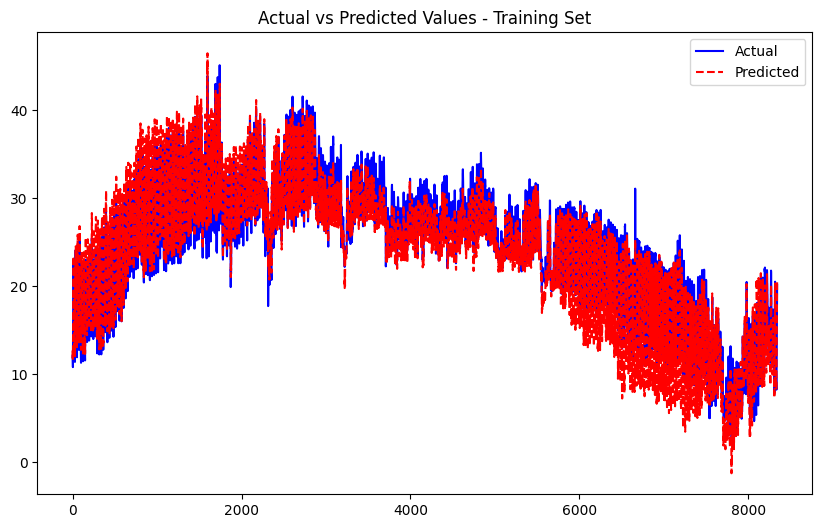

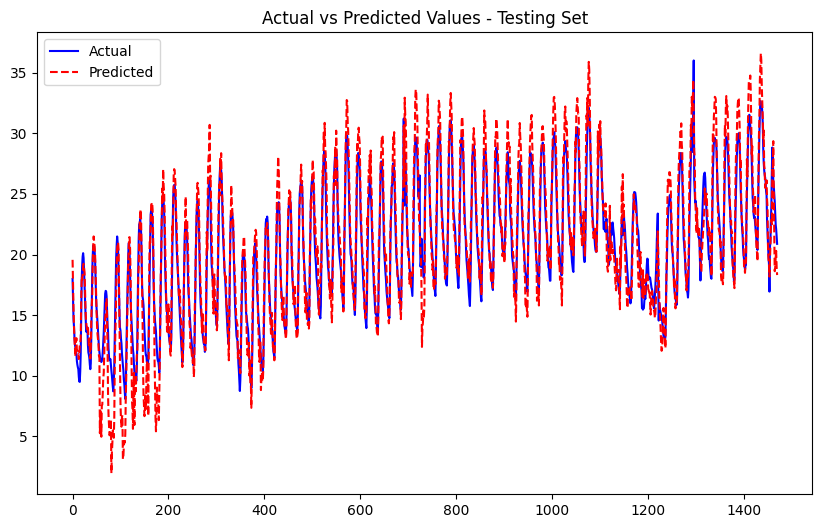

Processing node 2...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0418
Epoch [2/50], Train Loss: 0.0371
Epoch [3/50], Train Loss: 0.0348
Epoch [4/50], Train Loss: 0.0344
Epoch [5/50], Train Loss: 0.0331
Epoch [6/50], Train Loss: 0.0319
Epoch [7/50], Train Loss: 0.0316
Epoch [8/50], Train Loss: 0.0310
Epoch [9/50], Train Loss: 0.0305
Epoch [10/50], Train Loss: 0.0306
Epoch [11/50], Train Loss: 0.0295
Epoch [12/50], Train Loss: 0.0291
Epoch [13/50], Train Loss: 0.0288
Epoch [14/50], Train Loss: 0.0283
Epoch [15/50], Train Loss: 0.0284
Epoch [16/50], Train Loss: 0.0278
Epoch [17/50], Train Loss: 0.0279
Epoch [18/50], Train Loss: 0.0276
Epoch [19/50], Train Loss: 0.0272
Epoch [20/50], Train Loss: 0.0267
Epoch [21/50], Train Loss: 0.0266
Epoch [22/50], Train Loss: 0.0267
Epoch [23/50], Train Loss: 0.0264
Epoch [24/50], Train Loss: 0.0267
Epoch [25/50], Train Loss: 0.0264
Epoch [26/50], Train Loss: 0.0259
Epoch [27/50], Train Loss: 0.0256
Epoch [28/50], Train Loss: 0.0258
Epoch [29/50], Train Loss: 0.0256
Epoch [30/50], Train Lo

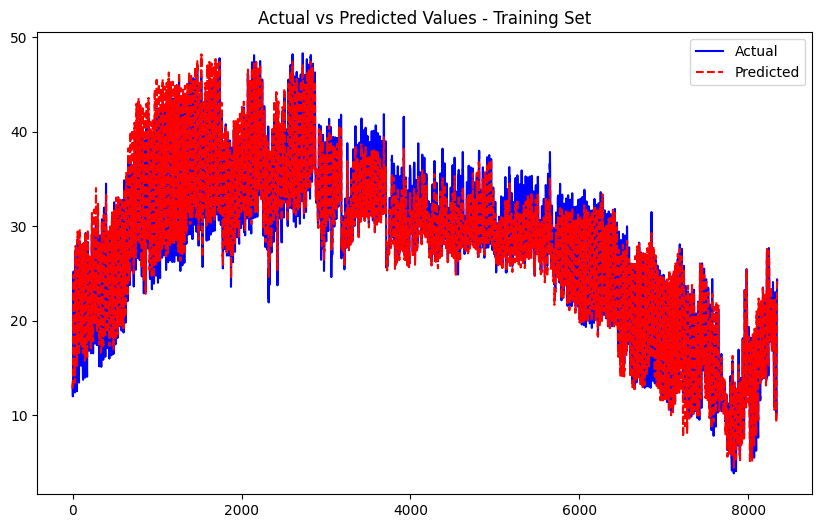

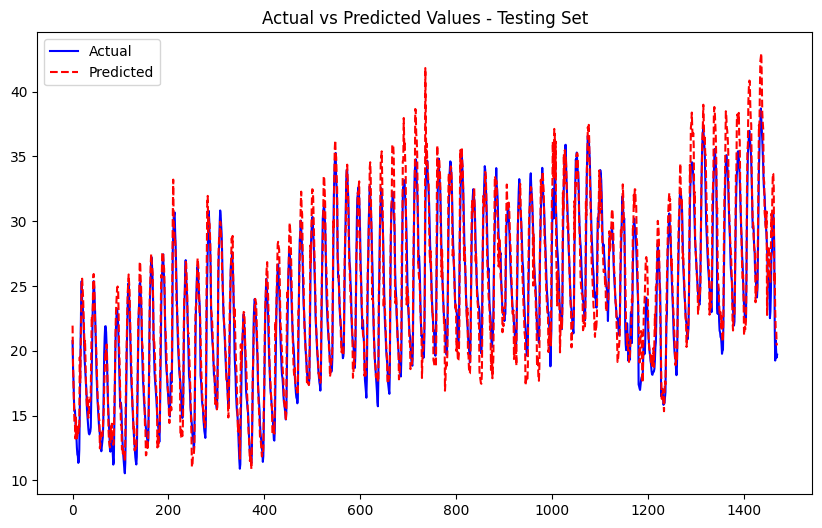

Processing node 3...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0352
Epoch [2/50], Train Loss: 0.0306
Epoch [3/50], Train Loss: 0.0290
Epoch [4/50], Train Loss: 0.0275
Epoch [5/50], Train Loss: 0.0273
Epoch [6/50], Train Loss: 0.0261
Epoch [7/50], Train Loss: 0.0253
Epoch [8/50], Train Loss: 0.0252
Epoch [9/50], Train Loss: 0.0244
Epoch [10/50], Train Loss: 0.0246
Epoch [11/50], Train Loss: 0.0239
Epoch [12/50], Train Loss: 0.0234
Epoch [13/50], Train Loss: 0.0234
Epoch [14/50], Train Loss: 0.0229
Epoch [15/50], Train Loss: 0.0227
Epoch [16/50], Train Loss: 0.0227
Epoch [17/50], Train Loss: 0.0221
Epoch [18/50], Train Loss: 0.0225
Epoch [19/50], Train Loss: 0.0222
Epoch [20/50], Train Loss: 0.0218
Epoch [21/50], Train Loss: 0.0215
Epoch [22/50], Train Loss: 0.0216
Epoch [23/50], Train Loss: 0.0214
Epoch [24/50], Train Loss: 0.0210
Epoch [25/50], Train Loss: 0.0211
Epoch [26/50], Train Loss: 0.0215
Epoch [27/50], Train Loss: 0.0207
Epoch [28/50], Train Loss: 0.0211
Epoch [29/50], Train Loss: 0.0208
Epoch [30/50], Train Lo

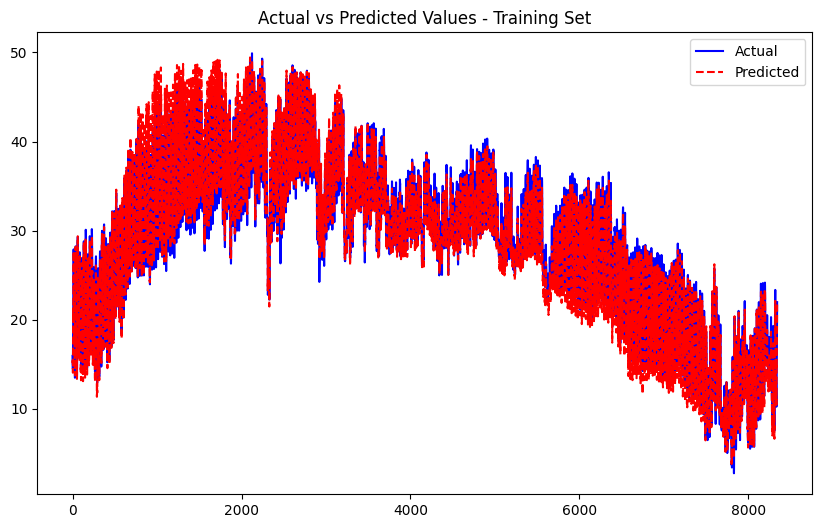

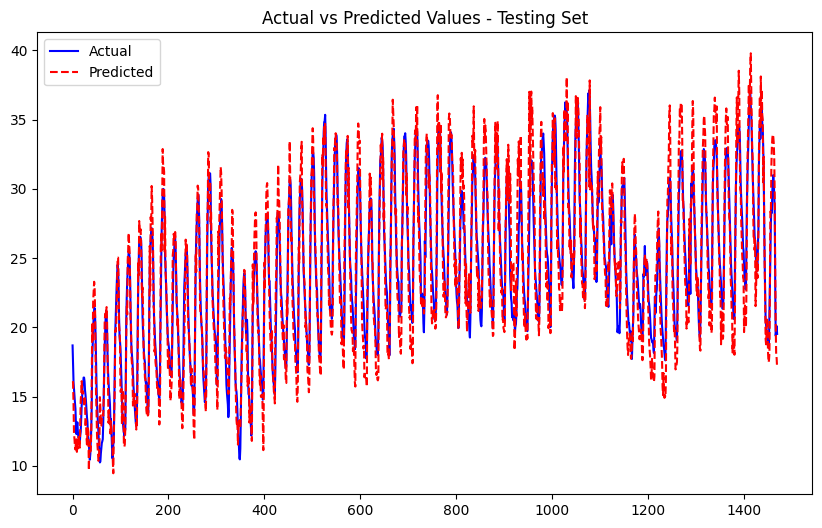

Processing node 4...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2048
Epoch [2/50], Train Loss: 0.1854
Epoch [3/50], Train Loss: 0.1734
Epoch [4/50], Train Loss: 0.1639
Epoch [5/50], Train Loss: 0.1564
Epoch [6/50], Train Loss: 0.1430
Epoch [7/50], Train Loss: 0.1293
Epoch [8/50], Train Loss: 0.1194
Epoch [9/50], Train Loss: 0.1107
Epoch [10/50], Train Loss: 0.1047
Epoch [11/50], Train Loss: 0.0978
Epoch [12/50], Train Loss: 0.0918
Epoch [13/50], Train Loss: 0.0893
Epoch [14/50], Train Loss: 0.0881
Epoch [15/50], Train Loss: 0.0828
Epoch [16/50], Train Loss: 0.0808
Epoch [17/50], Train Loss: 0.0760
Epoch [18/50], Train Loss: 0.0737
Epoch [19/50], Train Loss: 0.0714
Epoch [20/50], Train Loss: 0.0684
Epoch [21/50], Train Loss: 0.0665
Epoch [22/50], Train Loss: 0.0694
Epoch [23/50], Train Loss: 0.0632
Epoch [24/50], Train Loss: 0.0592
Epoch [25/50], Train Loss: 0.0605
Epoch [26/50], Train Loss: 0.0563
Epoch [27/50], Train Loss: 0.0543
Epoch [28/50], Train Loss: 0.0518
Epoch [29/50], Train Loss: 0.0553
Epoch [30/50], Train Lo

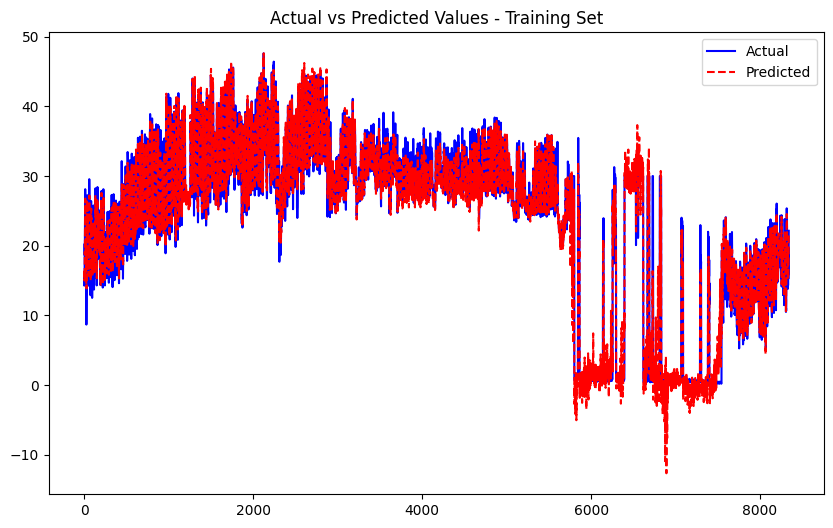

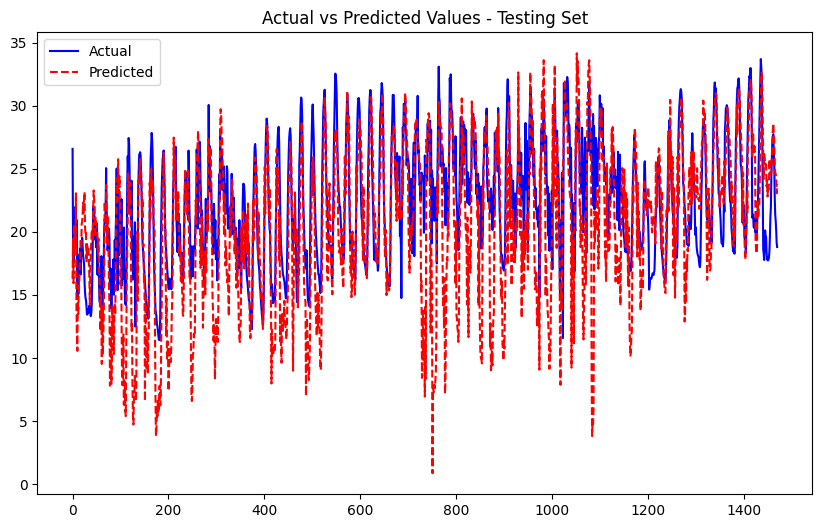

Processing node 5...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0575
Epoch [2/50], Train Loss: 0.0420
Epoch [3/50], Train Loss: 0.0366
Epoch [4/50], Train Loss: 0.0332
Epoch [5/50], Train Loss: 0.0314
Epoch [6/50], Train Loss: 0.0301
Epoch [7/50], Train Loss: 0.0293
Epoch [8/50], Train Loss: 0.0284
Epoch [9/50], Train Loss: 0.0273
Epoch [10/50], Train Loss: 0.0265
Epoch [11/50], Train Loss: 0.0266
Epoch [12/50], Train Loss: 0.0261
Epoch [13/50], Train Loss: 0.0251
Epoch [14/50], Train Loss: 0.0248
Epoch [15/50], Train Loss: 0.0247
Epoch [16/50], Train Loss: 0.0243
Epoch [17/50], Train Loss: 0.0239
Epoch [18/50], Train Loss: 0.0236
Epoch [19/50], Train Loss: 0.0234
Epoch [20/50], Train Loss: 0.0235
Epoch [21/50], Train Loss: 0.0232
Epoch [22/50], Train Loss: 0.0228
Epoch [23/50], Train Loss: 0.0223
Epoch [24/50], Train Loss: 0.0227
Epoch [25/50], Train Loss: 0.0229
Epoch [26/50], Train Loss: 0.0224
Epoch [27/50], Train Loss: 0.0222
Epoch [28/50], Train Loss: 0.0221
Epoch [29/50], Train Loss: 0.0220
Epoch [30/50], Train Lo

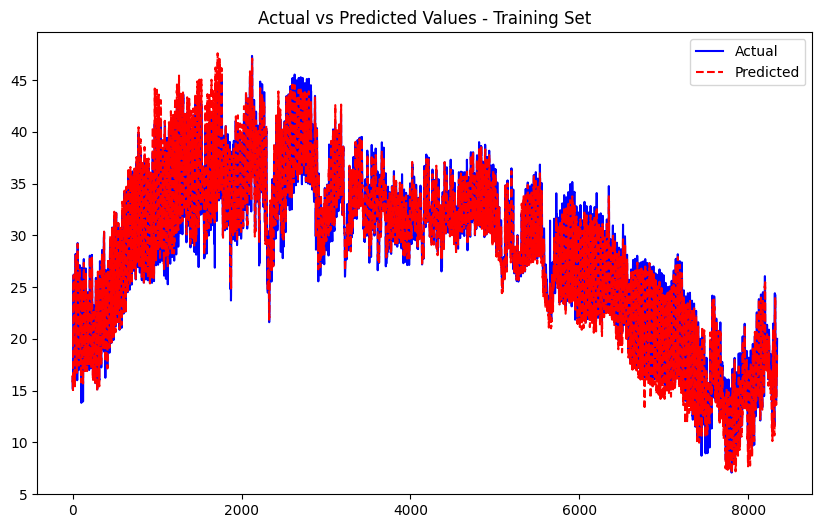

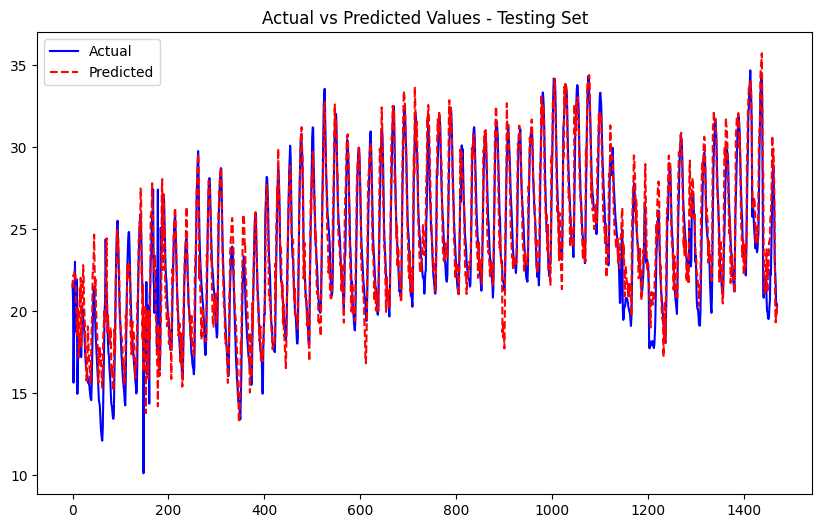

Processing node 6...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0527
Epoch [2/50], Train Loss: 0.0458
Epoch [3/50], Train Loss: 0.0421
Epoch [4/50], Train Loss: 0.0401
Epoch [5/50], Train Loss: 0.0387
Epoch [6/50], Train Loss: 0.0363
Epoch [7/50], Train Loss: 0.0356
Epoch [8/50], Train Loss: 0.0350
Epoch [9/50], Train Loss: 0.0339
Epoch [10/50], Train Loss: 0.0334
Epoch [11/50], Train Loss: 0.0329
Epoch [12/50], Train Loss: 0.0323
Epoch [13/50], Train Loss: 0.0321
Epoch [14/50], Train Loss: 0.0313
Epoch [15/50], Train Loss: 0.0313
Epoch [16/50], Train Loss: 0.0308
Epoch [17/50], Train Loss: 0.0305
Epoch [18/50], Train Loss: 0.0306
Epoch [19/50], Train Loss: 0.0299
Epoch [20/50], Train Loss: 0.0300
Epoch [21/50], Train Loss: 0.0292
Epoch [22/50], Train Loss: 0.0297
Epoch [23/50], Train Loss: 0.0291
Epoch [24/50], Train Loss: 0.0291
Epoch [25/50], Train Loss: 0.0286
Epoch [26/50], Train Loss: 0.0287
Epoch [27/50], Train Loss: 0.0289
Epoch [28/50], Train Loss: 0.0283
Epoch [29/50], Train Loss: 0.0282
Epoch [30/50], Train Lo

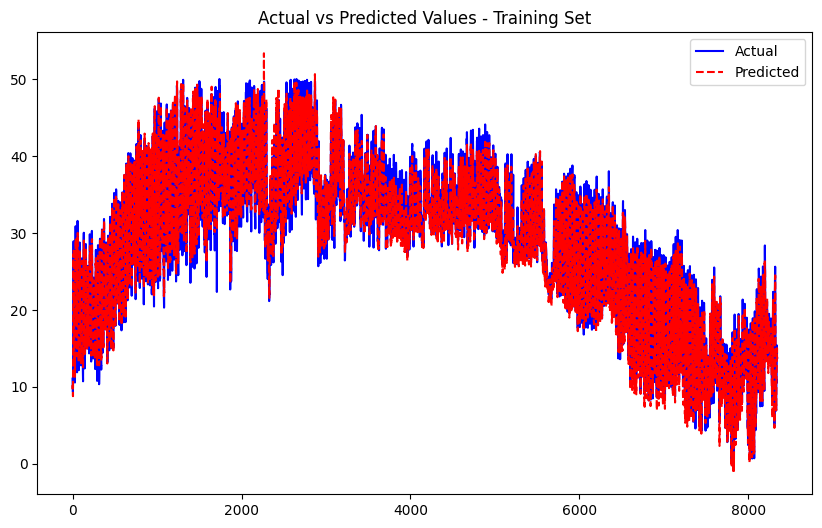

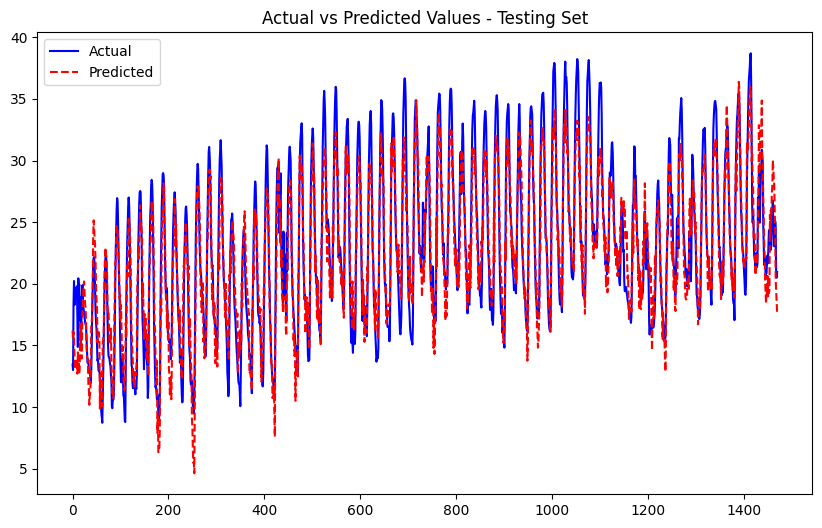

Processing node 7...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0586
Epoch [2/50], Train Loss: 0.0510
Epoch [3/50], Train Loss: 0.0461
Epoch [4/50], Train Loss: 0.0434
Epoch [5/50], Train Loss: 0.0415
Epoch [6/50], Train Loss: 0.0389
Epoch [7/50], Train Loss: 0.0382
Epoch [8/50], Train Loss: 0.0365
Epoch [9/50], Train Loss: 0.0349
Epoch [10/50], Train Loss: 0.0342
Epoch [11/50], Train Loss: 0.0330
Epoch [12/50], Train Loss: 0.0325
Epoch [13/50], Train Loss: 0.0318
Epoch [14/50], Train Loss: 0.0312
Epoch [15/50], Train Loss: 0.0308
Epoch [16/50], Train Loss: 0.0303
Epoch [17/50], Train Loss: 0.0295
Epoch [18/50], Train Loss: 0.0294
Epoch [19/50], Train Loss: 0.0291
Epoch [20/50], Train Loss: 0.0290
Epoch [21/50], Train Loss: 0.0282
Epoch [22/50], Train Loss: 0.0277
Epoch [23/50], Train Loss: 0.0277
Epoch [24/50], Train Loss: 0.0277
Epoch [25/50], Train Loss: 0.0272
Epoch [26/50], Train Loss: 0.0275
Epoch [27/50], Train Loss: 0.0266
Epoch [28/50], Train Loss: 0.0270
Epoch [29/50], Train Loss: 0.0268
Epoch [30/50], Train Lo

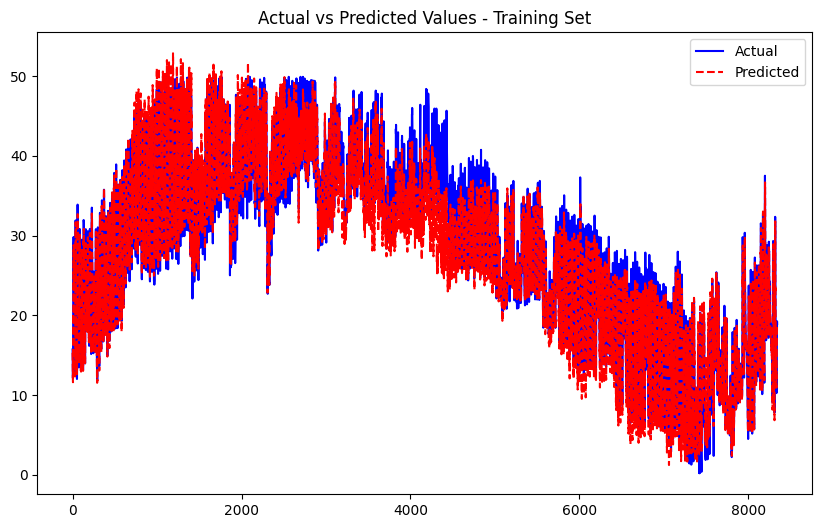

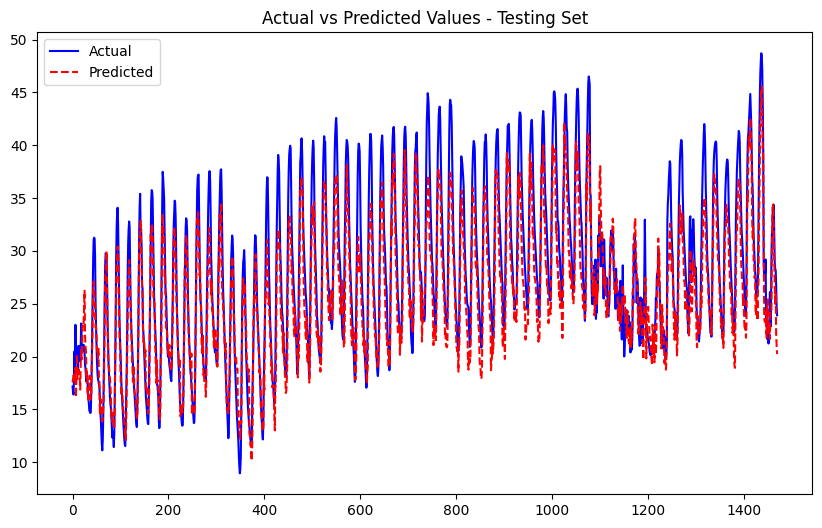

Processing node 8...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0651
Epoch [2/50], Train Loss: 0.0546
Epoch [3/50], Train Loss: 0.0503
Epoch [4/50], Train Loss: 0.0468
Epoch [5/50], Train Loss: 0.0440
Epoch [6/50], Train Loss: 0.0435
Epoch [7/50], Train Loss: 0.0419
Epoch [8/50], Train Loss: 0.0400
Epoch [9/50], Train Loss: 0.0389
Epoch [10/50], Train Loss: 0.0382
Epoch [11/50], Train Loss: 0.0373
Epoch [12/50], Train Loss: 0.0365
Epoch [13/50], Train Loss: 0.0363
Epoch [14/50], Train Loss: 0.0353
Epoch [15/50], Train Loss: 0.0355
Epoch [16/50], Train Loss: 0.0347
Epoch [17/50], Train Loss: 0.0339
Epoch [18/50], Train Loss: 0.0339
Epoch [19/50], Train Loss: 0.0336
Epoch [20/50], Train Loss: 0.0341
Epoch [21/50], Train Loss: 0.0329
Epoch [22/50], Train Loss: 0.0328
Epoch [23/50], Train Loss: 0.0325
Epoch [24/50], Train Loss: 0.0324
Epoch [25/50], Train Loss: 0.0321
Epoch [26/50], Train Loss: 0.0319
Epoch [27/50], Train Loss: 0.0318
Epoch [28/50], Train Loss: 0.0316
Epoch [29/50], Train Loss: 0.0313
Epoch [30/50], Train Lo

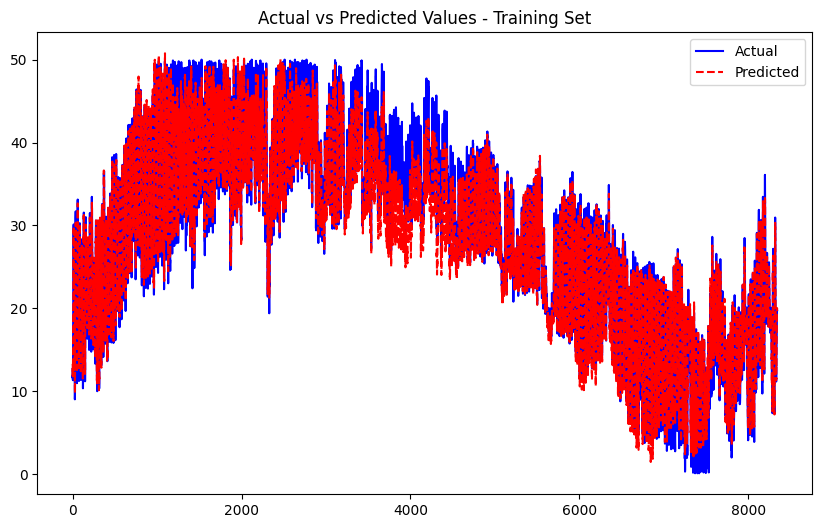

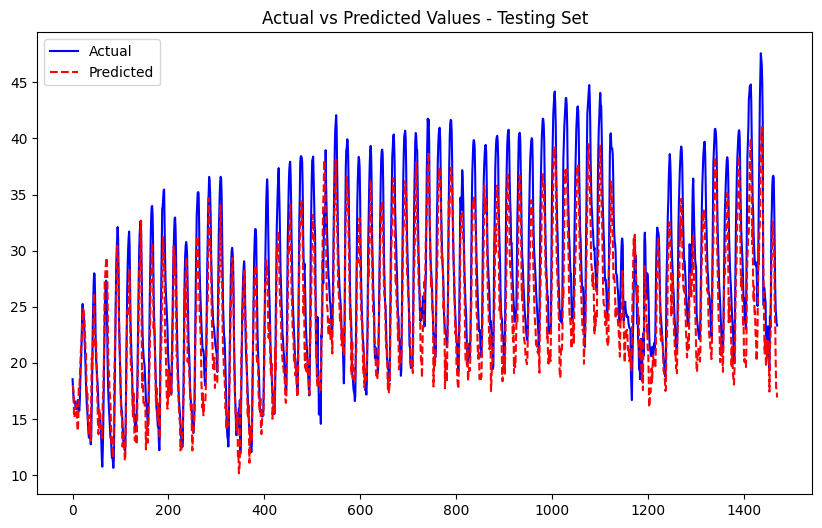

Processing node 9...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0500
Epoch [2/50], Train Loss: 0.0400
Epoch [3/50], Train Loss: 0.0366
Epoch [4/50], Train Loss: 0.0345
Epoch [5/50], Train Loss: 0.0332
Epoch [6/50], Train Loss: 0.0321
Epoch [7/50], Train Loss: 0.0313
Epoch [8/50], Train Loss: 0.0302
Epoch [9/50], Train Loss: 0.0292
Epoch [10/50], Train Loss: 0.0294
Epoch [11/50], Train Loss: 0.0283
Epoch [12/50], Train Loss: 0.0278
Epoch [13/50], Train Loss: 0.0277
Epoch [14/50], Train Loss: 0.0273
Epoch [15/50], Train Loss: 0.0265
Epoch [16/50], Train Loss: 0.0267
Epoch [17/50], Train Loss: 0.0262
Epoch [18/50], Train Loss: 0.0263
Epoch [19/50], Train Loss: 0.0258
Epoch [20/50], Train Loss: 0.0262
Epoch [21/50], Train Loss: 0.0254
Epoch [22/50], Train Loss: 0.0255
Epoch [23/50], Train Loss: 0.0258
Epoch [24/50], Train Loss: 0.0252
Epoch [25/50], Train Loss: 0.0252
Epoch [26/50], Train Loss: 0.0248
Epoch [27/50], Train Loss: 0.0248
Epoch [28/50], Train Loss: 0.0248
Epoch [29/50], Train Loss: 0.0246
Epoch [30/50], Train Lo

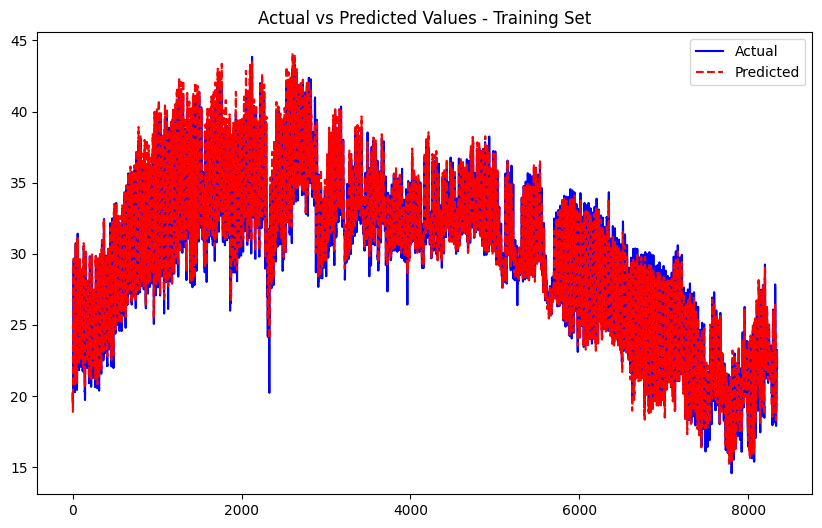

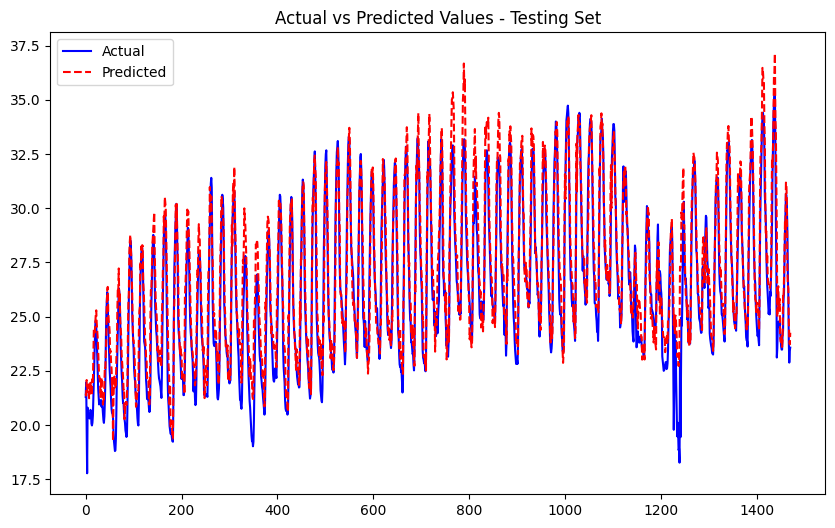

Processing node 10...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2906
Epoch [2/50], Train Loss: 0.2269
Epoch [3/50], Train Loss: 0.1897
Epoch [4/50], Train Loss: 0.1675
Epoch [5/50], Train Loss: 0.1497
Epoch [6/50], Train Loss: 0.1332
Epoch [7/50], Train Loss: 0.1260
Epoch [8/50], Train Loss: 0.1176
Epoch [9/50], Train Loss: 0.1097
Epoch [10/50], Train Loss: 0.1036
Epoch [11/50], Train Loss: 0.0991
Epoch [12/50], Train Loss: 0.0962
Epoch [13/50], Train Loss: 0.0925
Epoch [14/50], Train Loss: 0.0874
Epoch [15/50], Train Loss: 0.0860
Epoch [16/50], Train Loss: 0.0846
Epoch [17/50], Train Loss: 0.0827
Epoch [18/50], Train Loss: 0.0820
Epoch [19/50], Train Loss: 0.0793
Epoch [20/50], Train Loss: 0.0783
Epoch [21/50], Train Loss: 0.0773
Epoch [22/50], Train Loss: 0.0749
Epoch [23/50], Train Loss: 0.0746
Epoch [24/50], Train Loss: 0.0721
Epoch [25/50], Train Loss: 0.0707
Epoch [26/50], Train Loss: 0.0713
Epoch [27/50], Train Loss: 0.0695
Epoch [28/50], Train Loss: 0.0702
Epoch [29/50], Train Loss: 0.0696
Epoch [30/50], Train Lo

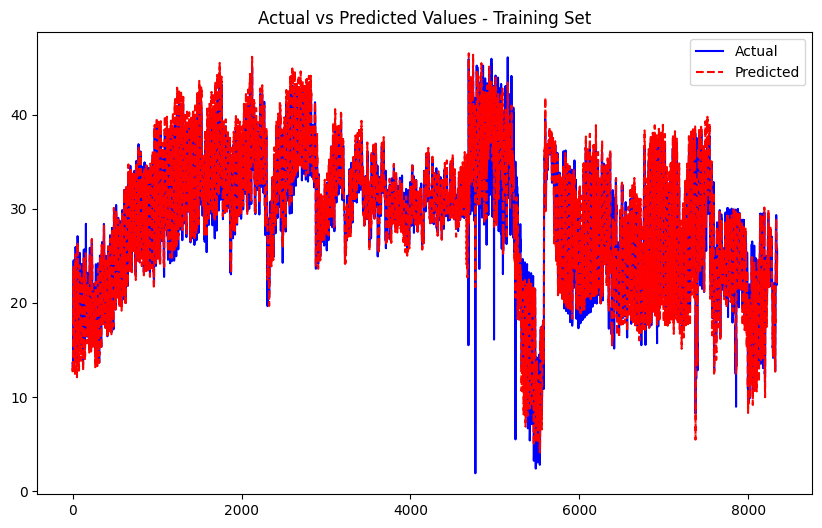

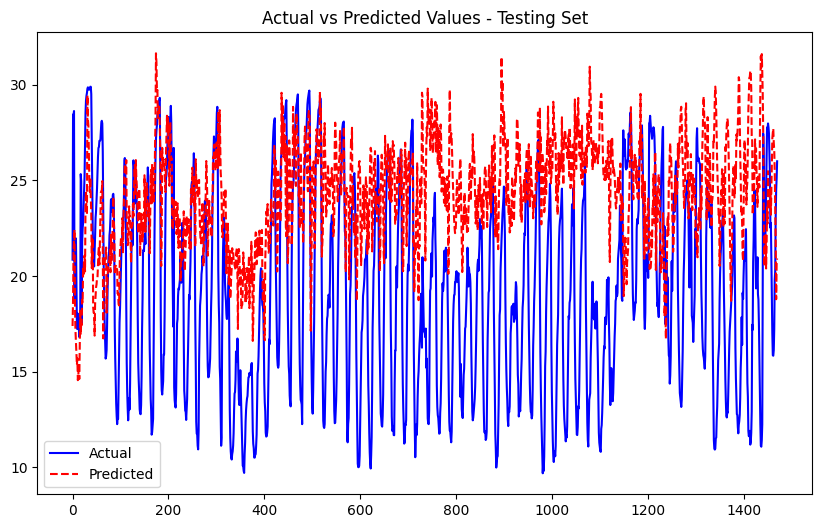

Processing node 11...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0764
Epoch [2/50], Train Loss: 0.0633
Epoch [3/50], Train Loss: 0.0540
Epoch [4/50], Train Loss: 0.0490
Epoch [5/50], Train Loss: 0.0455
Epoch [6/50], Train Loss: 0.0425
Epoch [7/50], Train Loss: 0.0409
Epoch [8/50], Train Loss: 0.0386
Epoch [9/50], Train Loss: 0.0375
Epoch [10/50], Train Loss: 0.0357
Epoch [11/50], Train Loss: 0.0350
Epoch [12/50], Train Loss: 0.0349
Epoch [13/50], Train Loss: 0.0340
Epoch [14/50], Train Loss: 0.0332
Epoch [15/50], Train Loss: 0.0332
Epoch [16/50], Train Loss: 0.0328
Epoch [17/50], Train Loss: 0.0322
Epoch [18/50], Train Loss: 0.0312
Epoch [19/50], Train Loss: 0.0313
Epoch [20/50], Train Loss: 0.0313
Epoch [21/50], Train Loss: 0.0310
Epoch [22/50], Train Loss: 0.0306
Epoch [23/50], Train Loss: 0.0307
Epoch [24/50], Train Loss: 0.0300
Epoch [25/50], Train Loss: 0.0294
Epoch [26/50], Train Loss: 0.0290
Epoch [27/50], Train Loss: 0.0293
Epoch [28/50], Train Loss: 0.0292
Epoch [29/50], Train Loss: 0.0289
Epoch [30/50], Train Lo

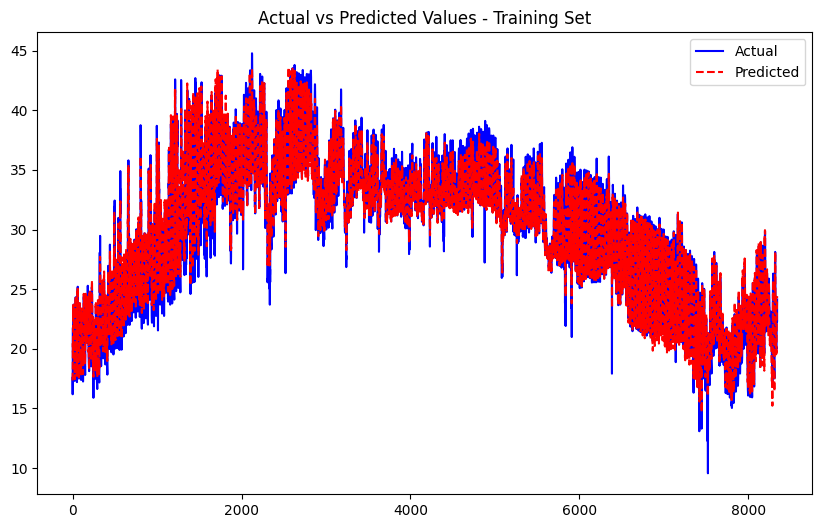

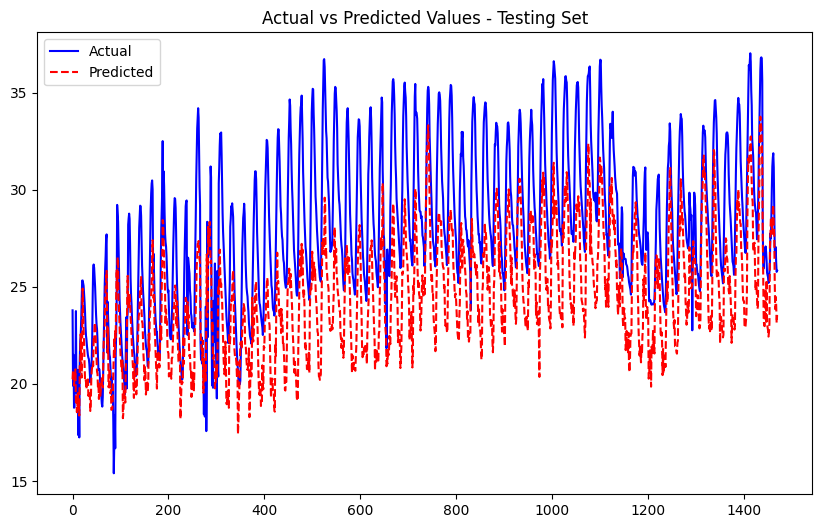

Processing node 12...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0386
Epoch [2/50], Train Loss: 0.0331
Epoch [3/50], Train Loss: 0.0298
Epoch [4/50], Train Loss: 0.0283
Epoch [5/50], Train Loss: 0.0270
Epoch [6/50], Train Loss: 0.0257
Epoch [7/50], Train Loss: 0.0256
Epoch [8/50], Train Loss: 0.0245
Epoch [9/50], Train Loss: 0.0240
Epoch [10/50], Train Loss: 0.0237
Epoch [11/50], Train Loss: 0.0226
Epoch [12/50], Train Loss: 0.0223
Epoch [13/50], Train Loss: 0.0221
Epoch [14/50], Train Loss: 0.0217
Epoch [15/50], Train Loss: 0.0214
Epoch [16/50], Train Loss: 0.0211
Epoch [17/50], Train Loss: 0.0214
Epoch [18/50], Train Loss: 0.0210
Epoch [19/50], Train Loss: 0.0211
Epoch [20/50], Train Loss: 0.0204
Epoch [21/50], Train Loss: 0.0204
Epoch [22/50], Train Loss: 0.0203
Epoch [23/50], Train Loss: 0.0204
Epoch [24/50], Train Loss: 0.0200
Epoch [25/50], Train Loss: 0.0199
Epoch [26/50], Train Loss: 0.0198
Epoch [27/50], Train Loss: 0.0193
Epoch [28/50], Train Loss: 0.0193
Epoch [29/50], Train Loss: 0.0194
Epoch [30/50], Train Lo

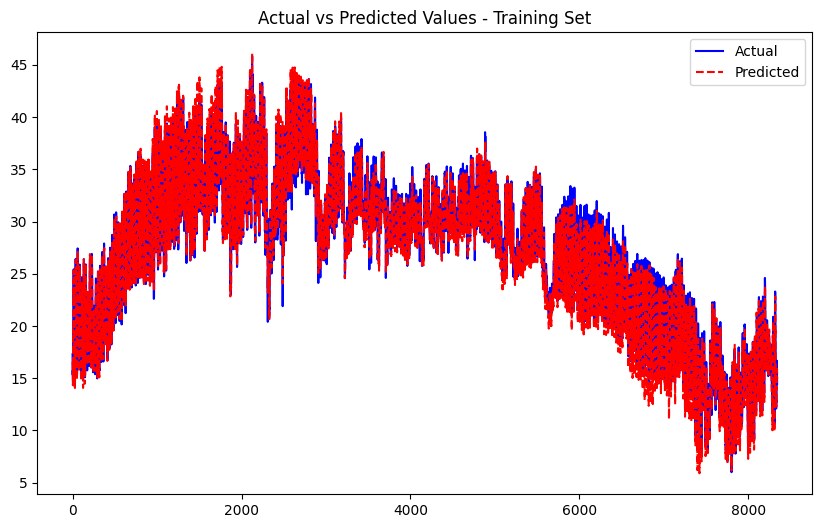

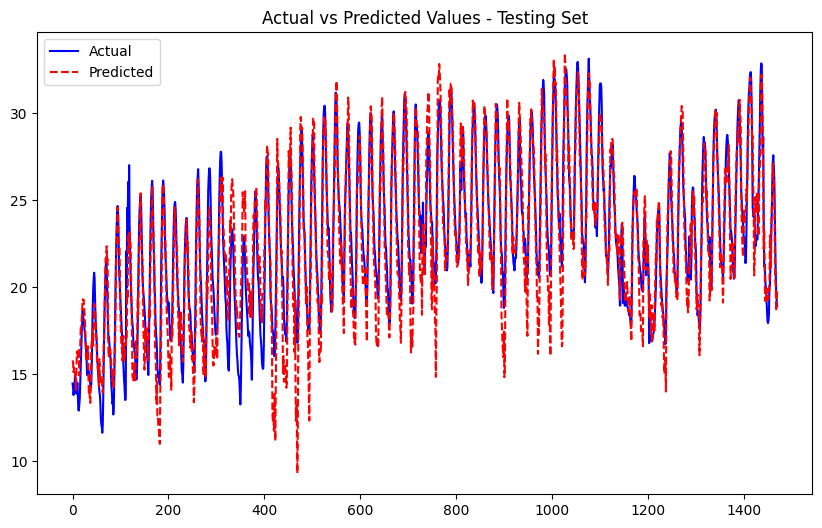

Processing node 13...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1176
Epoch [2/50], Train Loss: 0.1005
Epoch [3/50], Train Loss: 0.0843
Epoch [4/50], Train Loss: 0.0748
Epoch [5/50], Train Loss: 0.0719
Epoch [6/50], Train Loss: 0.0675
Epoch [7/50], Train Loss: 0.0608
Epoch [8/50], Train Loss: 0.0583
Epoch [9/50], Train Loss: 0.0560
Epoch [10/50], Train Loss: 0.0529
Epoch [11/50], Train Loss: 0.0485
Epoch [12/50], Train Loss: 0.0455
Epoch [13/50], Train Loss: 0.0443
Epoch [14/50], Train Loss: 0.0413
Epoch [15/50], Train Loss: 0.0401
Epoch [16/50], Train Loss: 0.0375
Epoch [17/50], Train Loss: 0.0354
Epoch [18/50], Train Loss: 0.0357
Epoch [19/50], Train Loss: 0.0337
Epoch [20/50], Train Loss: 0.0320
Epoch [21/50], Train Loss: 0.0316
Epoch [22/50], Train Loss: 0.0324
Epoch [23/50], Train Loss: 0.0298
Epoch [24/50], Train Loss: 0.0296
Epoch [25/50], Train Loss: 0.0298
Epoch [26/50], Train Loss: 0.0290
Epoch [27/50], Train Loss: 0.0280
Epoch [28/50], Train Loss: 0.0283
Epoch [29/50], Train Loss: 0.0274
Epoch [30/50], Train Lo

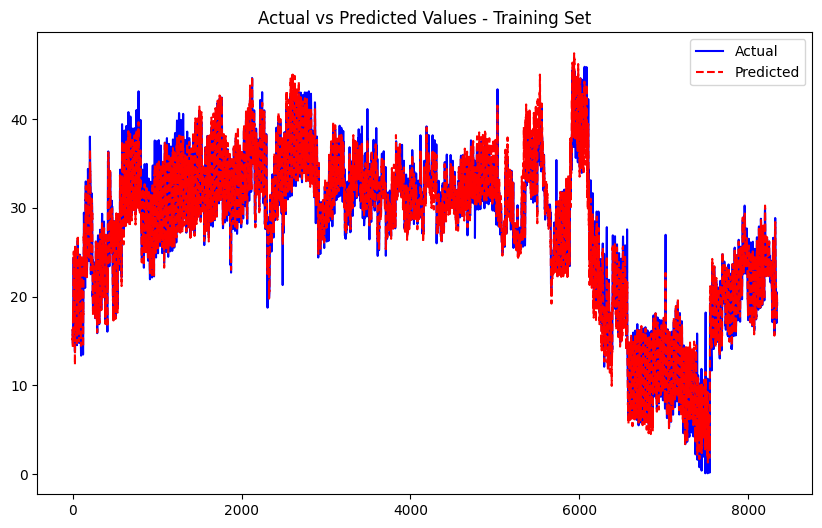

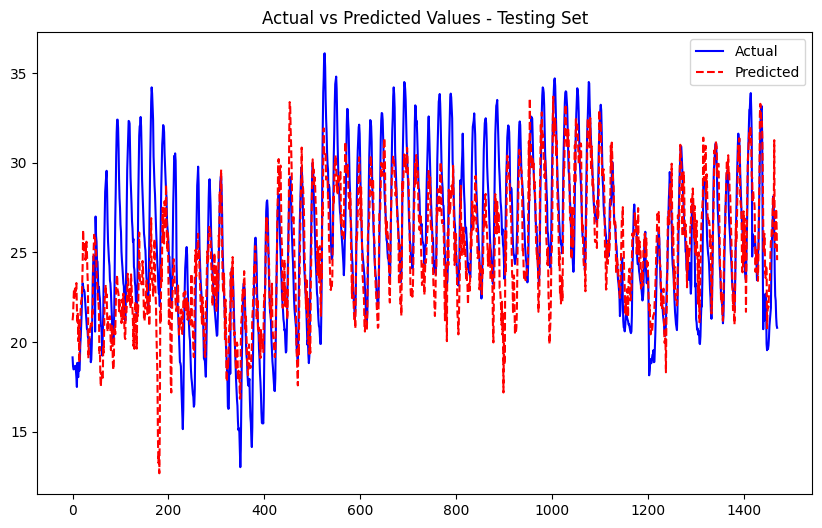

Processing node 14...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0647
Epoch [2/50], Train Loss: 0.0507
Epoch [3/50], Train Loss: 0.0444
Epoch [4/50], Train Loss: 0.0416
Epoch [5/50], Train Loss: 0.0397
Epoch [6/50], Train Loss: 0.0379
Epoch [7/50], Train Loss: 0.0367
Epoch [8/50], Train Loss: 0.0358
Epoch [9/50], Train Loss: 0.0351
Epoch [10/50], Train Loss: 0.0345
Epoch [11/50], Train Loss: 0.0337
Epoch [12/50], Train Loss: 0.0333
Epoch [13/50], Train Loss: 0.0323
Epoch [14/50], Train Loss: 0.0320
Epoch [15/50], Train Loss: 0.0321
Epoch [16/50], Train Loss: 0.0317
Epoch [17/50], Train Loss: 0.0313
Epoch [18/50], Train Loss: 0.0311
Epoch [19/50], Train Loss: 0.0307
Epoch [20/50], Train Loss: 0.0303
Epoch [21/50], Train Loss: 0.0304
Epoch [22/50], Train Loss: 0.0295
Epoch [23/50], Train Loss: 0.0301
Epoch [24/50], Train Loss: 0.0299
Epoch [25/50], Train Loss: 0.0301
Epoch [26/50], Train Loss: 0.0293
Epoch [27/50], Train Loss: 0.0292
Epoch [28/50], Train Loss: 0.0295
Epoch [29/50], Train Loss: 0.0293
Epoch [30/50], Train Lo

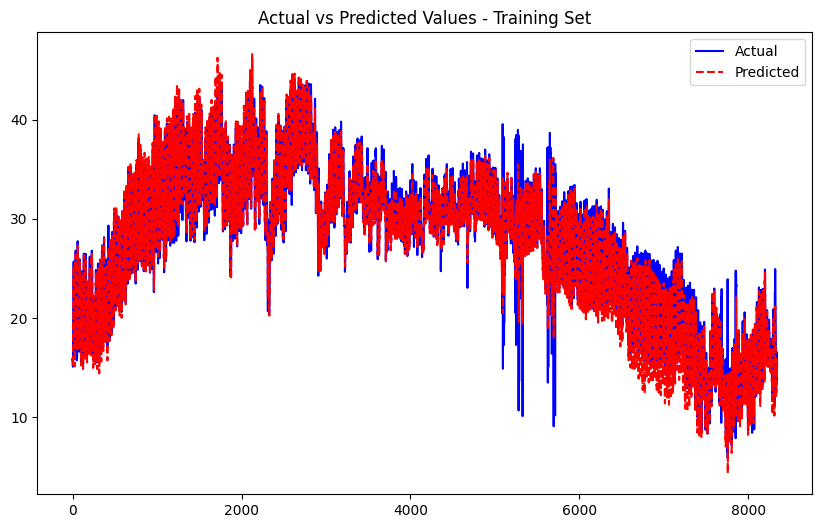

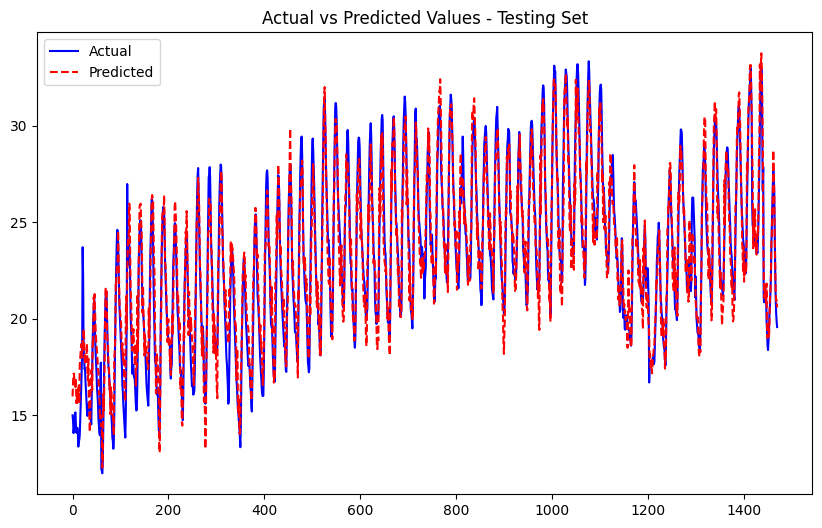

Processing node 15...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0656
Epoch [2/50], Train Loss: 0.0592
Epoch [3/50], Train Loss: 0.0562
Epoch [4/50], Train Loss: 0.0529
Epoch [5/50], Train Loss: 0.0509
Epoch [6/50], Train Loss: 0.0491
Epoch [7/50], Train Loss: 0.0480
Epoch [8/50], Train Loss: 0.0464
Epoch [9/50], Train Loss: 0.0449
Epoch [10/50], Train Loss: 0.0442
Epoch [11/50], Train Loss: 0.0437
Epoch [12/50], Train Loss: 0.0432
Epoch [13/50], Train Loss: 0.0427
Epoch [14/50], Train Loss: 0.0418
Epoch [15/50], Train Loss: 0.0419
Epoch [16/50], Train Loss: 0.0417
Epoch [17/50], Train Loss: 0.0409
Epoch [18/50], Train Loss: 0.0410
Epoch [19/50], Train Loss: 0.0408
Epoch [20/50], Train Loss: 0.0403
Epoch [21/50], Train Loss: 0.0398
Epoch [22/50], Train Loss: 0.0396
Epoch [23/50], Train Loss: 0.0398
Epoch [24/50], Train Loss: 0.0398
Epoch [25/50], Train Loss: 0.0392
Epoch [26/50], Train Loss: 0.0397
Epoch [27/50], Train Loss: 0.0390
Epoch [28/50], Train Loss: 0.0393
Epoch [29/50], Train Loss: 0.0389
Epoch [30/50], Train Lo

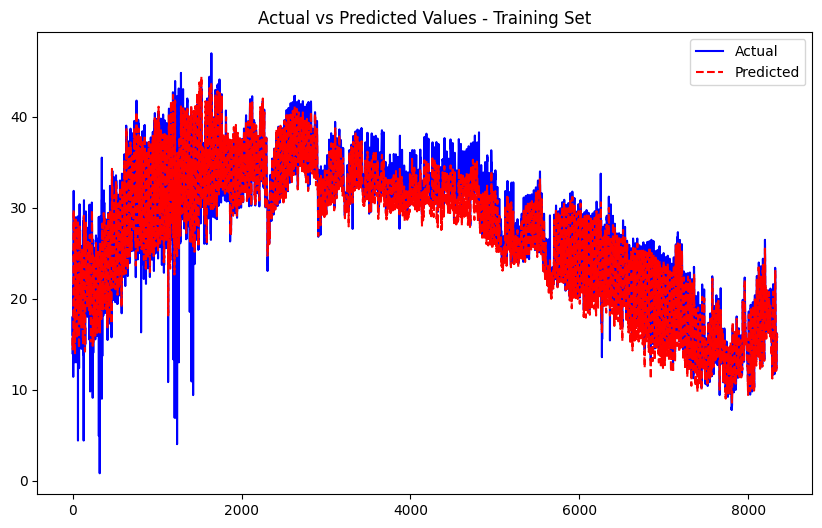

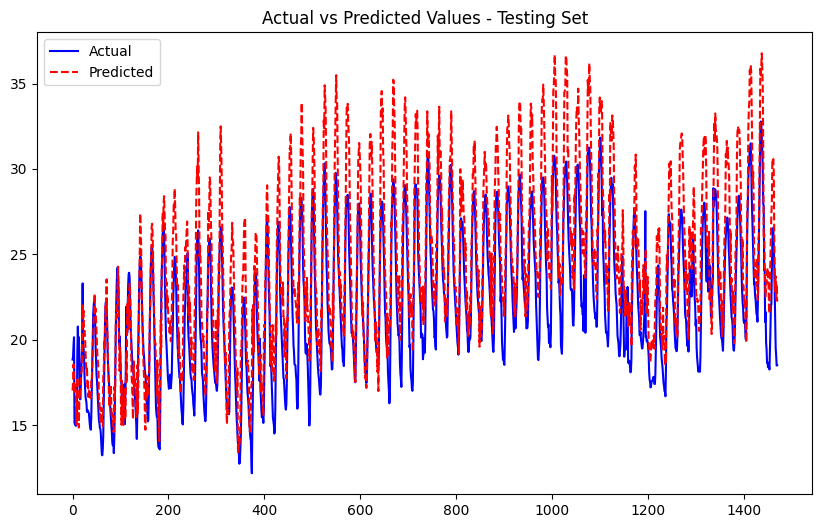

Processing node 16...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1125
Epoch [2/50], Train Loss: 0.1043
Epoch [3/50], Train Loss: 0.0957
Epoch [4/50], Train Loss: 0.0917
Epoch [5/50], Train Loss: 0.0874
Epoch [6/50], Train Loss: 0.0804
Epoch [7/50], Train Loss: 0.0758
Epoch [8/50], Train Loss: 0.0737
Epoch [9/50], Train Loss: 0.0654
Epoch [10/50], Train Loss: 0.0654
Epoch [11/50], Train Loss: 0.0611
Epoch [12/50], Train Loss: 0.0576
Epoch [13/50], Train Loss: 0.0586
Epoch [14/50], Train Loss: 0.0576
Epoch [15/50], Train Loss: 0.0564
Epoch [16/50], Train Loss: 0.0555
Epoch [17/50], Train Loss: 0.0532
Epoch [18/50], Train Loss: 0.0496
Epoch [19/50], Train Loss: 0.0514
Epoch [20/50], Train Loss: 0.0495
Epoch [21/50], Train Loss: 0.0458
Epoch [22/50], Train Loss: 0.0450
Epoch [23/50], Train Loss: 0.0475
Epoch [24/50], Train Loss: 0.0422
Epoch [25/50], Train Loss: 0.0428
Epoch [26/50], Train Loss: 0.0419
Epoch [27/50], Train Loss: 0.0412
Epoch [28/50], Train Loss: 0.0406
Epoch [29/50], Train Loss: 0.0395
Epoch [30/50], Train Lo

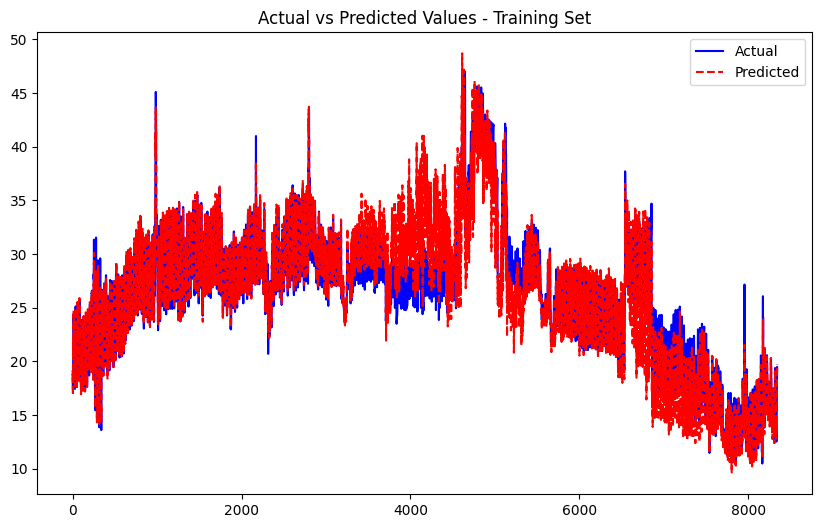

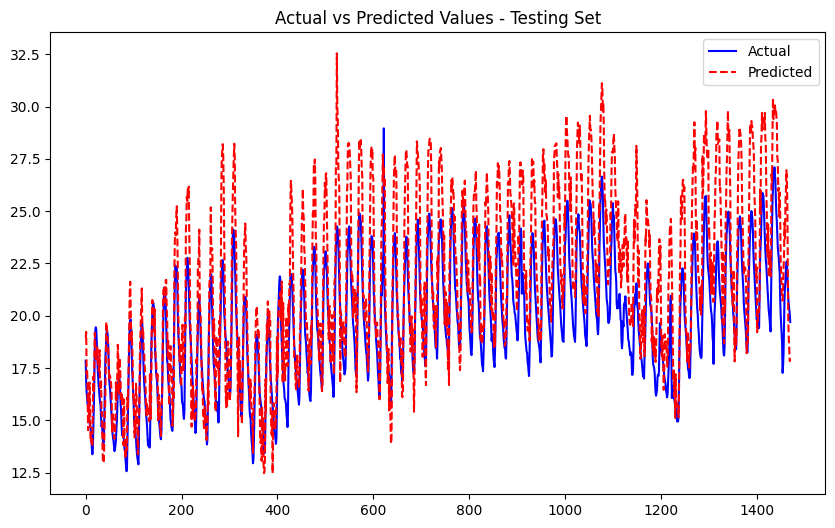

Processing node 17...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0594
Epoch [2/50], Train Loss: 0.0449
Epoch [3/50], Train Loss: 0.0397
Epoch [4/50], Train Loss: 0.0378
Epoch [5/50], Train Loss: 0.0353
Epoch [6/50], Train Loss: 0.0336
Epoch [7/50], Train Loss: 0.0320
Epoch [8/50], Train Loss: 0.0312
Epoch [9/50], Train Loss: 0.0305
Epoch [10/50], Train Loss: 0.0298
Epoch [11/50], Train Loss: 0.0286
Epoch [12/50], Train Loss: 0.0286
Epoch [13/50], Train Loss: 0.0278
Epoch [14/50], Train Loss: 0.0277
Epoch [15/50], Train Loss: 0.0273
Epoch [16/50], Train Loss: 0.0271
Epoch [17/50], Train Loss: 0.0264
Epoch [18/50], Train Loss: 0.0262
Epoch [19/50], Train Loss: 0.0257
Epoch [20/50], Train Loss: 0.0259
Epoch [21/50], Train Loss: 0.0255
Epoch [22/50], Train Loss: 0.0252
Epoch [23/50], Train Loss: 0.0249
Epoch [24/50], Train Loss: 0.0247
Epoch [25/50], Train Loss: 0.0255
Epoch [26/50], Train Loss: 0.0248
Epoch [27/50], Train Loss: 0.0242
Epoch [28/50], Train Loss: 0.0244
Epoch [29/50], Train Loss: 0.0244
Epoch [30/50], Train Lo

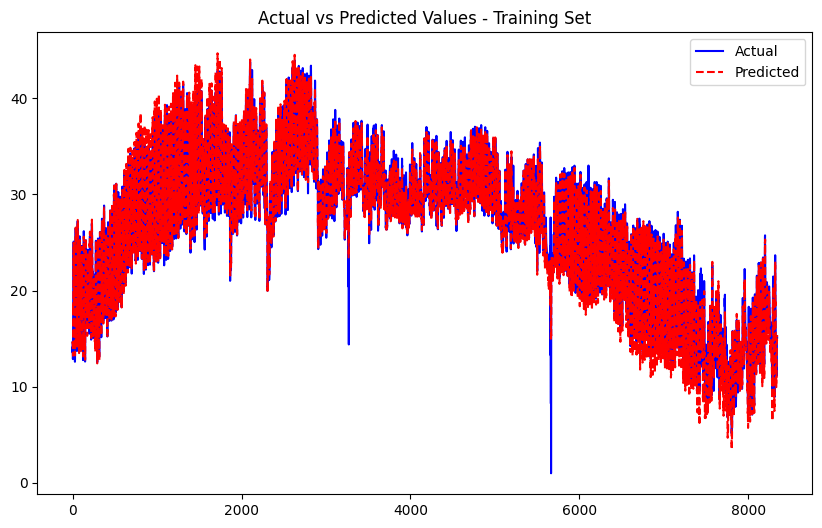

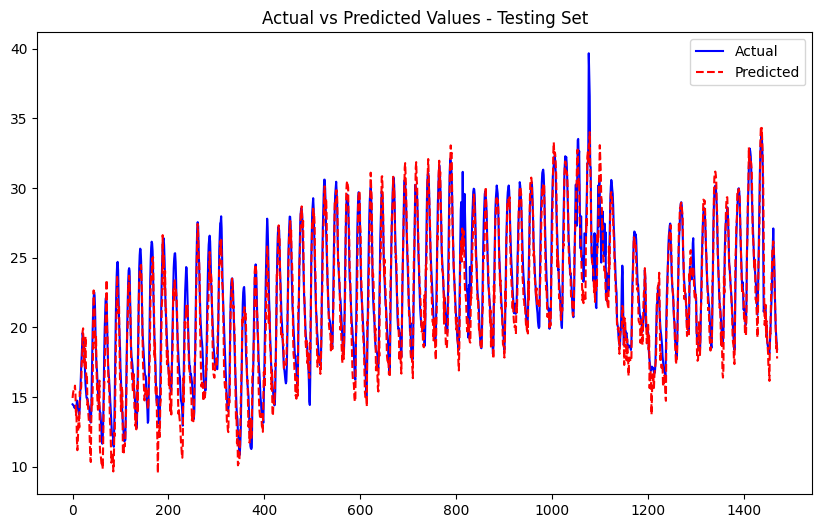

Processing node 18...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0398
Epoch [2/50], Train Loss: 0.0341
Epoch [3/50], Train Loss: 0.0311
Epoch [4/50], Train Loss: 0.0297
Epoch [5/50], Train Loss: 0.0283
Epoch [6/50], Train Loss: 0.0269
Epoch [7/50], Train Loss: 0.0266
Epoch [8/50], Train Loss: 0.0260
Epoch [9/50], Train Loss: 0.0254
Epoch [10/50], Train Loss: 0.0241
Epoch [11/50], Train Loss: 0.0245
Epoch [12/50], Train Loss: 0.0239
Epoch [13/50], Train Loss: 0.0236
Epoch [14/50], Train Loss: 0.0235
Epoch [15/50], Train Loss: 0.0230
Epoch [16/50], Train Loss: 0.0226
Epoch [17/50], Train Loss: 0.0229
Epoch [18/50], Train Loss: 0.0224
Epoch [19/50], Train Loss: 0.0224
Epoch [20/50], Train Loss: 0.0226
Epoch [21/50], Train Loss: 0.0219
Epoch [22/50], Train Loss: 0.0216
Epoch [23/50], Train Loss: 0.0218
Epoch [24/50], Train Loss: 0.0219
Epoch [25/50], Train Loss: 0.0216
Epoch [26/50], Train Loss: 0.0217
Epoch [27/50], Train Loss: 0.0213
Epoch [28/50], Train Loss: 0.0218
Epoch [29/50], Train Loss: 0.0217
Epoch [30/50], Train Lo

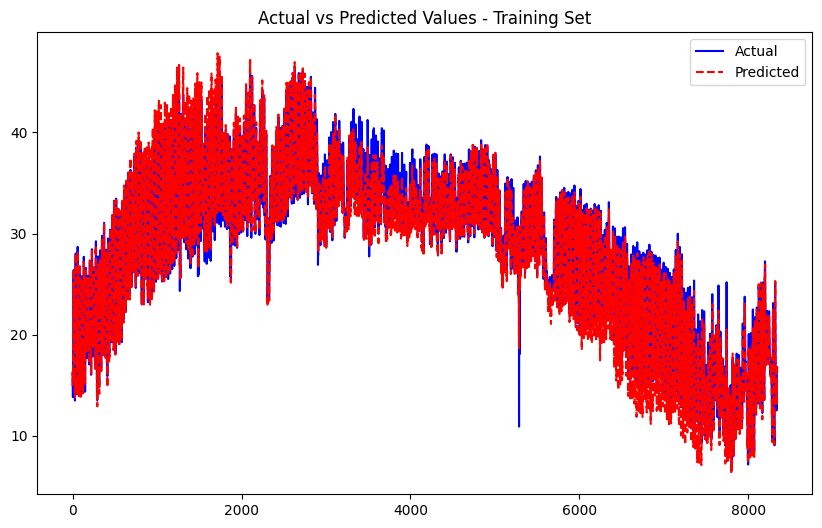

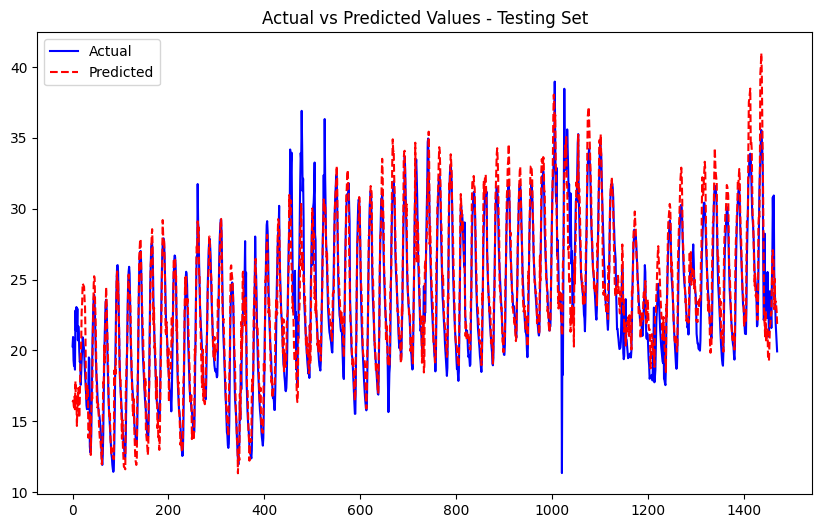

Processing node 19...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0665
Epoch [2/50], Train Loss: 0.0555
Epoch [3/50], Train Loss: 0.0515
Epoch [4/50], Train Loss: 0.0480
Epoch [5/50], Train Loss: 0.0468
Epoch [6/50], Train Loss: 0.0452
Epoch [7/50], Train Loss: 0.0439
Epoch [8/50], Train Loss: 0.0432
Epoch [9/50], Train Loss: 0.0426
Epoch [10/50], Train Loss: 0.0415
Epoch [11/50], Train Loss: 0.0410
Epoch [12/50], Train Loss: 0.0403
Epoch [13/50], Train Loss: 0.0404
Epoch [14/50], Train Loss: 0.0393
Epoch [15/50], Train Loss: 0.0393
Epoch [16/50], Train Loss: 0.0388
Epoch [17/50], Train Loss: 0.0386
Epoch [18/50], Train Loss: 0.0383
Epoch [19/50], Train Loss: 0.0378
Epoch [20/50], Train Loss: 0.0377
Epoch [21/50], Train Loss: 0.0373
Epoch [22/50], Train Loss: 0.0378
Epoch [23/50], Train Loss: 0.0370
Epoch [24/50], Train Loss: 0.0370
Epoch [25/50], Train Loss: 0.0372
Epoch [26/50], Train Loss: 0.0370
Epoch [27/50], Train Loss: 0.0364
Epoch [28/50], Train Loss: 0.0363
Epoch [29/50], Train Loss: 0.0364
Epoch [30/50], Train Lo

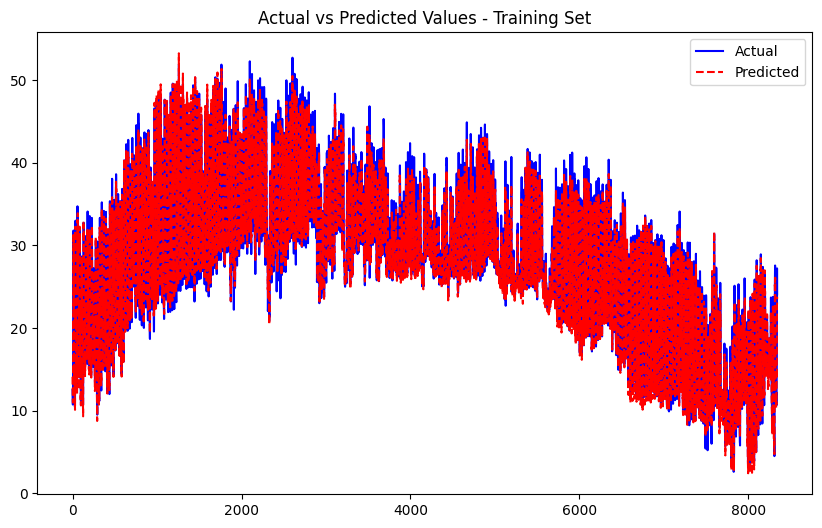

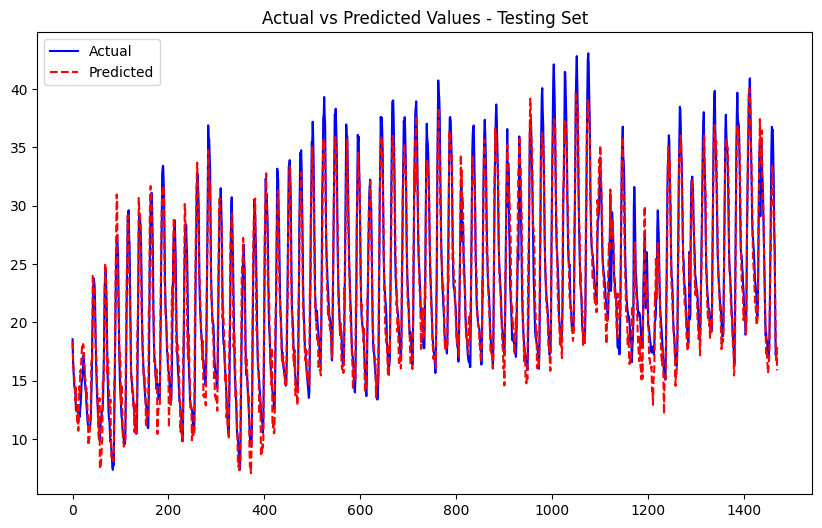

Processing node 20...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0493
Epoch [2/50], Train Loss: 0.0432
Epoch [3/50], Train Loss: 0.0406
Epoch [4/50], Train Loss: 0.0382
Epoch [5/50], Train Loss: 0.0374
Epoch [6/50], Train Loss: 0.0362
Epoch [7/50], Train Loss: 0.0356
Epoch [8/50], Train Loss: 0.0346
Epoch [9/50], Train Loss: 0.0338
Epoch [10/50], Train Loss: 0.0333
Epoch [11/50], Train Loss: 0.0327
Epoch [12/50], Train Loss: 0.0323
Epoch [13/50], Train Loss: 0.0319
Epoch [14/50], Train Loss: 0.0313
Epoch [15/50], Train Loss: 0.0312
Epoch [16/50], Train Loss: 0.0308
Epoch [17/50], Train Loss: 0.0306
Epoch [18/50], Train Loss: 0.0303
Epoch [19/50], Train Loss: 0.0301
Epoch [20/50], Train Loss: 0.0292
Epoch [21/50], Train Loss: 0.0299
Epoch [22/50], Train Loss: 0.0297
Epoch [23/50], Train Loss: 0.0295
Epoch [24/50], Train Loss: 0.0293
Epoch [25/50], Train Loss: 0.0294
Epoch [26/50], Train Loss: 0.0288
Epoch [27/50], Train Loss: 0.0285
Epoch [28/50], Train Loss: 0.0286
Epoch [29/50], Train Loss: 0.0288
Epoch [30/50], Train Lo

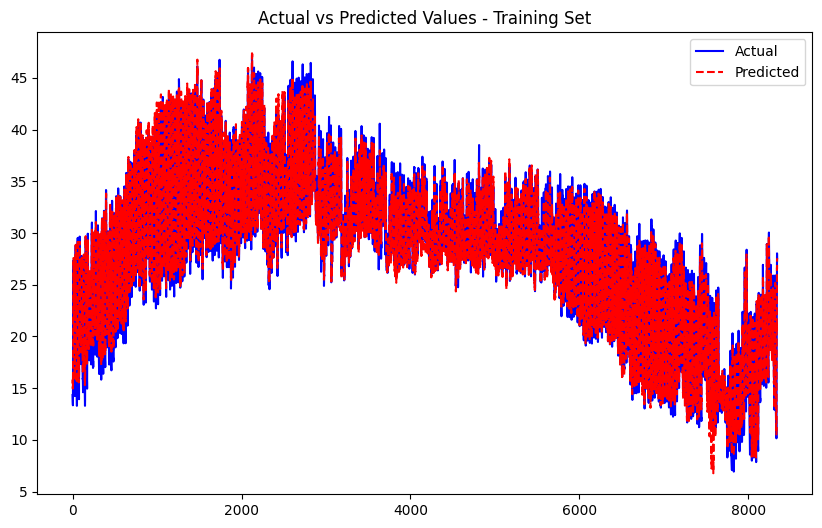

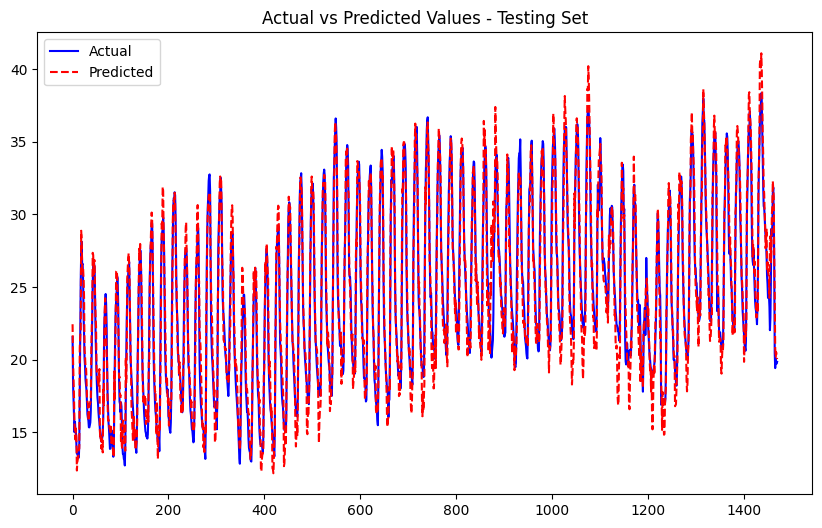

Processing node 21...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0454
Epoch [2/50], Train Loss: 0.0400
Epoch [3/50], Train Loss: 0.0376
Epoch [4/50], Train Loss: 0.0361
Epoch [5/50], Train Loss: 0.0352
Epoch [6/50], Train Loss: 0.0342
Epoch [7/50], Train Loss: 0.0334
Epoch [8/50], Train Loss: 0.0326
Epoch [9/50], Train Loss: 0.0323
Epoch [10/50], Train Loss: 0.0316
Epoch [11/50], Train Loss: 0.0318
Epoch [12/50], Train Loss: 0.0314
Epoch [13/50], Train Loss: 0.0308
Epoch [14/50], Train Loss: 0.0306
Epoch [15/50], Train Loss: 0.0307
Epoch [16/50], Train Loss: 0.0302
Epoch [17/50], Train Loss: 0.0302
Epoch [18/50], Train Loss: 0.0297
Epoch [19/50], Train Loss: 0.0292
Epoch [20/50], Train Loss: 0.0300
Epoch [21/50], Train Loss: 0.0292
Epoch [22/50], Train Loss: 0.0291
Epoch [23/50], Train Loss: 0.0292
Epoch [24/50], Train Loss: 0.0286
Epoch [25/50], Train Loss: 0.0289
Epoch [26/50], Train Loss: 0.0289
Epoch [27/50], Train Loss: 0.0285
Epoch [28/50], Train Loss: 0.0282
Epoch [29/50], Train Loss: 0.0285
Epoch [30/50], Train Lo

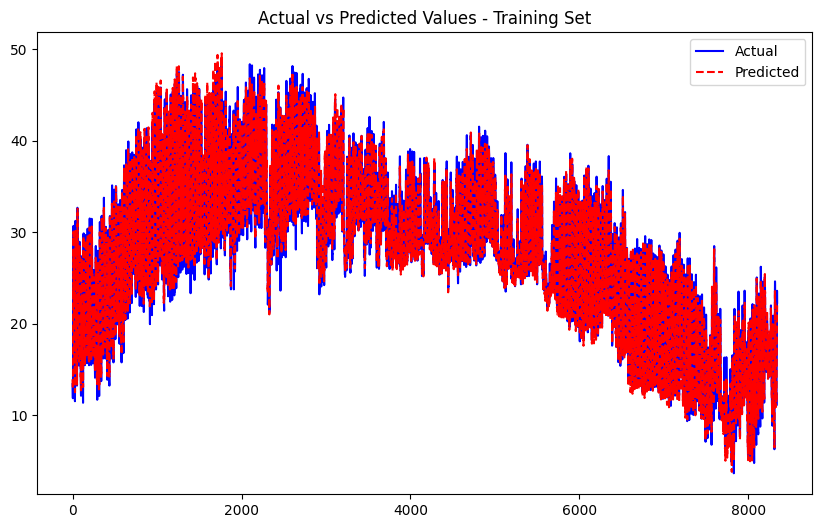

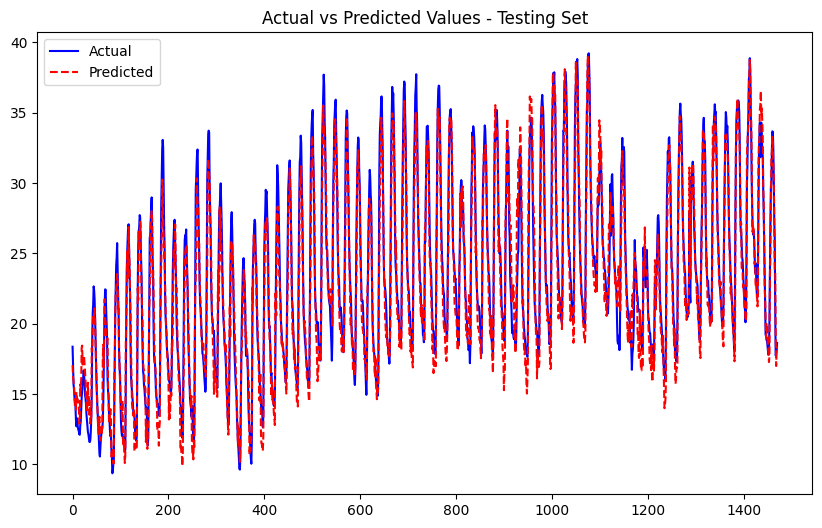

Processing node 22...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0561
Epoch [2/50], Train Loss: 0.0503
Epoch [3/50], Train Loss: 0.0471
Epoch [4/50], Train Loss: 0.0445
Epoch [5/50], Train Loss: 0.0432
Epoch [6/50], Train Loss: 0.0421
Epoch [7/50], Train Loss: 0.0410
Epoch [8/50], Train Loss: 0.0400
Epoch [9/50], Train Loss: 0.0393
Epoch [10/50], Train Loss: 0.0388
Epoch [11/50], Train Loss: 0.0385
Epoch [12/50], Train Loss: 0.0379
Epoch [13/50], Train Loss: 0.0374
Epoch [14/50], Train Loss: 0.0370
Epoch [15/50], Train Loss: 0.0366
Epoch [16/50], Train Loss: 0.0363
Epoch [17/50], Train Loss: 0.0361
Epoch [18/50], Train Loss: 0.0357
Epoch [19/50], Train Loss: 0.0359
Epoch [20/50], Train Loss: 0.0354
Epoch [21/50], Train Loss: 0.0354
Epoch [22/50], Train Loss: 0.0351
Epoch [23/50], Train Loss: 0.0351
Epoch [24/50], Train Loss: 0.0350
Epoch [25/50], Train Loss: 0.0354
Epoch [26/50], Train Loss: 0.0348
Epoch [27/50], Train Loss: 0.0346
Epoch [28/50], Train Loss: 0.0346
Epoch [29/50], Train Loss: 0.0343
Epoch [30/50], Train Lo

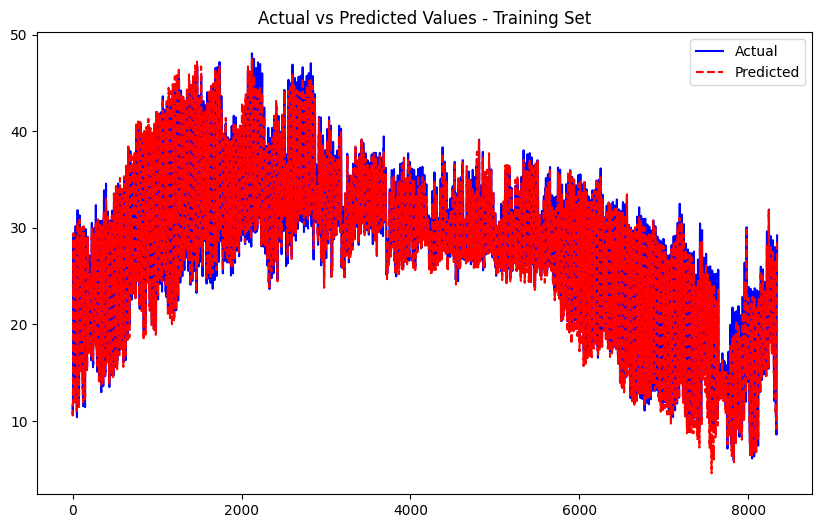

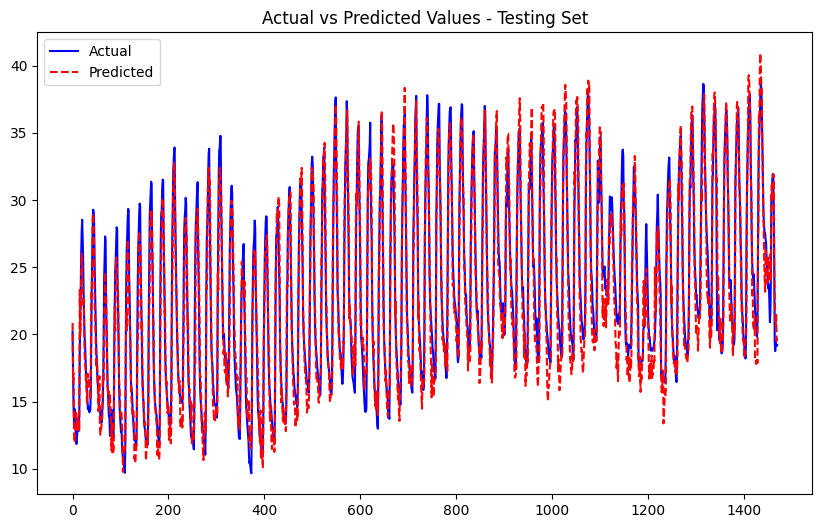

Processing node 23...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0597
Epoch [2/50], Train Loss: 0.0515
Epoch [3/50], Train Loss: 0.0479
Epoch [4/50], Train Loss: 0.0456
Epoch [5/50], Train Loss: 0.0437
Epoch [6/50], Train Loss: 0.0422
Epoch [7/50], Train Loss: 0.0410
Epoch [8/50], Train Loss: 0.0401
Epoch [9/50], Train Loss: 0.0388
Epoch [10/50], Train Loss: 0.0381
Epoch [11/50], Train Loss: 0.0377
Epoch [12/50], Train Loss: 0.0374
Epoch [13/50], Train Loss: 0.0364
Epoch [14/50], Train Loss: 0.0356
Epoch [15/50], Train Loss: 0.0357
Epoch [16/50], Train Loss: 0.0353
Epoch [17/50], Train Loss: 0.0347
Epoch [18/50], Train Loss: 0.0344
Epoch [19/50], Train Loss: 0.0344
Epoch [20/50], Train Loss: 0.0340
Epoch [21/50], Train Loss: 0.0337
Epoch [22/50], Train Loss: 0.0332
Epoch [23/50], Train Loss: 0.0329
Epoch [24/50], Train Loss: 0.0329
Epoch [25/50], Train Loss: 0.0327
Epoch [26/50], Train Loss: 0.0326
Epoch [27/50], Train Loss: 0.0321
Epoch [28/50], Train Loss: 0.0324
Epoch [29/50], Train Loss: 0.0323
Epoch [30/50], Train Lo

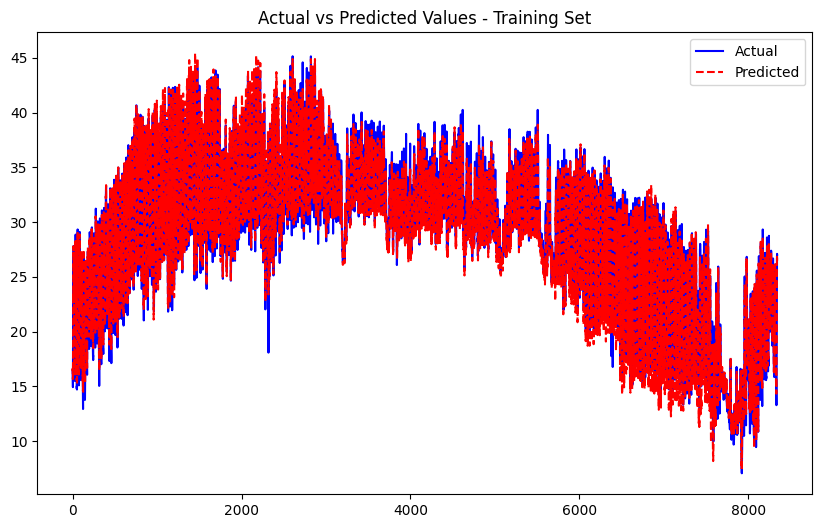

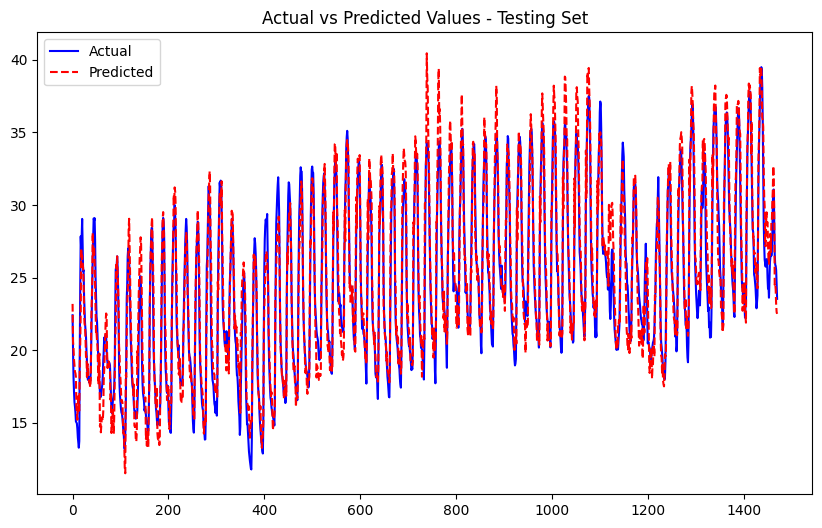

Processing node 24...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0452
Epoch [2/50], Train Loss: 0.0384
Epoch [3/50], Train Loss: 0.0362
Epoch [4/50], Train Loss: 0.0350
Epoch [5/50], Train Loss: 0.0333
Epoch [6/50], Train Loss: 0.0320
Epoch [7/50], Train Loss: 0.0314
Epoch [8/50], Train Loss: 0.0307
Epoch [9/50], Train Loss: 0.0301
Epoch [10/50], Train Loss: 0.0297
Epoch [11/50], Train Loss: 0.0296
Epoch [12/50], Train Loss: 0.0287
Epoch [13/50], Train Loss: 0.0286
Epoch [14/50], Train Loss: 0.0282
Epoch [15/50], Train Loss: 0.0280
Epoch [16/50], Train Loss: 0.0280
Epoch [17/50], Train Loss: 0.0273
Epoch [18/50], Train Loss: 0.0274
Epoch [19/50], Train Loss: 0.0271
Epoch [20/50], Train Loss: 0.0268
Epoch [21/50], Train Loss: 0.0268
Epoch [22/50], Train Loss: 0.0267
Epoch [23/50], Train Loss: 0.0263
Epoch [24/50], Train Loss: 0.0262
Epoch [25/50], Train Loss: 0.0260
Epoch [26/50], Train Loss: 0.0260
Epoch [27/50], Train Loss: 0.0260
Epoch [28/50], Train Loss: 0.0259
Epoch [29/50], Train Loss: 0.0257
Epoch [30/50], Train Lo

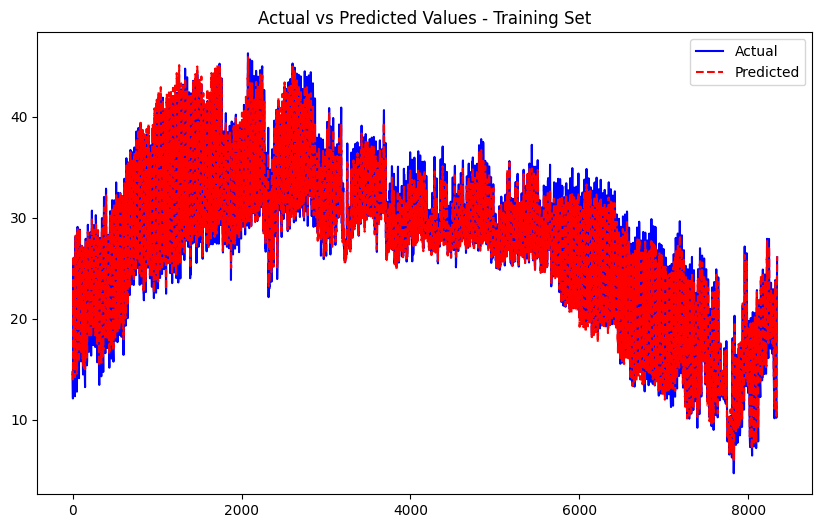

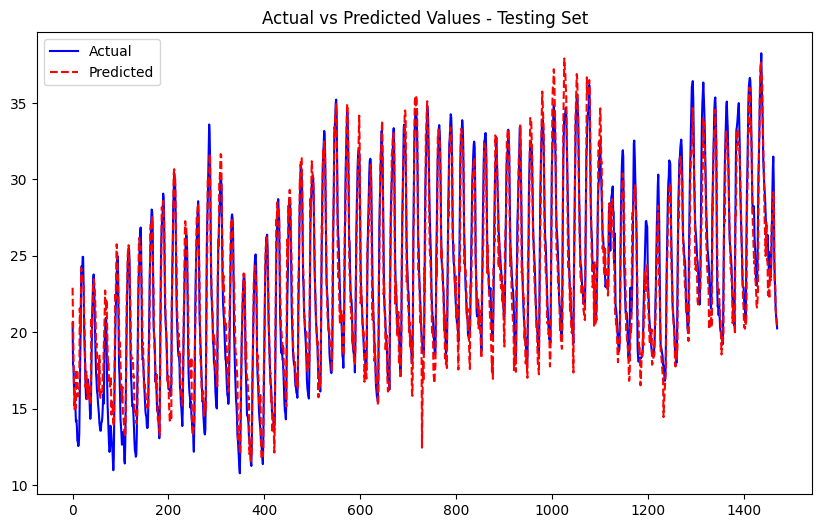

Processing node 25...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0428
Epoch [2/50], Train Loss: 0.0398
Epoch [3/50], Train Loss: 0.0362
Epoch [4/50], Train Loss: 0.0341
Epoch [5/50], Train Loss: 0.0330
Epoch [6/50], Train Loss: 0.0317
Epoch [7/50], Train Loss: 0.0310
Epoch [8/50], Train Loss: 0.0301
Epoch [9/50], Train Loss: 0.0295
Epoch [10/50], Train Loss: 0.0288
Epoch [11/50], Train Loss: 0.0286
Epoch [12/50], Train Loss: 0.0282
Epoch [13/50], Train Loss: 0.0275
Epoch [14/50], Train Loss: 0.0273
Epoch [15/50], Train Loss: 0.0268
Epoch [16/50], Train Loss: 0.0264
Epoch [17/50], Train Loss: 0.0265
Epoch [18/50], Train Loss: 0.0263
Epoch [19/50], Train Loss: 0.0259
Epoch [20/50], Train Loss: 0.0260
Epoch [21/50], Train Loss: 0.0256
Epoch [22/50], Train Loss: 0.0255
Epoch [23/50], Train Loss: 0.0253
Epoch [24/50], Train Loss: 0.0255
Epoch [25/50], Train Loss: 0.0255
Epoch [26/50], Train Loss: 0.0252
Epoch [27/50], Train Loss: 0.0248
Epoch [28/50], Train Loss: 0.0249
Epoch [29/50], Train Loss: 0.0247
Epoch [30/50], Train Lo

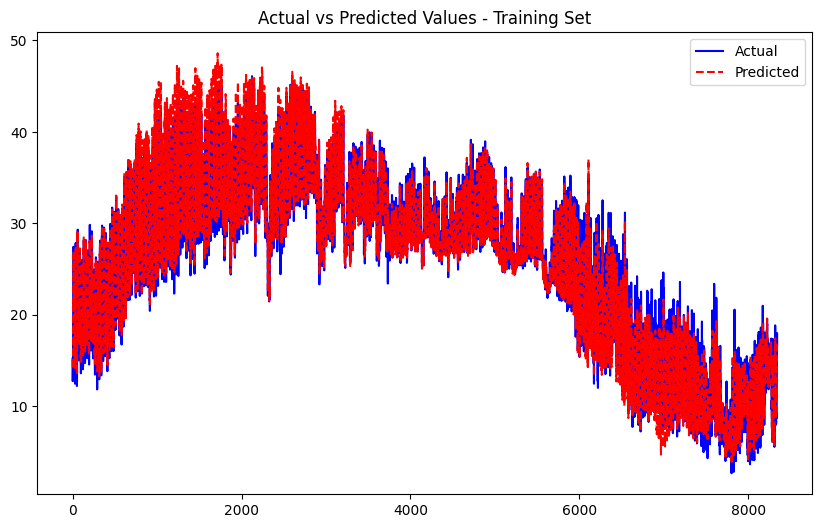

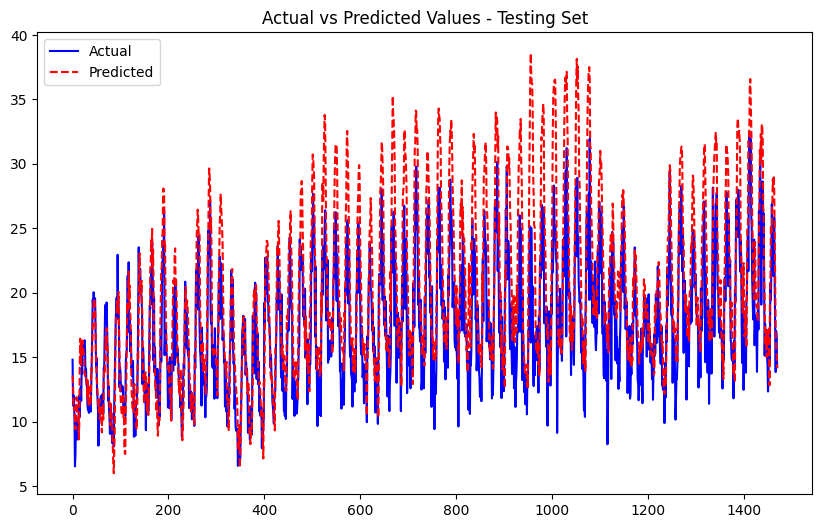

Processing node 26...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0498
Epoch [2/50], Train Loss: 0.0417
Epoch [3/50], Train Loss: 0.0380
Epoch [4/50], Train Loss: 0.0358
Epoch [5/50], Train Loss: 0.0350
Epoch [6/50], Train Loss: 0.0335
Epoch [7/50], Train Loss: 0.0326
Epoch [8/50], Train Loss: 0.0322
Epoch [9/50], Train Loss: 0.0313
Epoch [10/50], Train Loss: 0.0309
Epoch [11/50], Train Loss: 0.0304
Epoch [12/50], Train Loss: 0.0298
Epoch [13/50], Train Loss: 0.0297
Epoch [14/50], Train Loss: 0.0292
Epoch [15/50], Train Loss: 0.0291
Epoch [16/50], Train Loss: 0.0288
Epoch [17/50], Train Loss: 0.0288
Epoch [18/50], Train Loss: 0.0283
Epoch [19/50], Train Loss: 0.0284
Epoch [20/50], Train Loss: 0.0281
Epoch [21/50], Train Loss: 0.0281
Epoch [22/50], Train Loss: 0.0278
Epoch [23/50], Train Loss: 0.0278
Epoch [24/50], Train Loss: 0.0276
Epoch [25/50], Train Loss: 0.0275
Epoch [26/50], Train Loss: 0.0277
Epoch [27/50], Train Loss: 0.0274
Epoch [28/50], Train Loss: 0.0277
Epoch [29/50], Train Loss: 0.0273
Epoch [30/50], Train Lo

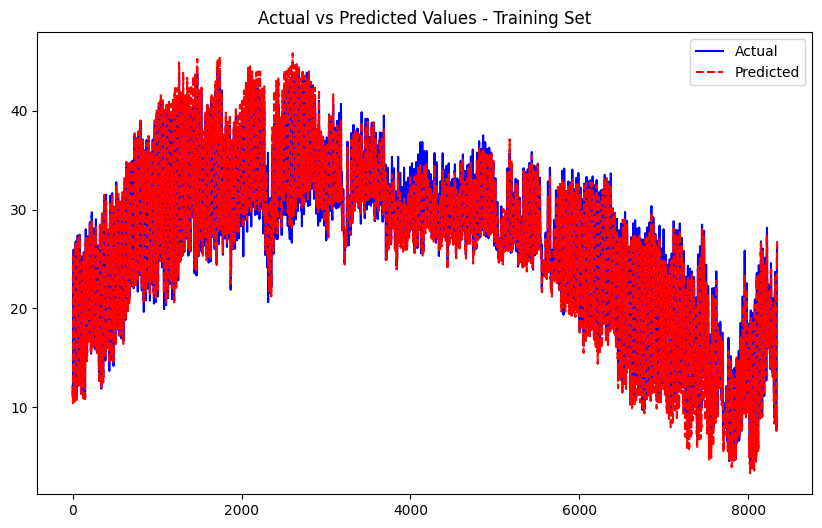

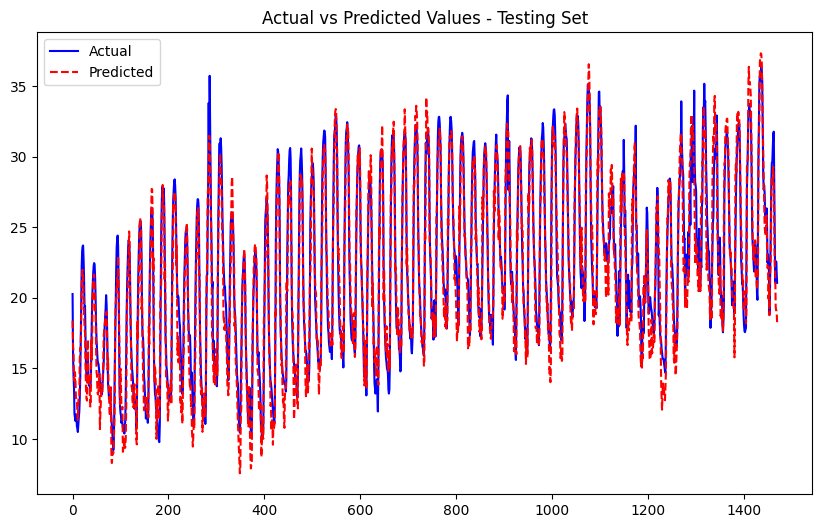

Processing node 27...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0464
Epoch [2/50], Train Loss: 0.0408
Epoch [3/50], Train Loss: 0.0389
Epoch [4/50], Train Loss: 0.0375
Epoch [5/50], Train Loss: 0.0360
Epoch [6/50], Train Loss: 0.0349
Epoch [7/50], Train Loss: 0.0339
Epoch [8/50], Train Loss: 0.0340
Epoch [9/50], Train Loss: 0.0331
Epoch [10/50], Train Loss: 0.0328
Epoch [11/50], Train Loss: 0.0323
Epoch [12/50], Train Loss: 0.0317
Epoch [13/50], Train Loss: 0.0318
Epoch [14/50], Train Loss: 0.0314
Epoch [15/50], Train Loss: 0.0316
Epoch [16/50], Train Loss: 0.0308
Epoch [17/50], Train Loss: 0.0309
Epoch [18/50], Train Loss: 0.0303
Epoch [19/50], Train Loss: 0.0300
Epoch [20/50], Train Loss: 0.0297
Epoch [21/50], Train Loss: 0.0298
Epoch [22/50], Train Loss: 0.0299
Epoch [23/50], Train Loss: 0.0296
Epoch [24/50], Train Loss: 0.0297
Epoch [25/50], Train Loss: 0.0298
Epoch [26/50], Train Loss: 0.0295
Epoch [27/50], Train Loss: 0.0294
Epoch [28/50], Train Loss: 0.0293
Epoch [29/50], Train Loss: 0.0295
Epoch [30/50], Train Lo

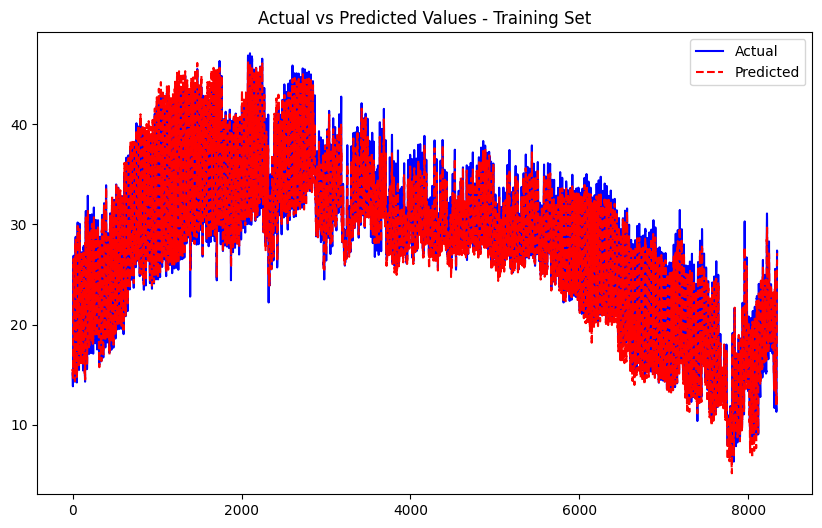

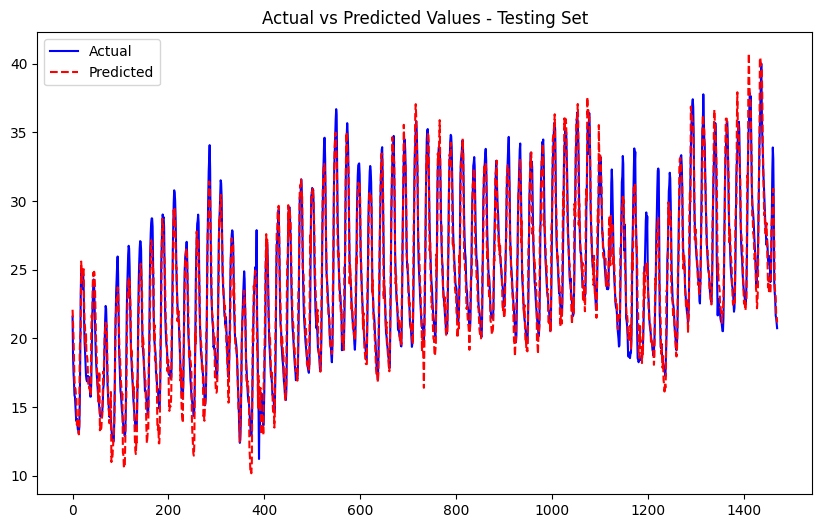

Processing node 28...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0445
Epoch [2/50], Train Loss: 0.0388
Epoch [3/50], Train Loss: 0.0361
Epoch [4/50], Train Loss: 0.0343
Epoch [5/50], Train Loss: 0.0327
Epoch [6/50], Train Loss: 0.0325
Epoch [7/50], Train Loss: 0.0316
Epoch [8/50], Train Loss: 0.0307
Epoch [9/50], Train Loss: 0.0303
Epoch [10/50], Train Loss: 0.0298
Epoch [11/50], Train Loss: 0.0293
Epoch [12/50], Train Loss: 0.0290
Epoch [13/50], Train Loss: 0.0287
Epoch [14/50], Train Loss: 0.0285
Epoch [15/50], Train Loss: 0.0284
Epoch [16/50], Train Loss: 0.0282
Epoch [17/50], Train Loss: 0.0282
Epoch [18/50], Train Loss: 0.0276
Epoch [19/50], Train Loss: 0.0273
Epoch [20/50], Train Loss: 0.0276
Epoch [21/50], Train Loss: 0.0274
Epoch [22/50], Train Loss: 0.0271
Epoch [23/50], Train Loss: 0.0269
Epoch [24/50], Train Loss: 0.0270
Epoch [25/50], Train Loss: 0.0267
Epoch [26/50], Train Loss: 0.0267
Epoch [27/50], Train Loss: 0.0267
Epoch [28/50], Train Loss: 0.0265
Epoch [29/50], Train Loss: 0.0264
Epoch [30/50], Train Lo

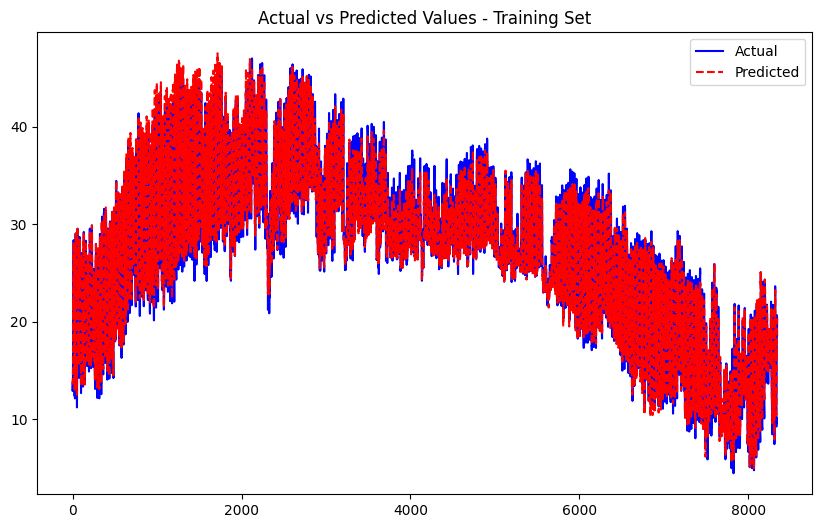

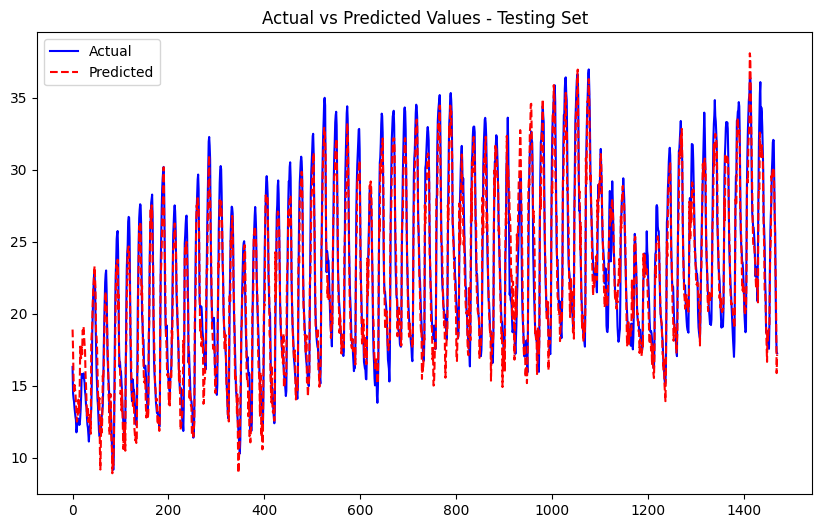

Processing node 29...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0440
Epoch [2/50], Train Loss: 0.0390
Epoch [3/50], Train Loss: 0.0366
Epoch [4/50], Train Loss: 0.0350
Epoch [5/50], Train Loss: 0.0338
Epoch [6/50], Train Loss: 0.0330
Epoch [7/50], Train Loss: 0.0322
Epoch [8/50], Train Loss: 0.0309
Epoch [9/50], Train Loss: 0.0304
Epoch [10/50], Train Loss: 0.0302
Epoch [11/50], Train Loss: 0.0299
Epoch [12/50], Train Loss: 0.0298
Epoch [13/50], Train Loss: 0.0294
Epoch [14/50], Train Loss: 0.0292
Epoch [15/50], Train Loss: 0.0291
Epoch [16/50], Train Loss: 0.0283
Epoch [17/50], Train Loss: 0.0285
Epoch [18/50], Train Loss: 0.0285
Epoch [19/50], Train Loss: 0.0282
Epoch [20/50], Train Loss: 0.0281
Epoch [21/50], Train Loss: 0.0276
Epoch [22/50], Train Loss: 0.0279
Epoch [23/50], Train Loss: 0.0273
Epoch [24/50], Train Loss: 0.0272
Epoch [25/50], Train Loss: 0.0273
Epoch [26/50], Train Loss: 0.0275
Epoch [27/50], Train Loss: 0.0275
Epoch [28/50], Train Loss: 0.0270
Epoch [29/50], Train Loss: 0.0269
Epoch [30/50], Train Lo

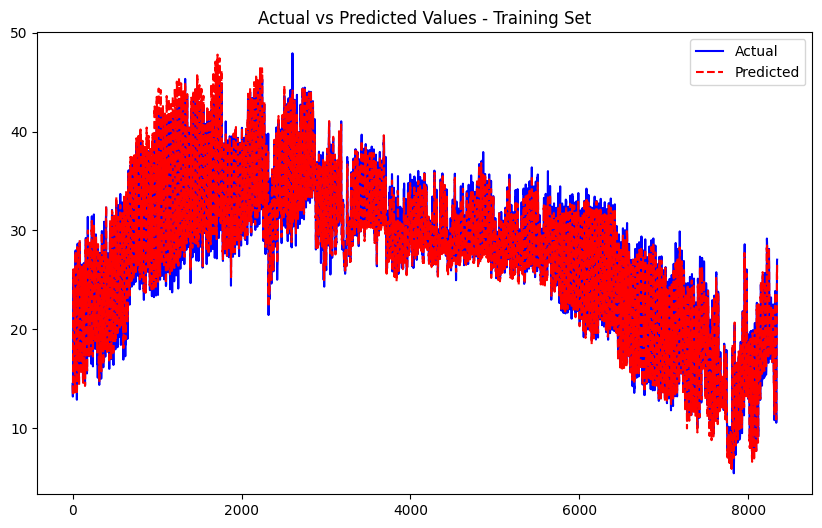

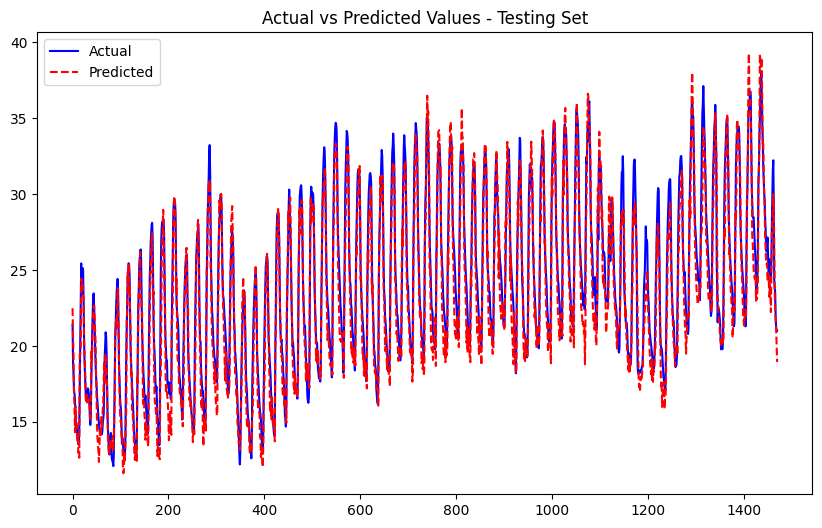

Processing node 30...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0587
Epoch [2/50], Train Loss: 0.0519
Epoch [3/50], Train Loss: 0.0466
Epoch [4/50], Train Loss: 0.0448
Epoch [5/50], Train Loss: 0.0433
Epoch [6/50], Train Loss: 0.0417
Epoch [7/50], Train Loss: 0.0414
Epoch [8/50], Train Loss: 0.0404
Epoch [9/50], Train Loss: 0.0396
Epoch [10/50], Train Loss: 0.0391
Epoch [11/50], Train Loss: 0.0388
Epoch [12/50], Train Loss: 0.0384
Epoch [13/50], Train Loss: 0.0376
Epoch [14/50], Train Loss: 0.0379
Epoch [15/50], Train Loss: 0.0376
Epoch [16/50], Train Loss: 0.0375
Epoch [17/50], Train Loss: 0.0368
Epoch [18/50], Train Loss: 0.0367
Epoch [19/50], Train Loss: 0.0365
Epoch [20/50], Train Loss: 0.0363
Epoch [21/50], Train Loss: 0.0359
Epoch [22/50], Train Loss: 0.0359
Epoch [23/50], Train Loss: 0.0360
Epoch [24/50], Train Loss: 0.0358
Epoch [25/50], Train Loss: 0.0355
Epoch [26/50], Train Loss: 0.0356
Epoch [27/50], Train Loss: 0.0349
Epoch [28/50], Train Loss: 0.0351
Epoch [29/50], Train Loss: 0.0348
Epoch [30/50], Train Lo

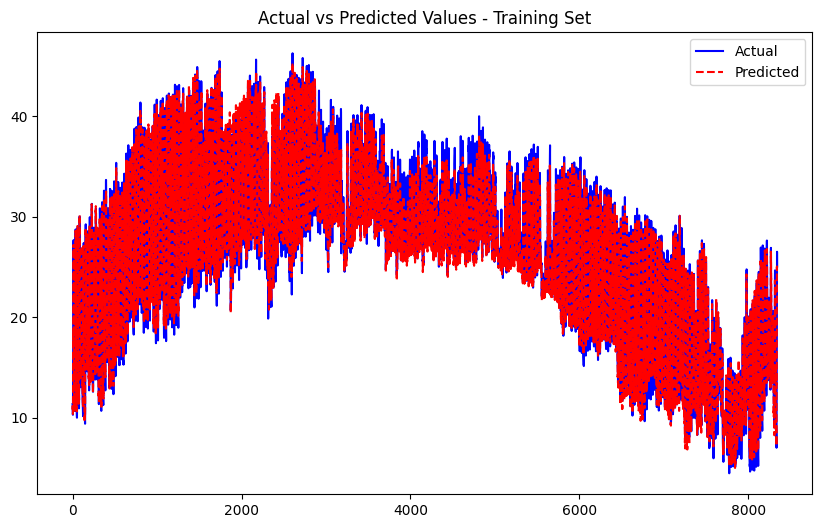

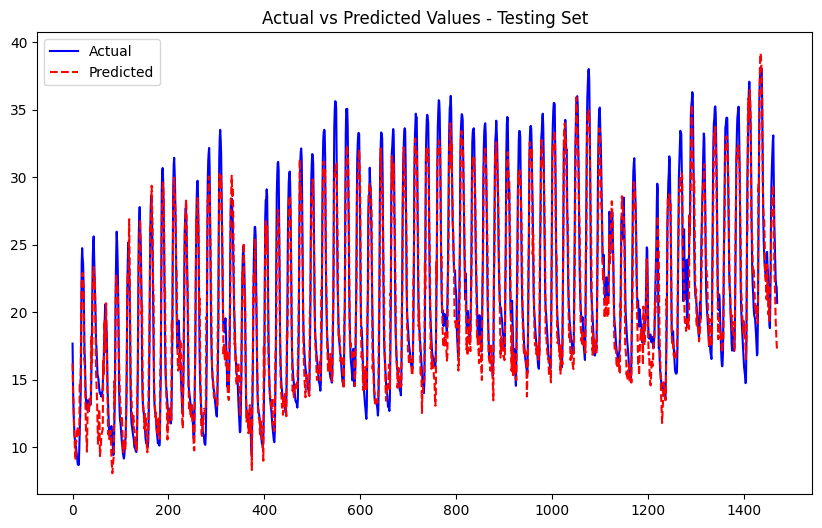

Processing node 31...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0480
Epoch [2/50], Train Loss: 0.0425
Epoch [3/50], Train Loss: 0.0405
Epoch [4/50], Train Loss: 0.0387
Epoch [5/50], Train Loss: 0.0374
Epoch [6/50], Train Loss: 0.0368
Epoch [7/50], Train Loss: 0.0358
Epoch [8/50], Train Loss: 0.0354
Epoch [9/50], Train Loss: 0.0352
Epoch [10/50], Train Loss: 0.0346
Epoch [11/50], Train Loss: 0.0344
Epoch [12/50], Train Loss: 0.0339
Epoch [13/50], Train Loss: 0.0337
Epoch [14/50], Train Loss: 0.0335
Epoch [15/50], Train Loss: 0.0332
Epoch [16/50], Train Loss: 0.0328
Epoch [17/50], Train Loss: 0.0327
Epoch [18/50], Train Loss: 0.0325
Epoch [19/50], Train Loss: 0.0324
Epoch [20/50], Train Loss: 0.0322
Epoch [21/50], Train Loss: 0.0318
Epoch [22/50], Train Loss: 0.0317
Epoch [23/50], Train Loss: 0.0316
Epoch [24/50], Train Loss: 0.0317
Epoch [25/50], Train Loss: 0.0317
Epoch [26/50], Train Loss: 0.0318
Epoch [27/50], Train Loss: 0.0312
Epoch [28/50], Train Loss: 0.0314
Epoch [29/50], Train Loss: 0.0311
Epoch [30/50], Train Lo

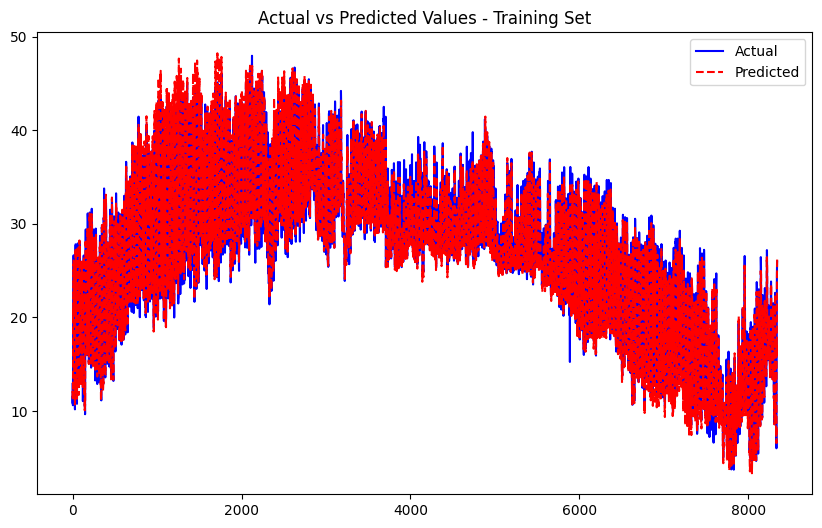

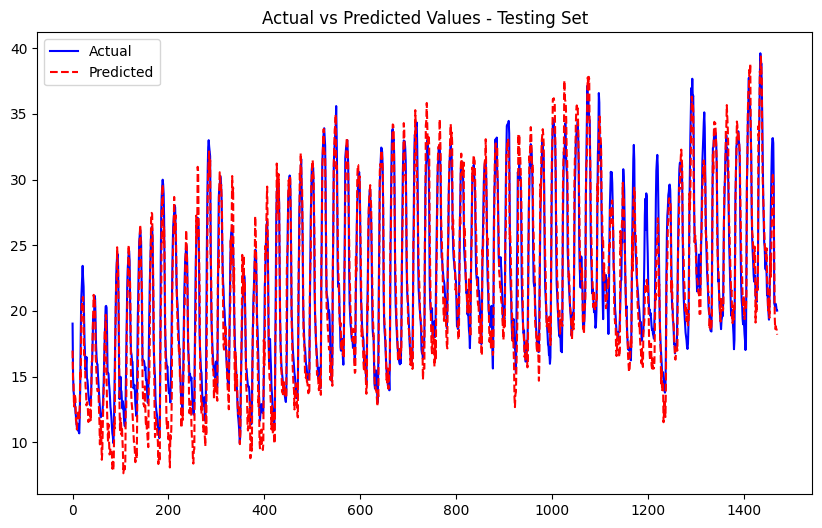

Processing node 32...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0445
Epoch [2/50], Train Loss: 0.0395
Epoch [3/50], Train Loss: 0.0371
Epoch [4/50], Train Loss: 0.0356
Epoch [5/50], Train Loss: 0.0344
Epoch [6/50], Train Loss: 0.0336
Epoch [7/50], Train Loss: 0.0330
Epoch [8/50], Train Loss: 0.0326
Epoch [9/50], Train Loss: 0.0319
Epoch [10/50], Train Loss: 0.0311
Epoch [11/50], Train Loss: 0.0309
Epoch [12/50], Train Loss: 0.0306
Epoch [13/50], Train Loss: 0.0304
Epoch [14/50], Train Loss: 0.0300
Epoch [15/50], Train Loss: 0.0300
Epoch [16/50], Train Loss: 0.0294
Epoch [17/50], Train Loss: 0.0292
Epoch [18/50], Train Loss: 0.0293
Epoch [19/50], Train Loss: 0.0291
Epoch [20/50], Train Loss: 0.0292
Epoch [21/50], Train Loss: 0.0288
Epoch [22/50], Train Loss: 0.0283
Epoch [23/50], Train Loss: 0.0288
Epoch [24/50], Train Loss: 0.0286
Epoch [25/50], Train Loss: 0.0284
Epoch [26/50], Train Loss: 0.0282
Epoch [27/50], Train Loss: 0.0281
Epoch [28/50], Train Loss: 0.0283
Epoch [29/50], Train Loss: 0.0278
Epoch [30/50], Train Lo

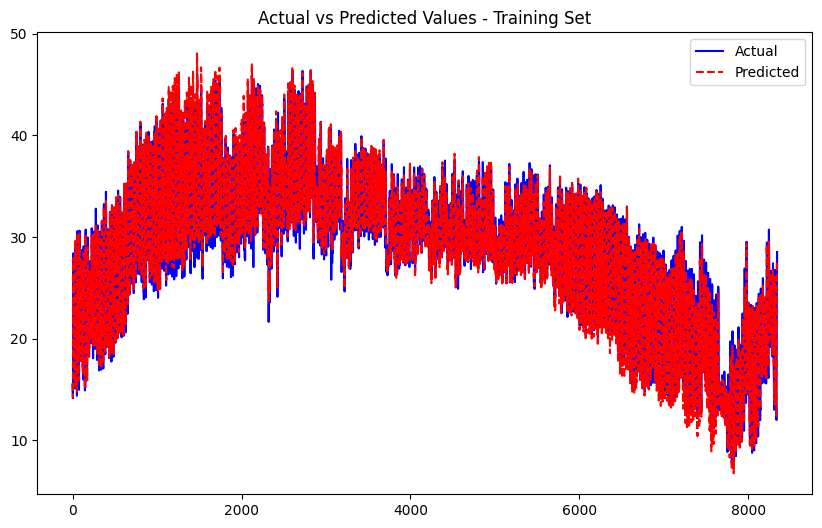

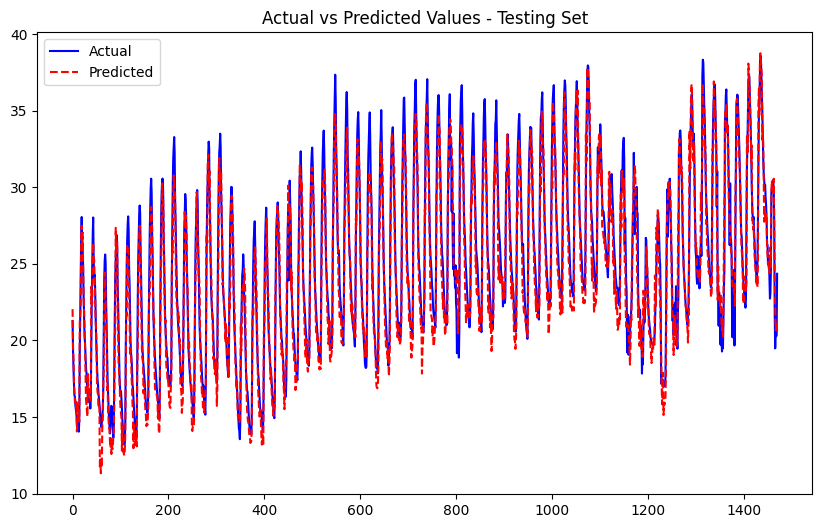

Processing node 33...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0538
Epoch [2/50], Train Loss: 0.0483
Epoch [3/50], Train Loss: 0.0448
Epoch [4/50], Train Loss: 0.0427
Epoch [5/50], Train Loss: 0.0413
Epoch [6/50], Train Loss: 0.0405
Epoch [7/50], Train Loss: 0.0390
Epoch [8/50], Train Loss: 0.0382
Epoch [9/50], Train Loss: 0.0378
Epoch [10/50], Train Loss: 0.0366
Epoch [11/50], Train Loss: 0.0363
Epoch [12/50], Train Loss: 0.0354
Epoch [13/50], Train Loss: 0.0355
Epoch [14/50], Train Loss: 0.0346
Epoch [15/50], Train Loss: 0.0349
Epoch [16/50], Train Loss: 0.0343
Epoch [17/50], Train Loss: 0.0339
Epoch [18/50], Train Loss: 0.0339
Epoch [19/50], Train Loss: 0.0334
Epoch [20/50], Train Loss: 0.0334
Epoch [21/50], Train Loss: 0.0331
Epoch [22/50], Train Loss: 0.0329
Epoch [23/50], Train Loss: 0.0330
Epoch [24/50], Train Loss: 0.0321
Epoch [25/50], Train Loss: 0.0322
Epoch [26/50], Train Loss: 0.0321
Epoch [27/50], Train Loss: 0.0319
Epoch [28/50], Train Loss: 0.0320
Epoch [29/50], Train Loss: 0.0317
Epoch [30/50], Train Lo

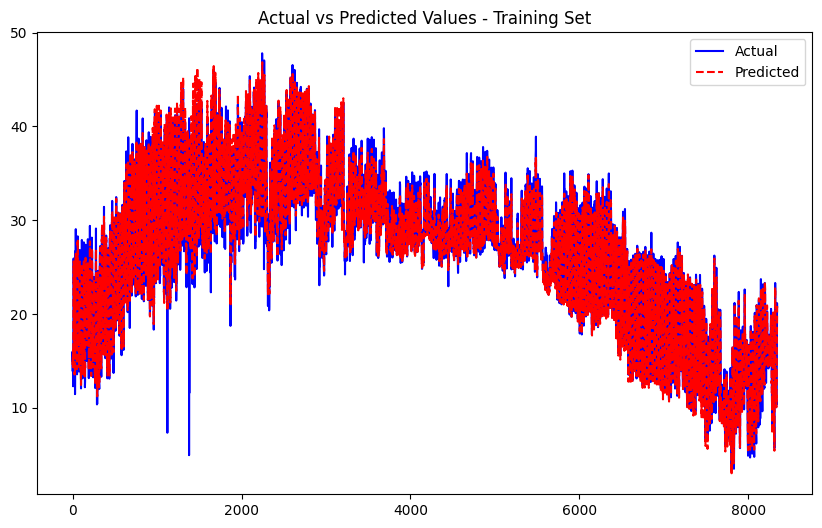

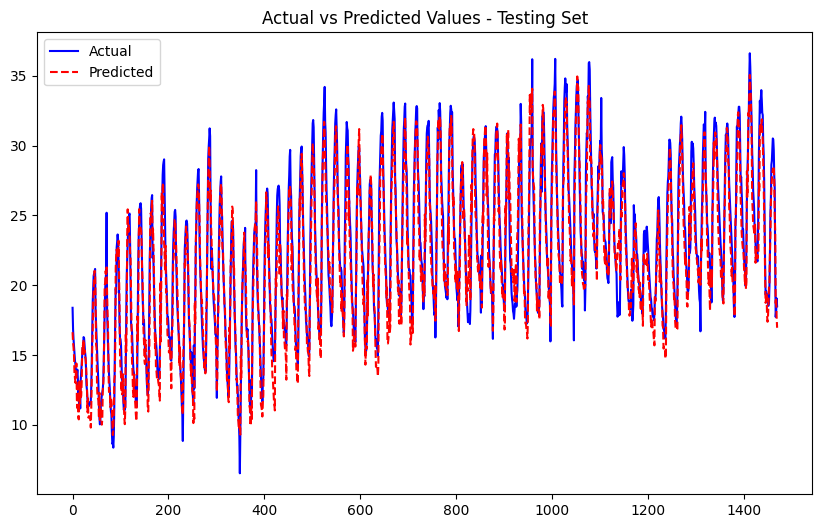

Processing node 34...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0453
Epoch [2/50], Train Loss: 0.0397
Epoch [3/50], Train Loss: 0.0369
Epoch [4/50], Train Loss: 0.0352
Epoch [5/50], Train Loss: 0.0341
Epoch [6/50], Train Loss: 0.0335
Epoch [7/50], Train Loss: 0.0317
Epoch [8/50], Train Loss: 0.0315
Epoch [9/50], Train Loss: 0.0311
Epoch [10/50], Train Loss: 0.0305
Epoch [11/50], Train Loss: 0.0300
Epoch [12/50], Train Loss: 0.0298
Epoch [13/50], Train Loss: 0.0294
Epoch [14/50], Train Loss: 0.0292
Epoch [15/50], Train Loss: 0.0291
Epoch [16/50], Train Loss: 0.0289
Epoch [17/50], Train Loss: 0.0287
Epoch [18/50], Train Loss: 0.0283
Epoch [19/50], Train Loss: 0.0283
Epoch [20/50], Train Loss: 0.0277
Epoch [21/50], Train Loss: 0.0282
Epoch [22/50], Train Loss: 0.0275
Epoch [23/50], Train Loss: 0.0278
Epoch [24/50], Train Loss: 0.0277
Epoch [25/50], Train Loss: 0.0271
Epoch [26/50], Train Loss: 0.0269
Epoch [27/50], Train Loss: 0.0272
Epoch [28/50], Train Loss: 0.0269
Epoch [29/50], Train Loss: 0.0270
Epoch [30/50], Train Lo

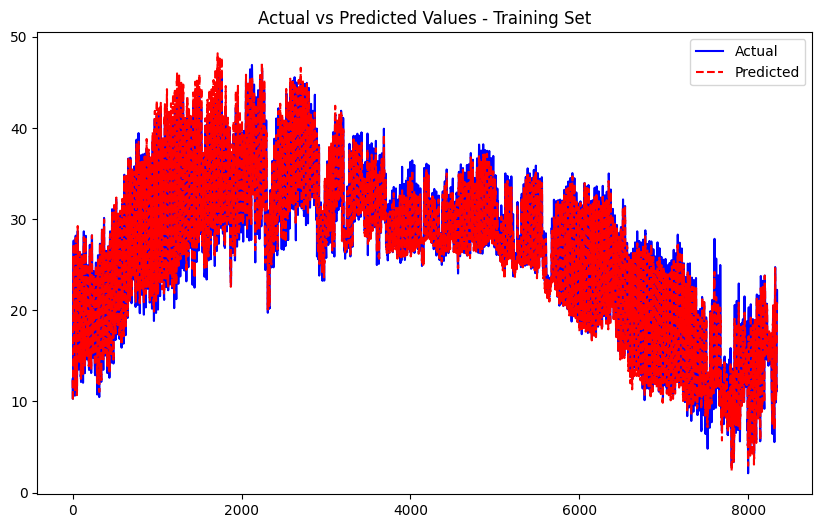

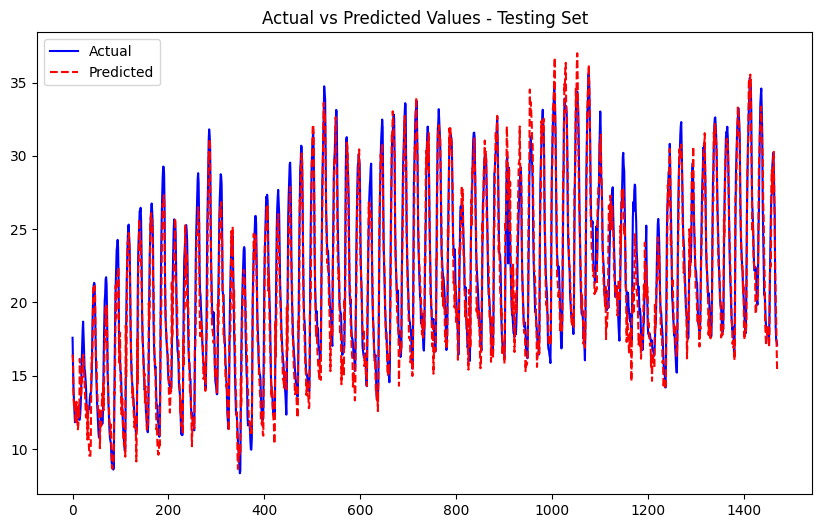

Processing node 35...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0417
Epoch [2/50], Train Loss: 0.0378
Epoch [3/50], Train Loss: 0.0361
Epoch [4/50], Train Loss: 0.0347
Epoch [5/50], Train Loss: 0.0334
Epoch [6/50], Train Loss: 0.0326
Epoch [7/50], Train Loss: 0.0322
Epoch [8/50], Train Loss: 0.0315
Epoch [9/50], Train Loss: 0.0310
Epoch [10/50], Train Loss: 0.0309
Epoch [11/50], Train Loss: 0.0302
Epoch [12/50], Train Loss: 0.0299
Epoch [13/50], Train Loss: 0.0301
Epoch [14/50], Train Loss: 0.0299
Epoch [15/50], Train Loss: 0.0296
Epoch [16/50], Train Loss: 0.0290
Epoch [17/50], Train Loss: 0.0291
Epoch [18/50], Train Loss: 0.0290
Epoch [19/50], Train Loss: 0.0289
Epoch [20/50], Train Loss: 0.0292
Epoch [21/50], Train Loss: 0.0285
Epoch [22/50], Train Loss: 0.0283
Epoch [23/50], Train Loss: 0.0285
Epoch [24/50], Train Loss: 0.0281
Epoch [25/50], Train Loss: 0.0282
Epoch [26/50], Train Loss: 0.0280
Epoch [27/50], Train Loss: 0.0280
Epoch [28/50], Train Loss: 0.0279
Epoch [29/50], Train Loss: 0.0280
Epoch [30/50], Train Lo

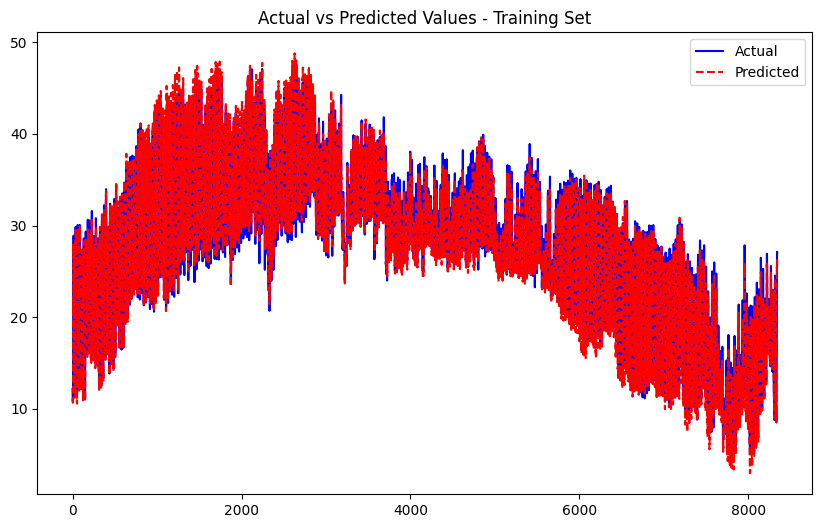

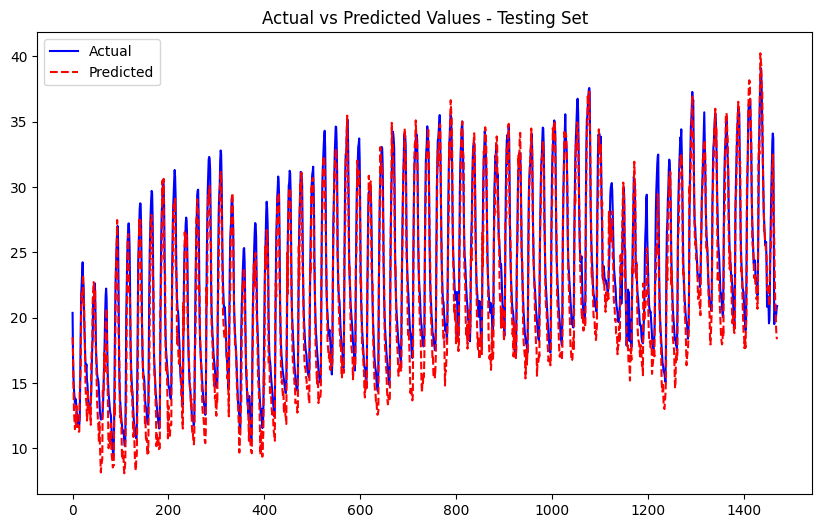

Processing node 36...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0483
Epoch [2/50], Train Loss: 0.0428
Epoch [3/50], Train Loss: 0.0402
Epoch [4/50], Train Loss: 0.0381
Epoch [5/50], Train Loss: 0.0376
Epoch [6/50], Train Loss: 0.0355
Epoch [7/50], Train Loss: 0.0348
Epoch [8/50], Train Loss: 0.0337
Epoch [9/50], Train Loss: 0.0331
Epoch [10/50], Train Loss: 0.0327
Epoch [11/50], Train Loss: 0.0322
Epoch [12/50], Train Loss: 0.0319
Epoch [13/50], Train Loss: 0.0314
Epoch [14/50], Train Loss: 0.0311
Epoch [15/50], Train Loss: 0.0303
Epoch [16/50], Train Loss: 0.0305
Epoch [17/50], Train Loss: 0.0298
Epoch [18/50], Train Loss: 0.0299
Epoch [19/50], Train Loss: 0.0299
Epoch [20/50], Train Loss: 0.0296
Epoch [21/50], Train Loss: 0.0290
Epoch [22/50], Train Loss: 0.0288
Epoch [23/50], Train Loss: 0.0289
Epoch [24/50], Train Loss: 0.0286
Epoch [25/50], Train Loss: 0.0285
Epoch [26/50], Train Loss: 0.0284
Epoch [27/50], Train Loss: 0.0288
Epoch [28/50], Train Loss: 0.0285
Epoch [29/50], Train Loss: 0.0286
Epoch [30/50], Train Lo

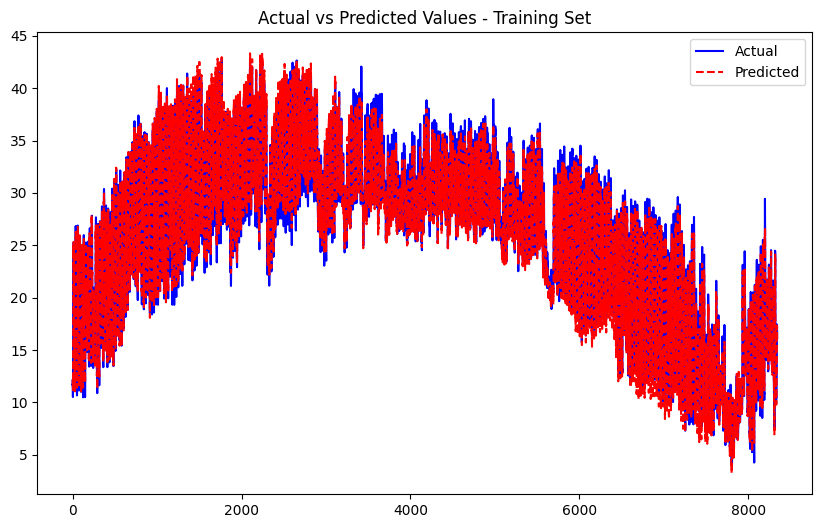

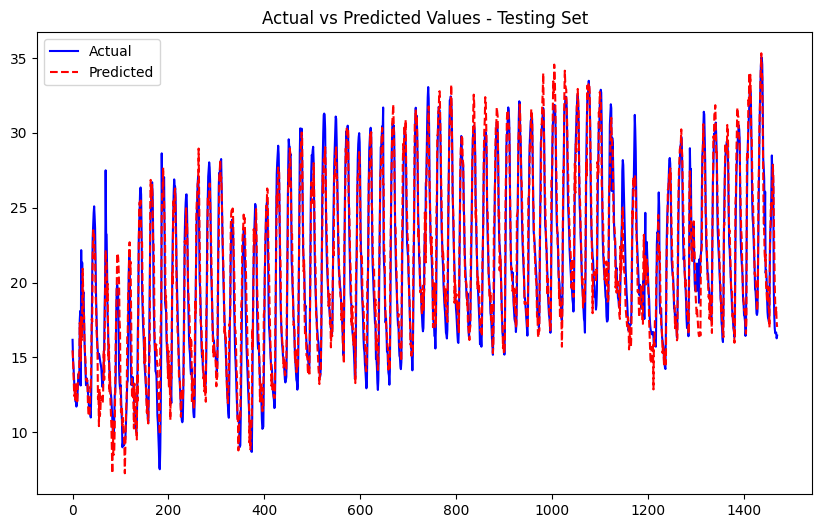

Processing node 37...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0484
Epoch [2/50], Train Loss: 0.0435
Epoch [3/50], Train Loss: 0.0405
Epoch [4/50], Train Loss: 0.0387
Epoch [5/50], Train Loss: 0.0376
Epoch [6/50], Train Loss: 0.0367
Epoch [7/50], Train Loss: 0.0355
Epoch [8/50], Train Loss: 0.0349
Epoch [9/50], Train Loss: 0.0347
Epoch [10/50], Train Loss: 0.0334
Epoch [11/50], Train Loss: 0.0333
Epoch [12/50], Train Loss: 0.0330
Epoch [13/50], Train Loss: 0.0322
Epoch [14/50], Train Loss: 0.0323
Epoch [15/50], Train Loss: 0.0322
Epoch [16/50], Train Loss: 0.0314
Epoch [17/50], Train Loss: 0.0318
Epoch [18/50], Train Loss: 0.0311
Epoch [19/50], Train Loss: 0.0311
Epoch [20/50], Train Loss: 0.0311
Epoch [21/50], Train Loss: 0.0308
Epoch [22/50], Train Loss: 0.0306
Epoch [23/50], Train Loss: 0.0302
Epoch [24/50], Train Loss: 0.0302
Epoch [25/50], Train Loss: 0.0306
Epoch [26/50], Train Loss: 0.0303
Epoch [27/50], Train Loss: 0.0301
Epoch [28/50], Train Loss: 0.0300
Epoch [29/50], Train Loss: 0.0299
Epoch [30/50], Train Lo

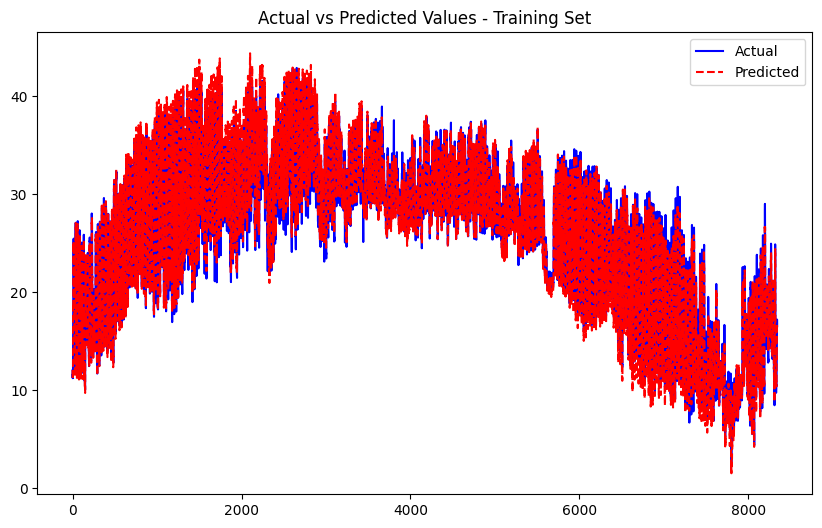

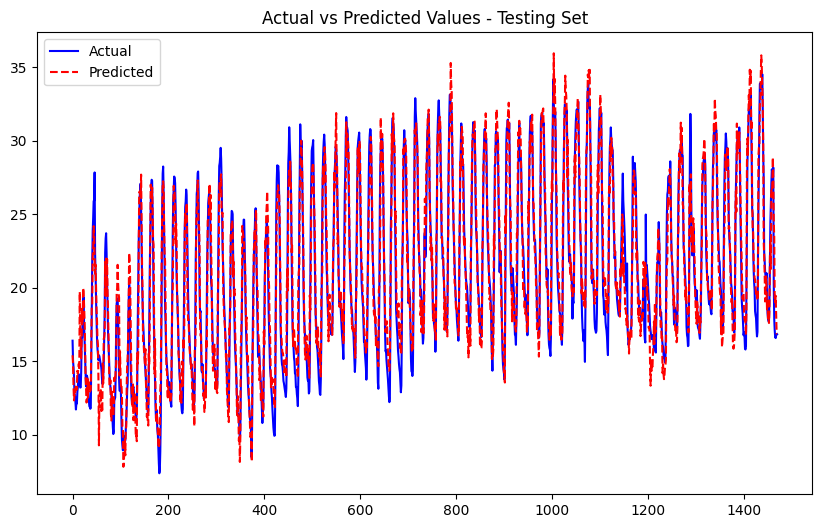

Processing node 38...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0424
Epoch [2/50], Train Loss: 0.0374
Epoch [3/50], Train Loss: 0.0350
Epoch [4/50], Train Loss: 0.0335
Epoch [5/50], Train Loss: 0.0320
Epoch [6/50], Train Loss: 0.0311
Epoch [7/50], Train Loss: 0.0302
Epoch [8/50], Train Loss: 0.0298
Epoch [9/50], Train Loss: 0.0289
Epoch [10/50], Train Loss: 0.0288
Epoch [11/50], Train Loss: 0.0282
Epoch [12/50], Train Loss: 0.0277
Epoch [13/50], Train Loss: 0.0275
Epoch [14/50], Train Loss: 0.0272
Epoch [15/50], Train Loss: 0.0269
Epoch [16/50], Train Loss: 0.0271
Epoch [17/50], Train Loss: 0.0264
Epoch [18/50], Train Loss: 0.0264
Epoch [19/50], Train Loss: 0.0265
Epoch [20/50], Train Loss: 0.0260
Epoch [21/50], Train Loss: 0.0257
Epoch [22/50], Train Loss: 0.0260
Epoch [23/50], Train Loss: 0.0259
Epoch [24/50], Train Loss: 0.0254
Epoch [25/50], Train Loss: 0.0254
Epoch [26/50], Train Loss: 0.0251
Epoch [27/50], Train Loss: 0.0253
Epoch [28/50], Train Loss: 0.0252
Epoch [29/50], Train Loss: 0.0254
Epoch [30/50], Train Lo

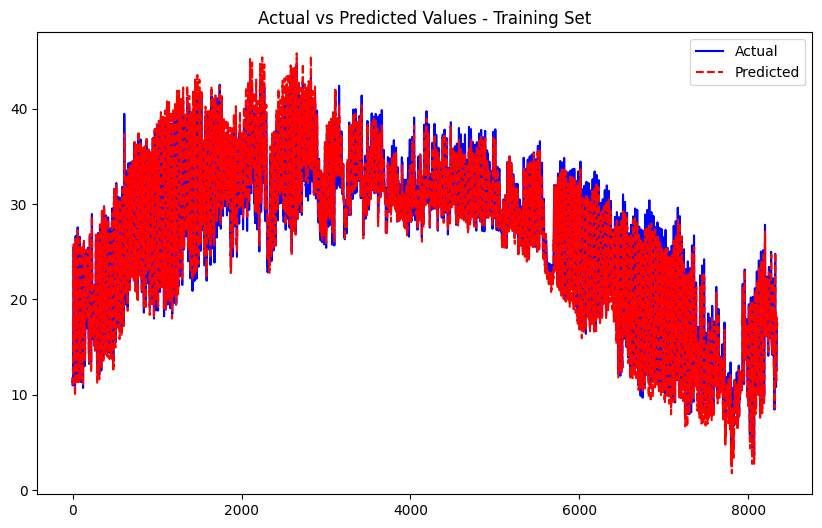

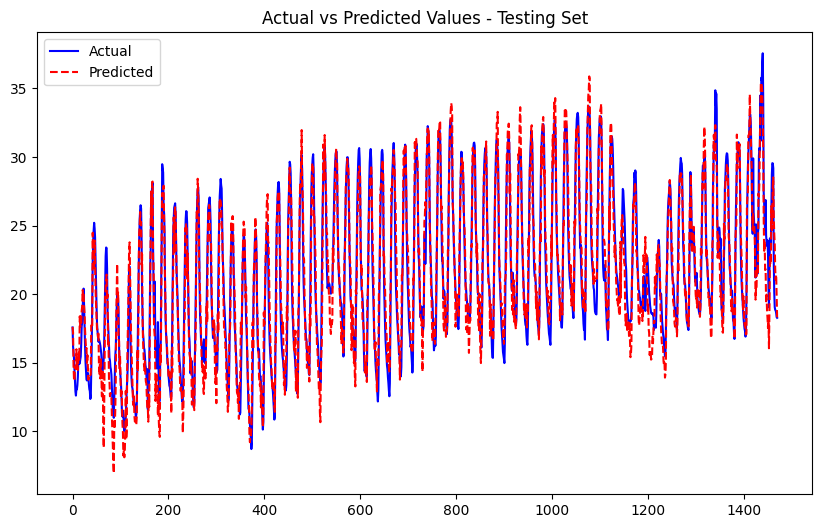

Processing node 39...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0813
Epoch [2/50], Train Loss: 0.0719
Epoch [3/50], Train Loss: 0.0674
Epoch [4/50], Train Loss: 0.0639
Epoch [5/50], Train Loss: 0.0616
Epoch [6/50], Train Loss: 0.0595
Epoch [7/50], Train Loss: 0.0586
Epoch [8/50], Train Loss: 0.0573
Epoch [9/50], Train Loss: 0.0561
Epoch [10/50], Train Loss: 0.0548
Epoch [11/50], Train Loss: 0.0543
Epoch [12/50], Train Loss: 0.0532
Epoch [13/50], Train Loss: 0.0524
Epoch [14/50], Train Loss: 0.0524
Epoch [15/50], Train Loss: 0.0519
Epoch [16/50], Train Loss: 0.0511
Epoch [17/50], Train Loss: 0.0503
Epoch [18/50], Train Loss: 0.0504
Epoch [19/50], Train Loss: 0.0500
Epoch [20/50], Train Loss: 0.0501
Epoch [21/50], Train Loss: 0.0494
Epoch [22/50], Train Loss: 0.0486
Epoch [23/50], Train Loss: 0.0484
Epoch [24/50], Train Loss: 0.0482
Epoch [25/50], Train Loss: 0.0481
Epoch [26/50], Train Loss: 0.0482
Epoch [27/50], Train Loss: 0.0473
Epoch [28/50], Train Loss: 0.0474
Epoch [29/50], Train Loss: 0.0472
Epoch [30/50], Train Lo

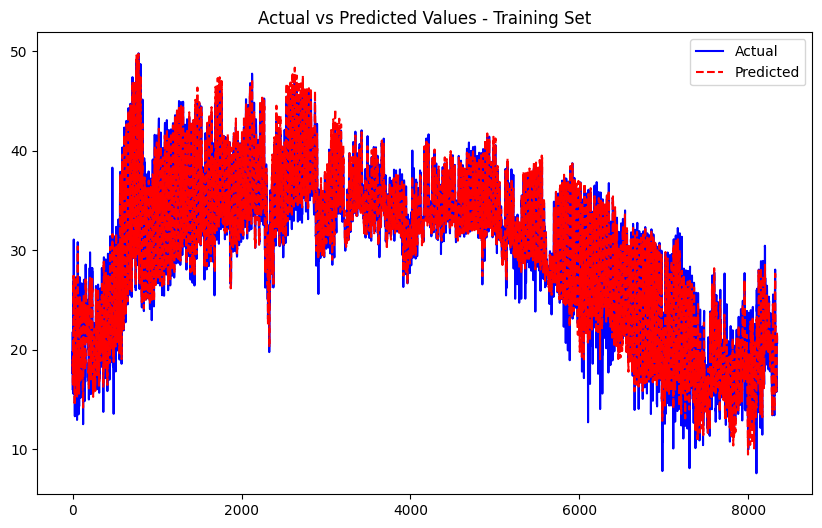

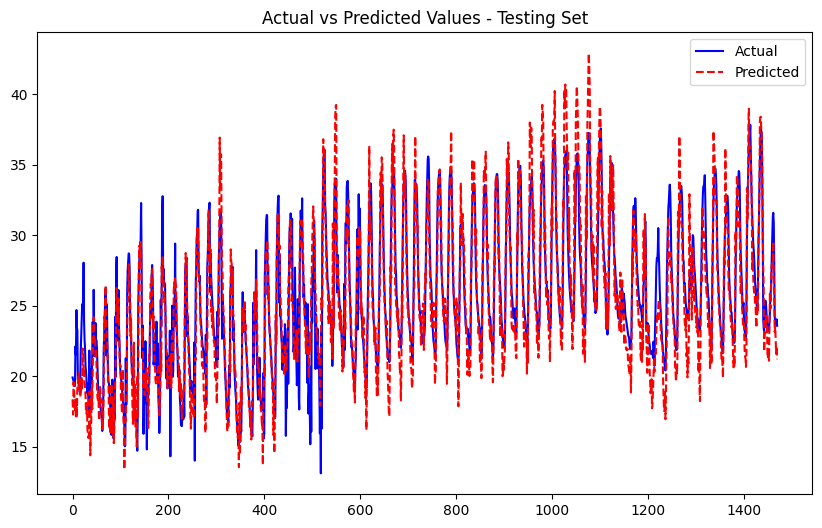

Processing node 40...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2023
Epoch [2/50], Train Loss: 0.1365
Epoch [3/50], Train Loss: 0.1028
Epoch [4/50], Train Loss: 0.0879
Epoch [5/50], Train Loss: 0.0801
Epoch [6/50], Train Loss: 0.0706
Epoch [7/50], Train Loss: 0.0668
Epoch [8/50], Train Loss: 0.0652
Epoch [9/50], Train Loss: 0.0628
Epoch [10/50], Train Loss: 0.0594
Epoch [11/50], Train Loss: 0.0601
Epoch [12/50], Train Loss: 0.0564
Epoch [13/50], Train Loss: 0.0546
Epoch [14/50], Train Loss: 0.0533
Epoch [15/50], Train Loss: 0.0505
Epoch [16/50], Train Loss: 0.0502
Epoch [17/50], Train Loss: 0.0485
Epoch [18/50], Train Loss: 0.0464
Epoch [19/50], Train Loss: 0.0488
Epoch [20/50], Train Loss: 0.0472
Epoch [21/50], Train Loss: 0.0459
Epoch [22/50], Train Loss: 0.0462
Epoch [23/50], Train Loss: 0.0455
Epoch [24/50], Train Loss: 0.0463
Epoch [25/50], Train Loss: 0.0445
Epoch [26/50], Train Loss: 0.0452
Epoch [27/50], Train Loss: 0.0437
Epoch [28/50], Train Loss: 0.0440
Epoch [29/50], Train Loss: 0.0438
Epoch [30/50], Train Lo

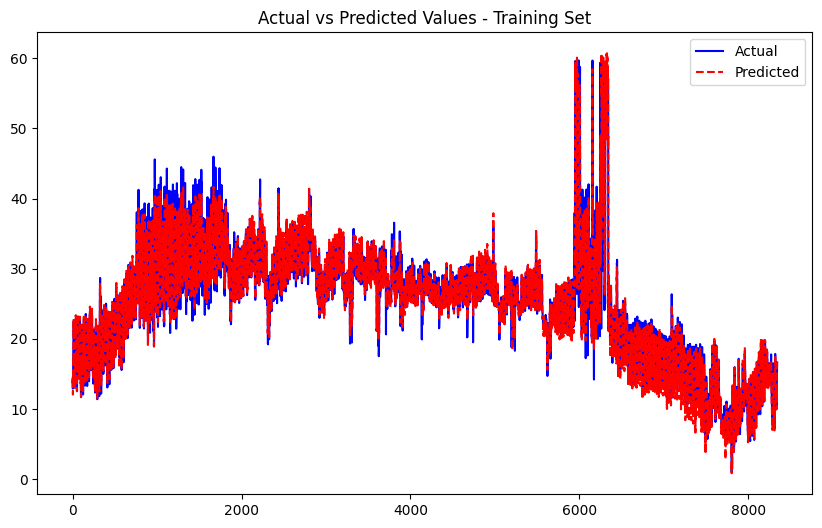

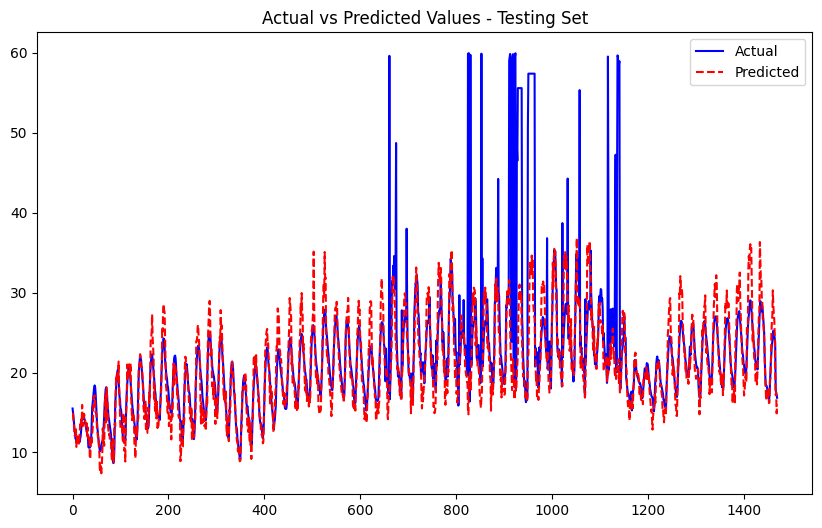

Processing node 41...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0704
Epoch [2/50], Train Loss: 0.0566
Epoch [3/50], Train Loss: 0.0525
Epoch [4/50], Train Loss: 0.0489
Epoch [5/50], Train Loss: 0.0471
Epoch [6/50], Train Loss: 0.0455
Epoch [7/50], Train Loss: 0.0432
Epoch [8/50], Train Loss: 0.0423
Epoch [9/50], Train Loss: 0.0411
Epoch [10/50], Train Loss: 0.0399
Epoch [11/50], Train Loss: 0.0399
Epoch [12/50], Train Loss: 0.0388
Epoch [13/50], Train Loss: 0.0381
Epoch [14/50], Train Loss: 0.0380
Epoch [15/50], Train Loss: 0.0370
Epoch [16/50], Train Loss: 0.0365
Epoch [17/50], Train Loss: 0.0364
Epoch [18/50], Train Loss: 0.0361
Epoch [19/50], Train Loss: 0.0354
Epoch [20/50], Train Loss: 0.0355
Epoch [21/50], Train Loss: 0.0350
Epoch [22/50], Train Loss: 0.0352
Epoch [23/50], Train Loss: 0.0347
Epoch [24/50], Train Loss: 0.0341
Epoch [25/50], Train Loss: 0.0342
Epoch [26/50], Train Loss: 0.0338
Epoch [27/50], Train Loss: 0.0340
Epoch [28/50], Train Loss: 0.0337
Epoch [29/50], Train Loss: 0.0339
Epoch [30/50], Train Lo

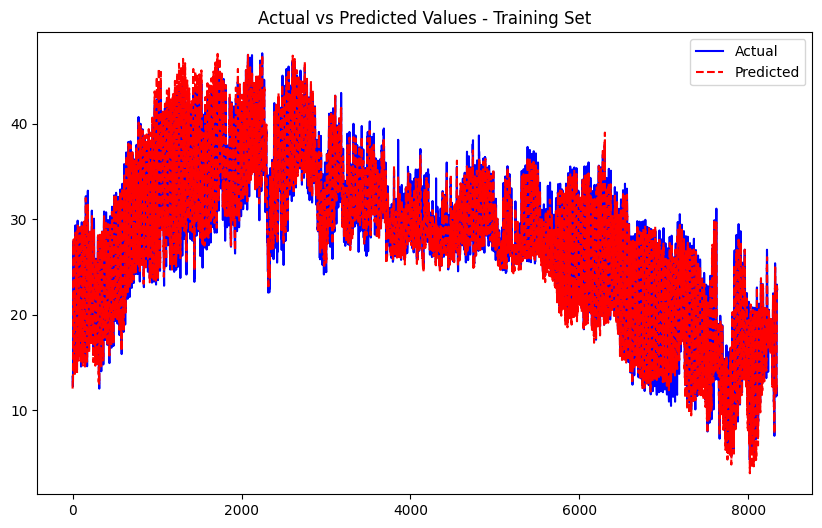

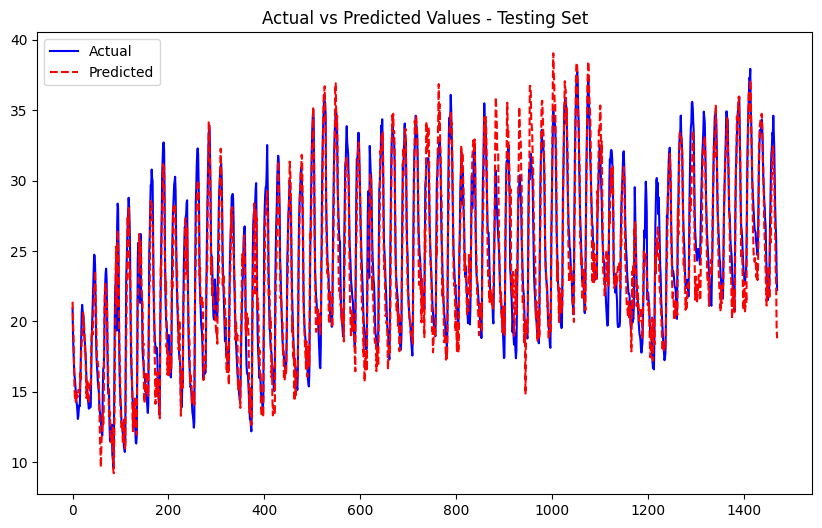

Train GNN and GRU Imputed bs 3 sl 3.csv
CSV file 'Train GNN and GRU Imputed bs 3 sl 3.csv' created successfully.
Test GNN and GRU Imputed bs 3 sl 3.csv
CSV file 'Test GNN and GRU Imputed bs 3 sl 3.csv' created successfully.


In [21]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import numpy as np
import torch.optim.lr_scheduler as lr_scheduler

# Define the GRU Model
class GRUModel(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, dropout_prob=0.2):
        super(GRUModel, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        
        # Define the GRU layer
        self.gru = nn.GRU(input_size, hidden_size, num_layers, batch_first=True)
        
        # Dropout layer
        self.dropout = nn.Dropout(dropout_prob)
        
        # Fully connected layer (output layer)
        self.fc = nn.Linear(hidden_size, output_size)
        
        # Activation function
        self.elu = nn.ELU()

    def forward(self, x):
        # Initialize hidden state with zeros
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)

        # Forward pass through GRU
        out, _ = self.gru(x, h0)
        
        # Apply ReLU activation function to the last time step output
        out = self.elu(out[:, -1, :])  # out[:, -1, :] -> output from the last time step
        
        # Apply dropout to the hidden layer's output
        out = self.dropout(out)
        
        # Pass the output through the fully connected layer
        out = self.fc(out)
        
        return out


def train_model(model, train_loader, criterion, optimizer, num_epochs):
    model.train()  # Set the model to training mode
    for epoch in range(num_epochs):
        running_loss = 0.0
        
        # Training phase
        for features, targets in train_loader:
            features, targets = features.to(device), targets.to(device)
            
            # Forward pass
            outputs = model(features) 
            loss = criterion(outputs, targets)  # Compute the loss

            # Backward and optimize
            optimizer.zero_grad()  # Clear previous gradients
            loss.backward()  # Backpropagate the loss
            optimizer.step()  # Update weights

            running_loss += loss.item()   

        # Print training loss after each epoch
        print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {running_loss/len(train_loader):.4f}')
    
    # Switch back to evaluation mode
    model.eval()



def test_model(model, train_loader, test_loader, node_idx):
    model.eval()
    all_actuals = []
    all_predictions = []
    
    # For tracking actuals and predictions for train and test sets separately
    train_actuals = []
    train_predictions = []
    
    test_actuals = []
    test_predictions = []

    
    with torch.no_grad():
        # Predict on training data
        for features, targets in train_loader:
            features, targets = features.to(device), targets.to(device)
            outputs = model(features)

            train_actuals.append(targets.cpu().numpy())
            train_predictions.append(outputs.cpu().numpy())

        # Predict on testing data
        for features, targets in test_loader:
            features, targets = features.to(device), targets.to(device)
            outputs = model(features)

            test_actuals.append(targets.cpu().numpy())
            test_predictions.append(outputs.cpu().numpy())
    
    # Concatenate all sets
    train_actuals = np.concatenate(train_actuals, axis=0)
    test_actuals = np.concatenate(test_actuals, axis=0)
    
    train_predictions = np.concatenate(train_predictions, axis=0)
    test_predictions = np.concatenate(test_predictions, axis=0)

    # Check shapes before proceeding
    print(f"Training actuals shape: {train_actuals.shape}, Predictions shape: {train_predictions.shape}")
    print(f"Testing actuals shape: {test_actuals.shape}, Predictions shape: {test_predictions.shape}")
    
    # Combine them for inverse scaling
    all_actuals = np.concatenate([train_actuals, test_actuals])
    all_predictions = np.concatenate([train_predictions, test_predictions])
    
    # Inverse scaling
    file_name = input_files[node_idx]
    
    if file_name in scalers:
        all_actuals = all_actuals.reshape(-1, 1)
        all_predictions = all_predictions.reshape(-1, 1)
        
        # Apply inverse scaling
        all_actuals_inverse = scalers[file_name].inverse_transform(all_actuals).flatten()
        all_predictions_inverse = scalers[file_name].inverse_transform(all_predictions).flatten()
    else:
        print(f"Scaler not found for {file_name}")
        return
    
    # Split them back into training and test sets
    train_size = len(train_actuals)
    test_size = len(test_actuals)
    
    train_actuals_inverse = all_actuals_inverse[:train_size]
    test_actuals_inverse = all_actuals_inverse[train_size:]
    
    train_predictions_inverse = all_predictions_inverse[:train_size]
    test_predictions_inverse = all_predictions_inverse[train_size:]

    # Verify split sizes
    print(f"Split Training actuals shape: {train_actuals_inverse.shape}, Predictions shape: {train_predictions_inverse.shape}")
    print(f"Split Testing actuals shape: {test_actuals_inverse.shape}, Predictions shape: {test_predictions_inverse.shape}")
    
    # Function to calculate and print metrics
    def calculate_metrics(actuals, predictions, set_name):
        mae = mean_absolute_error(actuals, predictions)
        mse = mean_squared_error(actuals, predictions)
        rmse = np.sqrt(mse)
        r2 = r2_score(actuals, predictions)
        corr_coeff = np.corrcoef(actuals.flatten(), predictions.flatten())[0, 1]
        
        # Print the metrics
        print(f"{set_name} Set Metrics:")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
        print(f"Pearson Correlation Coefficient: {corr_coeff:.4f}")
        print(f"R-squared (R²): {r2:.4f}")
        print("\n" + "-"*40 + "\n")

        if set_name == 'Training':
            train_mae_list.append(mae)
            train_mse_list.append(mse)
            train_rmse_list.append(rmse)
            train_r2_list.append(r2)
            train_corr_list.append(corr_coeff)

        elif set_name == 'Testing':
            test_mae_list.append(mae)
            test_mse_list.append(mse)
            test_rmse_list.append(rmse)
            test_r2_list.append(r2)
            test_corr_list.append(corr_coeff)        
    
    # Calculate and print metrics for each set
    print(f"\nCalculating metrics for Node {node_idx+1} - {file_name}")
    calculate_metrics(train_actuals_inverse, train_predictions_inverse, 'Training')
    calculate_metrics(test_actuals_inverse, test_predictions_inverse, 'Testing')

    print(f"\n\nCalculating Average Metrics for Training:")
    print(f"Mean MAE: {np.mean(train_mae_list):.4f}")
    print(f"Mean MSE: {np.mean(train_mse_list):.4f}")
    print(f"Mean RMSE: {np.mean(train_rmse_list):.4f}")
    print(f"Mean R²: {np.mean(train_r2_list):.4f}")
    print(f"Mean CorrCoeff: {np.mean(train_corr_list):.4f}")

    print(f"\n\nCalculating Average Metrics for Testing:")
    print(f"Mean MAE: {np.mean(test_mae_list):.4f}")
    print(f"Mean MSE: {np.mean(test_mse_list):.4f}")
    print(f"Mean RMSE: {np.mean(test_rmse_list):.4f}")
    print(f"Mean R²: {np.mean(test_r2_list):.4f}")
    print(f"Mean CorrCoeff: {np.mean(test_corr_list):.4f}")    
    
    # Function to plot actual vs predicted values
    def plot_results(actuals, predictions, set_name):
        plt.figure(figsize=(10, 6))
        plt.plot(actuals, label="Actual", color='blue')
        plt.plot(predictions, label="Predicted", color='red', linestyle='dashed')
        plt.title(f'Actual vs Predicted Values - {set_name} Set')
        plt.legend()
        plt.show()
    
    # Plot results for each set
    plot_results(train_actuals_inverse, train_predictions_inverse, 'Training')
    plot_results(test_actuals_inverse, test_predictions_inverse, 'Testing')


def create_dataloaders(features, targets, batch_size, sequence_length):
    # Convert DataFrame to NumPy arrays
    features_np = features.to_numpy()
    targets_np = targets.to_numpy()

    # Prepare sequences of data
    feature_sequences = []
    target_sequences = []

    # Create rolling windows of `sequence_length`
    for i in range(len(features_np) - sequence_length + 1):
        # Get sequence of features and corresponding target
        feature_sequences.append(features_np[i:i+sequence_length])
        target_sequences.append(targets_np[i+sequence_length-1])  # target is the last value of the sequence

    # Convert to NumPy arrays
    feature_sequences = np.array(feature_sequences)
    target_sequences = np.array(target_sequences)

    # Convert to PyTorch tensors
    features_tensor = torch.tensor(feature_sequences, dtype=torch.float32)
    targets_tensor = torch.tensor(target_sequences, dtype=torch.float32)

    # Create a dataset and dataloader
    dataset = torch.utils.data.TensorDataset(features_tensor, targets_tensor)
    return torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=False)

# Initialize the PyTorch model, criterion, and optimizer
input_size = train_features_list[0].shape[1]
hidden_size = 128
num_layers = 2
output_size = 1
num_epochs = 50
learning_rate = 0.0005
batch_size = 3
sequence_length = 3

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = GRUModel(input_size, hidden_size, num_layers, output_size).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

print(f"For Batch Size= {batch_size} and Sequence Length = {sequence_length}")
train_mae_list = []
train_mse_list = []
train_rmse_list = []
train_r2_list = []
train_corr_list = []

test_mae_list = []
test_mse_list = []
test_rmse_list = []
test_r2_list = []
test_corr_list = []

# Process for each node
for node_idx, (train_features, train_targets, test_features, test_targets) in enumerate(zip(train_features_list, train_target_list, test_features_list, test_target_list)):
    print(f"Processing node {node_idx+1}...")

    # Create dataloaders
    train_loader = create_dataloaders(train_features, train_targets, batch_size, sequence_length)
    test_loader = create_dataloaders(test_features, test_targets, batch_size, sequence_length)

    # Train the model
    train_model(model, train_loader, criterion, optimizer, num_epochs)

    # Test the model and output metrics/plot
    test_model(model, train_loader, test_loader, node_idx)

    # Define function to create DataFrame and save to CSV
def create_metrics_csv(file_name, input_files, mae_list, mse_list, rmse_list, r2_list, corr_list):
    metrics_df = pd.DataFrame({
        "File Name": input_files,
        "MAE": mae_list,
        "MSE": mse_list,
        "RMSE": rmse_list,
        "R2": r2_list,
        "CorrCoeff": corr_list
    })
    metrics_df.to_csv(file_name, index=False)
    print(f"CSV file '{file_name}' created successfully.")

# Create CSV for training set
file_name = "Train GNN and GRU Imputed bs 3 sl 3.csv"
print(file_name)
create_metrics_csv(file_name, input_files, train_mae_list, train_mse_list, train_rmse_list, train_r2_list, train_corr_list)

# Create CSV for test set
file_name = "Test GNN and GRU Imputed bs 3 sl 3.csv"
print(file_name)
create_metrics_csv(file_name, input_files, test_mae_list, test_mse_list, test_rmse_list, test_r2_list, test_corr_list)    
